In [30]:
from __future__ import print_function
import time
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.autograd import Variable
import matplotlib.pyplot as plt
import numpy as np
from torch import nn, optim
import torch.nn.functional as F
from torchvision import datasets, transforms
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm import tqdm_notebook as tqdm

There are 595 happy pictures .


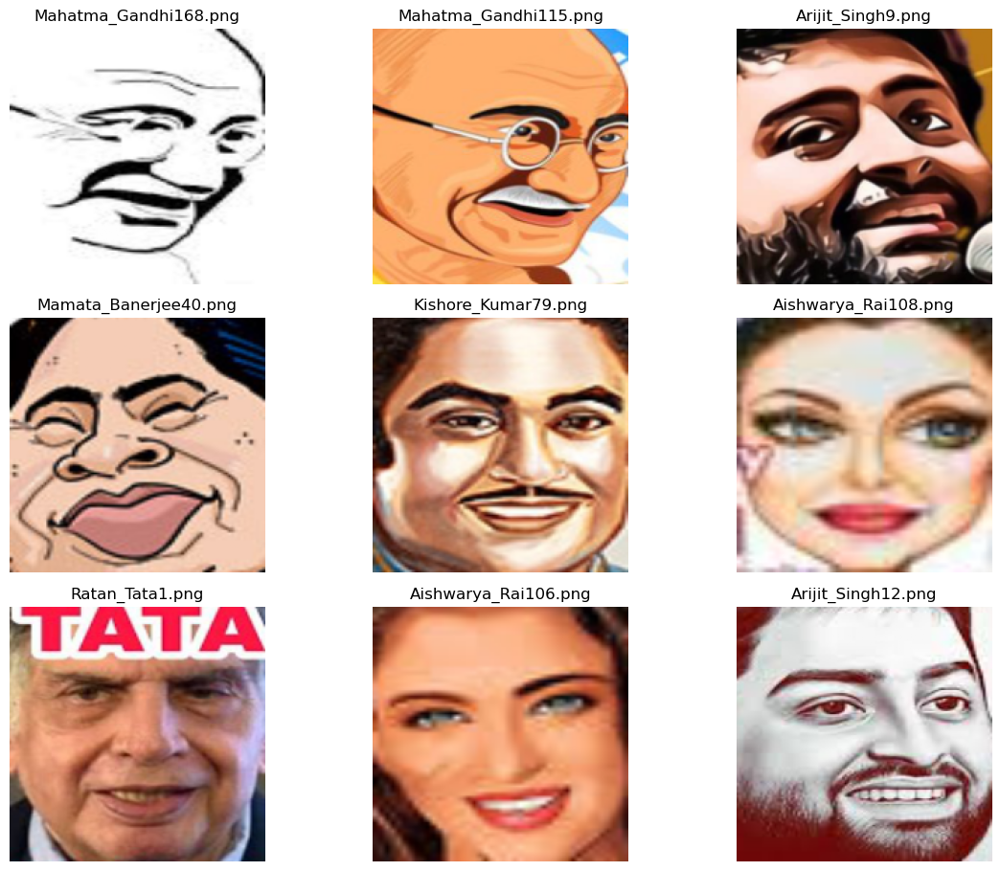

In [31]:
import os
PATH = 'D:/CODING/BrainDead/brain_dead_emotion_detection/train/happy/'
images = os.listdir(PATH)
print(f'There are {len(os.listdir(PATH))} happy pictures .')

fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(12,10))

for indx, axis in enumerate(axes.flatten()):
    rnd_indx = np.random.randint(0, len(os.listdir(PATH)))
    # https://matplotlib.org/users/image_tutorial.html
    img = plt.imread(PATH + images[rnd_indx])
    imgplot = axis.imshow(img)
    axis.set_title(images[rnd_indx])
    axis.set_axis_off()
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

In [32]:
batch_size = 32
image_size = 64
def train_img(path):
    random_transforms = [transforms.ColorJitter(), transforms.RandomRotation(degrees=20)]
    transform = transforms.Compose([transforms.Resize(64),
                                    transforms.CenterCrop(64),
                                    transforms.RandomHorizontalFlip(p=0.5),
                                    transforms.RandomApply(random_transforms, p=0.2),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
    
    path='D:/CODING/BrainDead/brain_dead_emotion_detection/'+path

    train_data = datasets.ImageFolder(path, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_data, shuffle=True,
                                            batch_size=batch_size)
                                            
    imgs, label = next(iter(train_loader))
    imgs = imgs.numpy().transpose(0, 2, 3, 1)

    for i in range(5):
        plt.imshow(imgs[i])
        plt.show()

In [33]:
def weights_init(m):
    """
    Takes as input a neural network m that will initialize all its weights.
    """
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

<h2><b>Generator-Discriminator 2

In [34]:
class Generator(nn.Module):
    def __init__(self, nz=128, channels=3):
        super(Generator, self).__init__()
        
        self.nz = nz
        self.channels = channels
        
        def convlayer(n_input, n_output, k_size=4, stride=2, padding=0):
            block = [
                nn.ConvTranspose2d(n_input, n_output, kernel_size=k_size, stride=stride, padding=padding, bias=False),
                nn.BatchNorm2d(n_output),
                nn.ReLU(inplace=True),
            ]
            return block

        self.model = nn.Sequential(
            *convlayer(self.nz, 1024, 4, 1, 0), # Fully connected layer via convolution.
            *convlayer(1024, 512, 4, 2, 1),
            *convlayer(512, 256, 4, 2, 1),
            *convlayer(256, 128, 4, 2, 1),
            *convlayer(128, 64, 4, 2, 1),
            nn.ConvTranspose2d(64, self.channels, 3, 1, 1),
            nn.Tanh()
        )

    def forward(self, z):
        z = z.view(-1, self.nz, 1, 1)
        img = self.model(z)
        return img

    
class Discriminator(nn.Module):
    def __init__(self, channels=3):
        super(Discriminator, self).__init__()
        
        self.channels = channels

        def convlayer(n_input, n_output, k_size=4, stride=2, padding=0, bn=False):
            block = [nn.Conv2d(n_input, n_output, kernel_size=k_size, stride=stride, padding=padding, bias=False)]
            if bn:
                block.append(nn.BatchNorm2d(n_output))
            block.append(nn.LeakyReLU(0.2, inplace=True))
            return block

        self.model = nn.Sequential(
            *convlayer(self.channels, 32, 4, 2, 1),
            *convlayer(32, 64, 4, 2, 1),
            *convlayer(64, 128, 4, 2, 1, bn=True),
            *convlayer(128, 256, 4, 2, 1, bn=True),
            nn.Conv2d(256, 1, 4, 1, 0, bias=False),  # FC with Conv.
        )

    def forward(self, imgs):
        logits = self.model(imgs)
        out = torch.sigmoid(logits)
    
        return out.view(-1, 1)

<h2><b>Training

In [35]:
batch_size = 32
LR_G = 0.001
LR_D = 0.0005

beta1 = 0.5
epochs = 100

real_label = 0.9
fake_label = 0
nz = 128

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


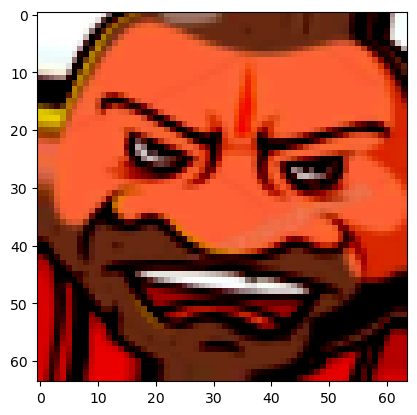

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


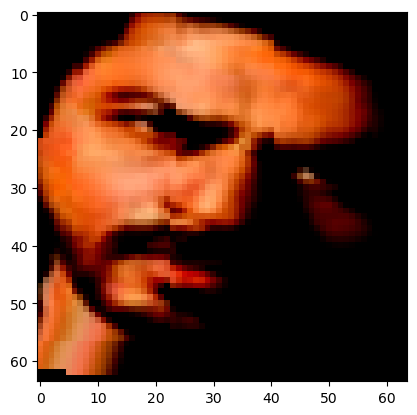

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


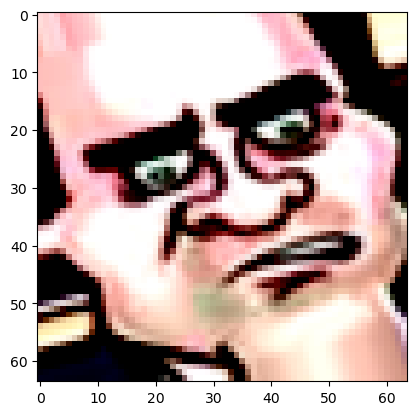

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


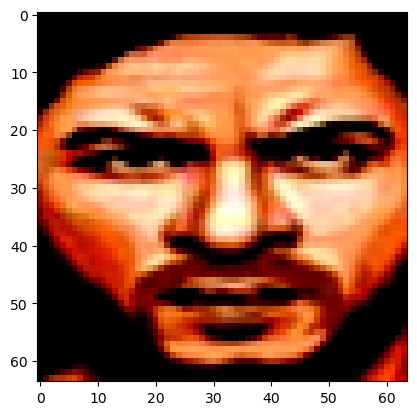

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


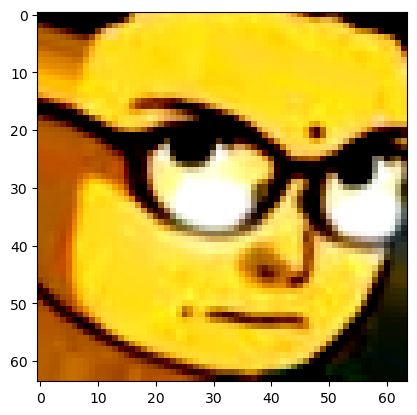

C:\Users\Samaresh Maiti\AppData\Local\Temp\ipykernel_24476\3243673685.py:21: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for ii, (real_images, train_labels) in tqdm(enumerate(train_loader), total=len(train_loader)):


  0%|          | 0/19 [00:00<?, ?it/s]

[1/100][9/19] Loss_D: 0.4475 Loss_G: 6.4902 D(x): 0.8759 D(G(z)): 0.0826 / 0.0007
[1/100][18/19] Loss_D: 0.6314 Loss_G: 7.5411 D(x): 0.9025 D(G(z)): 0.2327 / 0.0002


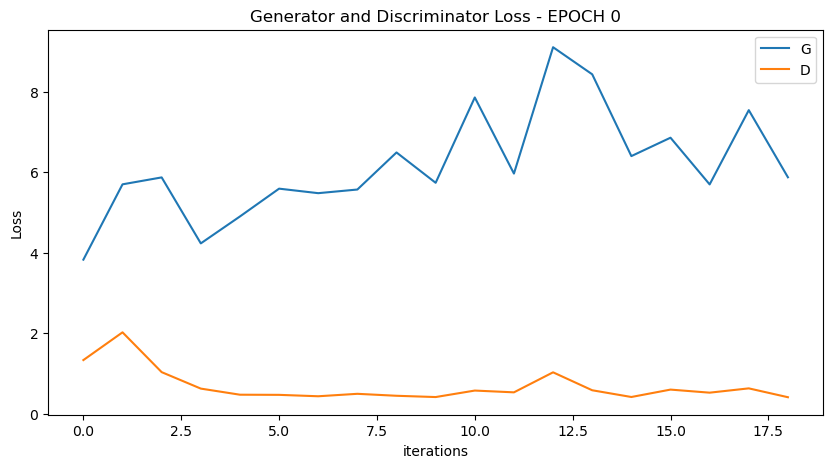

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


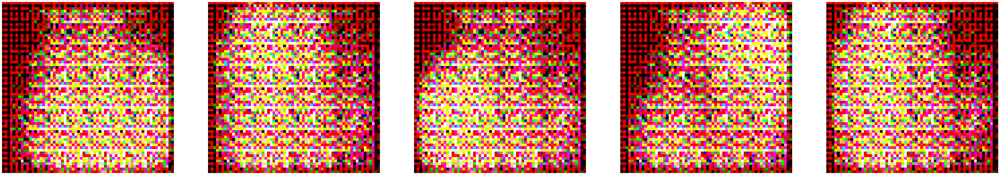

  0%|          | 0/19 [00:00<?, ?it/s]

[2/100][9/19] Loss_D: 1.4360 Loss_G: 2.9185 D(x): 0.3182 D(G(z)): 0.0145 / 0.0645
[2/100][18/19] Loss_D: 1.1969 Loss_G: 2.1285 D(x): 0.6089 D(G(z)): 0.3629 / 0.1145


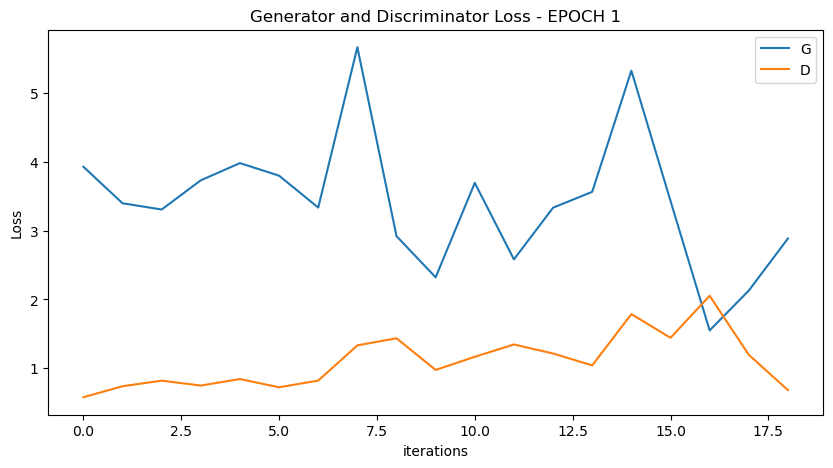

  0%|          | 0/19 [00:00<?, ?it/s]

[3/100][9/19] Loss_D: 1.1364 Loss_G: 2.6804 D(x): 0.6645 D(G(z)): 0.3636 / 0.0645
[3/100][18/19] Loss_D: 1.4825 Loss_G: 4.1918 D(x): 0.7982 D(G(z)): 0.5797 / 0.0107


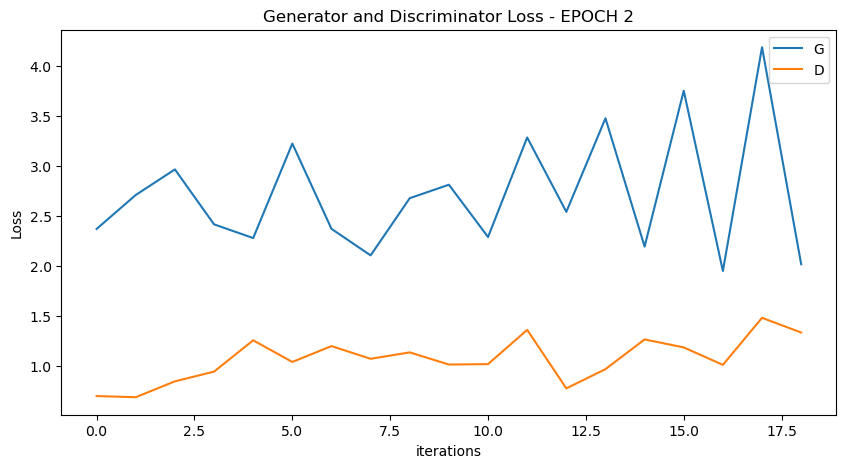

  0%|          | 0/19 [00:00<?, ?it/s]

[4/100][9/19] Loss_D: 1.0096 Loss_G: 2.5168 D(x): 0.5160 D(G(z)): 0.1907 / 0.0698
[4/100][18/19] Loss_D: 1.6312 Loss_G: 3.5543 D(x): 0.8188 D(G(z)): 0.6642 / 0.0280


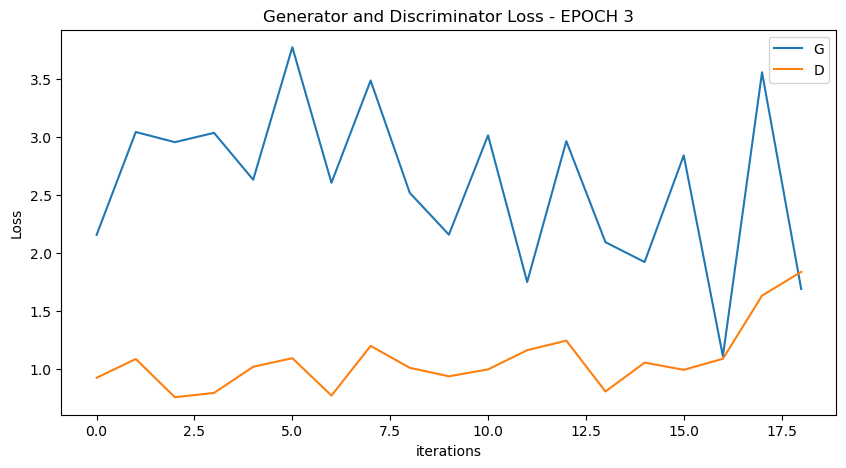

  0%|          | 0/19 [00:00<?, ?it/s]

[5/100][9/19] Loss_D: 1.1525 Loss_G: 1.6183 D(x): 0.5683 D(G(z)): 0.3670 / 0.2009
[5/100][18/19] Loss_D: 1.0158 Loss_G: 1.3881 D(x): 0.6083 D(G(z)): 0.3471 / 0.2339


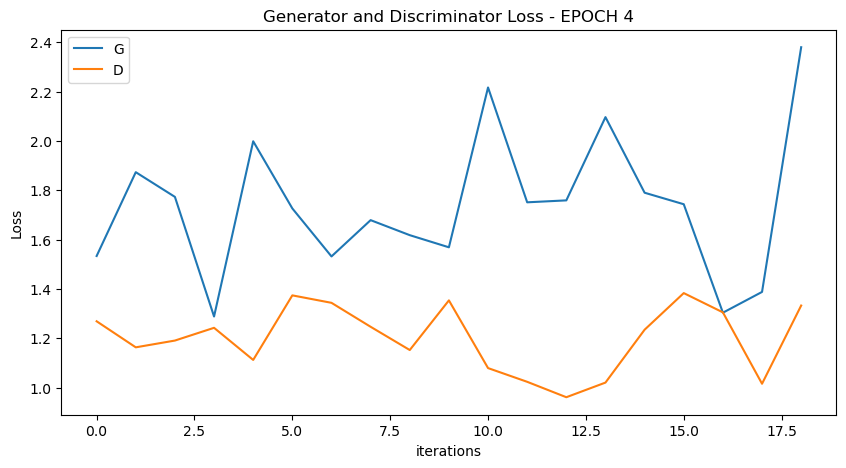

  0%|          | 0/19 [00:00<?, ?it/s]

[6/100][9/19] Loss_D: 1.0288 Loss_G: 1.9927 D(x): 0.6659 D(G(z)): 0.3962 / 0.1260
[6/100][18/19] Loss_D: 1.0287 Loss_G: 2.7201 D(x): 0.6922 D(G(z)): 0.3910 / 0.0553


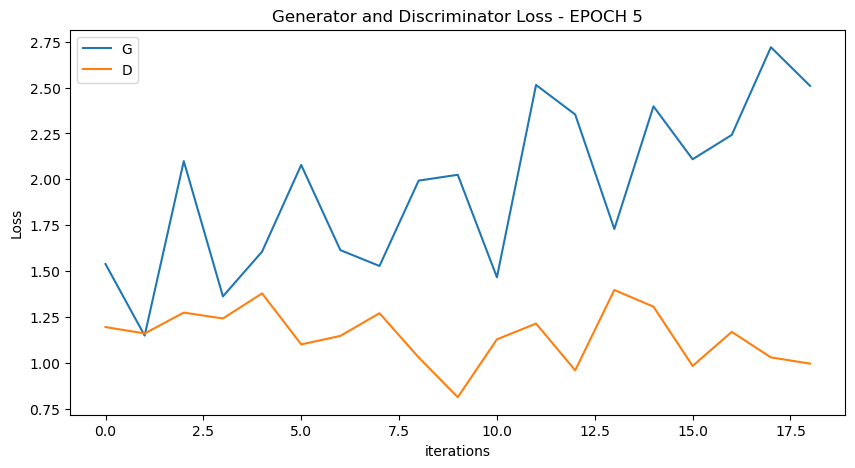

  0%|          | 0/19 [00:00<?, ?it/s]

[7/100][9/19] Loss_D: 1.0594 Loss_G: 1.5376 D(x): 0.5120 D(G(z)): 0.2767 / 0.1993
[7/100][18/19] Loss_D: 0.9445 Loss_G: 2.0756 D(x): 0.5405 D(G(z)): 0.2185 / 0.1192


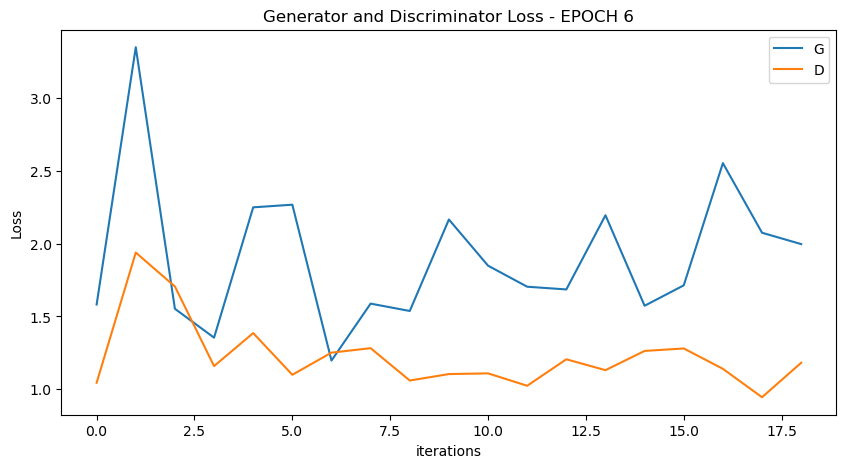

  0%|          | 0/19 [00:00<?, ?it/s]

[8/100][9/19] Loss_D: 1.4435 Loss_G: 1.5862 D(x): 0.4421 D(G(z)): 0.4144 / 0.1903
[8/100][18/19] Loss_D: 1.3699 Loss_G: 1.5021 D(x): 0.4917 D(G(z)): 0.4568 / 0.2004


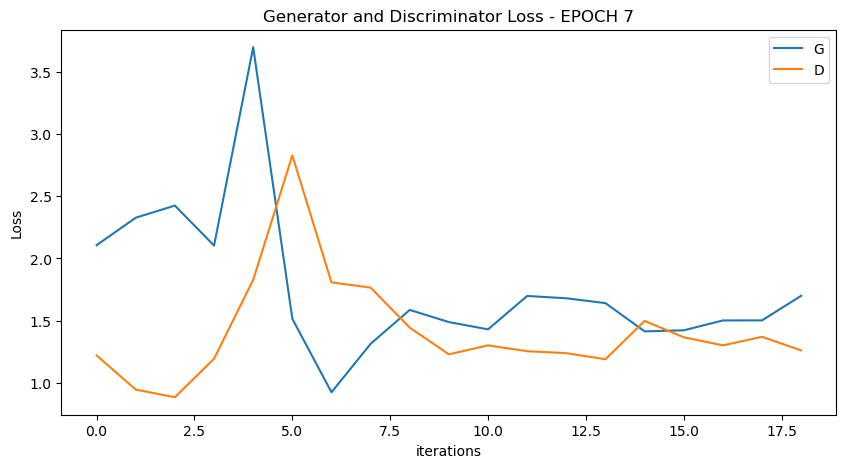

  0%|          | 0/19 [00:00<?, ?it/s]

[9/100][9/19] Loss_D: 1.5450 Loss_G: 1.6801 D(x): 0.4837 D(G(z)): 0.5219 / 0.1761
[9/100][18/19] Loss_D: 1.5073 Loss_G: 1.3046 D(x): 0.3790 D(G(z)): 0.4043 / 0.2507


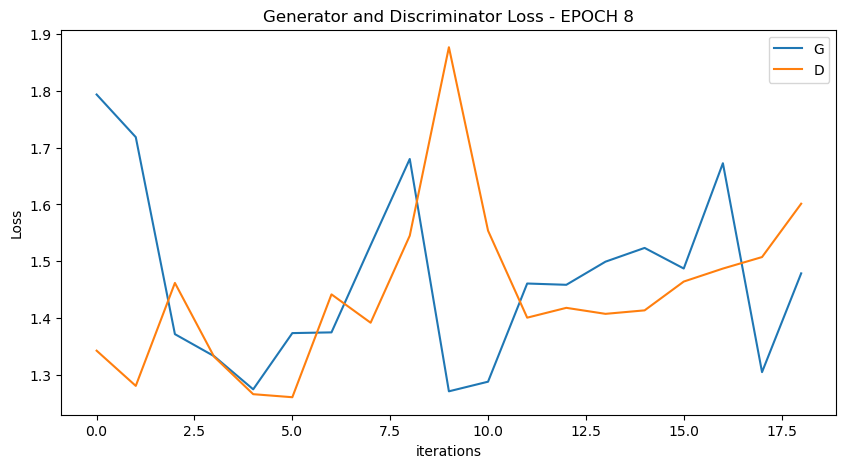

  0%|          | 0/19 [00:00<?, ?it/s]

[10/100][9/19] Loss_D: 1.4132 Loss_G: 1.1893 D(x): 0.4050 D(G(z)): 0.3774 / 0.2841
[10/100][18/19] Loss_D: 1.4739 Loss_G: 1.2217 D(x): 0.3927 D(G(z)): 0.4073 / 0.2818


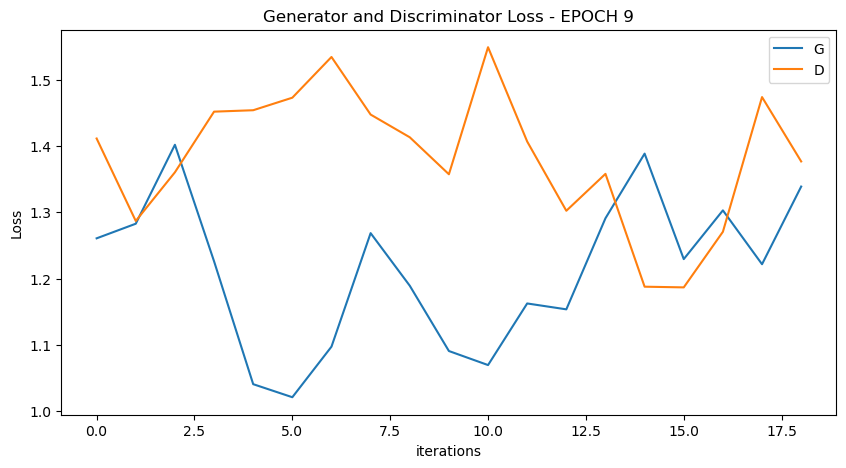

  0%|          | 0/19 [00:00<?, ?it/s]

[11/100][9/19] Loss_D: 1.4098 Loss_G: 1.2021 D(x): 0.4548 D(G(z)): 0.4493 / 0.2841
[11/100][18/19] Loss_D: 1.2866 Loss_G: 1.1136 D(x): 0.5084 D(G(z)): 0.4319 / 0.3205


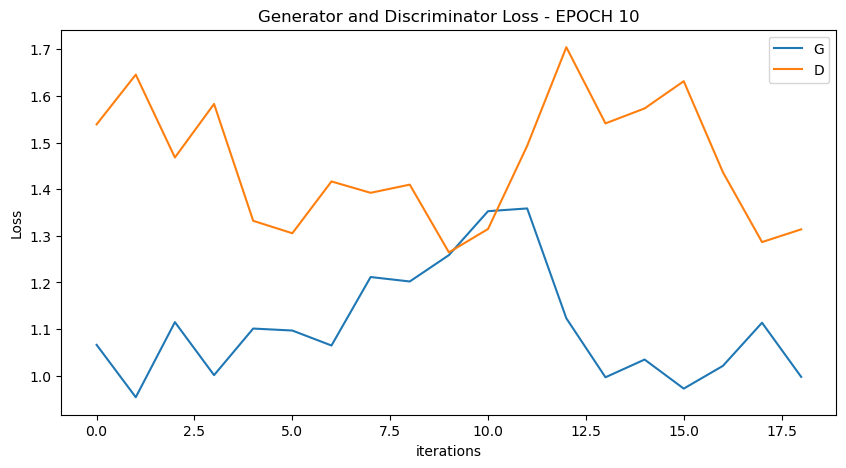

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


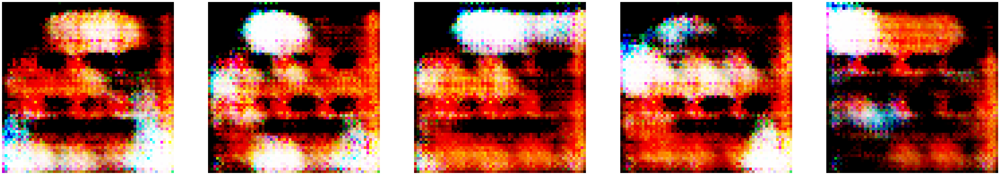

  0%|          | 0/19 [00:00<?, ?it/s]

[12/100][9/19] Loss_D: 1.6972 Loss_G: 1.2143 D(x): 0.3399 D(G(z)): 0.4560 / 0.2811
[12/100][18/19] Loss_D: 1.2474 Loss_G: 1.4415 D(x): 0.5423 D(G(z)): 0.4347 / 0.2182


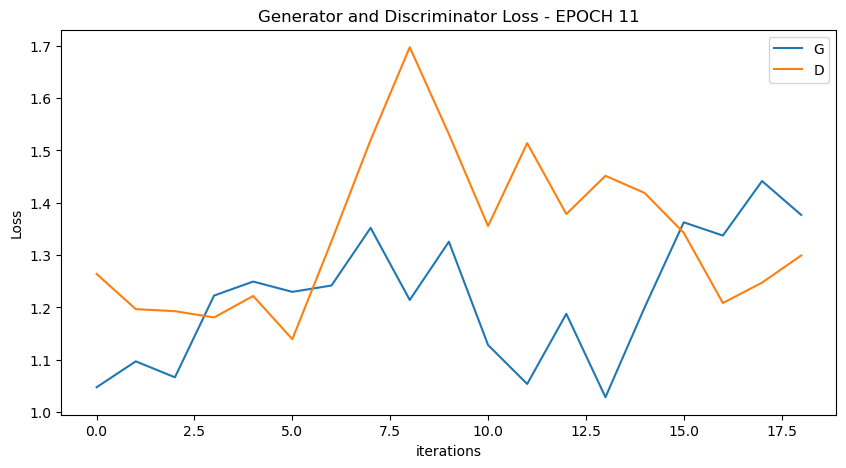

  0%|          | 0/19 [00:00<?, ?it/s]

[13/100][9/19] Loss_D: 1.3091 Loss_G: 1.3160 D(x): 0.4735 D(G(z)): 0.4025 / 0.2518
[13/100][18/19] Loss_D: 1.2385 Loss_G: 1.1851 D(x): 0.5728 D(G(z)): 0.4493 / 0.2835


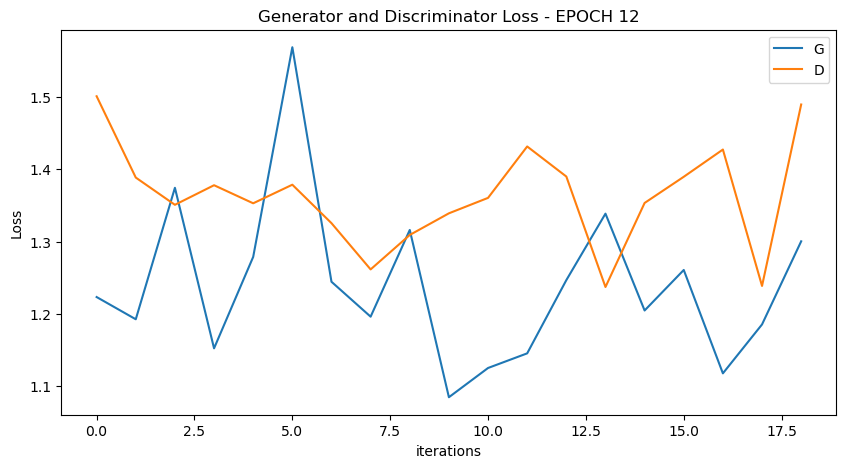

  0%|          | 0/19 [00:00<?, ?it/s]

[14/100][9/19] Loss_D: 1.1767 Loss_G: 1.2725 D(x): 0.5508 D(G(z)): 0.4001 / 0.2675
[14/100][18/19] Loss_D: 1.1703 Loss_G: 1.5541 D(x): 0.6374 D(G(z)): 0.4441 / 0.1975


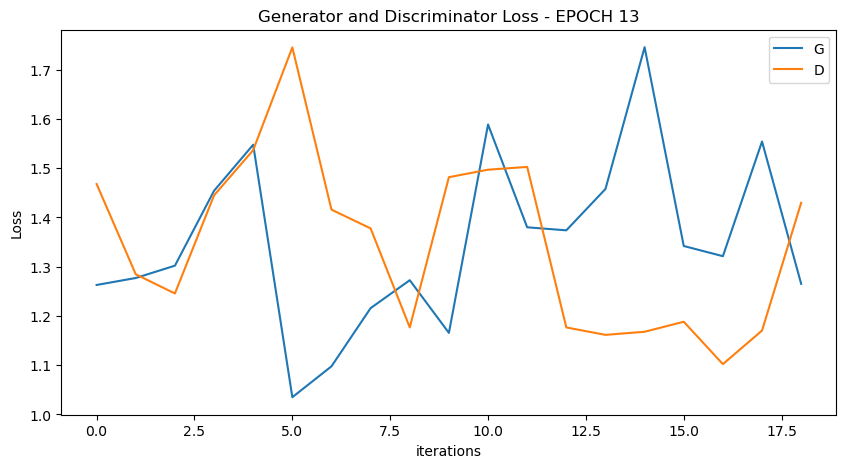

  0%|          | 0/19 [00:00<?, ?it/s]

[15/100][9/19] Loss_D: 1.2302 Loss_G: 1.2394 D(x): 0.4516 D(G(z)): 0.3221 / 0.2726
[15/100][18/19] Loss_D: 1.2339 Loss_G: 1.7679 D(x): 0.7067 D(G(z)): 0.5180 / 0.1553


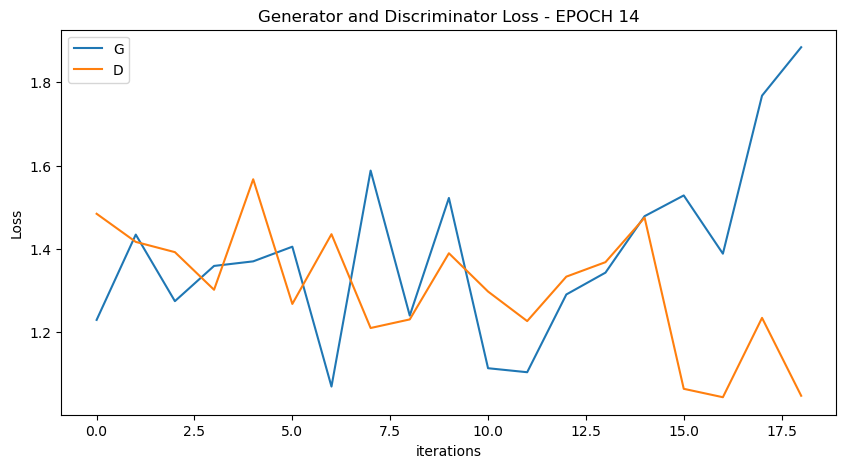

  0%|          | 0/19 [00:00<?, ?it/s]

[16/100][9/19] Loss_D: 1.6718 Loss_G: 2.4116 D(x): 0.6825 D(G(z)): 0.6718 / 0.0760
[16/100][18/19] Loss_D: 1.3231 Loss_G: 1.6007 D(x): 0.5582 D(G(z)): 0.4760 / 0.1907


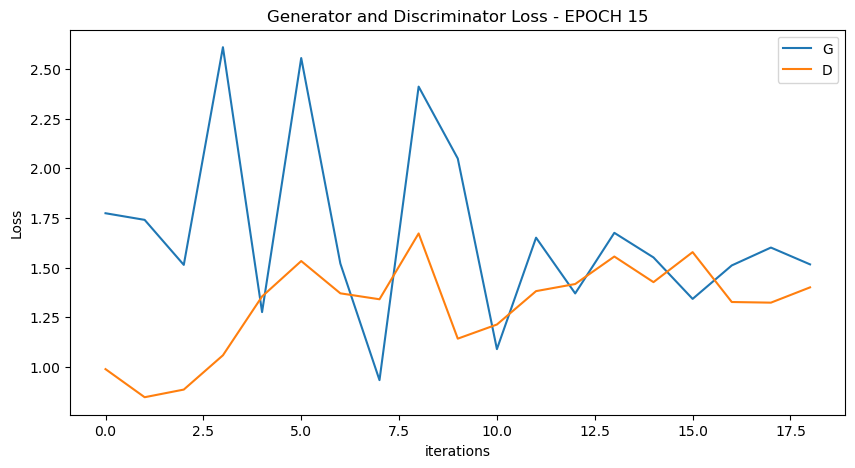

  0%|          | 0/19 [00:00<?, ?it/s]

[17/100][9/19] Loss_D: 1.1630 Loss_G: 1.3979 D(x): 0.5309 D(G(z)): 0.3686 / 0.2387
[17/100][18/19] Loss_D: 1.2870 Loss_G: 1.3444 D(x): 0.4563 D(G(z)): 0.3717 / 0.2411


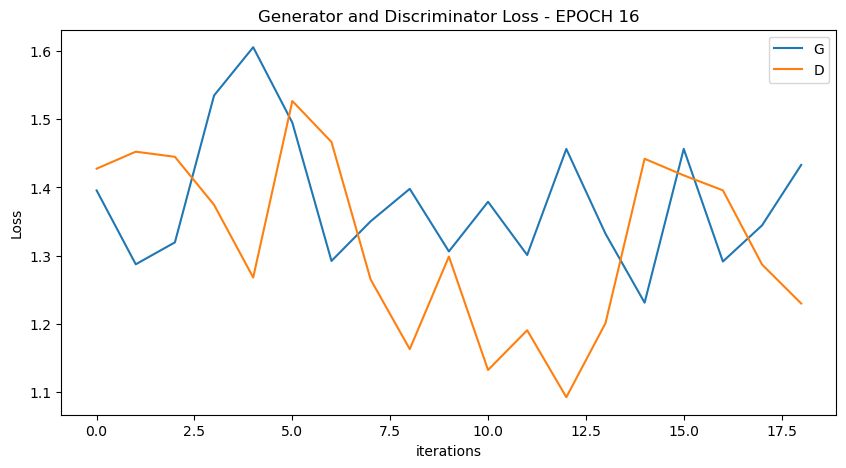

  0%|          | 0/19 [00:00<?, ?it/s]

[18/100][9/19] Loss_D: 1.3734 Loss_G: 1.1700 D(x): 0.4387 D(G(z)): 0.4100 / 0.3056
[18/100][18/19] Loss_D: 1.2622 Loss_G: 1.2535 D(x): 0.5286 D(G(z)): 0.4316 / 0.2919


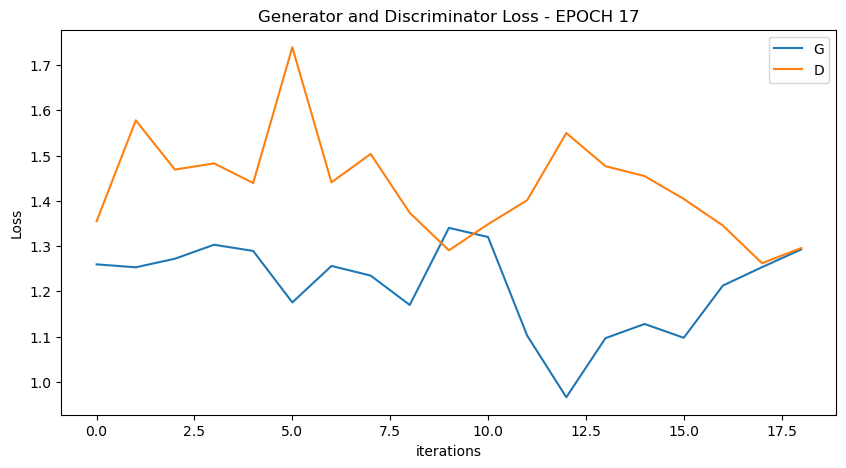

  0%|          | 0/19 [00:00<?, ?it/s]

[19/100][9/19] Loss_D: 1.5153 Loss_G: 1.2265 D(x): 0.4069 D(G(z)): 0.4490 / 0.2808
[19/100][18/19] Loss_D: 1.3679 Loss_G: 1.1609 D(x): 0.4787 D(G(z)): 0.4393 / 0.3025


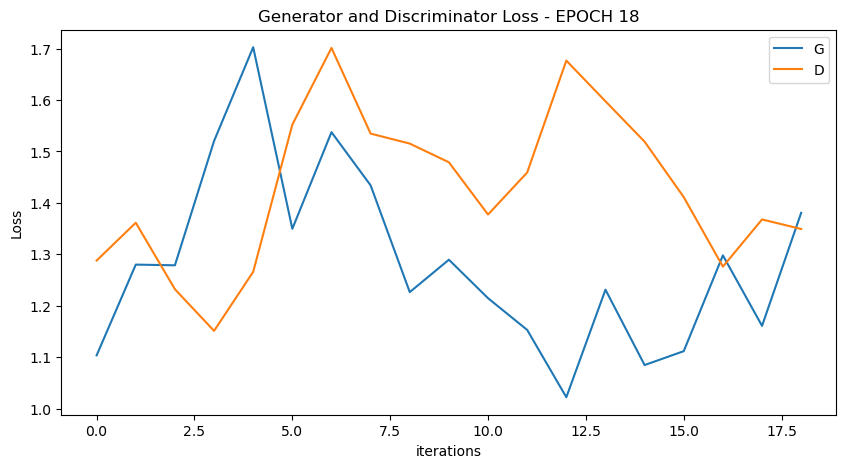

  0%|          | 0/19 [00:00<?, ?it/s]

[20/100][9/19] Loss_D: 1.4278 Loss_G: 1.2487 D(x): 0.4430 D(G(z)): 0.4300 / 0.2768
[20/100][18/19] Loss_D: 1.1756 Loss_G: 1.3961 D(x): 0.5444 D(G(z)): 0.3901 / 0.2307


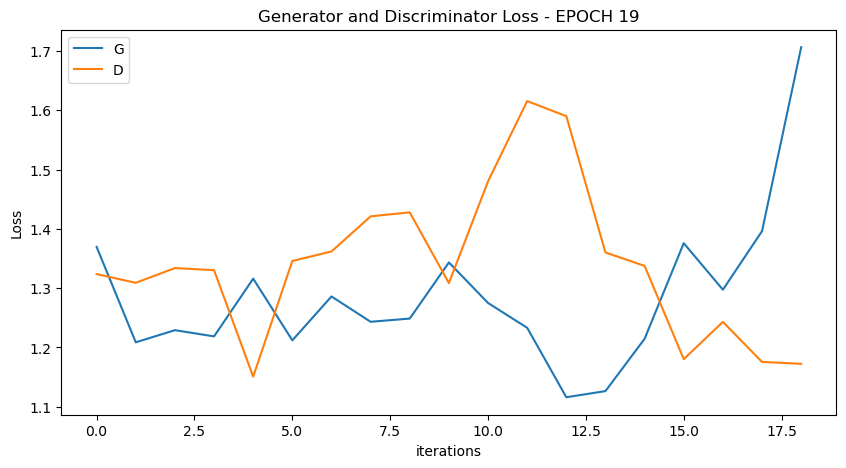

  0%|          | 0/19 [00:00<?, ?it/s]

[21/100][9/19] Loss_D: 1.3251 Loss_G: 1.5117 D(x): 0.5764 D(G(z)): 0.4997 / 0.1970
[21/100][18/19] Loss_D: 1.3986 Loss_G: 1.2717 D(x): 0.4646 D(G(z)): 0.4382 / 0.2699


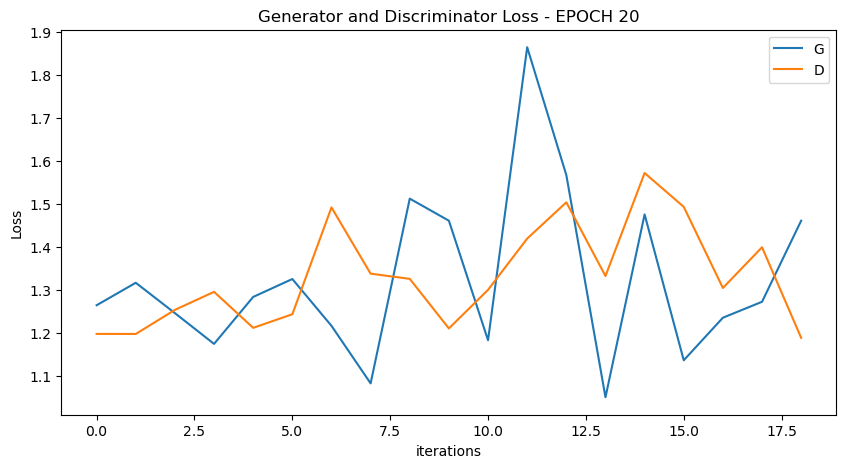

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


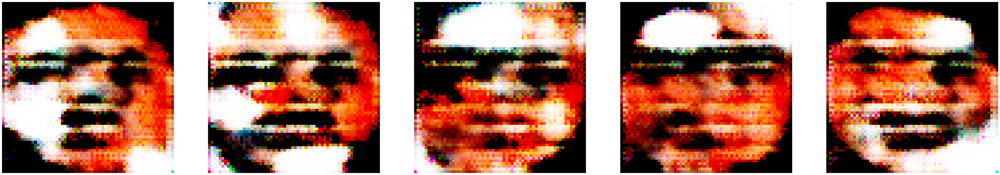

  0%|          | 0/19 [00:00<?, ?it/s]

[22/100][9/19] Loss_D: 1.4201 Loss_G: 1.1243 D(x): 0.5072 D(G(z)): 0.4866 / 0.3170
[22/100][18/19] Loss_D: 1.5036 Loss_G: 1.2702 D(x): 0.4661 D(G(z)): 0.4734 / 0.2589


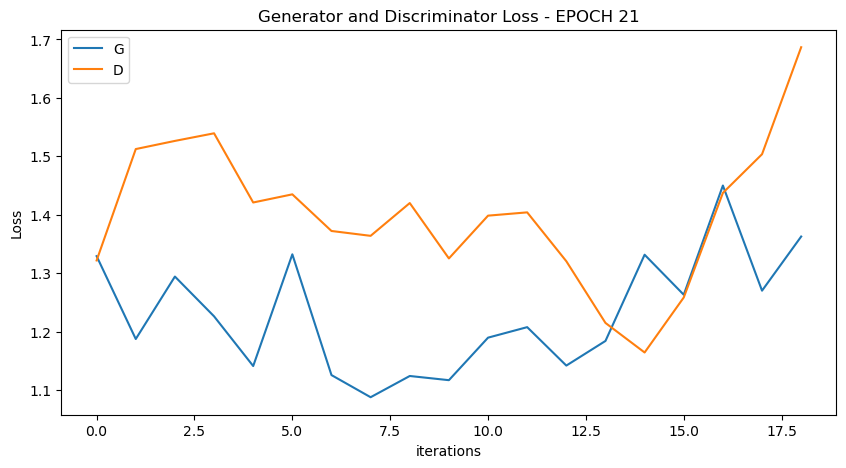

  0%|          | 0/19 [00:00<?, ?it/s]

[23/100][9/19] Loss_D: 1.3910 Loss_G: 1.3991 D(x): 0.4389 D(G(z)): 0.4121 / 0.2341
[23/100][18/19] Loss_D: 1.4307 Loss_G: 1.0849 D(x): 0.4622 D(G(z)): 0.4638 / 0.3196


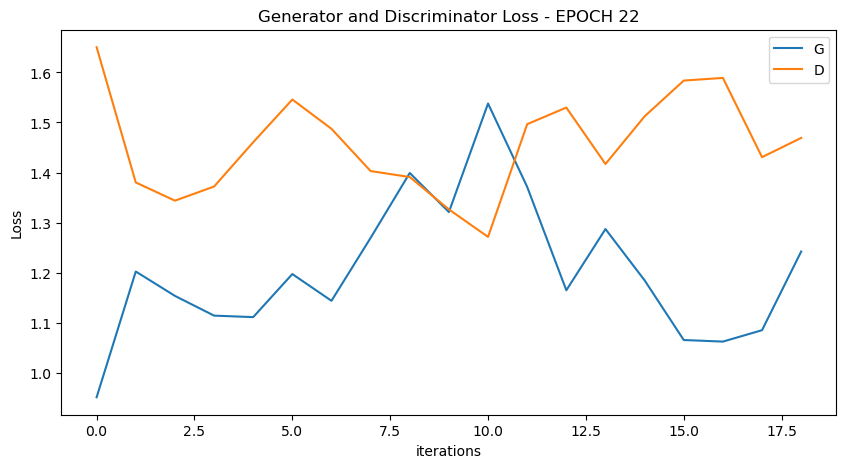

  0%|          | 0/19 [00:00<?, ?it/s]

[24/100][9/19] Loss_D: 1.3571 Loss_G: 1.2456 D(x): 0.4244 D(G(z)): 0.3832 / 0.2701
[24/100][18/19] Loss_D: 1.2715 Loss_G: 1.0653 D(x): 0.5040 D(G(z)): 0.4070 / 0.3379


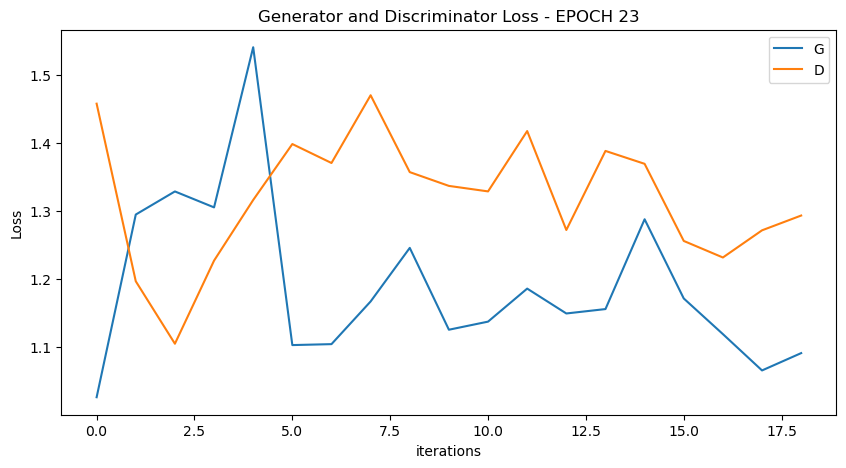

  0%|          | 0/19 [00:00<?, ?it/s]

[25/100][9/19] Loss_D: 1.6190 Loss_G: 1.1722 D(x): 0.3971 D(G(z)): 0.4902 / 0.2903
[25/100][18/19] Loss_D: 1.4218 Loss_G: 1.0216 D(x): 0.4710 D(G(z)): 0.4689 / 0.3514


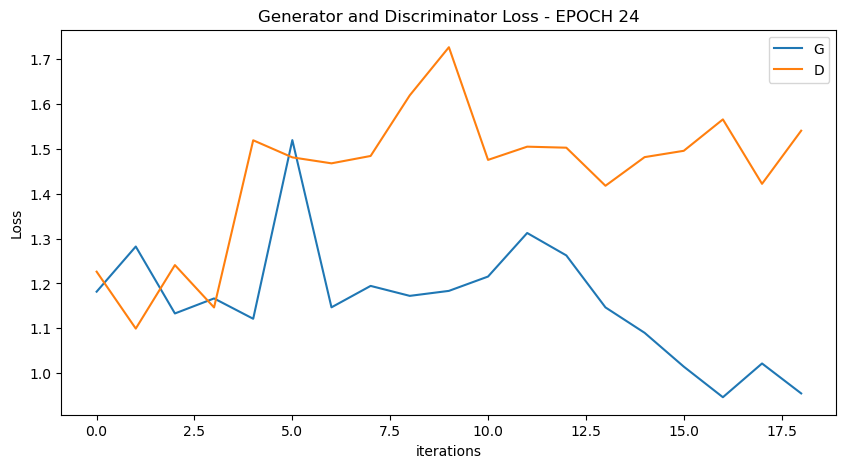

  0%|          | 0/19 [00:00<?, ?it/s]

[26/100][9/19] Loss_D: 1.3678 Loss_G: 1.1954 D(x): 0.3976 D(G(z)): 0.3615 / 0.2801
[26/100][18/19] Loss_D: 1.3976 Loss_G: 1.0091 D(x): 0.4584 D(G(z)): 0.4435 / 0.3485


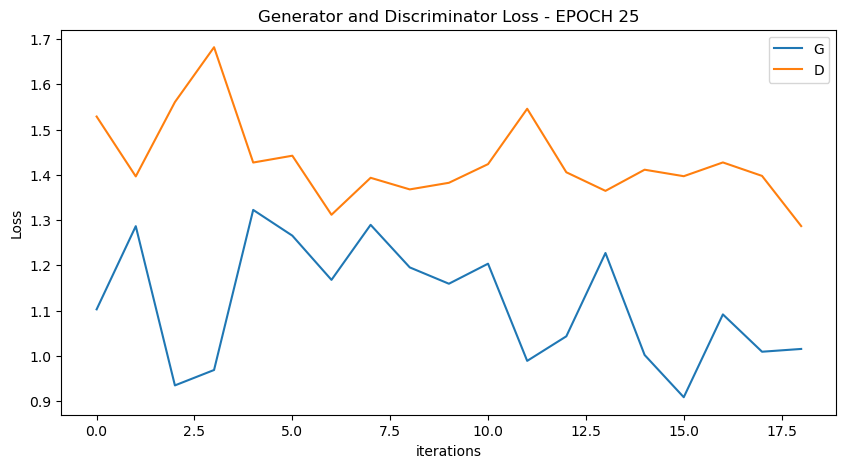

  0%|          | 0/19 [00:00<?, ?it/s]

[27/100][9/19] Loss_D: 1.3671 Loss_G: 1.1974 D(x): 0.4417 D(G(z)): 0.4161 / 0.2859
[27/100][18/19] Loss_D: 1.3058 Loss_G: 1.2116 D(x): 0.5157 D(G(z)): 0.4478 / 0.2779


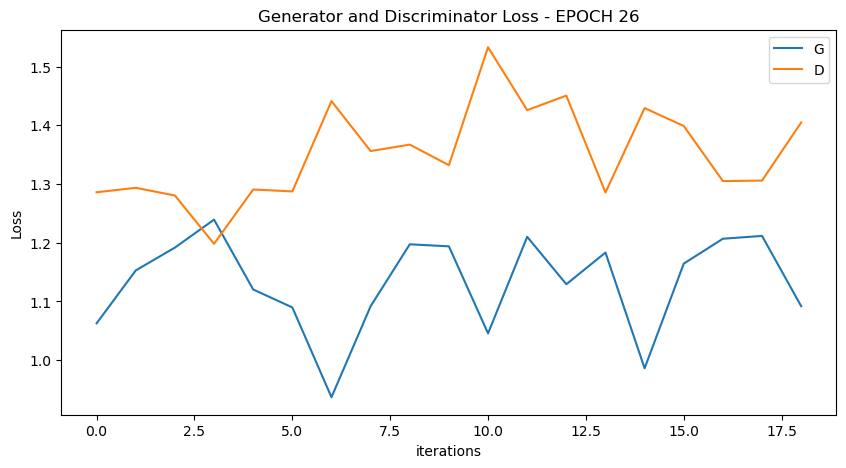

  0%|          | 0/19 [00:00<?, ?it/s]

[28/100][9/19] Loss_D: 1.5083 Loss_G: 1.0096 D(x): 0.3873 D(G(z)): 0.4225 / 0.3557
[28/100][18/19] Loss_D: 1.5528 Loss_G: 1.0828 D(x): 0.4329 D(G(z)): 0.4803 / 0.3247


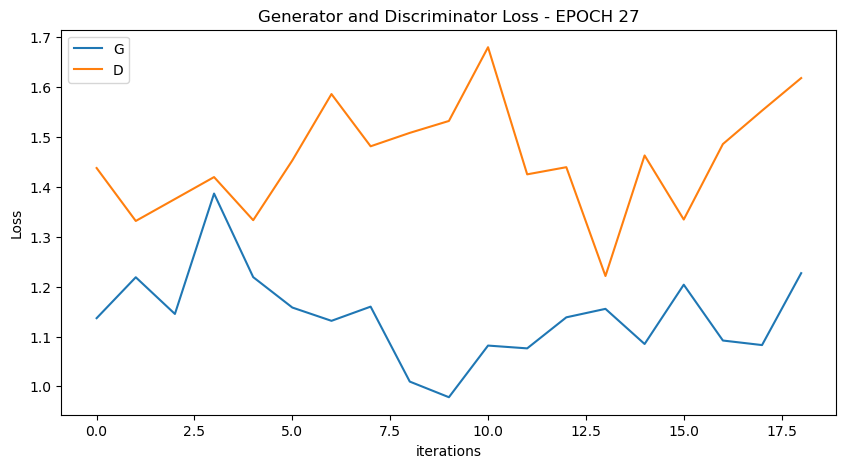

  0%|          | 0/19 [00:00<?, ?it/s]

[29/100][9/19] Loss_D: 1.3472 Loss_G: 1.0664 D(x): 0.5140 D(G(z)): 0.4791 / 0.3335
[29/100][18/19] Loss_D: 1.3409 Loss_G: 1.2119 D(x): 0.4643 D(G(z)): 0.4219 / 0.2779


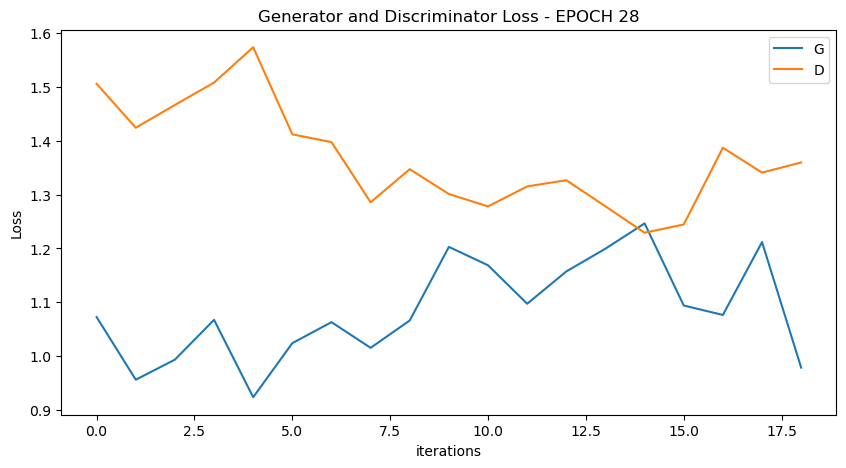

  0%|          | 0/19 [00:00<?, ?it/s]

[30/100][9/19] Loss_D: 1.2539 Loss_G: 1.1796 D(x): 0.5029 D(G(z)): 0.4168 / 0.2895
[30/100][18/19] Loss_D: 1.3808 Loss_G: 0.9773 D(x): 0.5157 D(G(z)): 0.4823 / 0.3695


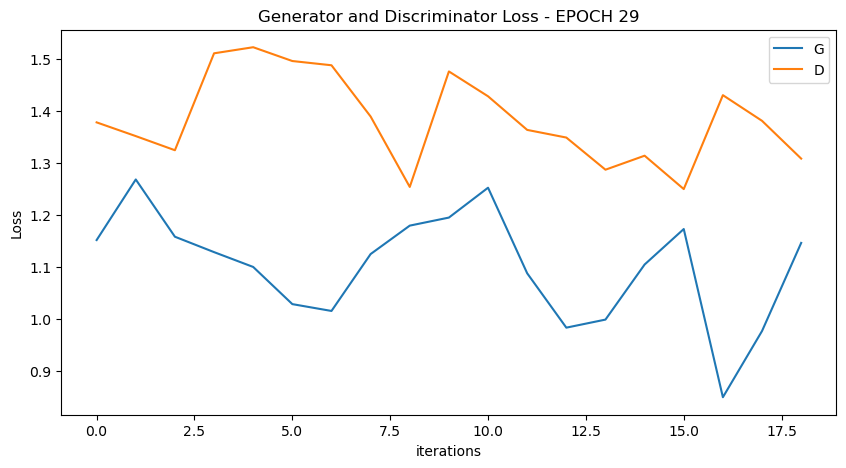

  0%|          | 0/19 [00:00<?, ?it/s]

[31/100][9/19] Loss_D: 1.3900 Loss_G: 1.0529 D(x): 0.4863 D(G(z)): 0.4758 / 0.3331
[31/100][18/19] Loss_D: 1.4479 Loss_G: 1.0763 D(x): 0.4250 D(G(z)): 0.4507 / 0.3206


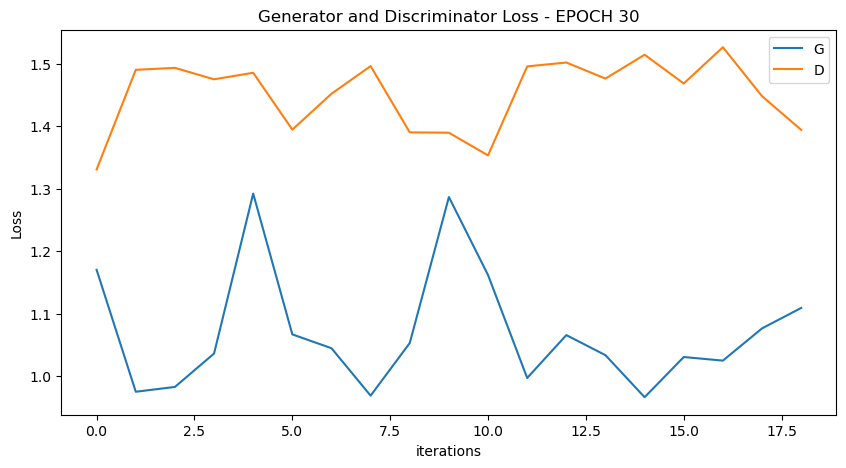

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


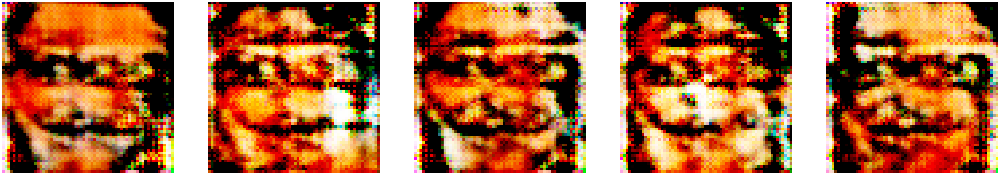

  0%|          | 0/19 [00:00<?, ?it/s]

[32/100][9/19] Loss_D: 1.3886 Loss_G: 1.2094 D(x): 0.5346 D(G(z)): 0.5069 / 0.2814
[32/100][18/19] Loss_D: 1.5074 Loss_G: 1.5611 D(x): 0.3562 D(G(z)): 0.3762 / 0.1887


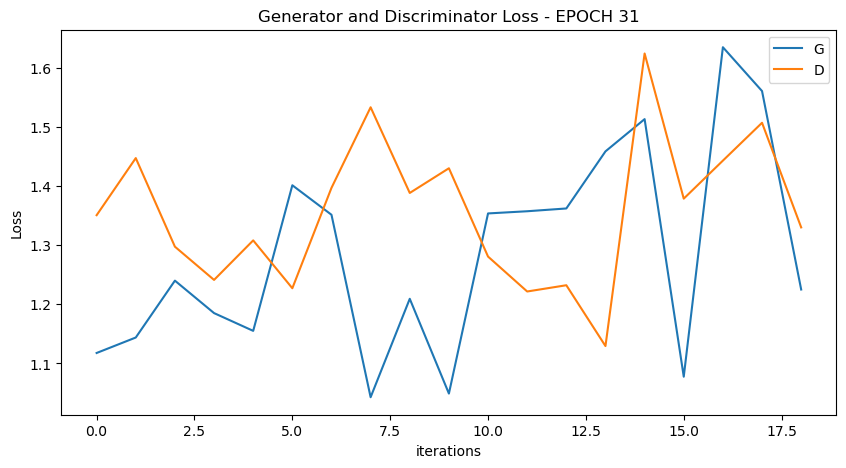

  0%|          | 0/19 [00:00<?, ?it/s]

[33/100][9/19] Loss_D: 1.1635 Loss_G: 1.2233 D(x): 0.4848 D(G(z)): 0.3205 / 0.2932
[33/100][18/19] Loss_D: 1.2684 Loss_G: 1.1882 D(x): 0.5319 D(G(z)): 0.4280 / 0.2849


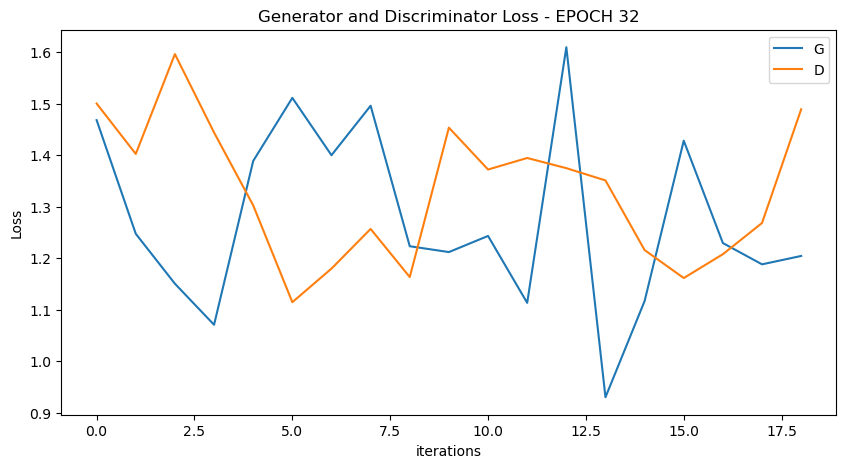

  0%|          | 0/19 [00:00<?, ?it/s]

[34/100][9/19] Loss_D: 1.5166 Loss_G: 1.1440 D(x): 0.3712 D(G(z)): 0.4240 / 0.3001
[34/100][18/19] Loss_D: 1.4922 Loss_G: 1.2215 D(x): 0.3869 D(G(z)): 0.4203 / 0.2812


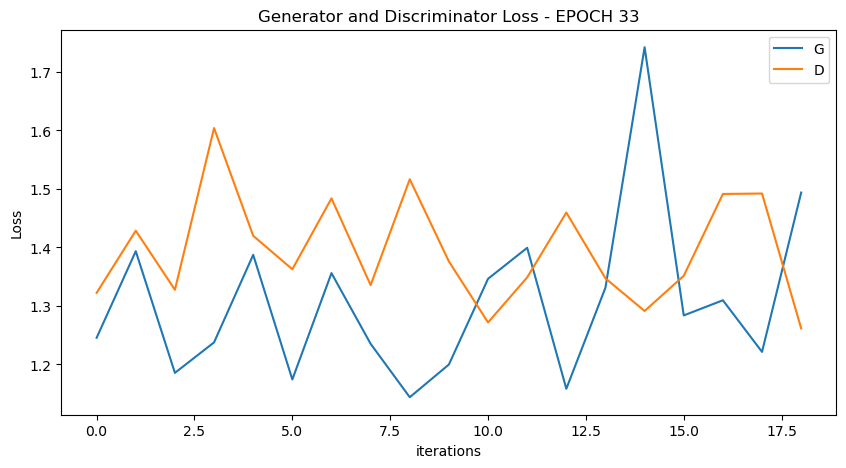

  0%|          | 0/19 [00:00<?, ?it/s]

[35/100][9/19] Loss_D: 1.3466 Loss_G: 1.1546 D(x): 0.4377 D(G(z)): 0.3896 / 0.3030
[35/100][18/19] Loss_D: 1.4497 Loss_G: 1.2894 D(x): 0.5567 D(G(z)): 0.5476 / 0.2571


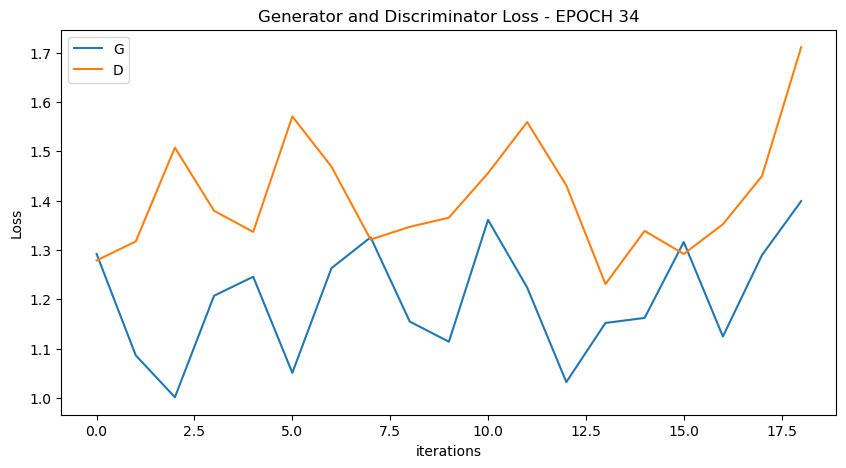

  0%|          | 0/19 [00:00<?, ?it/s]

[36/100][9/19] Loss_D: 1.2840 Loss_G: 1.4317 D(x): 0.5419 D(G(z)): 0.4450 / 0.2224
[36/100][18/19] Loss_D: 1.6310 Loss_G: 1.2918 D(x): 0.4930 D(G(z)): 0.5408 / 0.2623


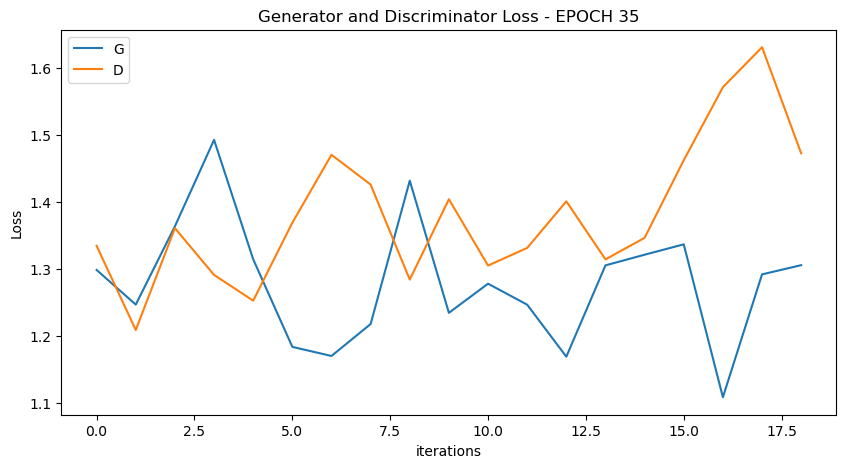

  0%|          | 0/19 [00:00<?, ?it/s]

[37/100][9/19] Loss_D: 1.3494 Loss_G: 1.0389 D(x): 0.4046 D(G(z)): 0.3564 / 0.3381
[37/100][18/19] Loss_D: 1.4976 Loss_G: 1.4001 D(x): 0.4540 D(G(z)): 0.4910 / 0.2326


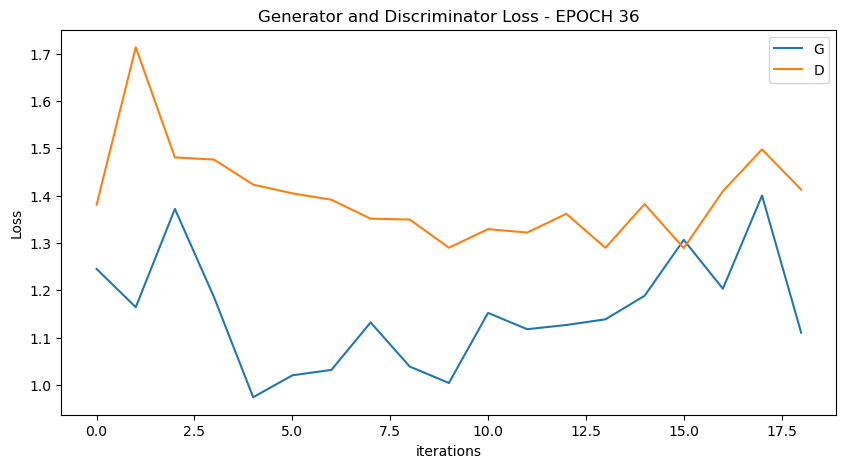

  0%|          | 0/19 [00:00<?, ?it/s]

[38/100][9/19] Loss_D: 1.1893 Loss_G: 1.0790 D(x): 0.5374 D(G(z)): 0.3983 / 0.3305
[38/100][18/19] Loss_D: 1.3355 Loss_G: 1.5798 D(x): 0.4810 D(G(z)): 0.4383 / 0.1973


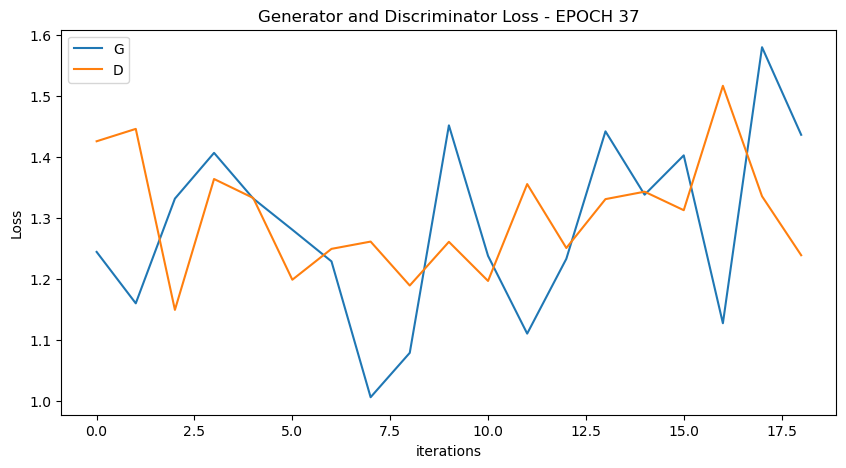

  0%|          | 0/19 [00:00<?, ?it/s]

[39/100][9/19] Loss_D: 1.1429 Loss_G: 1.3322 D(x): 0.5416 D(G(z)): 0.3746 / 0.2555
[39/100][18/19] Loss_D: 1.4526 Loss_G: 1.1760 D(x): 0.5571 D(G(z)): 0.5429 / 0.2981


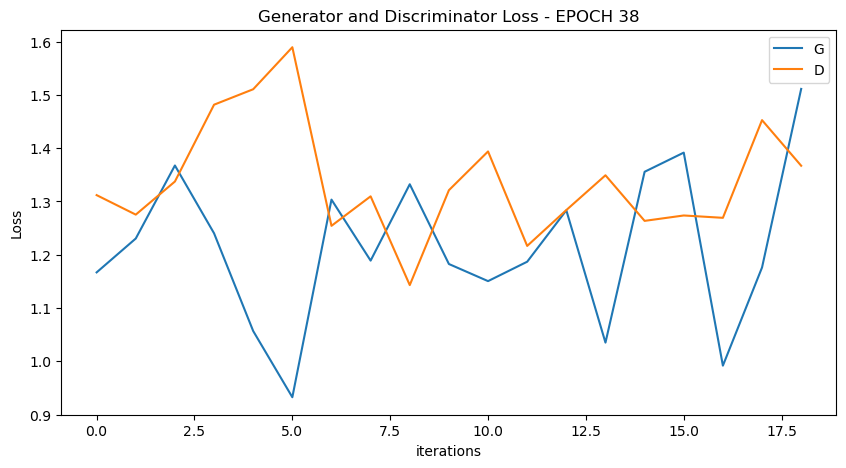

  0%|          | 0/19 [00:00<?, ?it/s]

[40/100][9/19] Loss_D: 1.4126 Loss_G: 1.1292 D(x): 0.4504 D(G(z)): 0.4425 / 0.3150
[40/100][18/19] Loss_D: 1.3779 Loss_G: 1.1345 D(x): 0.3916 D(G(z)): 0.3282 / 0.3149


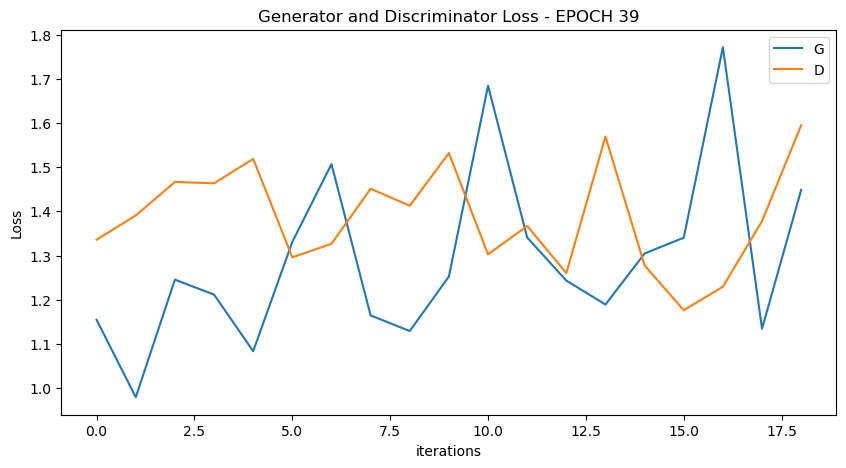

  0%|          | 0/19 [00:00<?, ?it/s]

[41/100][9/19] Loss_D: 1.5390 Loss_G: 1.2097 D(x): 0.4258 D(G(z)): 0.4870 / 0.2789
[41/100][18/19] Loss_D: 1.4464 Loss_G: 0.9602 D(x): 0.4540 D(G(z)): 0.4695 / 0.3729


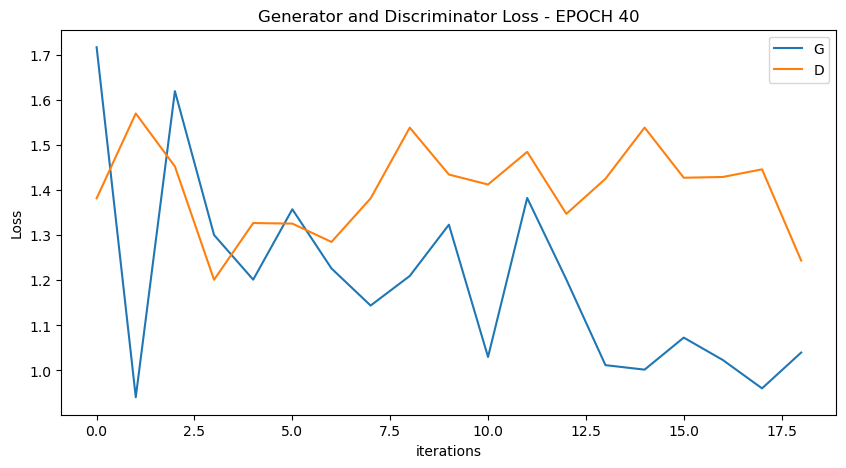

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


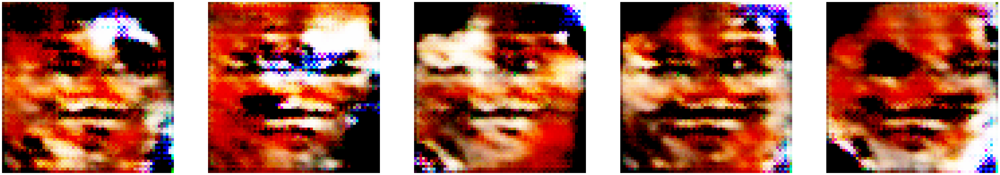

  0%|          | 0/19 [00:00<?, ?it/s]

[42/100][9/19] Loss_D: 1.2176 Loss_G: 1.2874 D(x): 0.5403 D(G(z)): 0.4225 / 0.2589
[42/100][18/19] Loss_D: 1.2070 Loss_G: 1.1293 D(x): 0.4798 D(G(z)): 0.3582 / 0.3121


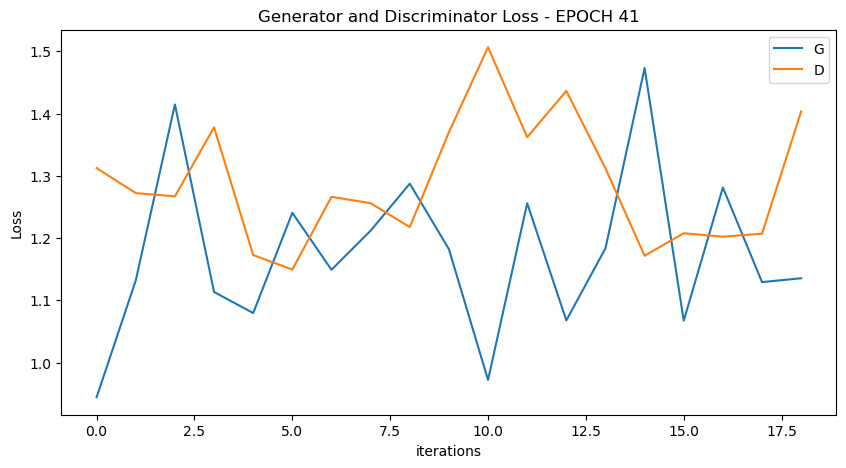

  0%|          | 0/19 [00:00<?, ?it/s]

[43/100][9/19] Loss_D: 1.3695 Loss_G: 1.1578 D(x): 0.4521 D(G(z)): 0.4228 / 0.3047
[43/100][18/19] Loss_D: 1.4109 Loss_G: 1.1955 D(x): 0.3943 D(G(z)): 0.3722 / 0.2846


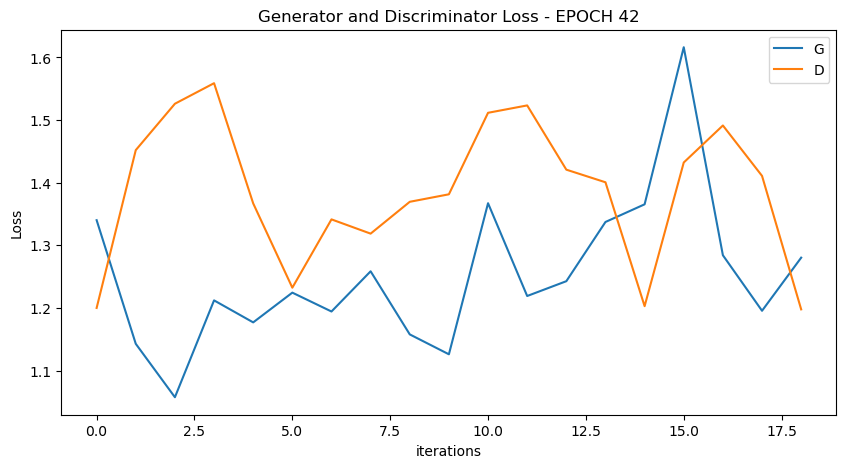

  0%|          | 0/19 [00:00<?, ?it/s]

[44/100][9/19] Loss_D: 1.4748 Loss_G: 1.4740 D(x): 0.3645 D(G(z)): 0.3632 / 0.2099
[44/100][18/19] Loss_D: 1.1221 Loss_G: 1.4797 D(x): 0.5312 D(G(z)): 0.3603 / 0.2067


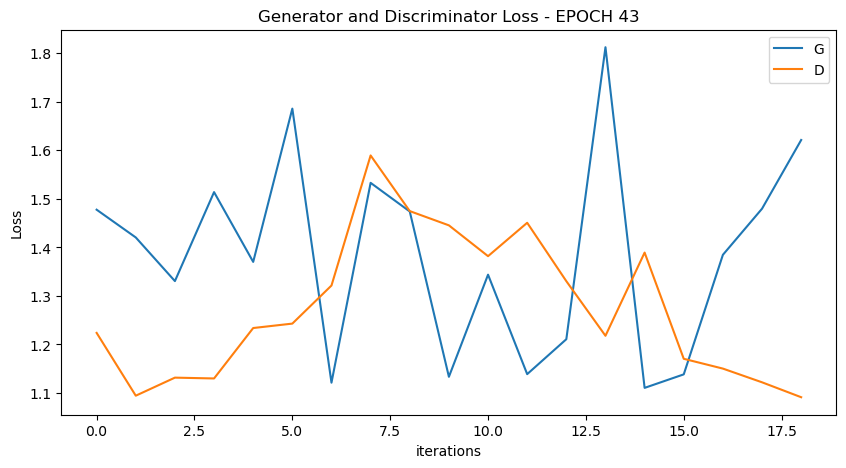

  0%|          | 0/19 [00:00<?, ?it/s]

[45/100][9/19] Loss_D: 1.2575 Loss_G: 1.0937 D(x): 0.4679 D(G(z)): 0.3741 / 0.3177
[45/100][18/19] Loss_D: 1.5675 Loss_G: 0.9113 D(x): 0.3982 D(G(z)): 0.4518 / 0.3949


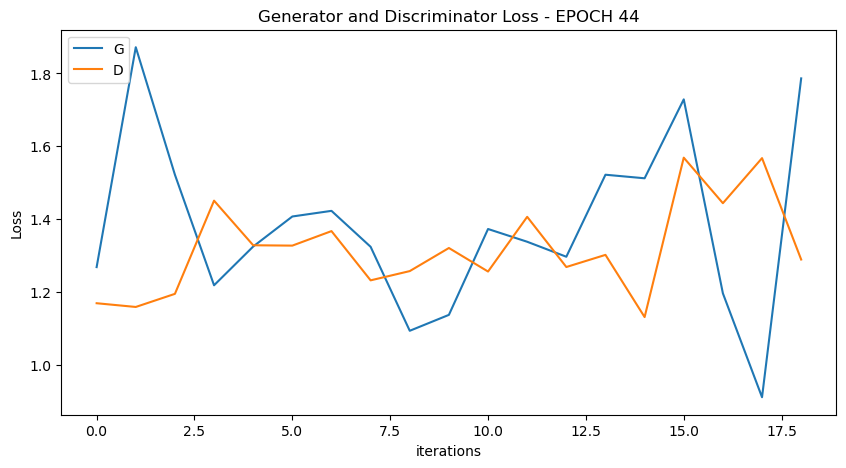

  0%|          | 0/19 [00:00<?, ?it/s]

[46/100][9/19] Loss_D: 1.6129 Loss_G: 0.8231 D(x): 0.3077 D(G(z)): 0.3732 / 0.4325
[46/100][18/19] Loss_D: 1.2199 Loss_G: 1.3800 D(x): 0.5008 D(G(z)): 0.3901 / 0.2275


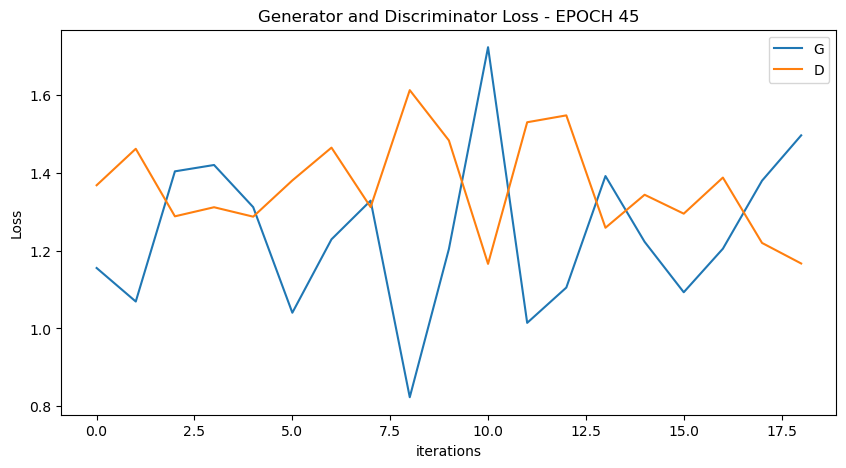

  0%|          | 0/19 [00:00<?, ?it/s]

[47/100][9/19] Loss_D: 1.2150 Loss_G: 1.5681 D(x): 0.5230 D(G(z)): 0.4088 / 0.2008
[47/100][18/19] Loss_D: 1.3626 Loss_G: 1.1979 D(x): 0.3568 D(G(z)): 0.2895 / 0.2930


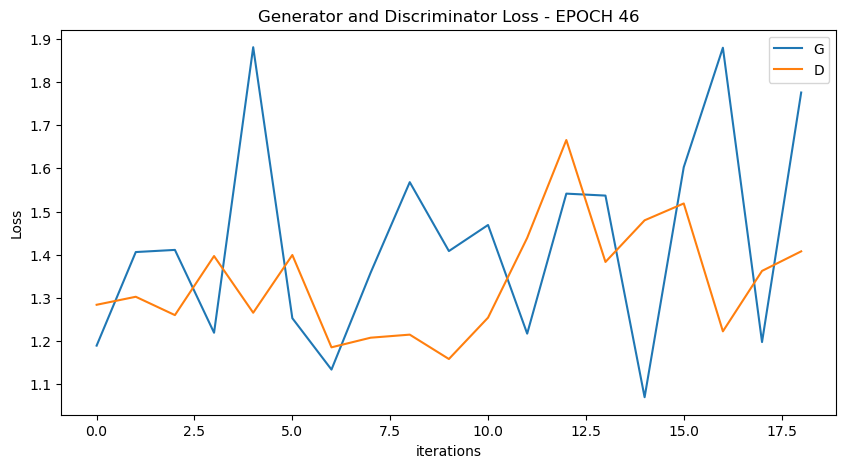

  0%|          | 0/19 [00:00<?, ?it/s]

[48/100][9/19] Loss_D: 1.2488 Loss_G: 1.0847 D(x): 0.4600 D(G(z)): 0.3468 / 0.3470
[48/100][18/19] Loss_D: 1.3270 Loss_G: 1.0610 D(x): 0.4271 D(G(z)): 0.3616 / 0.3294


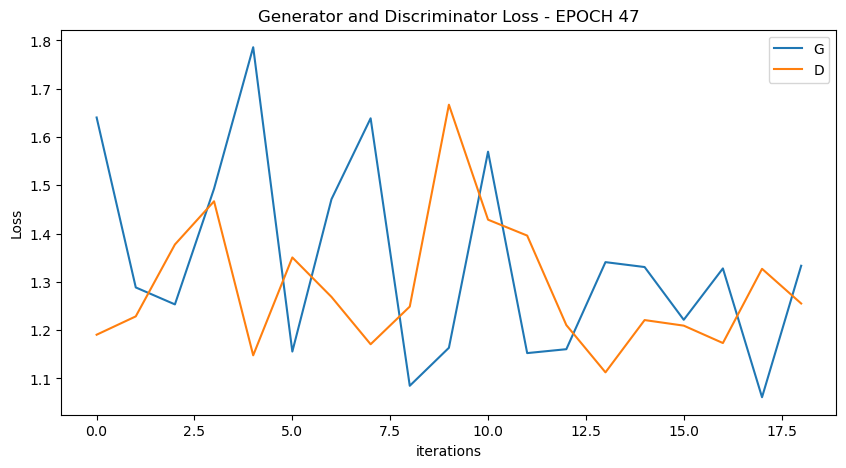

  0%|          | 0/19 [00:00<?, ?it/s]

[49/100][9/19] Loss_D: 1.5152 Loss_G: 1.2524 D(x): 0.4827 D(G(z)): 0.5195 / 0.2677
[49/100][18/19] Loss_D: 1.2199 Loss_G: 1.2686 D(x): 0.5218 D(G(z)): 0.4003 / 0.2634


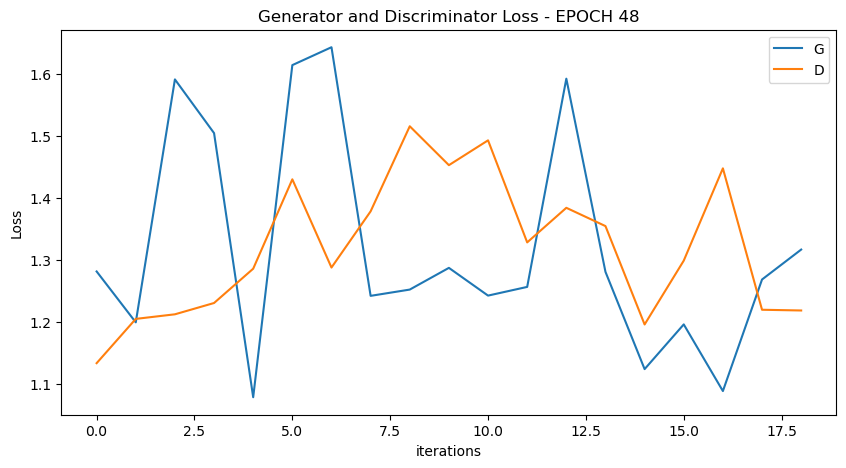

  0%|          | 0/19 [00:00<?, ?it/s]

[50/100][9/19] Loss_D: 1.4545 Loss_G: 1.3575 D(x): 0.4746 D(G(z)): 0.4908 / 0.2480
[50/100][18/19] Loss_D: 1.2960 Loss_G: 1.1049 D(x): 0.4065 D(G(z)): 0.2842 / 0.3217


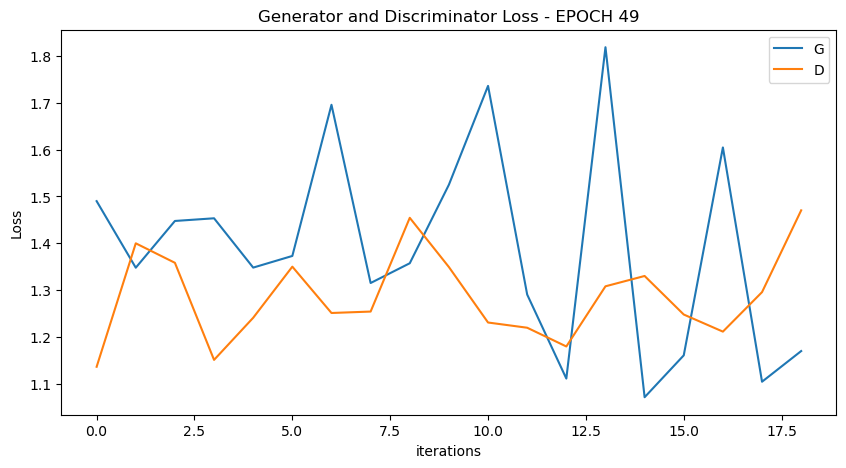

  0%|          | 0/19 [00:00<?, ?it/s]

[51/100][9/19] Loss_D: 1.1456 Loss_G: 1.3426 D(x): 0.4853 D(G(z)): 0.3137 / 0.2464
[51/100][18/19] Loss_D: 1.2011 Loss_G: 1.7315 D(x): 0.4690 D(G(z)): 0.3265 / 0.1701


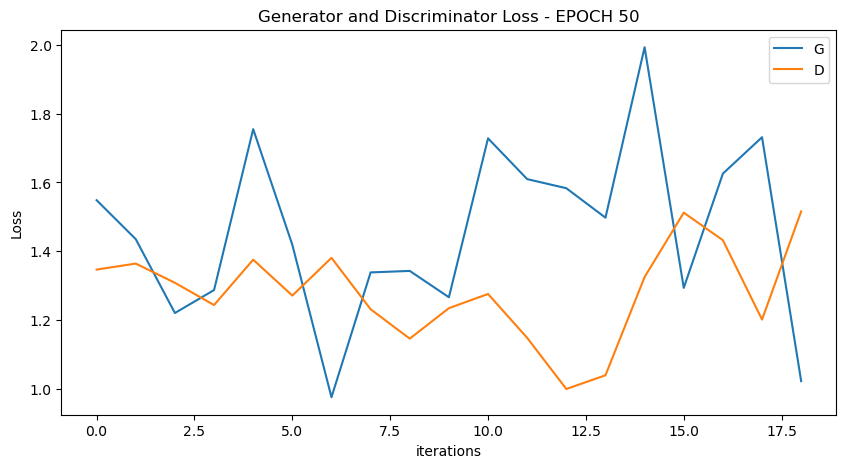

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


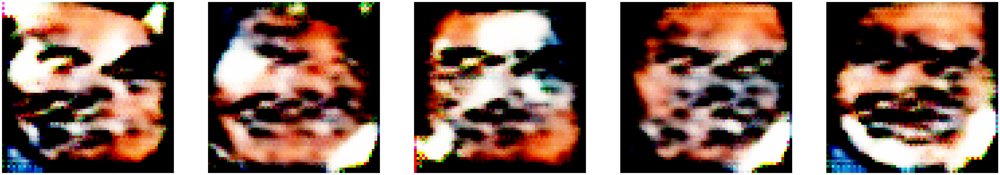

  0%|          | 0/19 [00:00<?, ?it/s]

[52/100][9/19] Loss_D: 1.2958 Loss_G: 1.1512 D(x): 0.4338 D(G(z)): 0.3214 / 0.3111
[52/100][18/19] Loss_D: 1.3808 Loss_G: 1.8370 D(x): 0.6126 D(G(z)): 0.5349 / 0.1424


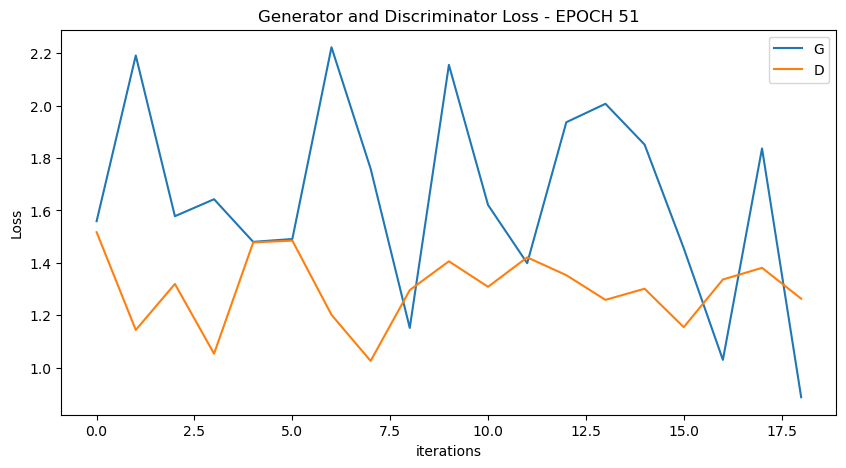

  0%|          | 0/19 [00:00<?, ?it/s]

[53/100][9/19] Loss_D: 0.8931 Loss_G: 1.8597 D(x): 0.6299 D(G(z)): 0.2835 / 0.1440
[53/100][18/19] Loss_D: 1.2605 Loss_G: 1.3572 D(x): 0.4018 D(G(z)): 0.2985 / 0.2414


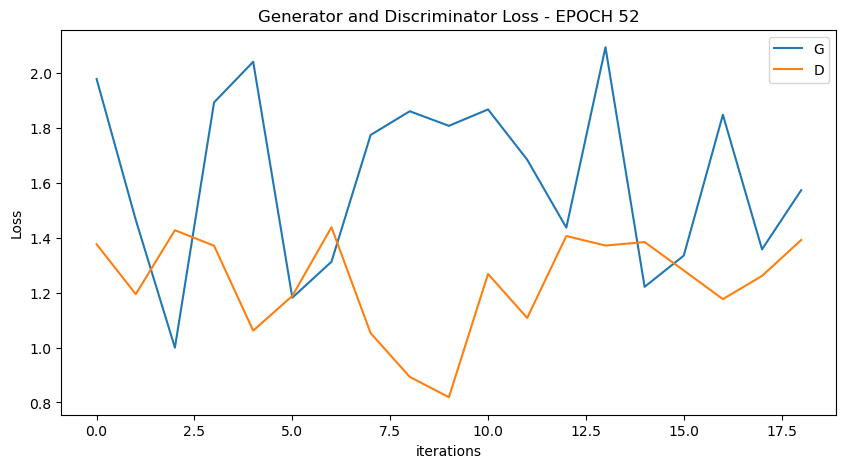

  0%|          | 0/19 [00:00<?, ?it/s]

[54/100][9/19] Loss_D: 1.2218 Loss_G: 1.3113 D(x): 0.5234 D(G(z)): 0.4003 / 0.2521
[54/100][18/19] Loss_D: 1.4489 Loss_G: 1.3462 D(x): 0.3129 D(G(z)): 0.2436 / 0.2419


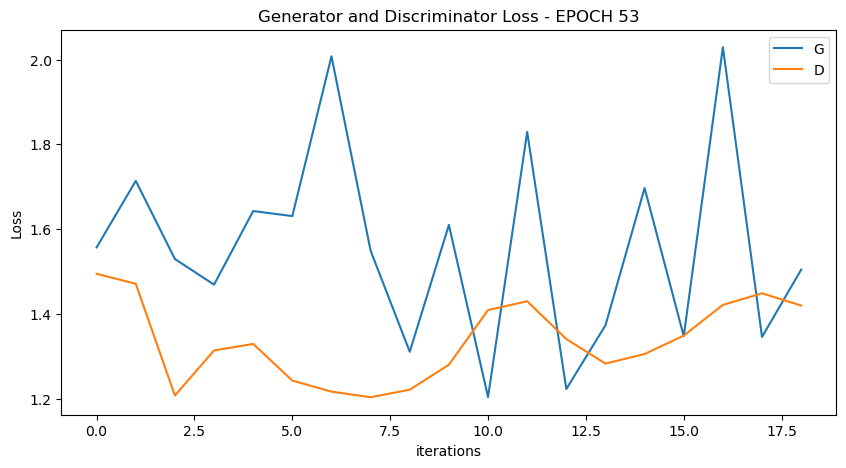

  0%|          | 0/19 [00:00<?, ?it/s]

[55/100][9/19] Loss_D: 1.1878 Loss_G: 1.4517 D(x): 0.5197 D(G(z)): 0.3796 / 0.2163
[55/100][18/19] Loss_D: 1.3885 Loss_G: 1.1287 D(x): 0.4188 D(G(z)): 0.3692 / 0.3038


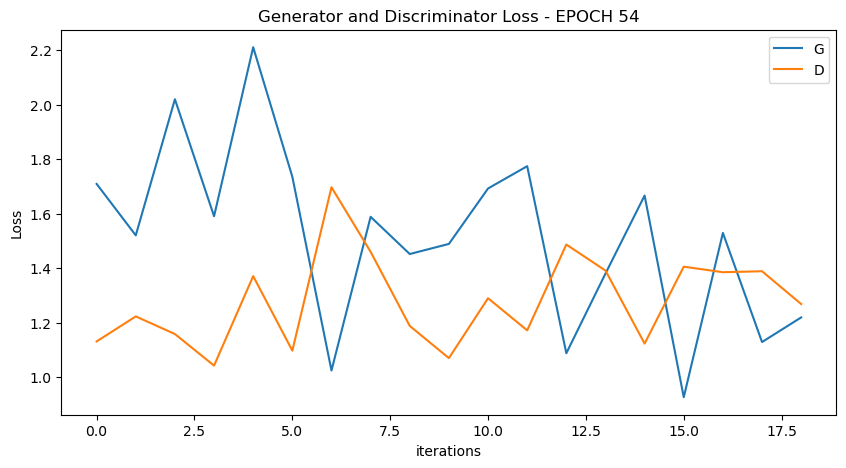

  0%|          | 0/19 [00:00<?, ?it/s]

[56/100][9/19] Loss_D: 1.4775 Loss_G: 1.2030 D(x): 0.2736 D(G(z)): 0.2087 / 0.2865
[56/100][18/19] Loss_D: 1.3760 Loss_G: 1.3541 D(x): 0.5185 D(G(z)): 0.4692 / 0.2409


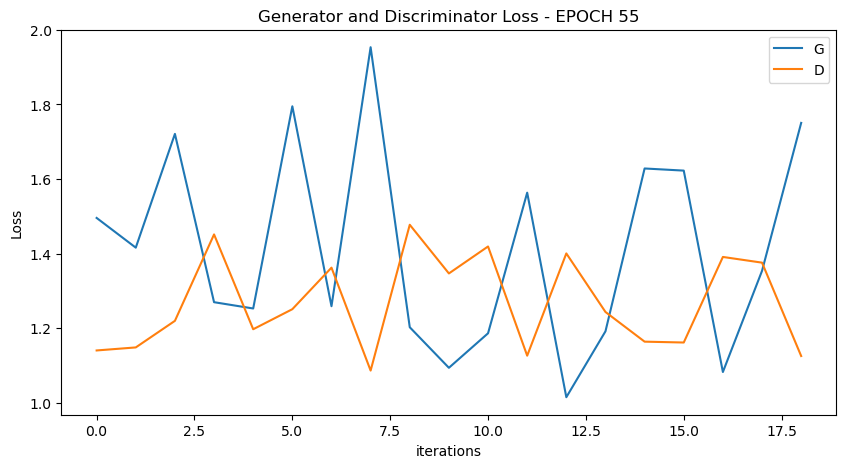

  0%|          | 0/19 [00:00<?, ?it/s]

[57/100][9/19] Loss_D: 1.2124 Loss_G: 1.0095 D(x): 0.4295 D(G(z)): 0.3100 / 0.3516
[57/100][18/19] Loss_D: 1.2970 Loss_G: 0.9919 D(x): 0.4887 D(G(z)): 0.4154 / 0.3649


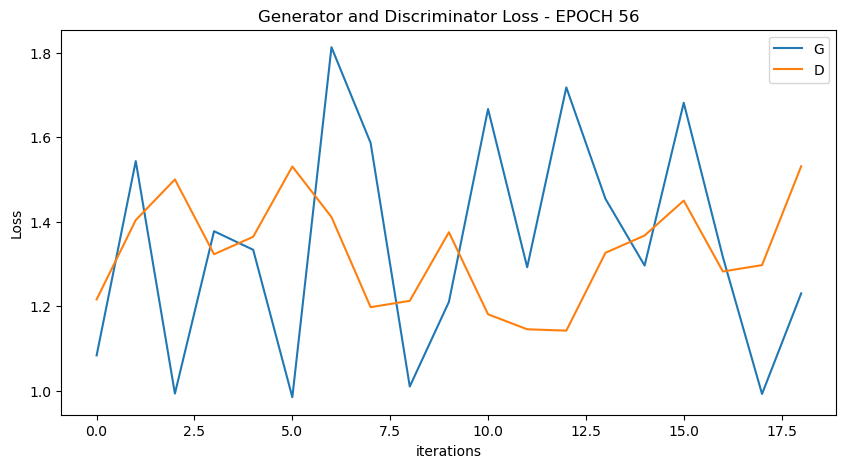

  0%|          | 0/19 [00:00<?, ?it/s]

[58/100][9/19] Loss_D: 1.1725 Loss_G: 1.1349 D(x): 0.4900 D(G(z)): 0.3421 / 0.3103
[58/100][18/19] Loss_D: 1.5628 Loss_G: 1.7203 D(x): 0.5192 D(G(z)): 0.5430 / 0.1653


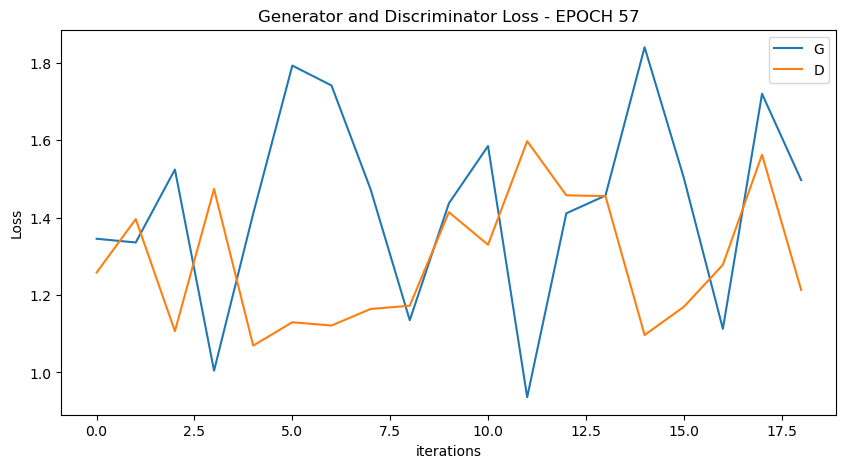

  0%|          | 0/19 [00:00<?, ?it/s]

[59/100][9/19] Loss_D: 1.4056 Loss_G: 0.9133 D(x): 0.3719 D(G(z)): 0.3370 / 0.3982
[59/100][18/19] Loss_D: 1.4550 Loss_G: 1.2319 D(x): 0.3500 D(G(z)): 0.3419 / 0.2745


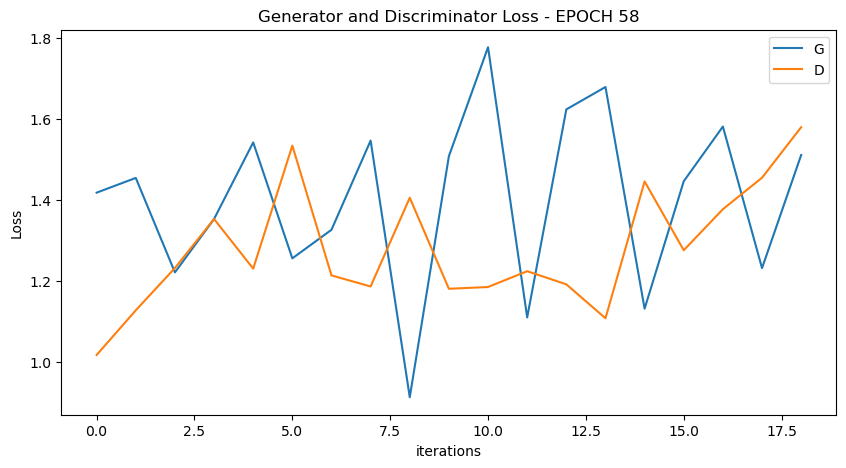

  0%|          | 0/19 [00:00<?, ?it/s]

[60/100][9/19] Loss_D: 1.3257 Loss_G: 1.2956 D(x): 0.4718 D(G(z)): 0.4003 / 0.2627
[60/100][18/19] Loss_D: 1.1508 Loss_G: 1.4939 D(x): 0.5438 D(G(z)): 0.3830 / 0.2056


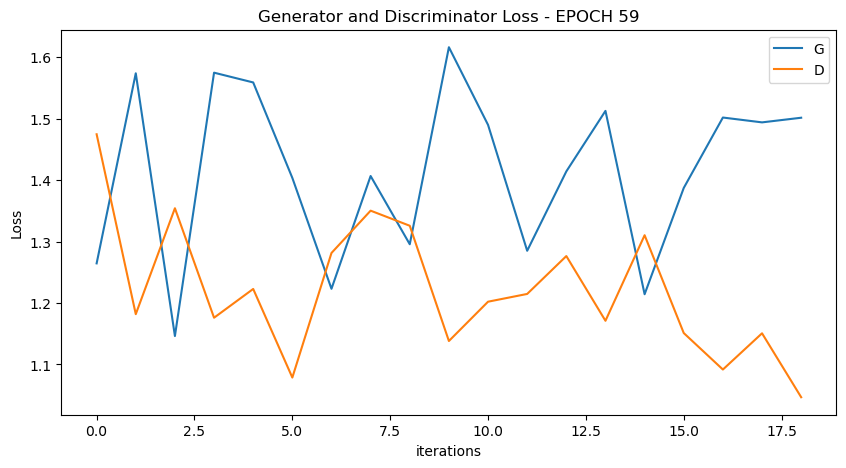

  0%|          | 0/19 [00:00<?, ?it/s]

[61/100][9/19] Loss_D: 1.1740 Loss_G: 1.6253 D(x): 0.4984 D(G(z)): 0.3452 / 0.1920
[61/100][18/19] Loss_D: 1.2872 Loss_G: 1.3889 D(x): 0.5686 D(G(z)): 0.4770 / 0.2479


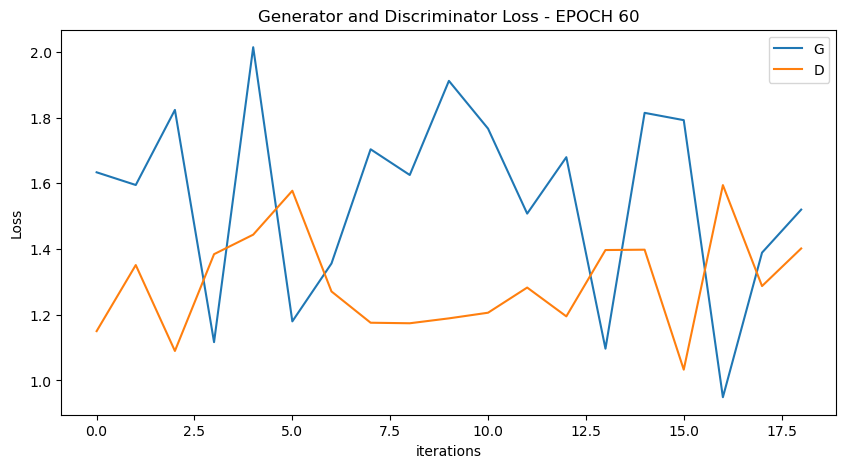

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


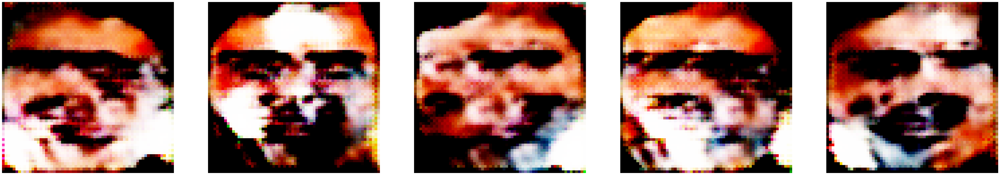

  0%|          | 0/19 [00:00<?, ?it/s]

[62/100][9/19] Loss_D: 1.2632 Loss_G: 1.3572 D(x): 0.5254 D(G(z)): 0.4304 / 0.2454
[62/100][18/19] Loss_D: 1.6326 Loss_G: 1.3383 D(x): 0.5450 D(G(z)): 0.5971 / 0.2517


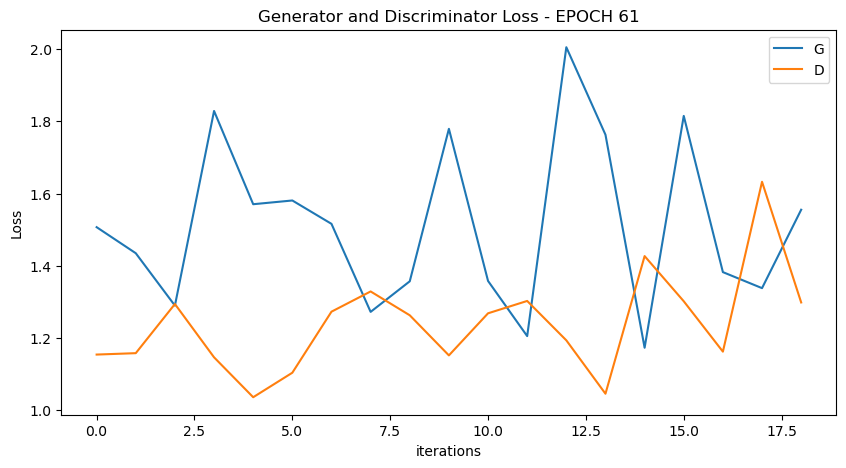

  0%|          | 0/19 [00:00<?, ?it/s]

[63/100][9/19] Loss_D: 1.1637 Loss_G: 1.1264 D(x): 0.4527 D(G(z)): 0.2945 / 0.3115
[63/100][18/19] Loss_D: 1.4503 Loss_G: 1.0511 D(x): 0.2991 D(G(z)): 0.2416 / 0.3413


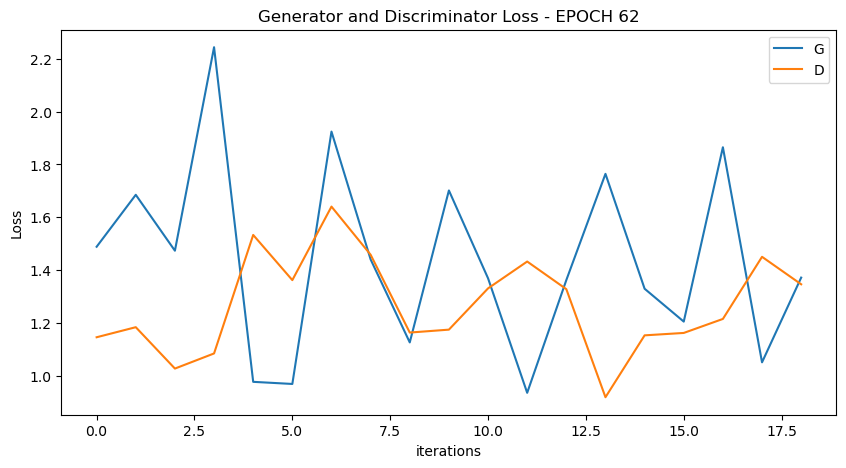

  0%|          | 0/19 [00:00<?, ?it/s]

[64/100][9/19] Loss_D: 1.4996 Loss_G: 0.8400 D(x): 0.3979 D(G(z)): 0.4296 / 0.4312
[64/100][18/19] Loss_D: 1.4454 Loss_G: 1.1125 D(x): 0.3248 D(G(z)): 0.2489 / 0.3234


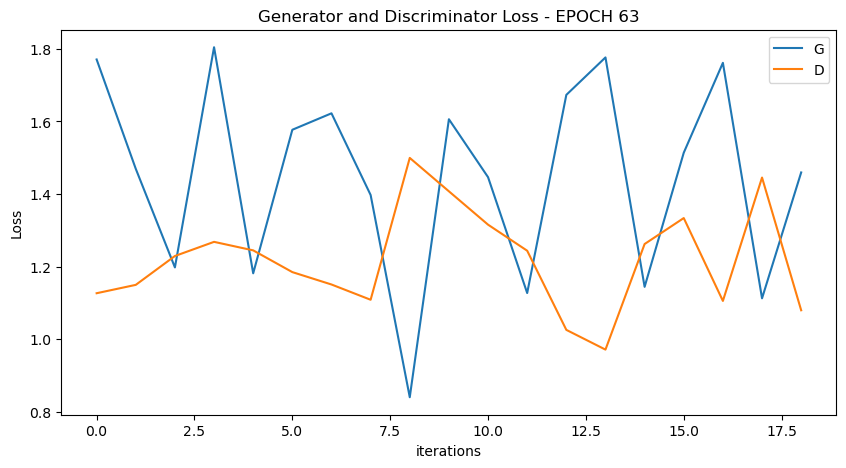

  0%|          | 0/19 [00:00<?, ?it/s]

[65/100][9/19] Loss_D: 1.2192 Loss_G: 1.7254 D(x): 0.4536 D(G(z)): 0.3031 / 0.1591
[65/100][18/19] Loss_D: 1.1239 Loss_G: 1.9708 D(x): 0.4464 D(G(z)): 0.2494 / 0.1249


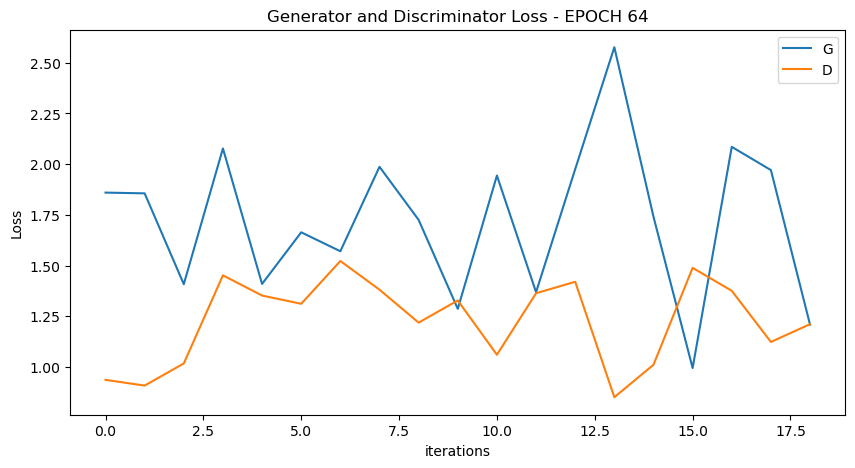

  0%|          | 0/19 [00:00<?, ?it/s]

[66/100][9/19] Loss_D: 1.1358 Loss_G: 2.0014 D(x): 0.5837 D(G(z)): 0.3910 / 0.1184
[66/100][18/19] Loss_D: 1.6849 Loss_G: 1.2392 D(x): 0.3545 D(G(z)): 0.4300 / 0.2905


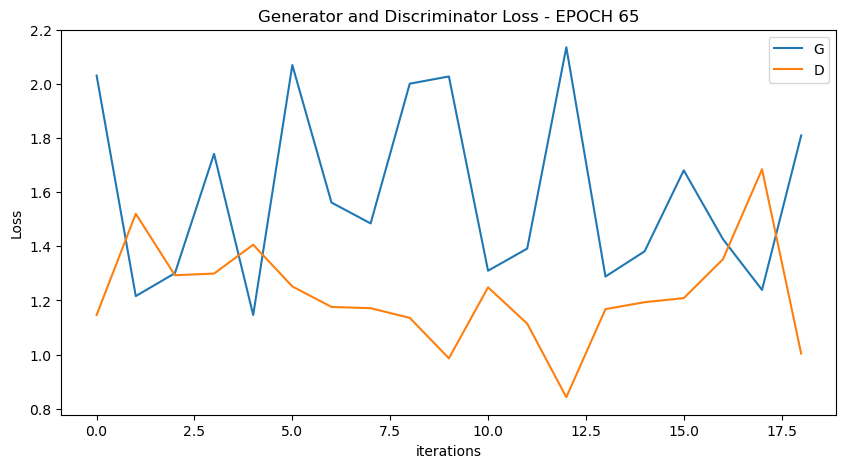

  0%|          | 0/19 [00:00<?, ?it/s]

[67/100][9/19] Loss_D: 1.2604 Loss_G: 1.2167 D(x): 0.4141 D(G(z)): 0.2926 / 0.2872
[67/100][18/19] Loss_D: 1.1868 Loss_G: 1.8707 D(x): 0.5734 D(G(z)): 0.4164 / 0.1422


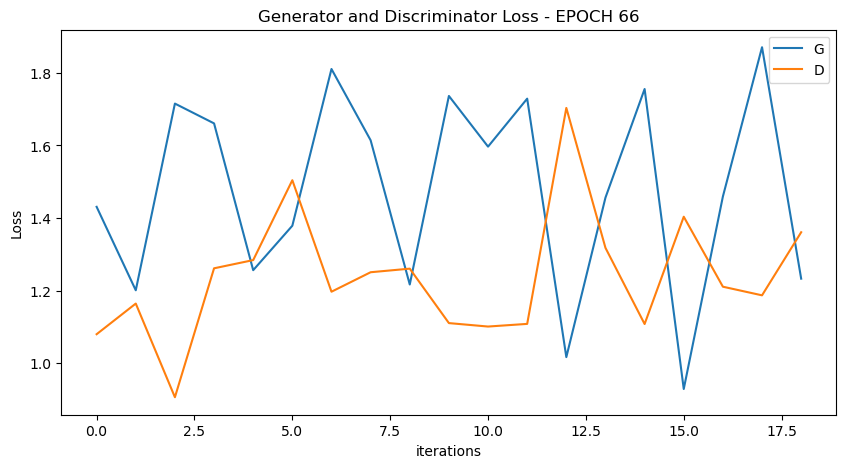

  0%|          | 0/19 [00:00<?, ?it/s]

[68/100][9/19] Loss_D: 1.1899 Loss_G: 1.5377 D(x): 0.6182 D(G(z)): 0.4535 / 0.2106
[68/100][18/19] Loss_D: 1.1934 Loss_G: 1.5605 D(x): 0.4991 D(G(z)): 0.3402 / 0.2335


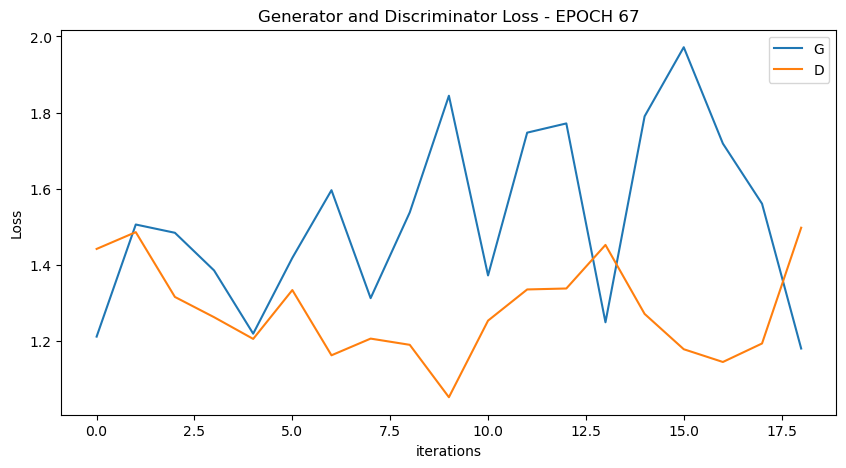

  0%|          | 0/19 [00:00<?, ?it/s]

[69/100][9/19] Loss_D: 1.5596 Loss_G: 1.2128 D(x): 0.4075 D(G(z)): 0.4680 / 0.2844
[69/100][18/19] Loss_D: 1.5321 Loss_G: 1.3341 D(x): 0.3362 D(G(z)): 0.2982 / 0.2481


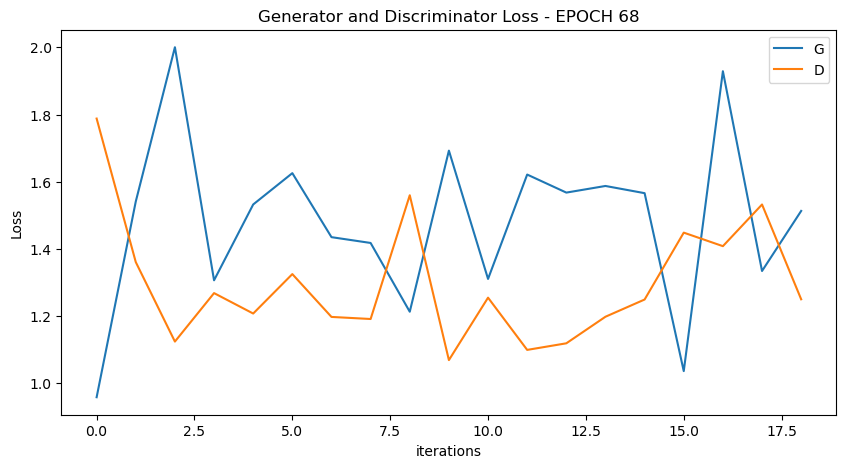

  0%|          | 0/19 [00:00<?, ?it/s]

[70/100][9/19] Loss_D: 1.1696 Loss_G: 1.6459 D(x): 0.5838 D(G(z)): 0.4026 / 0.1757
[70/100][18/19] Loss_D: 0.9117 Loss_G: 1.5727 D(x): 0.5542 D(G(z)): 0.2301 / 0.1894


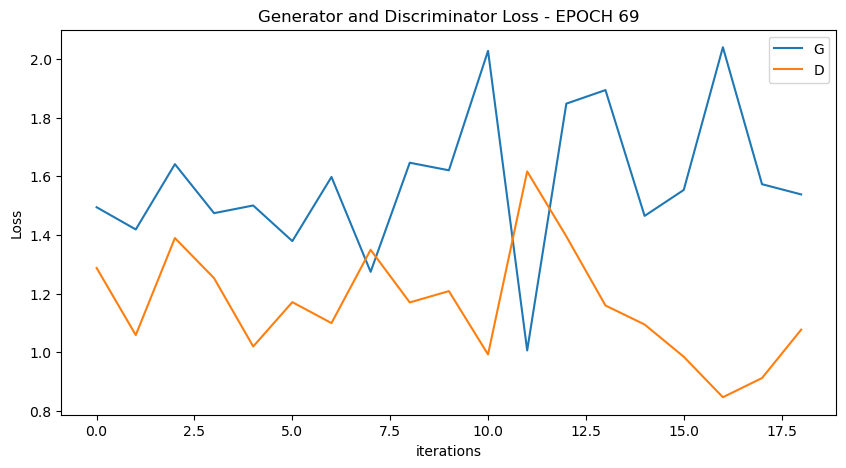

  0%|          | 0/19 [00:00<?, ?it/s]

[71/100][9/19] Loss_D: 1.1512 Loss_G: 1.7940 D(x): 0.6601 D(G(z)): 0.4452 / 0.1661
[71/100][18/19] Loss_D: 1.7854 Loss_G: 1.4968 D(x): 0.3726 D(G(z)): 0.5283 / 0.2041


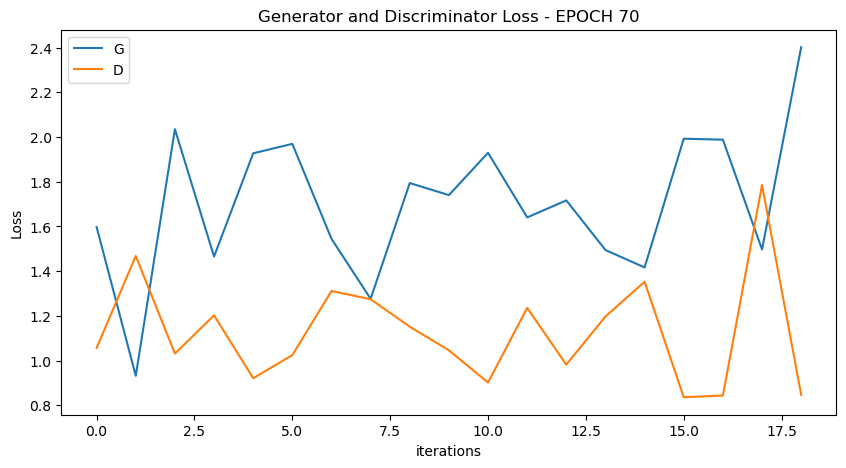

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


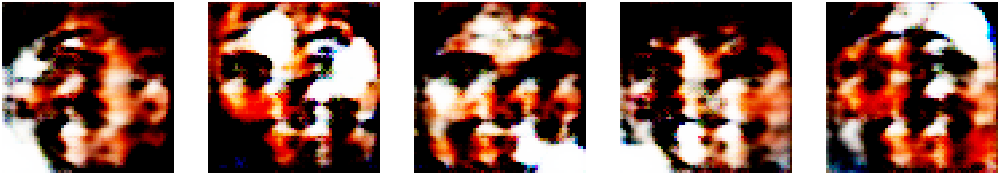

  0%|          | 0/19 [00:00<?, ?it/s]

[72/100][9/19] Loss_D: 1.0142 Loss_G: 2.1276 D(x): 0.6215 D(G(z)): 0.3489 / 0.1120
[72/100][18/19] Loss_D: 1.7299 Loss_G: 1.1256 D(x): 0.2540 D(G(z)): 0.2456 / 0.3334


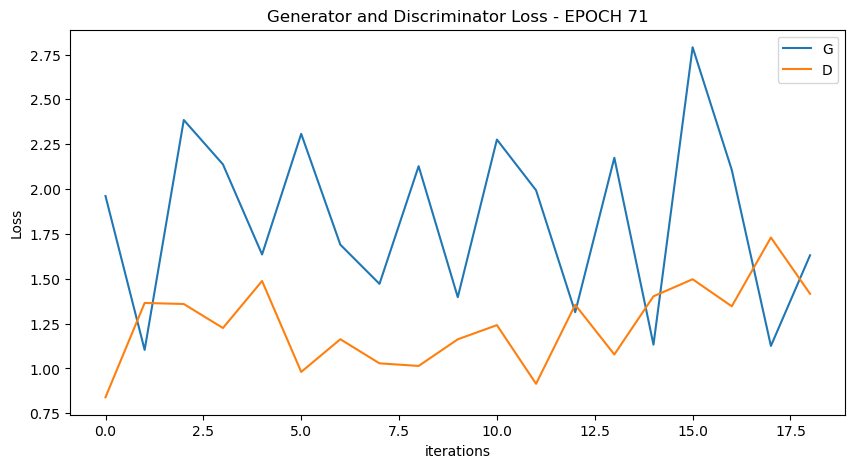

  0%|          | 0/19 [00:00<?, ?it/s]

[73/100][9/19] Loss_D: 1.3485 Loss_G: 1.5358 D(x): 0.5162 D(G(z)): 0.4342 / 0.2125
[73/100][18/19] Loss_D: 1.1626 Loss_G: 1.8637 D(x): 0.5755 D(G(z)): 0.3680 / 0.1457


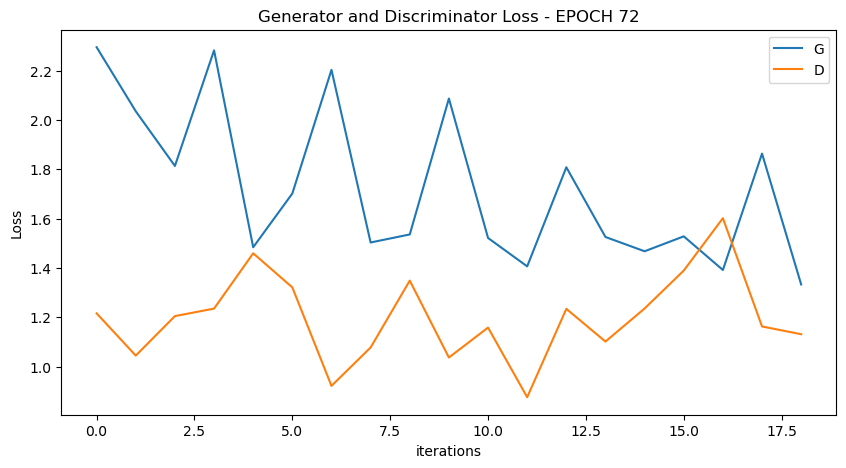

  0%|          | 0/19 [00:00<?, ?it/s]

[74/100][9/19] Loss_D: 0.9779 Loss_G: 1.6066 D(x): 0.6578 D(G(z)): 0.3589 / 0.1840
[74/100][18/19] Loss_D: 0.9720 Loss_G: 1.7312 D(x): 0.6564 D(G(z)): 0.3563 / 0.1674


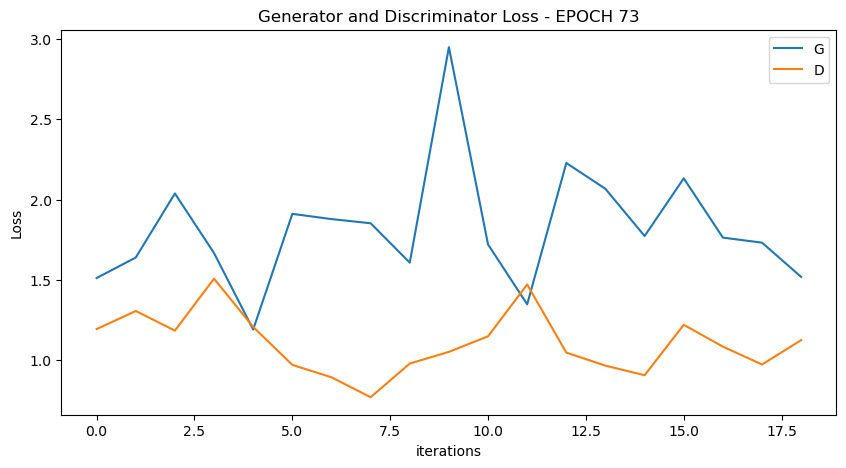

  0%|          | 0/19 [00:00<?, ?it/s]

[75/100][9/19] Loss_D: 1.1478 Loss_G: 1.9780 D(x): 0.6624 D(G(z)): 0.4549 / 0.1275
[75/100][18/19] Loss_D: 1.1001 Loss_G: 1.4610 D(x): 0.6336 D(G(z)): 0.3796 / 0.2230


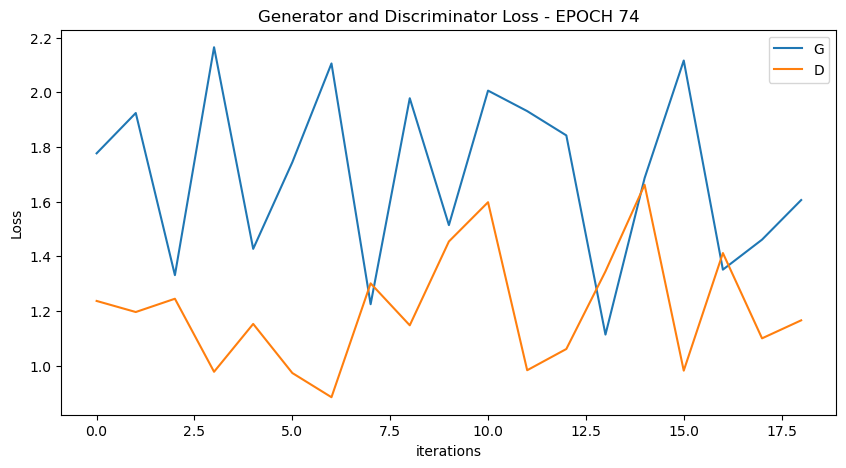

  0%|          | 0/19 [00:00<?, ?it/s]

[76/100][9/19] Loss_D: 1.1023 Loss_G: 1.8501 D(x): 0.4909 D(G(z)): 0.2701 / 0.1593
[76/100][18/19] Loss_D: 1.7181 Loss_G: 2.4675 D(x): 0.4512 D(G(z)): 0.5179 / 0.0834


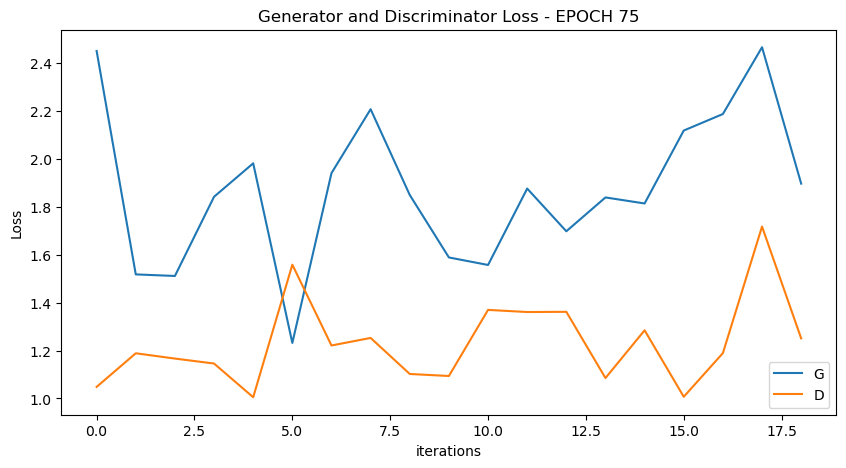

  0%|          | 0/19 [00:00<?, ?it/s]

[77/100][9/19] Loss_D: 1.2903 Loss_G: 1.4436 D(x): 0.5153 D(G(z)): 0.4111 / 0.2194
[77/100][18/19] Loss_D: 0.9650 Loss_G: 1.6519 D(x): 0.6376 D(G(z)): 0.3256 / 0.1851


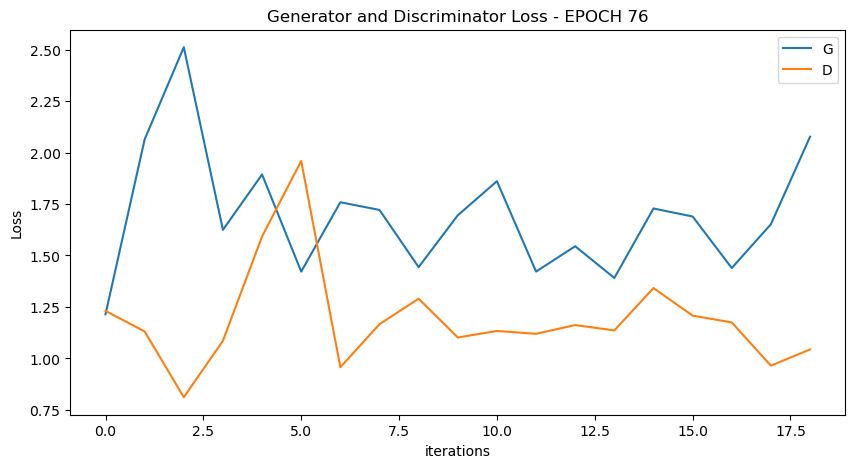

  0%|          | 0/19 [00:00<?, ?it/s]

[78/100][9/19] Loss_D: 1.2196 Loss_G: 1.6786 D(x): 0.4265 D(G(z)): 0.2517 / 0.1791
[78/100][18/19] Loss_D: 1.5393 Loss_G: 1.0575 D(x): 0.4892 D(G(z)): 0.5221 / 0.3433


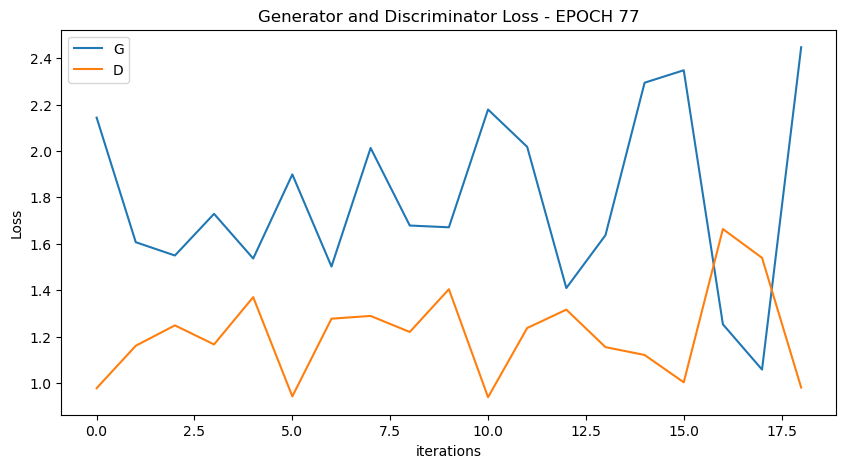

  0%|          | 0/19 [00:00<?, ?it/s]

[79/100][9/19] Loss_D: 1.1426 Loss_G: 2.0023 D(x): 0.5750 D(G(z)): 0.3875 / 0.1297
[79/100][18/19] Loss_D: 1.2939 Loss_G: 1.4790 D(x): 0.5057 D(G(z)): 0.4206 / 0.2164


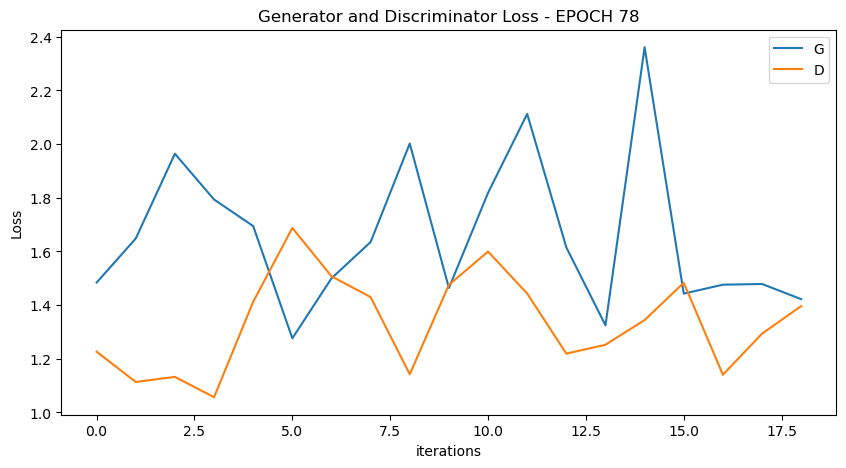

  0%|          | 0/19 [00:00<?, ?it/s]

[80/100][9/19] Loss_D: 1.2659 Loss_G: 1.6239 D(x): 0.4454 D(G(z)): 0.3328 / 0.1923
[80/100][18/19] Loss_D: 1.1911 Loss_G: 1.8743 D(x): 0.6243 D(G(z)): 0.4596 / 0.1478


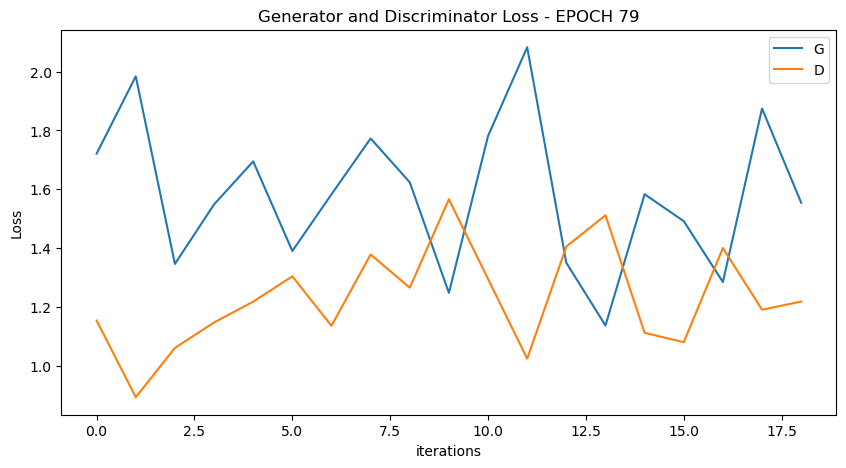

  0%|          | 0/19 [00:00<?, ?it/s]

[81/100][9/19] Loss_D: 1.2208 Loss_G: 1.7629 D(x): 0.6375 D(G(z)): 0.4902 / 0.1586
[81/100][18/19] Loss_D: 1.2892 Loss_G: 1.9902 D(x): 0.5275 D(G(z)): 0.4086 / 0.1296


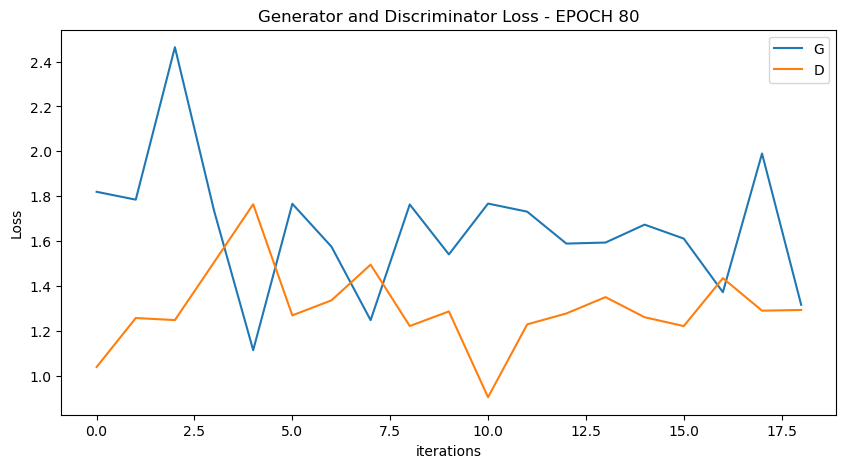

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


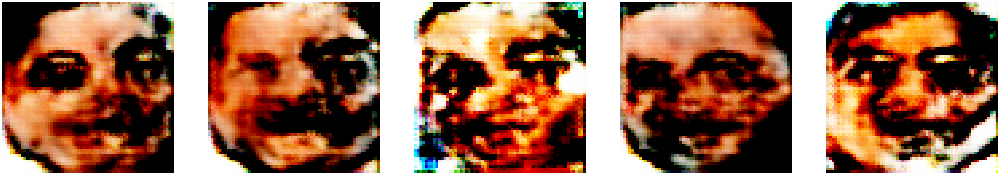

  0%|          | 0/19 [00:00<?, ?it/s]

[82/100][9/19] Loss_D: 1.1971 Loss_G: 1.8335 D(x): 0.5690 D(G(z)): 0.4147 / 0.1613
[82/100][18/19] Loss_D: 1.5634 Loss_G: 1.1998 D(x): 0.4874 D(G(z)): 0.5168 / 0.2968


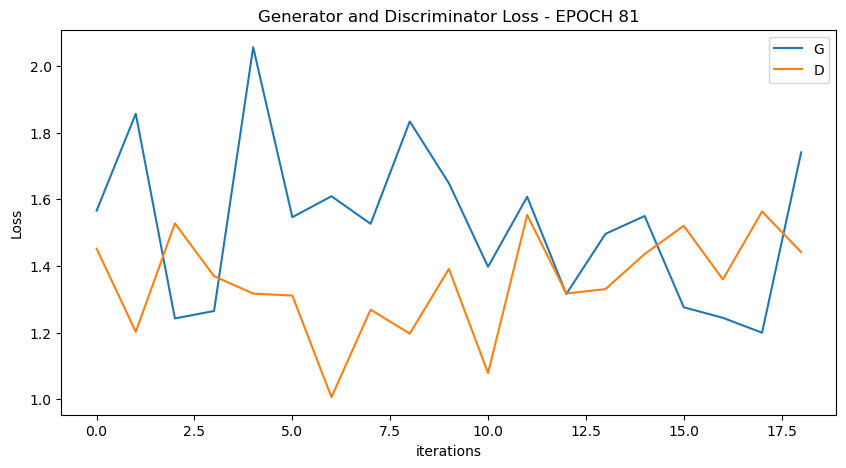

  0%|          | 0/19 [00:00<?, ?it/s]

[83/100][9/19] Loss_D: 1.5858 Loss_G: 1.1239 D(x): 0.6154 D(G(z)): 0.6261 / 0.3181
[83/100][18/19] Loss_D: 1.3883 Loss_G: 1.3444 D(x): 0.4534 D(G(z)): 0.4268 / 0.2542


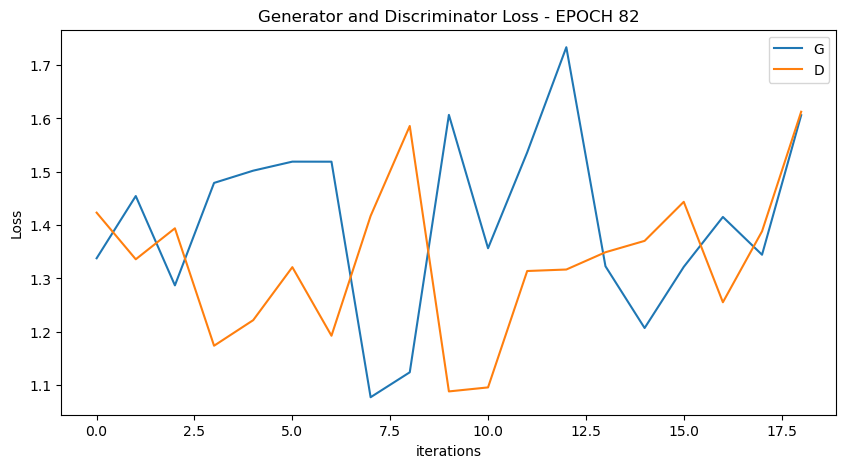

  0%|          | 0/19 [00:00<?, ?it/s]

[84/100][9/19] Loss_D: 1.3617 Loss_G: 1.2870 D(x): 0.4976 D(G(z)): 0.4488 / 0.2644
[84/100][18/19] Loss_D: 1.4169 Loss_G: 1.4519 D(x): 0.5656 D(G(z)): 0.5377 / 0.2278


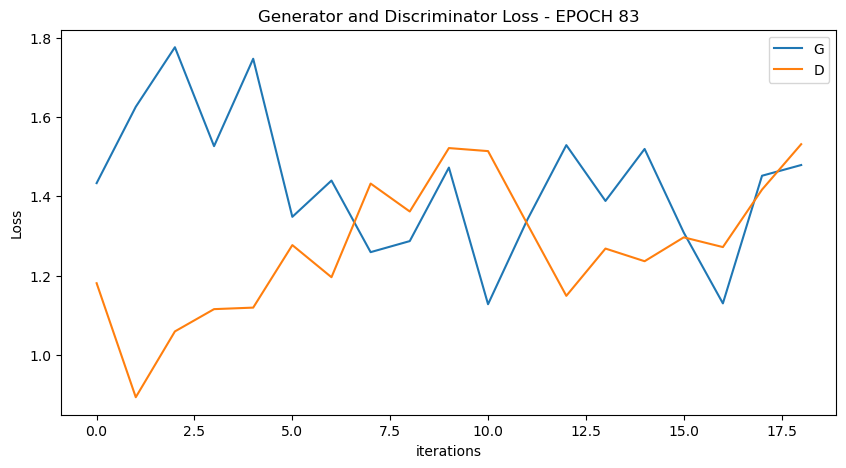

  0%|          | 0/19 [00:00<?, ?it/s]

[85/100][9/19] Loss_D: 1.1931 Loss_G: 1.6726 D(x): 0.4874 D(G(z)): 0.3492 / 0.1726
[85/100][18/19] Loss_D: 1.2715 Loss_G: 1.1095 D(x): 0.4796 D(G(z)): 0.3764 / 0.3172


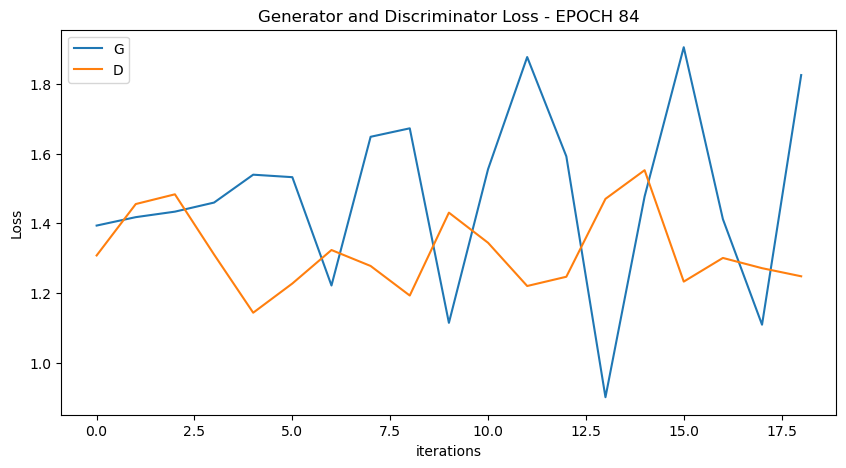

  0%|          | 0/19 [00:00<?, ?it/s]

[86/100][9/19] Loss_D: 1.3091 Loss_G: 1.4864 D(x): 0.5534 D(G(z)): 0.4521 / 0.2224
[86/100][18/19] Loss_D: 1.5135 Loss_G: 0.9764 D(x): 0.3704 D(G(z)): 0.3911 / 0.3816


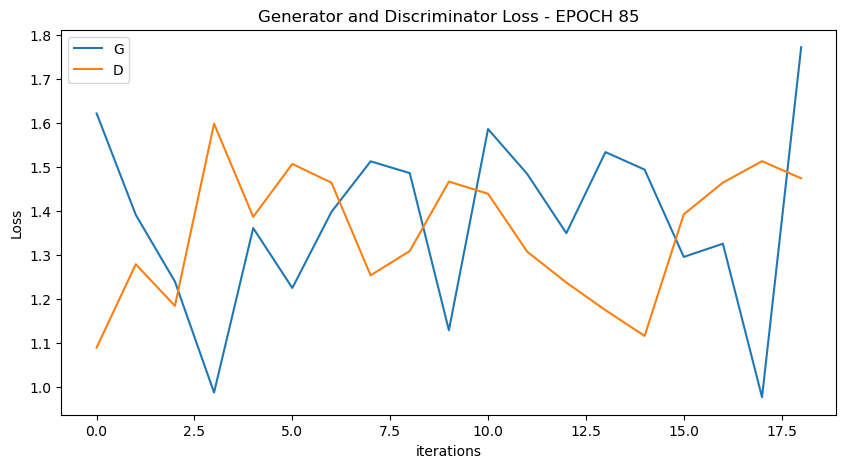

  0%|          | 0/19 [00:00<?, ?it/s]

[87/100][9/19] Loss_D: 1.3940 Loss_G: 1.3479 D(x): 0.4143 D(G(z)): 0.3849 / 0.2457
[87/100][18/19] Loss_D: 1.2491 Loss_G: 1.6789 D(x): 0.4587 D(G(z)): 0.3393 / 0.1741


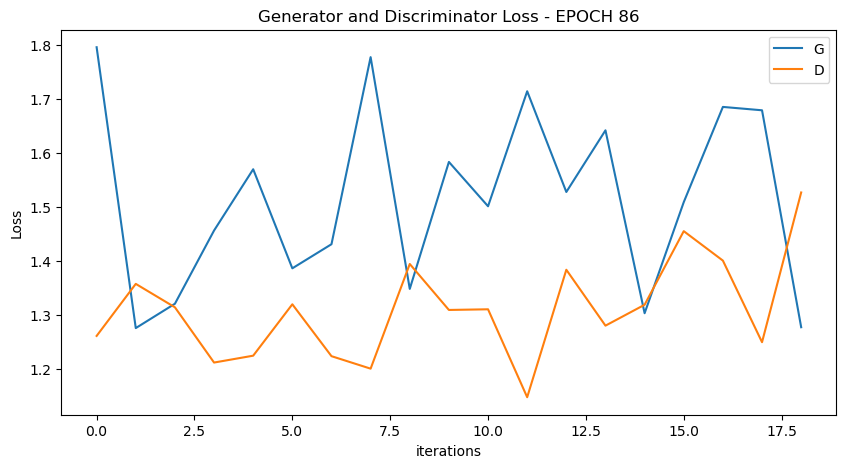

  0%|          | 0/19 [00:00<?, ?it/s]

[88/100][9/19] Loss_D: 1.3541 Loss_G: 1.3881 D(x): 0.4976 D(G(z)): 0.4414 / 0.2428
[88/100][18/19] Loss_D: 1.1594 Loss_G: 1.4706 D(x): 0.5747 D(G(z)): 0.4075 / 0.2089


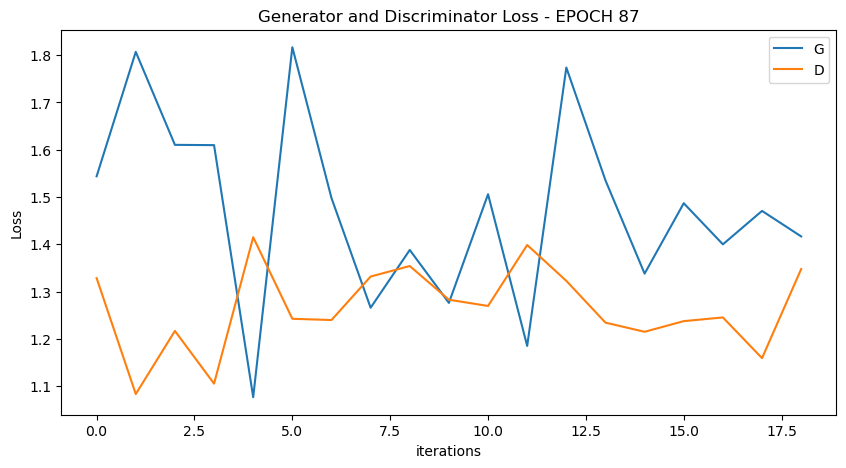

  0%|          | 0/19 [00:00<?, ?it/s]

[89/100][9/19] Loss_D: 1.1263 Loss_G: 1.5581 D(x): 0.5075 D(G(z)): 0.3226 / 0.1962
[89/100][18/19] Loss_D: 1.6129 Loss_G: 1.3839 D(x): 0.4444 D(G(z)): 0.5198 / 0.2421


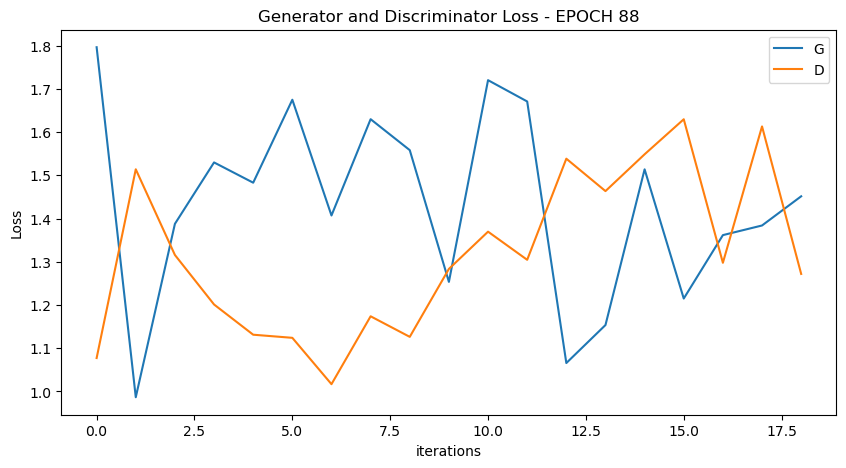

  0%|          | 0/19 [00:00<?, ?it/s]

[90/100][9/19] Loss_D: 1.2751 Loss_G: 1.8007 D(x): 0.5718 D(G(z)): 0.4520 / 0.1536
[90/100][18/19] Loss_D: 1.1546 Loss_G: 1.1835 D(x): 0.4853 D(G(z)): 0.3197 / 0.2973


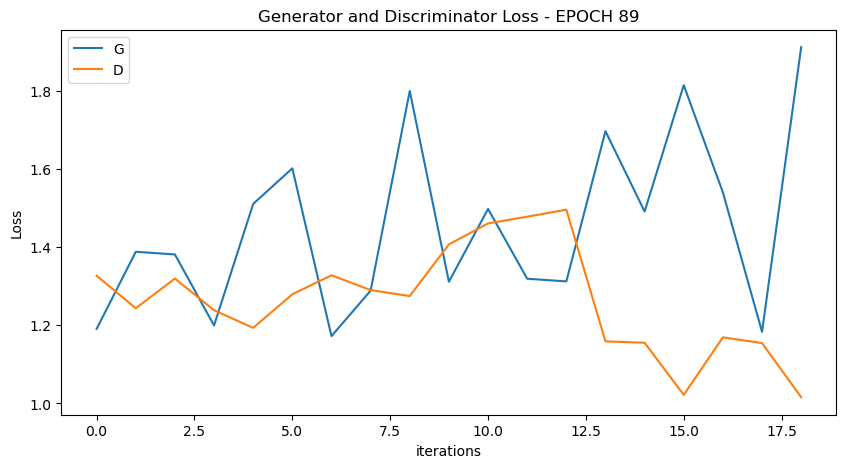

  0%|          | 0/19 [00:00<?, ?it/s]

[91/100][9/19] Loss_D: 1.3135 Loss_G: 1.3806 D(x): 0.4934 D(G(z)): 0.4353 / 0.2386
[91/100][18/19] Loss_D: 1.4879 Loss_G: 1.1945 D(x): 0.4464 D(G(z)): 0.4497 / 0.2947


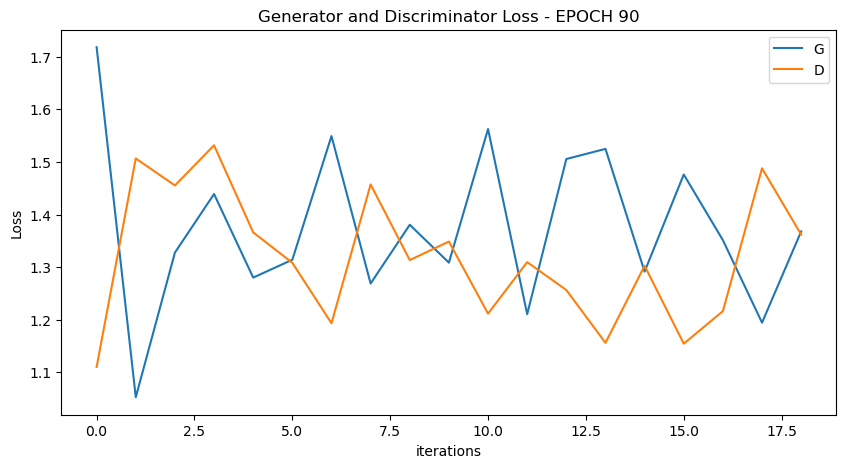

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


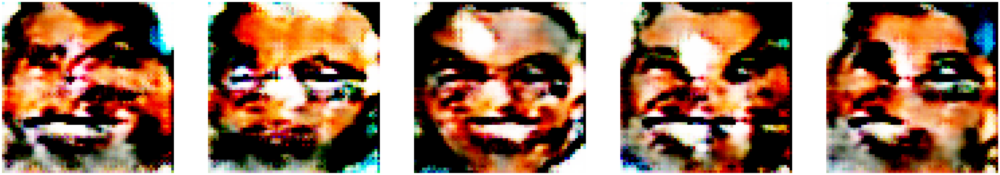

  0%|          | 0/19 [00:00<?, ?it/s]

[92/100][9/19] Loss_D: 1.2428 Loss_G: 1.4086 D(x): 0.4643 D(G(z)): 0.3576 / 0.2244
[92/100][18/19] Loss_D: 1.1123 Loss_G: 1.5041 D(x): 0.5749 D(G(z)): 0.3716 / 0.2095


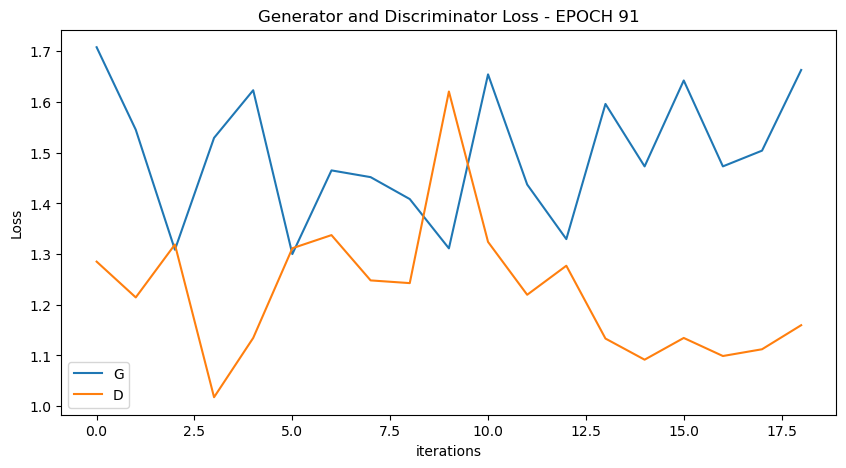

  0%|          | 0/19 [00:00<?, ?it/s]

[93/100][9/19] Loss_D: 1.3893 Loss_G: 1.1134 D(x): 0.3371 D(G(z)): 0.2617 / 0.3152
[93/100][18/19] Loss_D: 1.1342 Loss_G: 1.7770 D(x): 0.5670 D(G(z)): 0.3877 / 0.1563


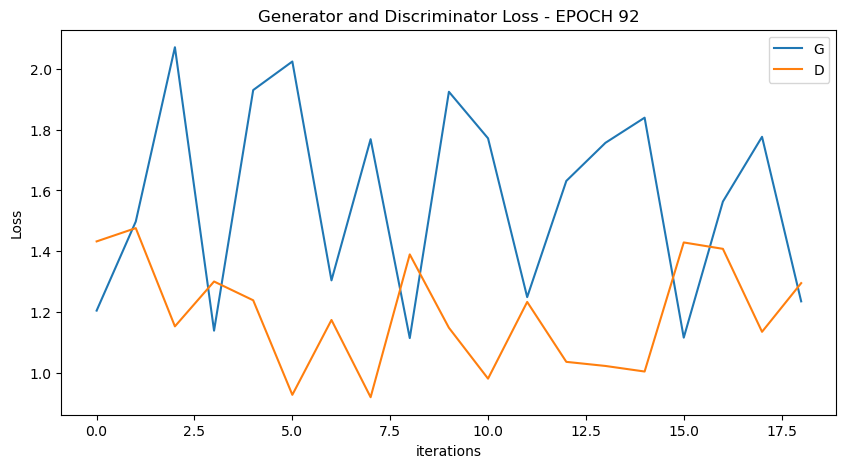

  0%|          | 0/19 [00:00<?, ?it/s]

[94/100][9/19] Loss_D: 1.1053 Loss_G: 1.6560 D(x): 0.5697 D(G(z)): 0.3677 / 0.1865
[94/100][18/19] Loss_D: 1.3824 Loss_G: 1.6149 D(x): 0.4616 D(G(z)): 0.4050 / 0.1869


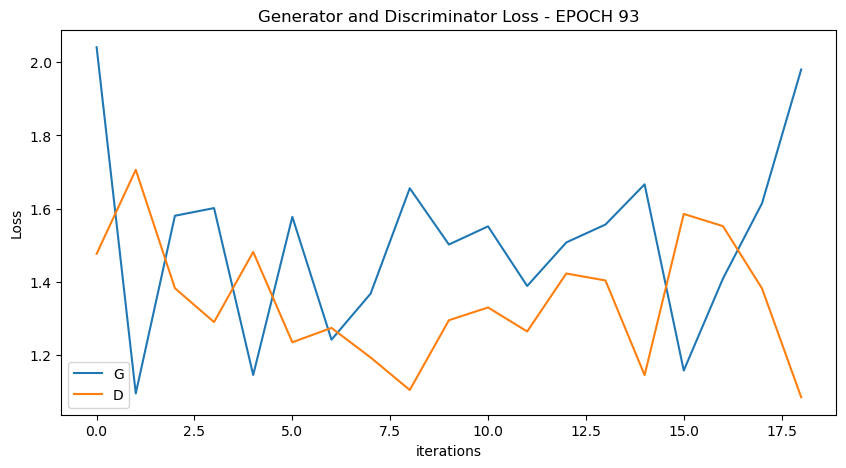

  0%|          | 0/19 [00:00<?, ?it/s]

[95/100][9/19] Loss_D: 1.2242 Loss_G: 1.6190 D(x): 0.4776 D(G(z)): 0.3530 / 0.1784
[95/100][18/19] Loss_D: 1.0717 Loss_G: 1.7292 D(x): 0.5657 D(G(z)): 0.3321 / 0.1610


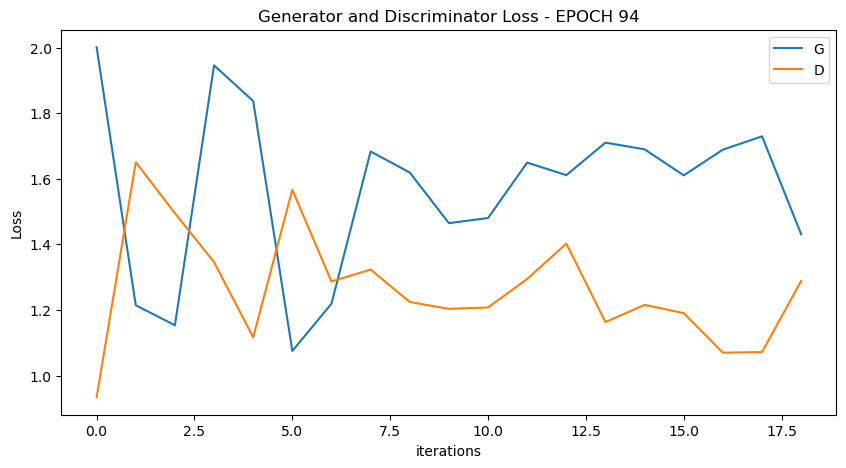

  0%|          | 0/19 [00:00<?, ?it/s]

[96/100][9/19] Loss_D: 1.1241 Loss_G: 1.4237 D(x): 0.5171 D(G(z)): 0.3291 / 0.2363
[96/100][18/19] Loss_D: 1.4635 Loss_G: 1.3318 D(x): 0.4295 D(G(z)): 0.4260 / 0.2594


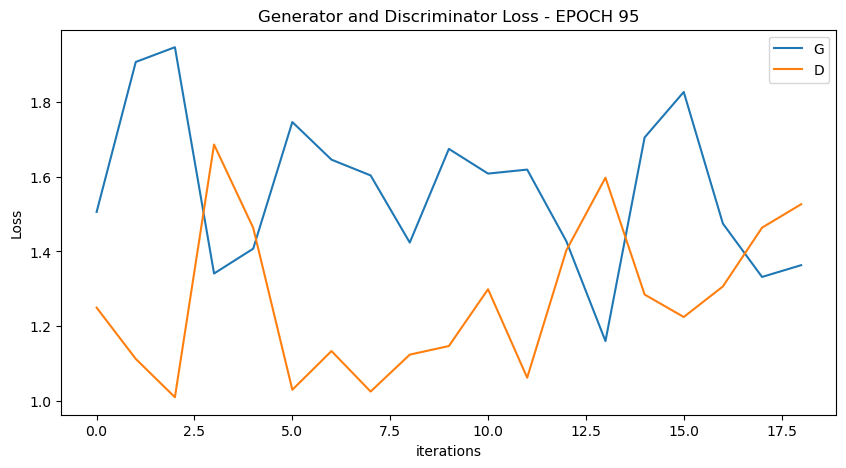

  0%|          | 0/19 [00:00<?, ?it/s]

[97/100][9/19] Loss_D: 1.2245 Loss_G: 1.4734 D(x): 0.4691 D(G(z)): 0.3354 / 0.2159
[97/100][18/19] Loss_D: 1.3912 Loss_G: 1.3445 D(x): 0.4375 D(G(z)): 0.4089 / 0.2490


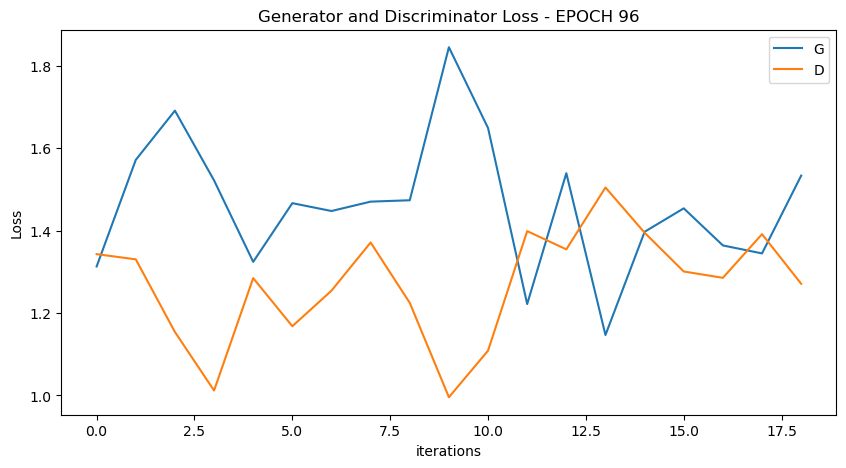

  0%|          | 0/19 [00:00<?, ?it/s]

[98/100][9/19] Loss_D: 1.2777 Loss_G: 1.5010 D(x): 0.4353 D(G(z)): 0.3158 / 0.2123
[98/100][18/19] Loss_D: 1.2096 Loss_G: 1.4847 D(x): 0.5007 D(G(z)): 0.3608 / 0.2074


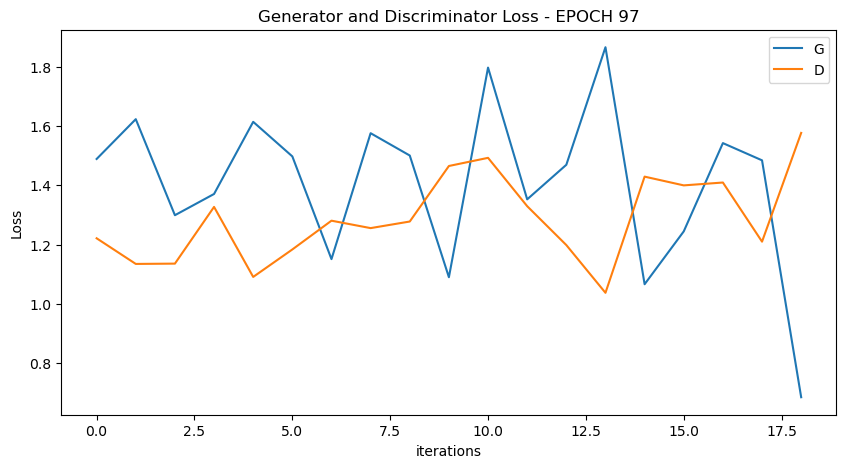

  0%|          | 0/19 [00:00<?, ?it/s]

[99/100][9/19] Loss_D: 1.3281 Loss_G: 1.2711 D(x): 0.5265 D(G(z)): 0.4534 / 0.2647
[99/100][18/19] Loss_D: 1.2275 Loss_G: 1.3853 D(x): 0.5781 D(G(z)): 0.4417 / 0.2385


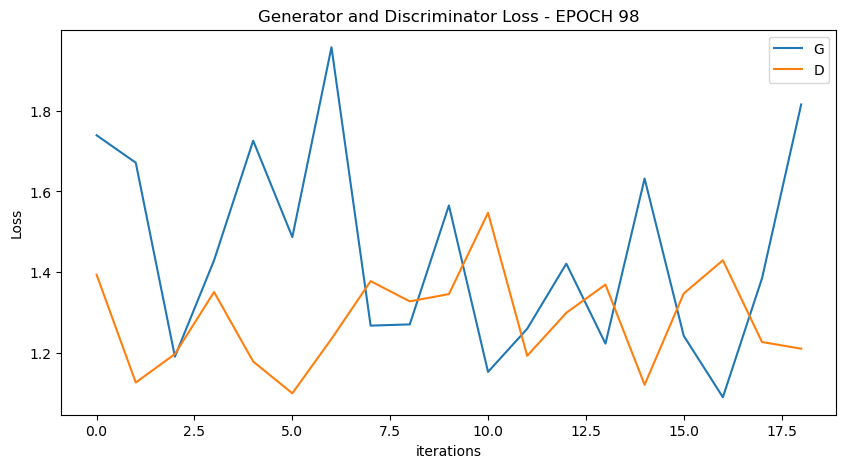

  0%|          | 0/19 [00:00<?, ?it/s]

[100/100][9/19] Loss_D: 1.1681 Loss_G: 1.6752 D(x): 0.6106 D(G(z)): 0.4418 / 0.1818
[100/100][18/19] Loss_D: 1.7472 Loss_G: 0.9003 D(x): 0.2509 D(G(z)): 0.3122 / 0.4051


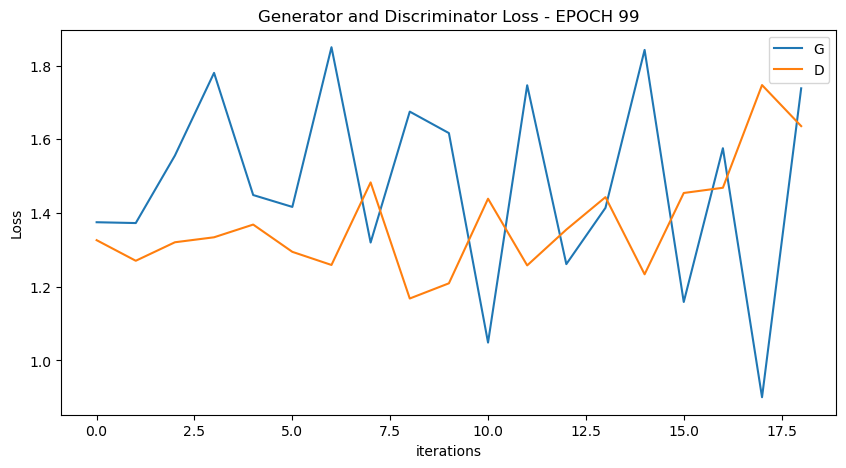

C:\Users\Samaresh Maiti\AppData\Local\Temp\ipykernel_24476\3243673685.py:82: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i_batch in tqdm(range(0, n_images, im_batch_size)):


  0%|          | 0/2 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


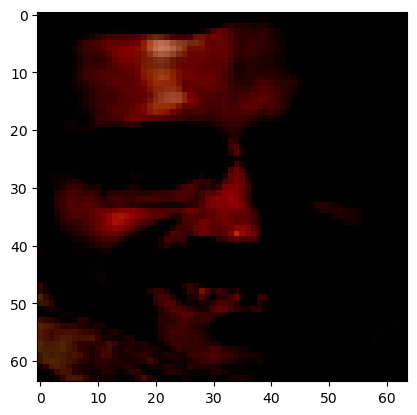

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


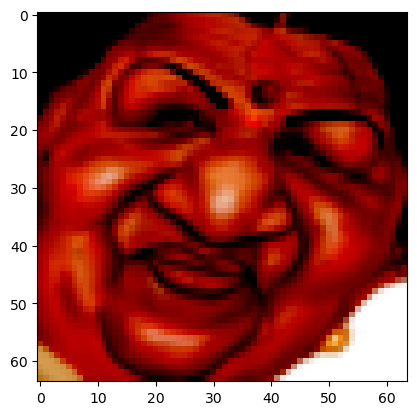

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


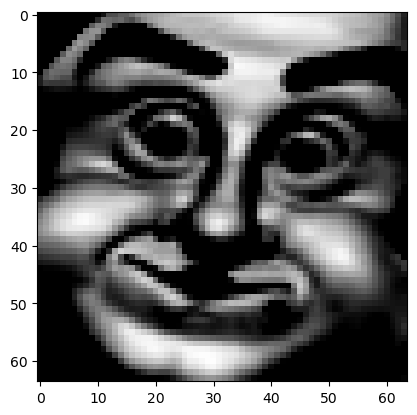

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


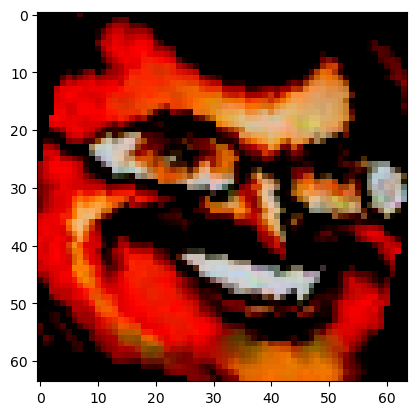

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


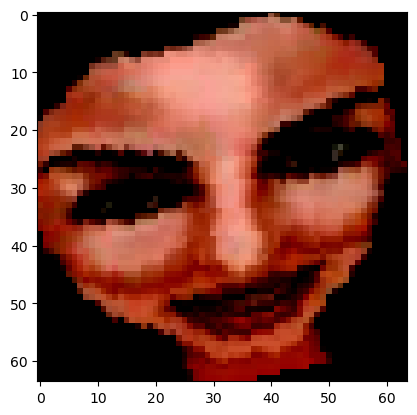

  0%|          | 0/19 [00:00<?, ?it/s]

[1/100][9/19] Loss_D: 0.4807 Loss_G: 6.1285 D(x): 0.8397 D(G(z)): 0.0788 / 0.0011
[1/100][18/19] Loss_D: 0.4501 Loss_G: 3.3089 D(x): 0.9177 D(G(z)): 0.0269 / 0.0297


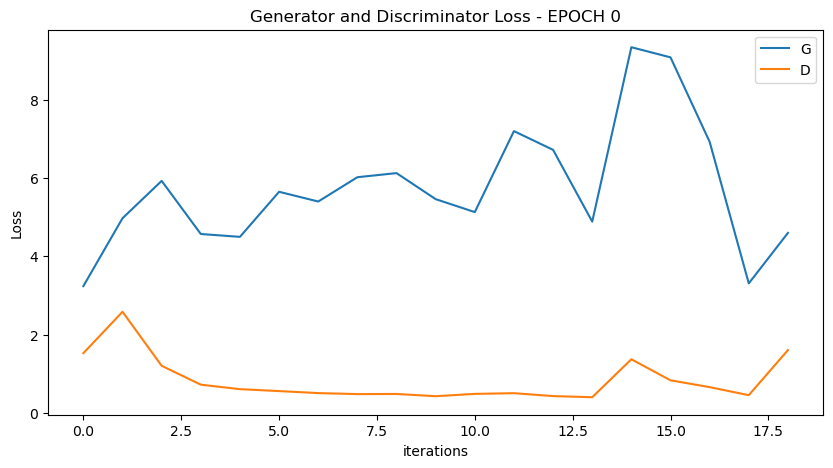

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


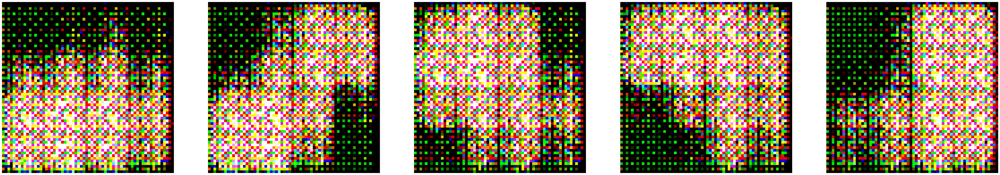

  0%|          | 0/19 [00:00<?, ?it/s]

[2/100][9/19] Loss_D: 0.8409 Loss_G: 4.3961 D(x): 0.7276 D(G(z)): 0.2845 / 0.0097
[2/100][18/19] Loss_D: 1.0727 Loss_G: 2.6613 D(x): 0.5382 D(G(z)): 0.1759 / 0.0655


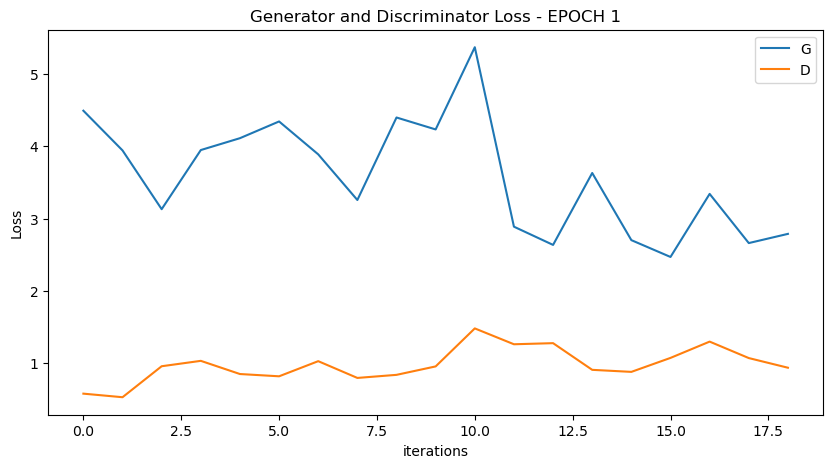

  0%|          | 0/19 [00:00<?, ?it/s]

[3/100][9/19] Loss_D: 1.5481 Loss_G: 2.9674 D(x): 0.2748 D(G(z)): 0.0612 / 0.0504
[3/100][18/19] Loss_D: 1.4742 Loss_G: 2.3556 D(x): 0.4337 D(G(z)): 0.3793 / 0.0789


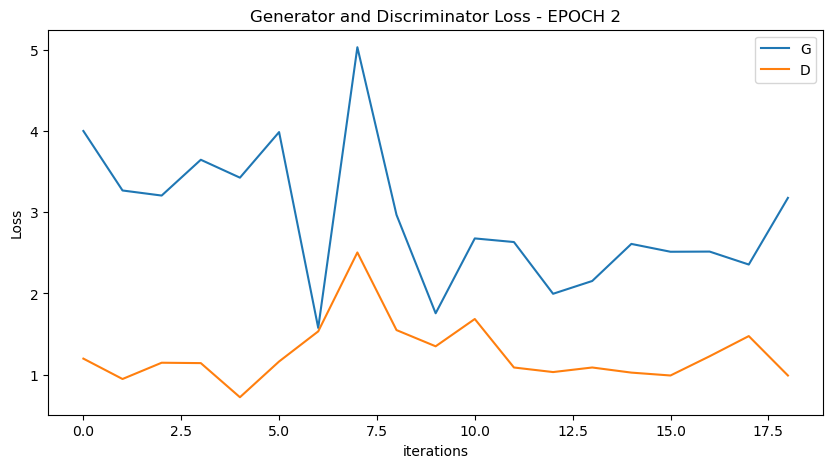

  0%|          | 0/19 [00:00<?, ?it/s]

[4/100][9/19] Loss_D: 1.3794 Loss_G: 1.4333 D(x): 0.2935 D(G(z)): 0.0563 / 0.2590
[4/100][18/19] Loss_D: 0.8674 Loss_G: 2.6093 D(x): 0.7532 D(G(z)): 0.3293 / 0.0641


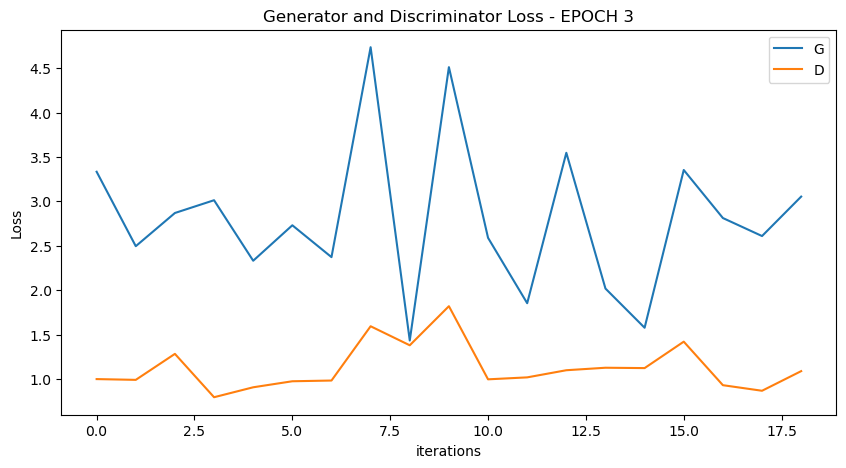

  0%|          | 0/19 [00:00<?, ?it/s]

[5/100][9/19] Loss_D: 1.2305 Loss_G: 1.3718 D(x): 0.5103 D(G(z)): 0.3666 / 0.2428
[5/100][18/19] Loss_D: 1.0855 Loss_G: 1.6254 D(x): 0.5153 D(G(z)): 0.3009 / 0.1809


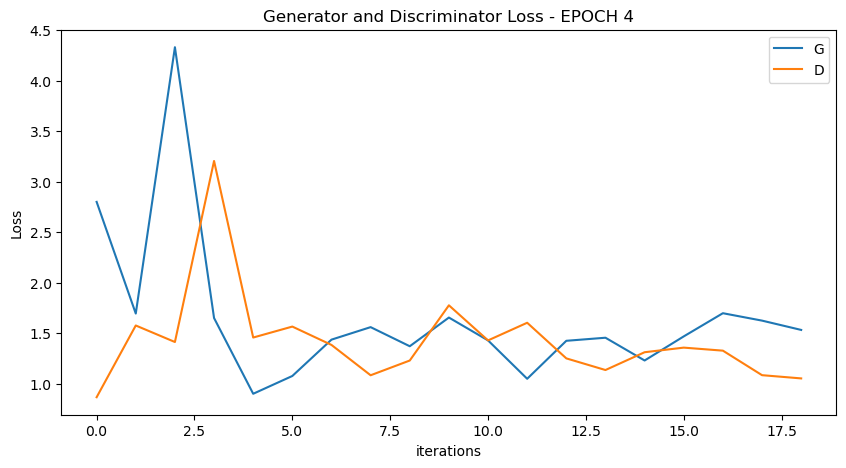

  0%|          | 0/19 [00:00<?, ?it/s]

[6/100][9/19] Loss_D: 1.5276 Loss_G: 1.1764 D(x): 0.3391 D(G(z)): 0.3488 / 0.2968
[6/100][18/19] Loss_D: 1.0405 Loss_G: 1.6305 D(x): 0.6015 D(G(z)): 0.3577 / 0.1822


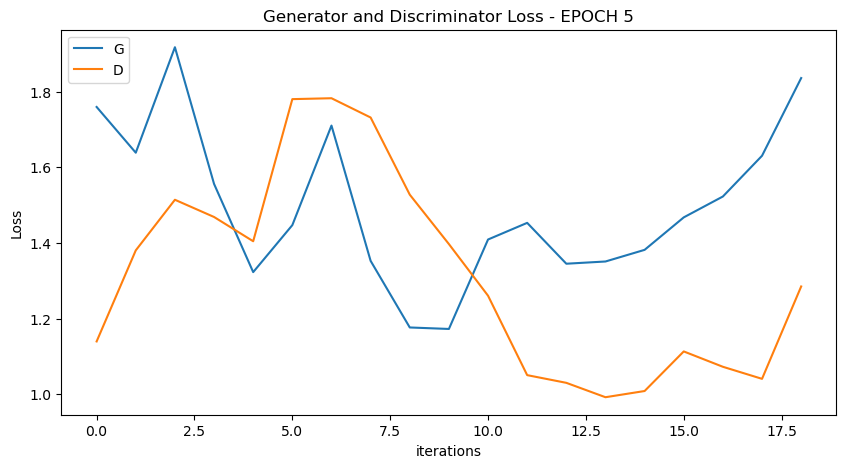

  0%|          | 0/19 [00:00<?, ?it/s]

[7/100][9/19] Loss_D: 1.2409 Loss_G: 1.5275 D(x): 0.6166 D(G(z)): 0.4670 / 0.1987
[7/100][18/19] Loss_D: 1.3957 Loss_G: 1.2743 D(x): 0.4406 D(G(z)): 0.4103 / 0.2559


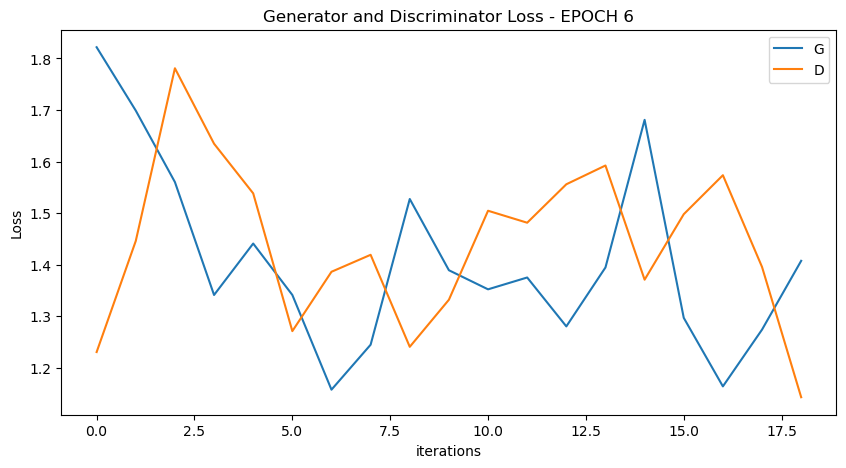

  0%|          | 0/19 [00:00<?, ?it/s]

[8/100][9/19] Loss_D: 1.4574 Loss_G: 1.1854 D(x): 0.4276 D(G(z)): 0.4416 / 0.2921
[8/100][18/19] Loss_D: 1.7687 Loss_G: 1.3455 D(x): 0.4141 D(G(z)): 0.5461 / 0.2356


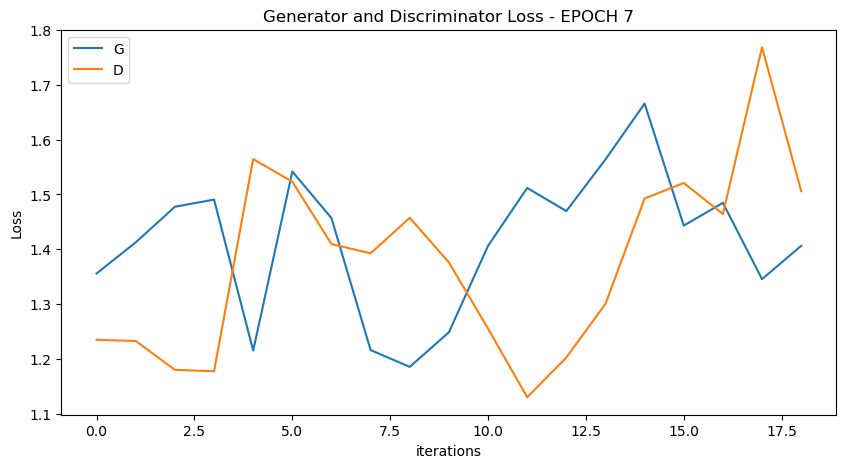

  0%|          | 0/19 [00:00<?, ?it/s]

[9/100][9/19] Loss_D: 1.4246 Loss_G: 1.2967 D(x): 0.4653 D(G(z)): 0.4282 / 0.2500
[9/100][18/19] Loss_D: 1.3620 Loss_G: 1.2933 D(x): 0.5227 D(G(z)): 0.4751 / 0.2571


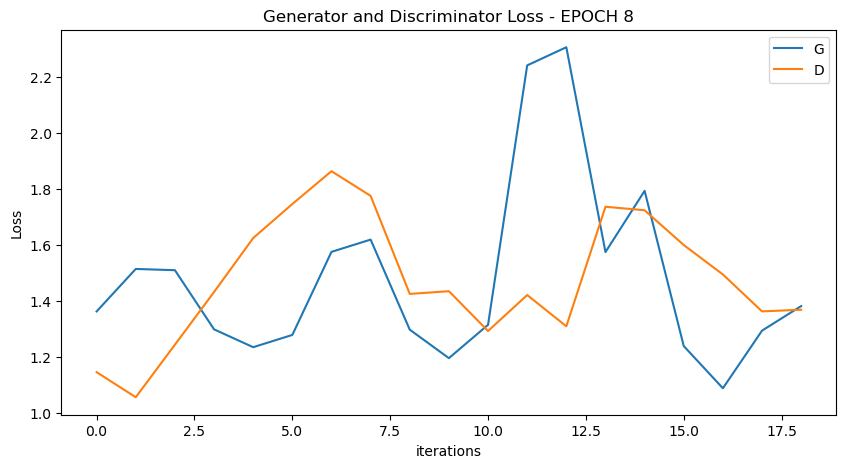

  0%|          | 0/19 [00:00<?, ?it/s]

[10/100][9/19] Loss_D: 1.1887 Loss_G: 1.5968 D(x): 0.5087 D(G(z)): 0.3712 / 0.1857
[10/100][18/19] Loss_D: 1.3249 Loss_G: 1.6990 D(x): 0.5455 D(G(z)): 0.4763 / 0.1754


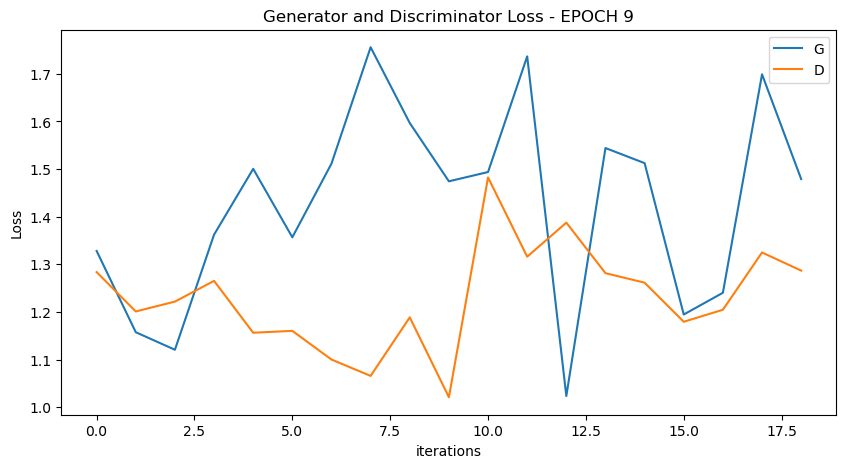

  0%|          | 0/19 [00:00<?, ?it/s]

[11/100][9/19] Loss_D: 1.5214 Loss_G: 1.8256 D(x): 0.3886 D(G(z)): 0.4010 / 0.1410
[11/100][18/19] Loss_D: 1.3083 Loss_G: 1.2300 D(x): 0.4956 D(G(z)): 0.4110 / 0.2802


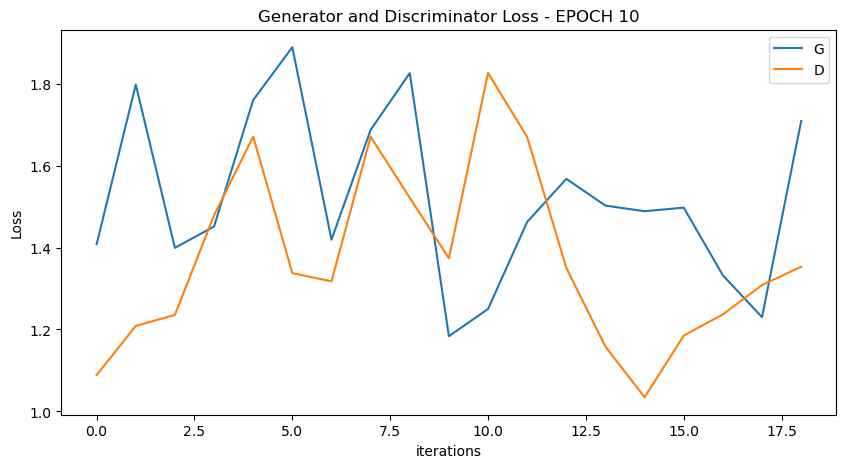

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


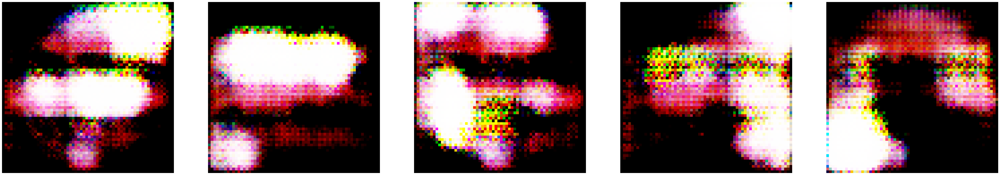

  0%|          | 0/19 [00:00<?, ?it/s]

[12/100][9/19] Loss_D: 1.4522 Loss_G: 1.8006 D(x): 0.3553 D(G(z)): 0.3311 / 0.1505
[12/100][18/19] Loss_D: 1.4844 Loss_G: 2.7704 D(x): 0.5472 D(G(z)): 0.4997 / 0.0568


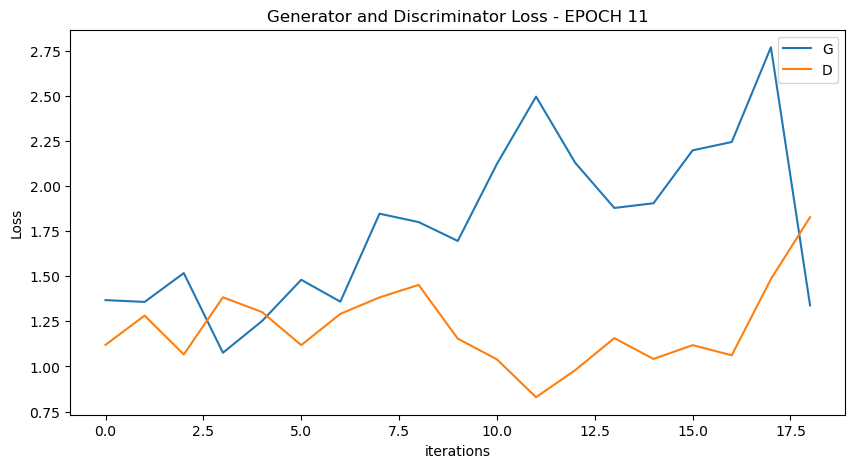

  0%|          | 0/19 [00:00<?, ?it/s]

[13/100][9/19] Loss_D: 0.8196 Loss_G: 1.8296 D(x): 0.7557 D(G(z)): 0.3113 / 0.1407
[13/100][18/19] Loss_D: 1.7403 Loss_G: 1.4352 D(x): 0.3353 D(G(z)): 0.3761 / 0.2235


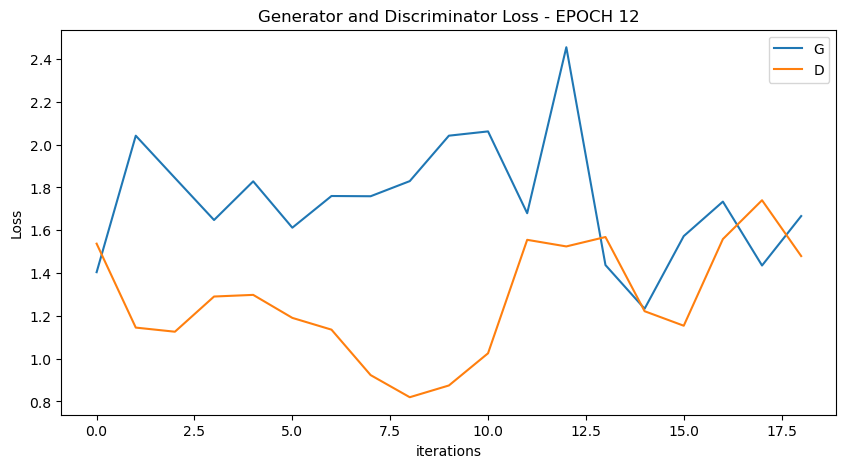

  0%|          | 0/19 [00:00<?, ?it/s]

[14/100][9/19] Loss_D: 1.4779 Loss_G: 1.6590 D(x): 0.4767 D(G(z)): 0.4657 / 0.1811
[14/100][18/19] Loss_D: 1.9428 Loss_G: 1.4062 D(x): 0.3577 D(G(z)): 0.5256 / 0.2277


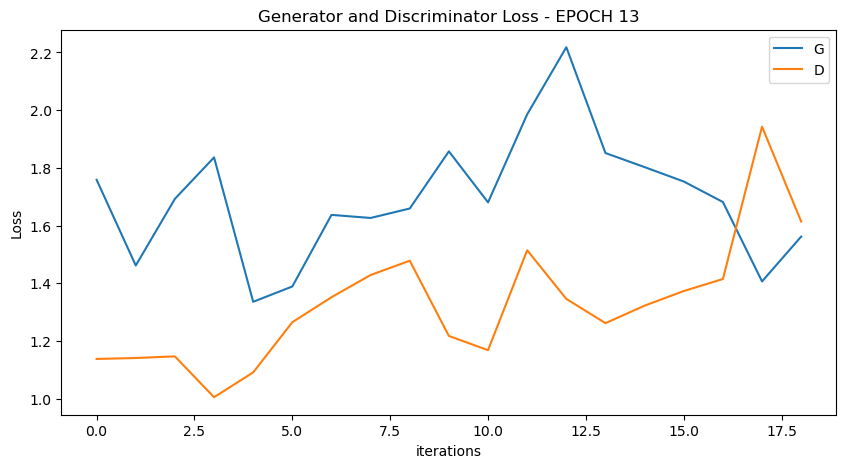

  0%|          | 0/19 [00:00<?, ?it/s]

[15/100][9/19] Loss_D: 1.3093 Loss_G: 1.7284 D(x): 0.6658 D(G(z)): 0.5357 / 0.1604
[15/100][18/19] Loss_D: 1.3063 Loss_G: 2.0842 D(x): 0.5337 D(G(z)): 0.4366 / 0.1141


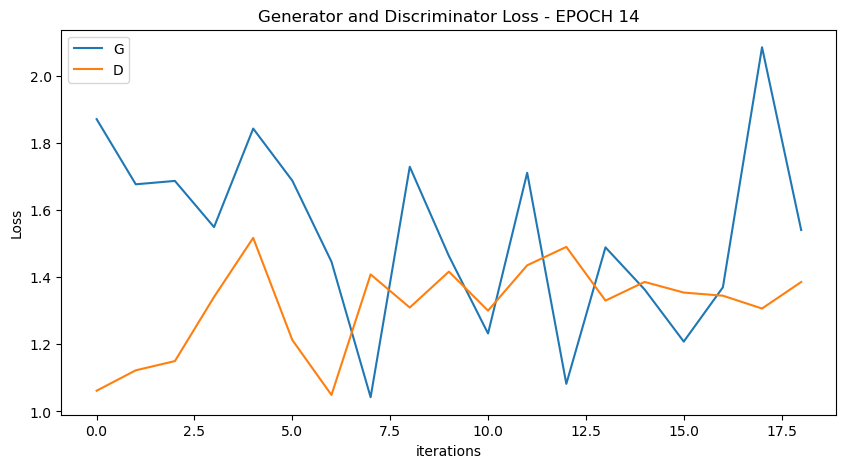

  0%|          | 0/19 [00:00<?, ?it/s]

[16/100][9/19] Loss_D: 1.0688 Loss_G: 1.5680 D(x): 0.5574 D(G(z)): 0.3321 / 0.1905
[16/100][18/19] Loss_D: 1.2145 Loss_G: 1.4501 D(x): 0.5648 D(G(z)): 0.4300 / 0.2202


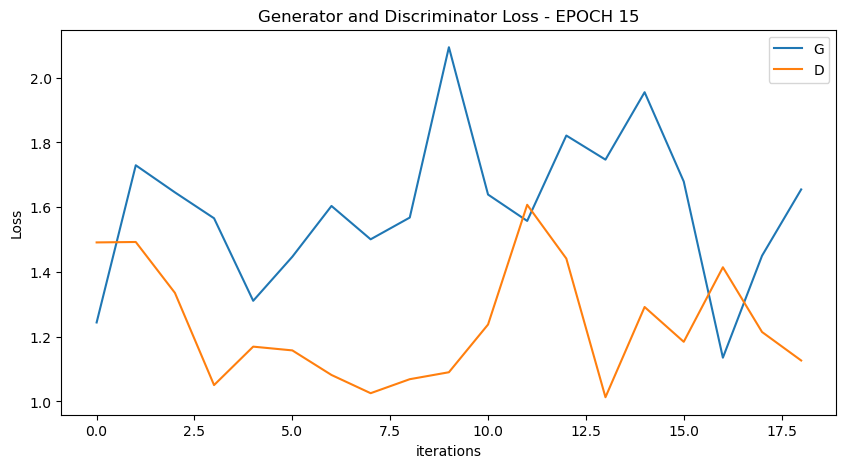

  0%|          | 0/19 [00:00<?, ?it/s]

[17/100][9/19] Loss_D: 1.4006 Loss_G: 1.5141 D(x): 0.5471 D(G(z)): 0.4718 / 0.2201
[17/100][18/19] Loss_D: 1.4602 Loss_G: 1.6281 D(x): 0.4914 D(G(z)): 0.4781 / 0.1803


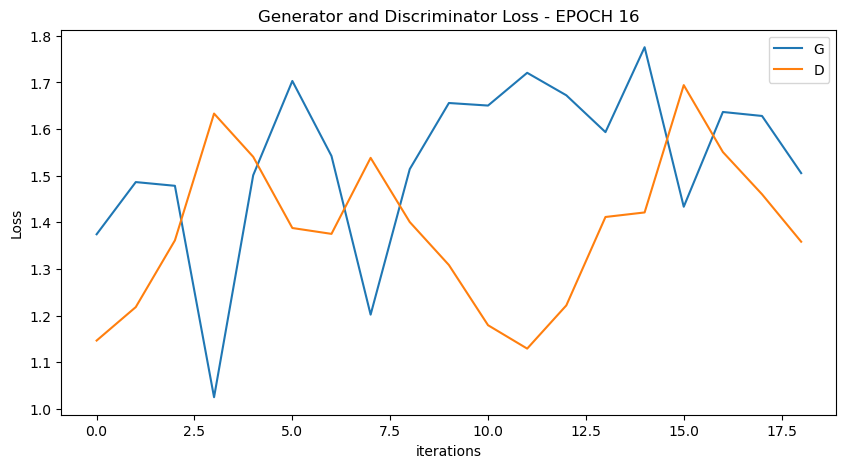

  0%|          | 0/19 [00:00<?, ?it/s]

[18/100][9/19] Loss_D: 1.2878 Loss_G: 1.3535 D(x): 0.4314 D(G(z)): 0.3502 / 0.2422
[18/100][18/19] Loss_D: 1.6446 Loss_G: 0.9314 D(x): 0.3479 D(G(z)): 0.4357 / 0.3857


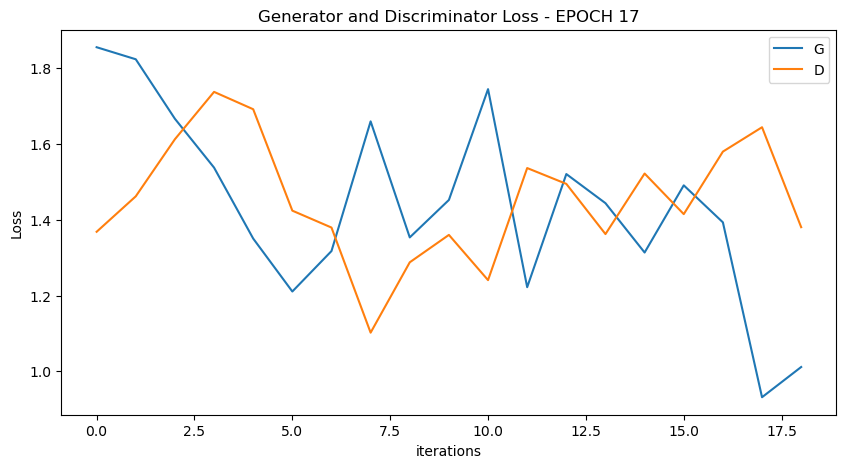

  0%|          | 0/19 [00:00<?, ?it/s]

[19/100][9/19] Loss_D: 1.3165 Loss_G: 1.2116 D(x): 0.4493 D(G(z)): 0.3865 / 0.2764
[19/100][18/19] Loss_D: 1.2228 Loss_G: 1.3331 D(x): 0.4828 D(G(z)): 0.3588 / 0.2411


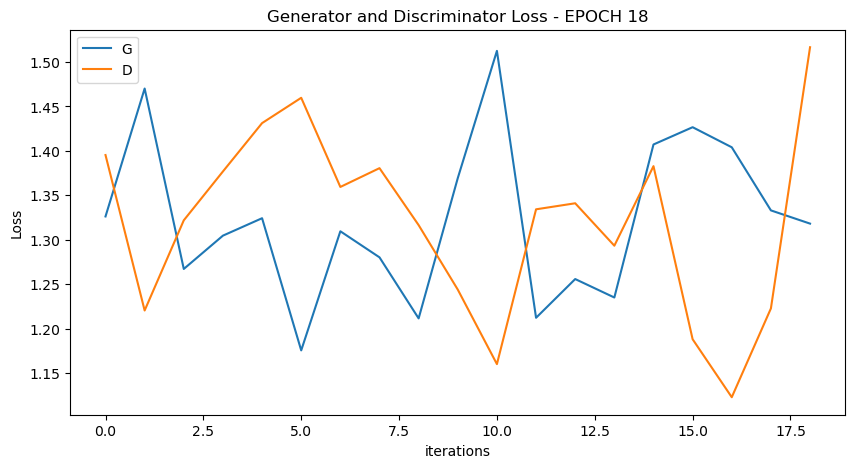

  0%|          | 0/19 [00:00<?, ?it/s]

[20/100][9/19] Loss_D: 1.3402 Loss_G: 1.3189 D(x): 0.5132 D(G(z)): 0.4572 / 0.2538
[20/100][18/19] Loss_D: 1.3808 Loss_G: 1.4355 D(x): 0.6561 D(G(z)): 0.5439 / 0.2329


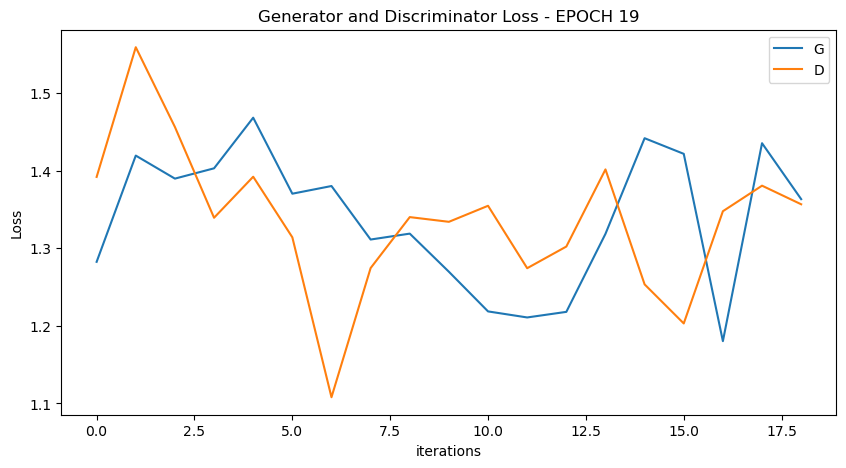

  0%|          | 0/19 [00:00<?, ?it/s]

[21/100][9/19] Loss_D: 1.4819 Loss_G: 2.2226 D(x): 0.4239 D(G(z)): 0.4294 / 0.0971
[21/100][18/19] Loss_D: 1.3553 Loss_G: 1.4974 D(x): 0.6152 D(G(z)): 0.5088 / 0.2153


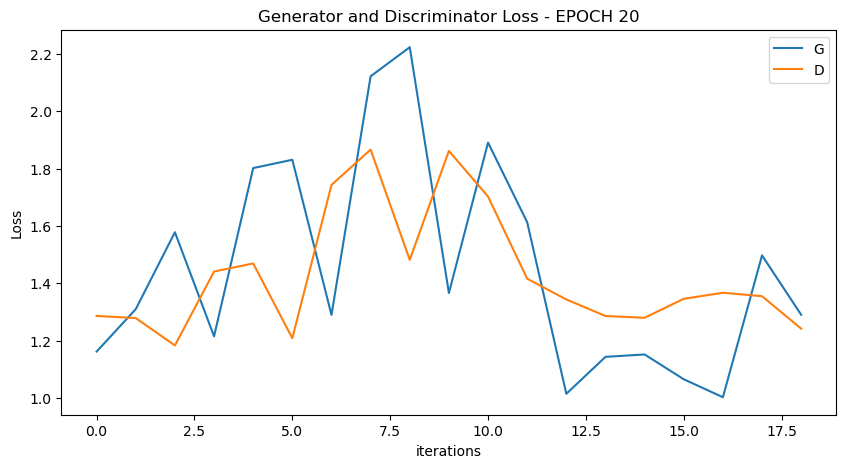

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


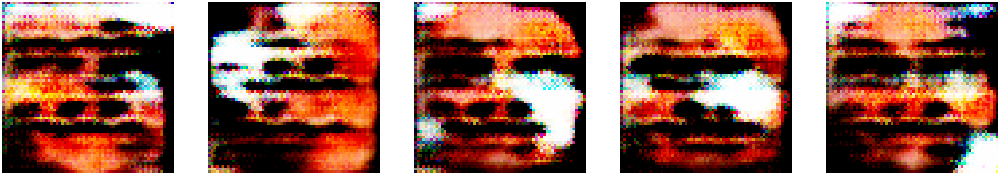

  0%|          | 0/19 [00:00<?, ?it/s]

[22/100][9/19] Loss_D: 1.2416 Loss_G: 1.2234 D(x): 0.5331 D(G(z)): 0.4168 / 0.2915
[22/100][18/19] Loss_D: 1.1732 Loss_G: 1.3639 D(x): 0.5589 D(G(z)): 0.3960 / 0.2334


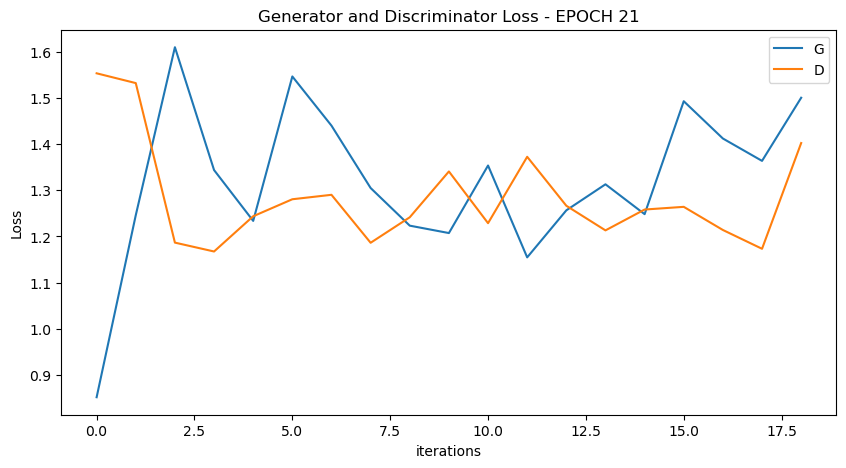

  0%|          | 0/19 [00:00<?, ?it/s]

[23/100][9/19] Loss_D: 1.3390 Loss_G: 1.3613 D(x): 0.4844 D(G(z)): 0.4205 / 0.2390
[23/100][18/19] Loss_D: 1.4626 Loss_G: 1.3998 D(x): 0.4355 D(G(z)): 0.4522 / 0.2343


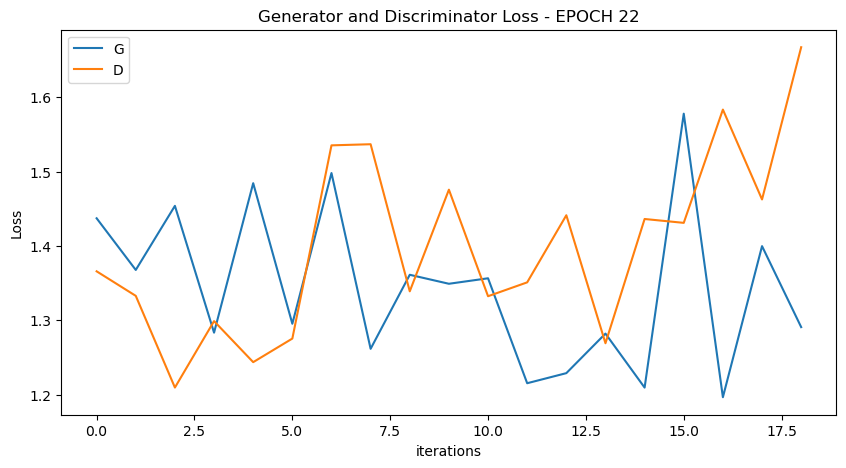

  0%|          | 0/19 [00:00<?, ?it/s]

[24/100][9/19] Loss_D: 1.7398 Loss_G: 1.9393 D(x): 0.4632 D(G(z)): 0.5787 / 0.1264
[24/100][18/19] Loss_D: 1.0632 Loss_G: 1.5910 D(x): 0.5943 D(G(z)): 0.3649 / 0.1869


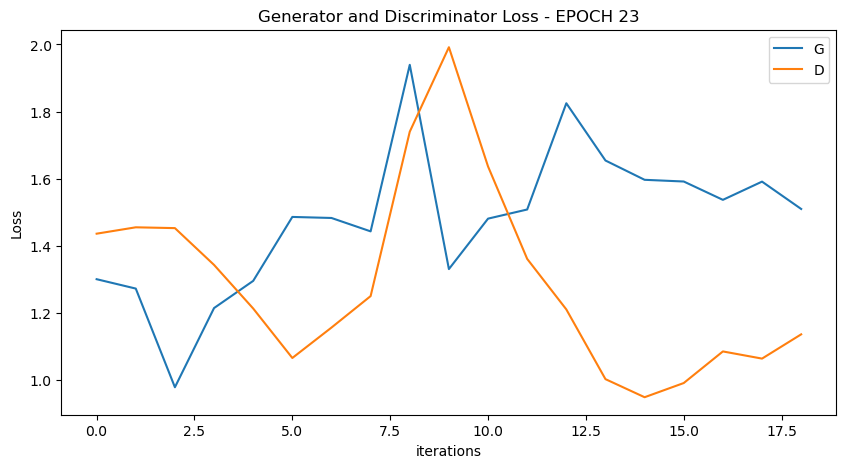

  0%|          | 0/19 [00:00<?, ?it/s]

[25/100][9/19] Loss_D: 1.5734 Loss_G: 1.4175 D(x): 0.2543 D(G(z)): 0.1886 / 0.2304
[25/100][18/19] Loss_D: 1.3318 Loss_G: 1.4246 D(x): 0.4454 D(G(z)): 0.3900 / 0.2249


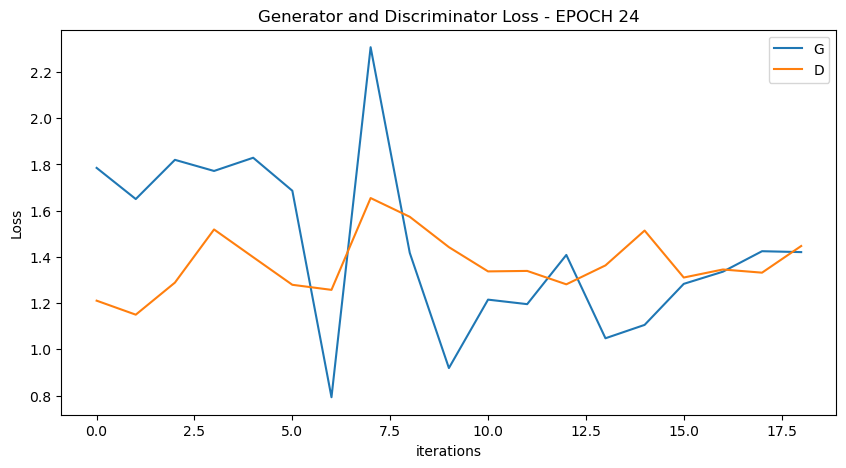

  0%|          | 0/19 [00:00<?, ?it/s]

[26/100][9/19] Loss_D: 1.3608 Loss_G: 1.4237 D(x): 0.4659 D(G(z)): 0.4150 / 0.2236
[26/100][18/19] Loss_D: 1.4210 Loss_G: 1.1827 D(x): 0.4433 D(G(z)): 0.4185 / 0.2905


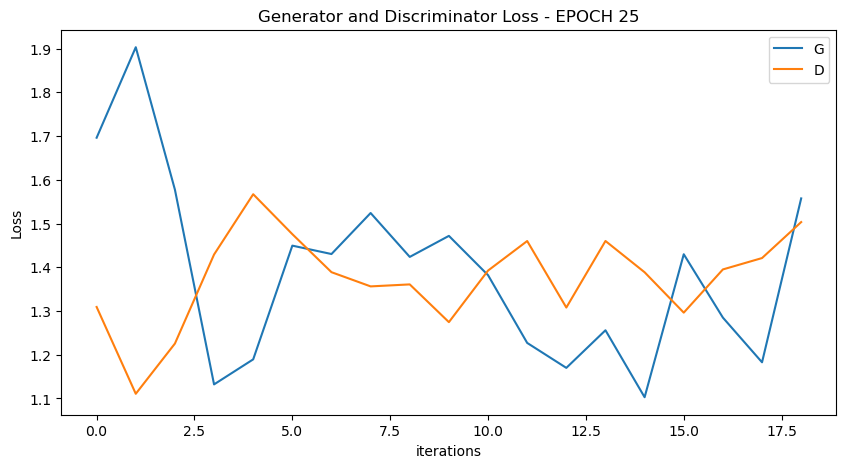

  0%|          | 0/19 [00:00<?, ?it/s]

[27/100][9/19] Loss_D: 1.4542 Loss_G: 1.0323 D(x): 0.3881 D(G(z)): 0.3936 / 0.3468
[27/100][18/19] Loss_D: 1.1463 Loss_G: 1.3872 D(x): 0.5088 D(G(z)): 0.3362 / 0.2307


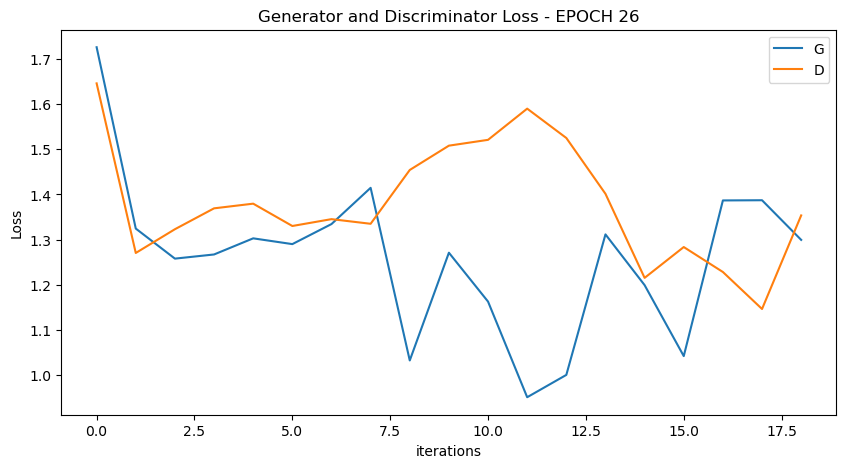

  0%|          | 0/19 [00:00<?, ?it/s]

[28/100][9/19] Loss_D: 1.4611 Loss_G: 1.1717 D(x): 0.4483 D(G(z)): 0.4697 / 0.2967
[28/100][18/19] Loss_D: 1.1415 Loss_G: 1.3385 D(x): 0.5575 D(G(z)): 0.3834 / 0.2494


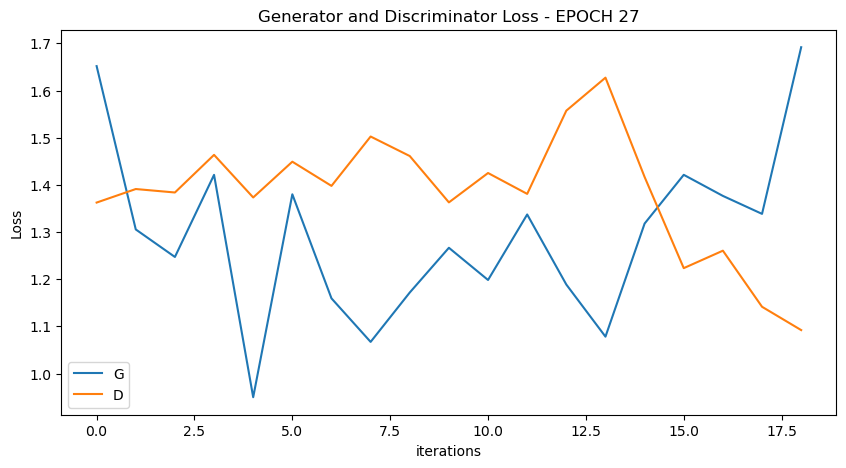

  0%|          | 0/19 [00:00<?, ?it/s]

[29/100][9/19] Loss_D: 1.6425 Loss_G: 1.8231 D(x): 0.5665 D(G(z)): 0.6236 / 0.1432
[29/100][18/19] Loss_D: 1.1174 Loss_G: 2.2104 D(x): 0.6156 D(G(z)): 0.4230 / 0.0901


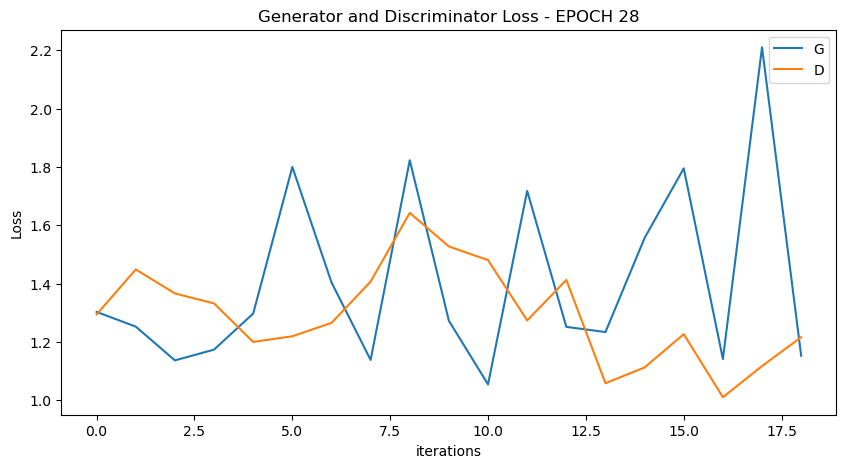

  0%|          | 0/19 [00:00<?, ?it/s]

[30/100][9/19] Loss_D: 1.2150 Loss_G: 1.6100 D(x): 0.5989 D(G(z)): 0.4552 / 0.1808
[30/100][18/19] Loss_D: 1.2913 Loss_G: 1.6633 D(x): 0.4447 D(G(z)): 0.3625 / 0.1714


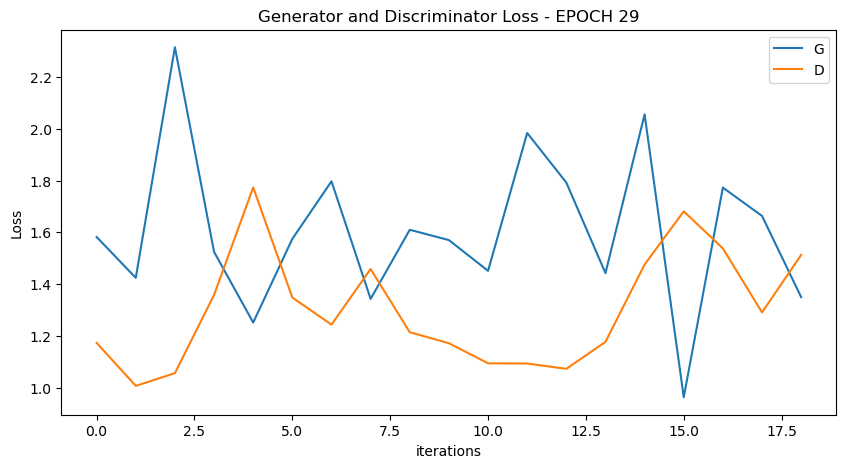

  0%|          | 0/19 [00:00<?, ?it/s]

[31/100][9/19] Loss_D: 1.4890 Loss_G: 1.2159 D(x): 0.3304 D(G(z)): 0.3232 / 0.2828
[31/100][18/19] Loss_D: 1.2918 Loss_G: 1.2644 D(x): 0.3651 D(G(z)): 0.2683 / 0.2605


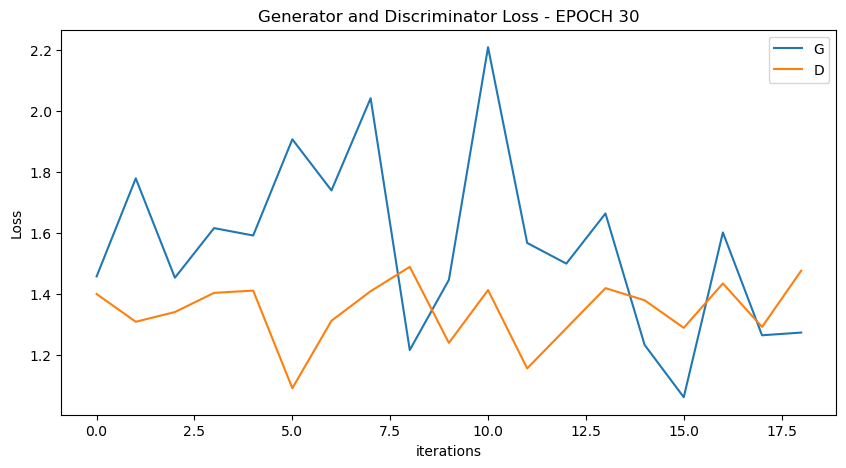

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


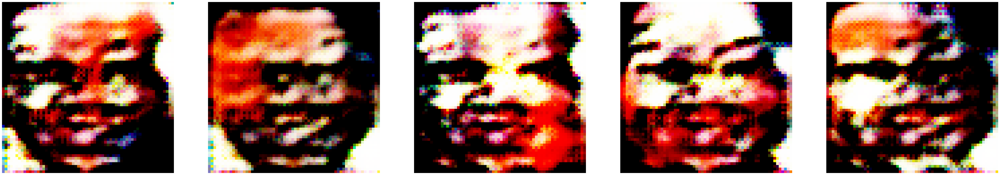

  0%|          | 0/19 [00:00<?, ?it/s]

[32/100][9/19] Loss_D: 1.3415 Loss_G: 1.3969 D(x): 0.4933 D(G(z)): 0.4247 / 0.2349
[32/100][18/19] Loss_D: 1.4526 Loss_G: 1.2326 D(x): 0.3960 D(G(z)): 0.3788 / 0.2700


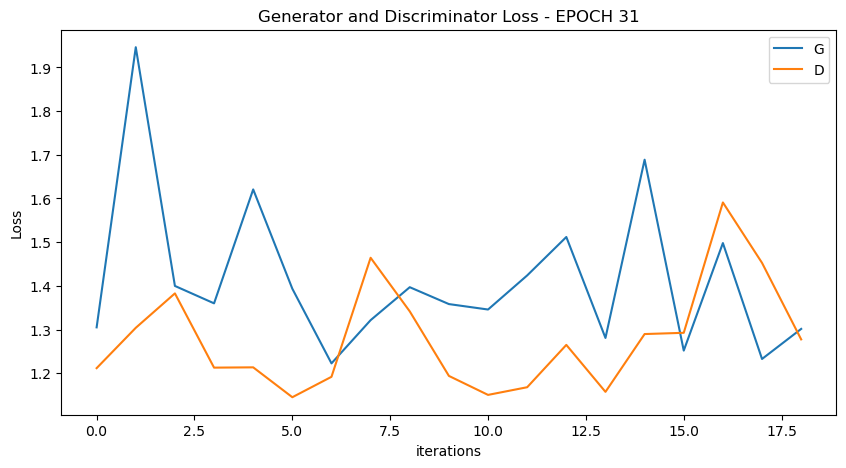

  0%|          | 0/19 [00:00<?, ?it/s]

[33/100][9/19] Loss_D: 1.3624 Loss_G: 1.5055 D(x): 0.5954 D(G(z)): 0.5013 / 0.2158
[33/100][18/19] Loss_D: 1.2172 Loss_G: 1.3867 D(x): 0.4953 D(G(z)): 0.3595 / 0.2343


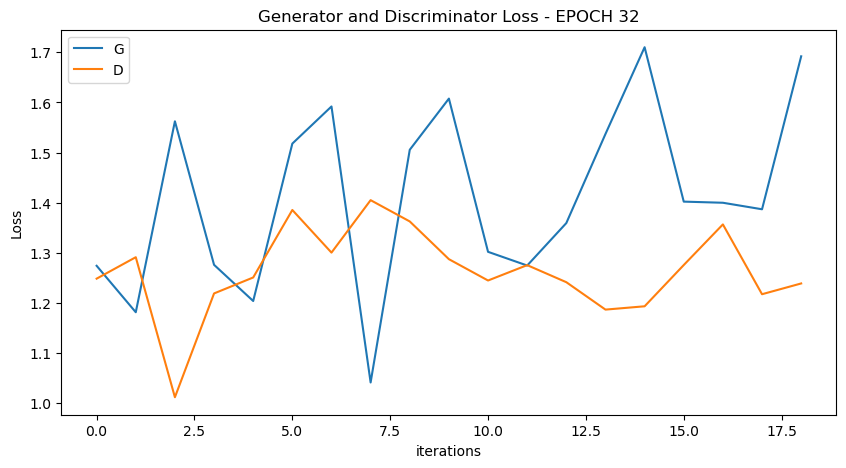

  0%|          | 0/19 [00:00<?, ?it/s]

[34/100][9/19] Loss_D: 1.5302 Loss_G: 1.0919 D(x): 0.4783 D(G(z)): 0.5073 / 0.3316
[34/100][18/19] Loss_D: 1.1825 Loss_G: 1.8097 D(x): 0.5332 D(G(z)): 0.3727 / 0.1455


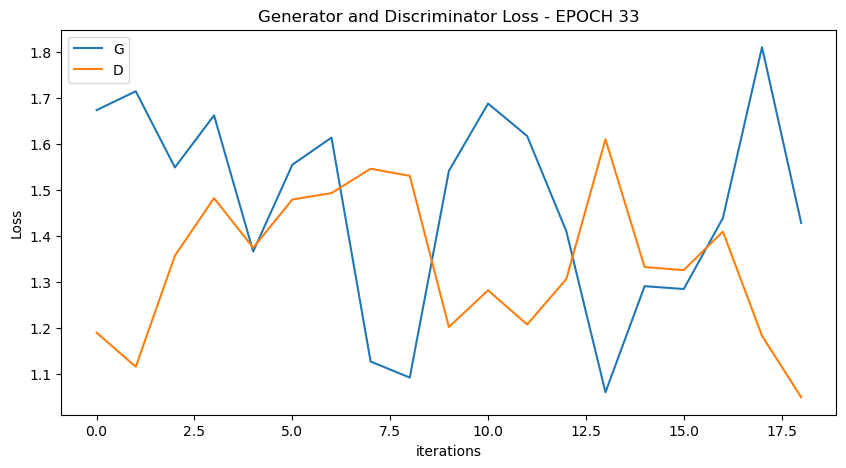

  0%|          | 0/19 [00:00<?, ?it/s]

[35/100][9/19] Loss_D: 1.2864 Loss_G: 1.8027 D(x): 0.5686 D(G(z)): 0.4599 / 0.1515
[35/100][18/19] Loss_D: 1.1078 Loss_G: 1.6400 D(x): 0.6183 D(G(z)): 0.4208 / 0.1763


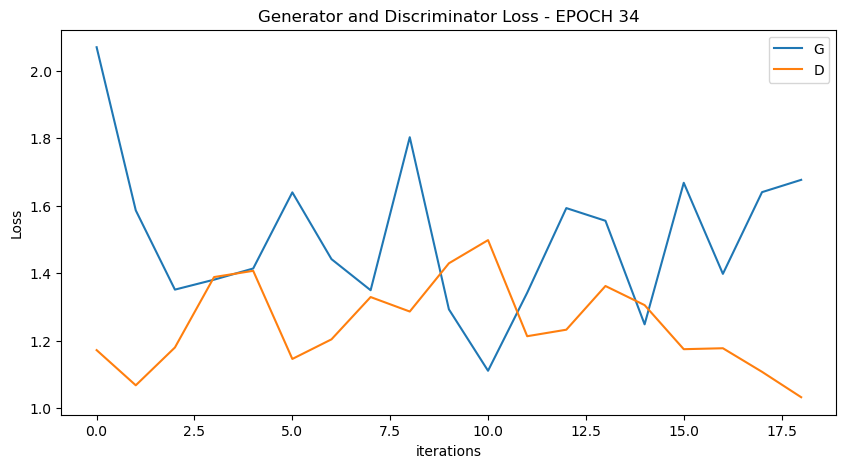

  0%|          | 0/19 [00:00<?, ?it/s]

[36/100][9/19] Loss_D: 1.0668 Loss_G: 2.2871 D(x): 0.6258 D(G(z)): 0.4049 / 0.0846
[36/100][18/19] Loss_D: 1.4742 Loss_G: 1.3409 D(x): 0.4504 D(G(z)): 0.4549 / 0.2430


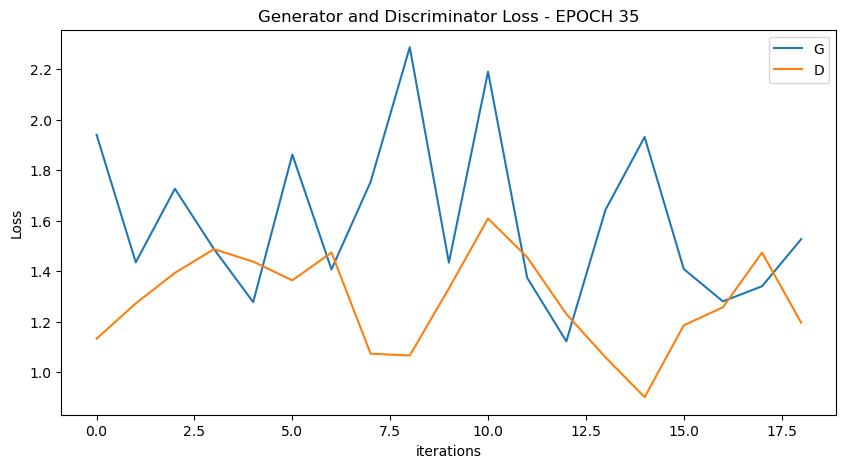

  0%|          | 0/19 [00:00<?, ?it/s]

[37/100][9/19] Loss_D: 1.2467 Loss_G: 1.7307 D(x): 0.5935 D(G(z)): 0.4701 / 0.1657
[37/100][18/19] Loss_D: 1.2319 Loss_G: 1.7333 D(x): 0.5409 D(G(z)): 0.4138 / 0.1596


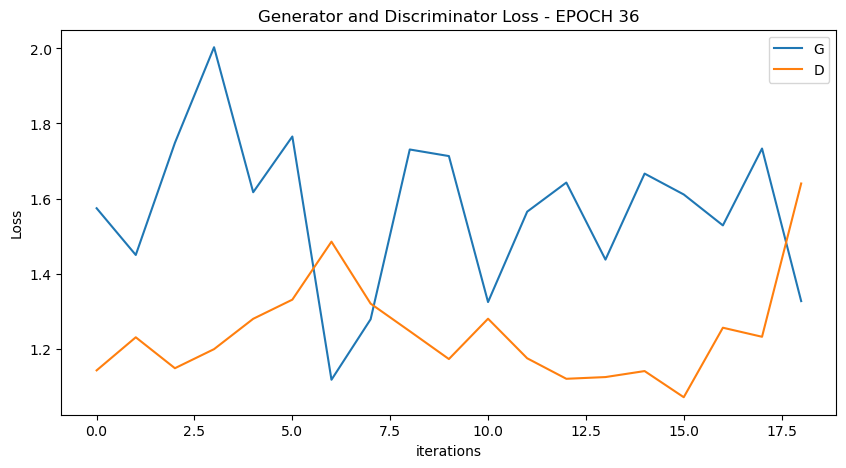

  0%|          | 0/19 [00:00<?, ?it/s]

[38/100][9/19] Loss_D: 1.2795 Loss_G: 2.1601 D(x): 0.4836 D(G(z)): 0.3764 / 0.0994
[38/100][18/19] Loss_D: 1.3264 Loss_G: 1.8247 D(x): 0.6063 D(G(z)): 0.4964 / 0.1530


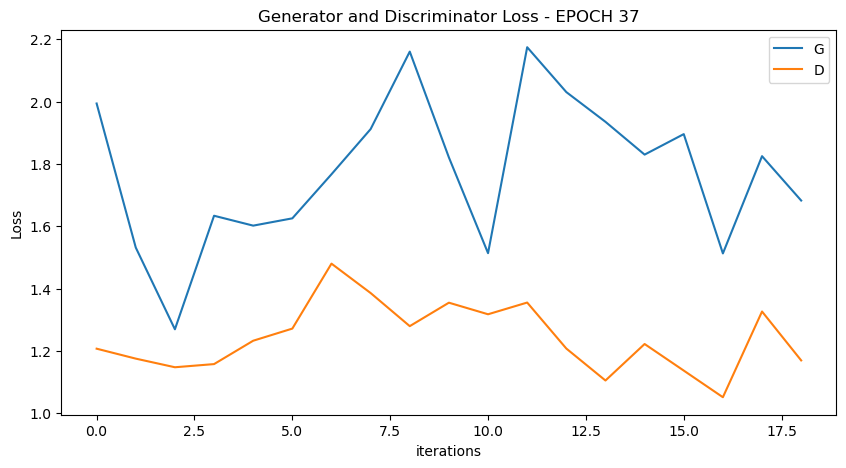

  0%|          | 0/19 [00:00<?, ?it/s]

[39/100][9/19] Loss_D: 0.9591 Loss_G: 1.6583 D(x): 0.6246 D(G(z)): 0.3319 / 0.1672
[39/100][18/19] Loss_D: 1.0245 Loss_G: 1.8020 D(x): 0.5414 D(G(z)): 0.2917 / 0.1491


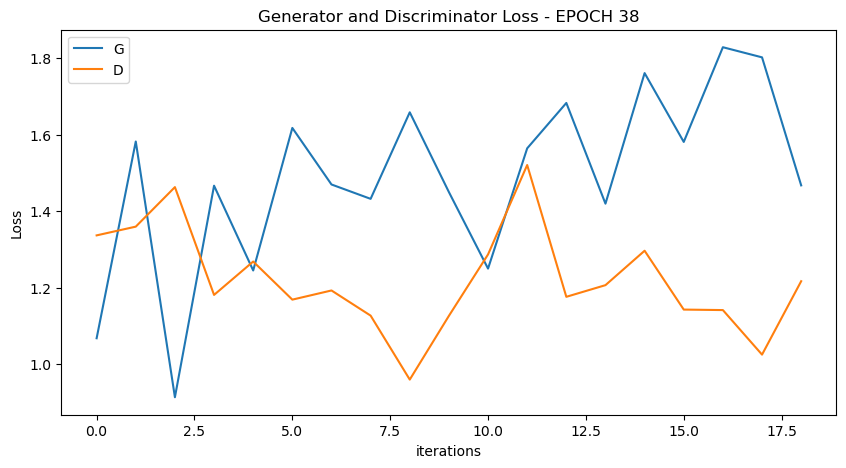

  0%|          | 0/19 [00:00<?, ?it/s]

[40/100][9/19] Loss_D: 1.2004 Loss_G: 1.9043 D(x): 0.6196 D(G(z)): 0.4740 / 0.1309
[40/100][18/19] Loss_D: 1.3737 Loss_G: 1.3175 D(x): 0.4729 D(G(z)): 0.4448 / 0.2526


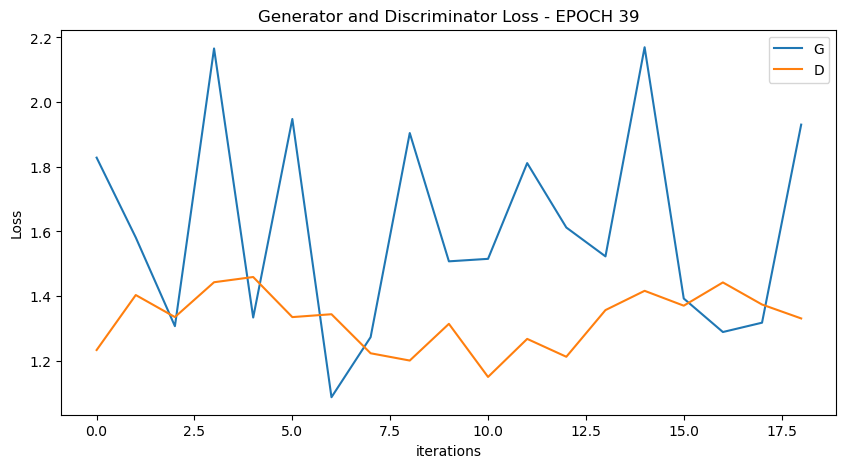

  0%|          | 0/19 [00:00<?, ?it/s]

[41/100][9/19] Loss_D: 1.1314 Loss_G: 1.7790 D(x): 0.4278 D(G(z)): 0.2392 / 0.1598
[41/100][18/19] Loss_D: 1.3668 Loss_G: 1.3601 D(x): 0.4173 D(G(z)): 0.3791 / 0.2411


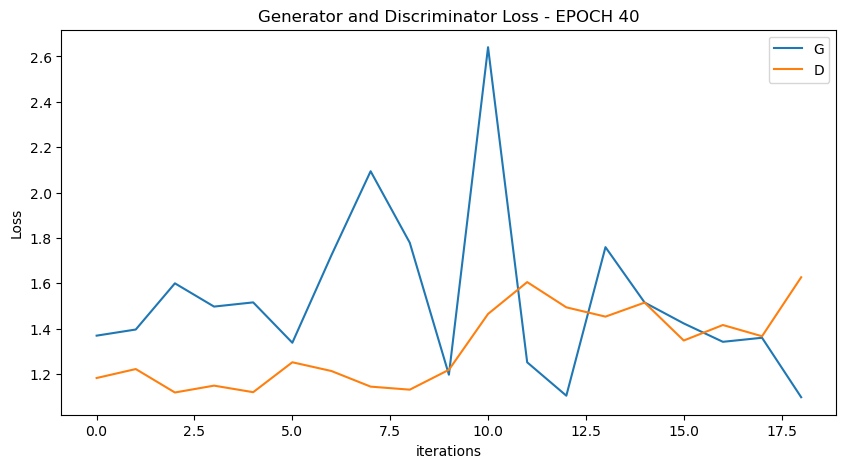

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


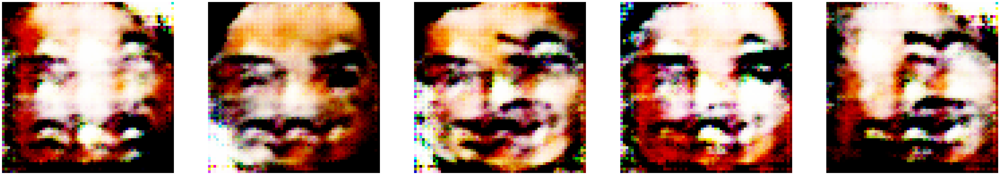

  0%|          | 0/19 [00:00<?, ?it/s]

[42/100][9/19] Loss_D: 1.0467 Loss_G: 1.4679 D(x): 0.4938 D(G(z)): 0.2539 / 0.2120
[42/100][18/19] Loss_D: 1.0975 Loss_G: 1.8071 D(x): 0.4919 D(G(z)): 0.2516 / 0.1770


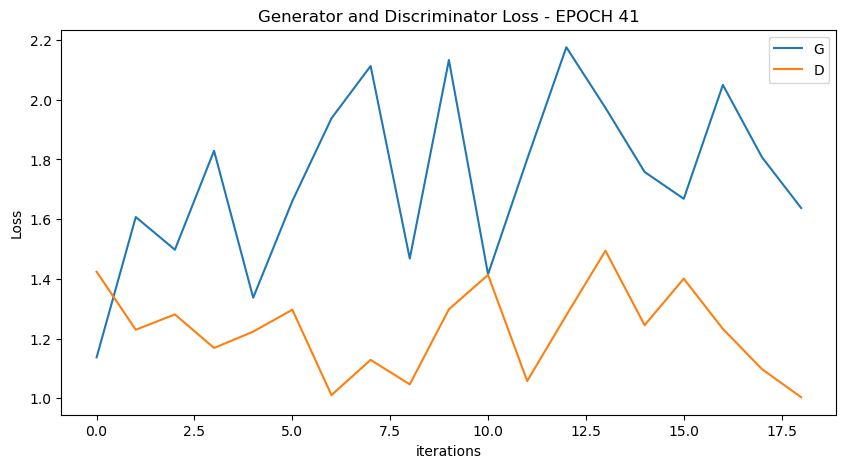

  0%|          | 0/19 [00:00<?, ?it/s]

[43/100][9/19] Loss_D: 1.4709 Loss_G: 1.6042 D(x): 0.5146 D(G(z)): 0.5077 / 0.1994
[43/100][18/19] Loss_D: 1.2116 Loss_G: 1.4699 D(x): 0.5958 D(G(z)): 0.4612 / 0.2086


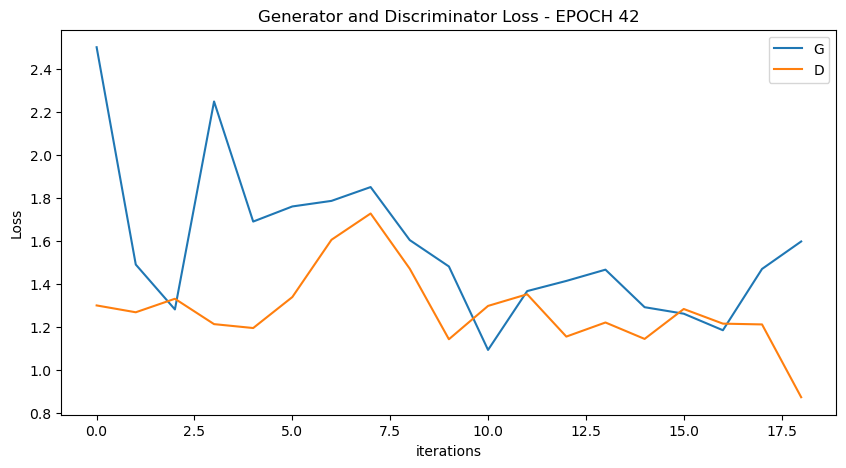

  0%|          | 0/19 [00:00<?, ?it/s]

[44/100][9/19] Loss_D: 1.3167 Loss_G: 1.6199 D(x): 0.4608 D(G(z)): 0.3883 / 0.1845
[44/100][18/19] Loss_D: 1.3225 Loss_G: 2.0658 D(x): 0.8102 D(G(z)): 0.5929 / 0.1206


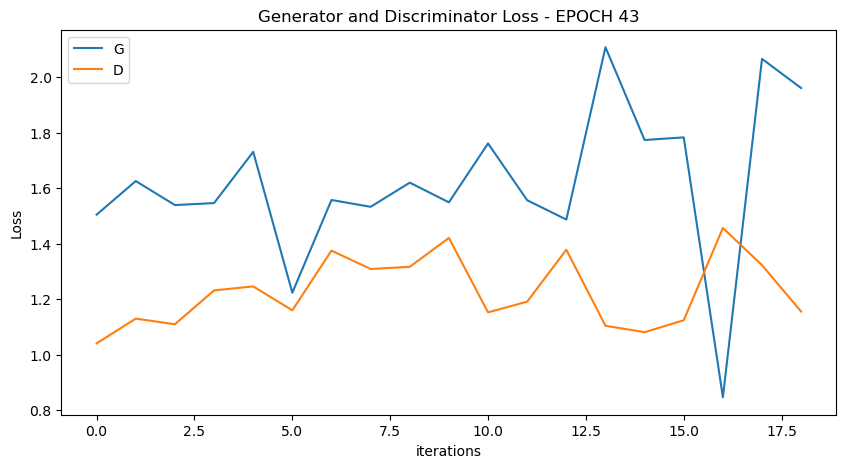

  0%|          | 0/19 [00:00<?, ?it/s]

[45/100][9/19] Loss_D: 1.1265 Loss_G: 1.7771 D(x): 0.5828 D(G(z)): 0.3892 / 0.1559
[45/100][18/19] Loss_D: 1.2439 Loss_G: 2.2426 D(x): 0.5004 D(G(z)): 0.3696 / 0.0960


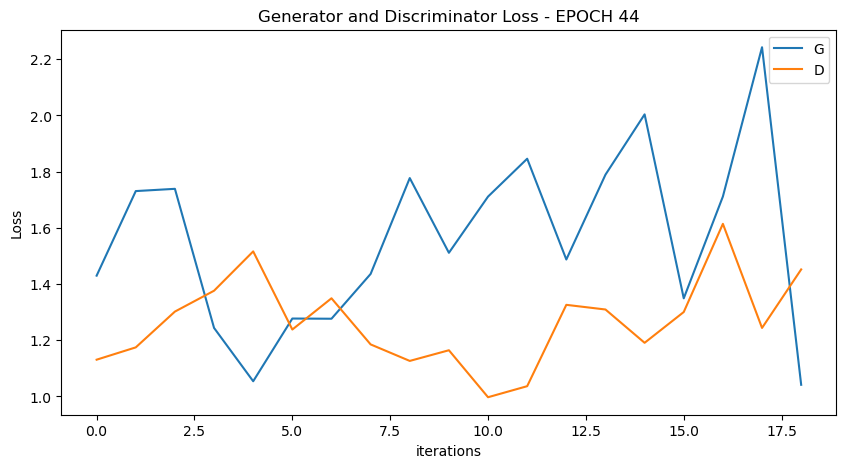

  0%|          | 0/19 [00:00<?, ?it/s]

[46/100][9/19] Loss_D: 1.3889 Loss_G: 1.4272 D(x): 0.4032 D(G(z)): 0.3445 / 0.2256
[46/100][18/19] Loss_D: 1.4164 Loss_G: 1.2712 D(x): 0.4193 D(G(z)): 0.4018 / 0.2675


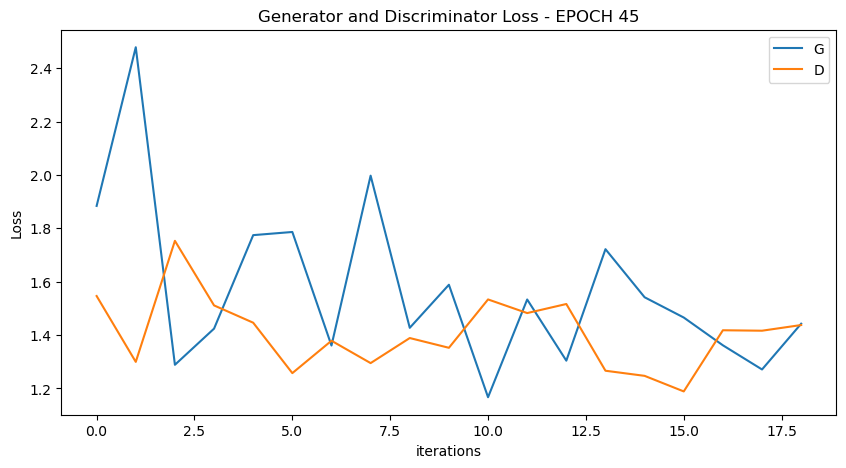

  0%|          | 0/19 [00:00<?, ?it/s]

[47/100][9/19] Loss_D: 1.2794 Loss_G: 1.6378 D(x): 0.4241 D(G(z)): 0.3066 / 0.1955
[47/100][18/19] Loss_D: 1.0058 Loss_G: 2.0372 D(x): 0.7422 D(G(z)): 0.4160 / 0.1259


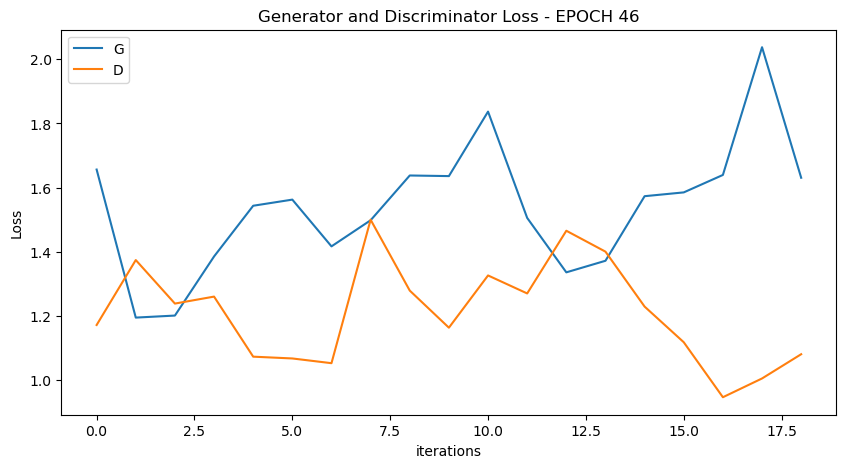

  0%|          | 0/19 [00:00<?, ?it/s]

[48/100][9/19] Loss_D: 1.2230 Loss_G: 1.7849 D(x): 0.4332 D(G(z)): 0.2951 / 0.1561
[48/100][18/19] Loss_D: 1.0757 Loss_G: 2.3050 D(x): 0.7193 D(G(z)): 0.4455 / 0.0868


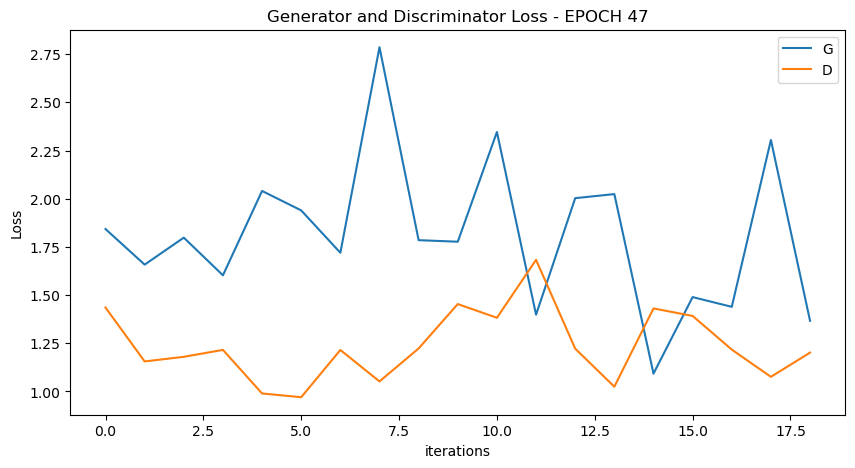

  0%|          | 0/19 [00:00<?, ?it/s]

[49/100][9/19] Loss_D: 1.1406 Loss_G: 1.6346 D(x): 0.5592 D(G(z)): 0.3741 / 0.1879
[49/100][18/19] Loss_D: 1.2508 Loss_G: 1.2501 D(x): 0.5203 D(G(z)): 0.3799 / 0.2691


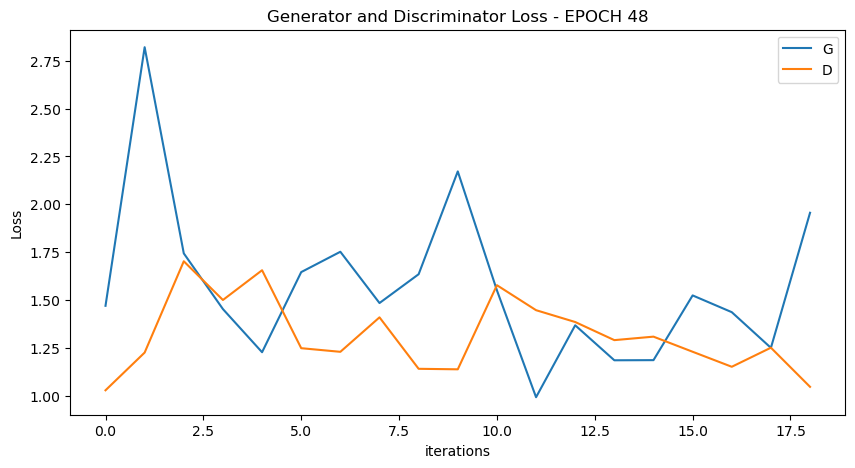

  0%|          | 0/19 [00:00<?, ?it/s]

[50/100][9/19] Loss_D: 1.1778 Loss_G: 1.4288 D(x): 0.4811 D(G(z)): 0.3312 / 0.2189
[50/100][18/19] Loss_D: 1.0239 Loss_G: 1.7664 D(x): 0.5973 D(G(z)): 0.3455 / 0.1607


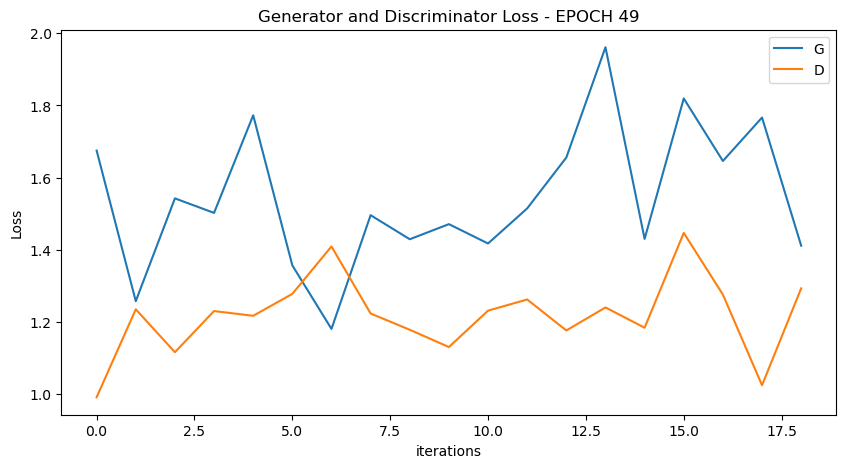

  0%|          | 0/19 [00:00<?, ?it/s]

[51/100][9/19] Loss_D: 1.3079 Loss_G: 1.7652 D(x): 0.3691 D(G(z)): 0.2250 / 0.1564
[51/100][18/19] Loss_D: 1.0464 Loss_G: 2.6331 D(x): 0.7365 D(G(z)): 0.4580 / 0.0623


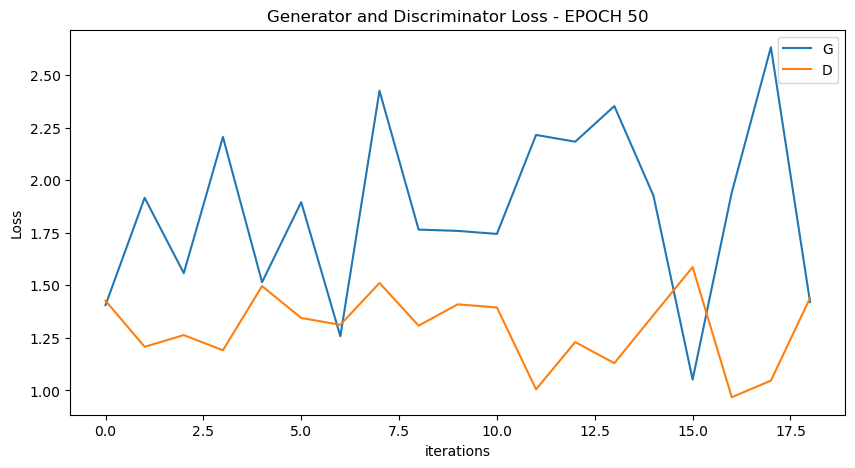

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


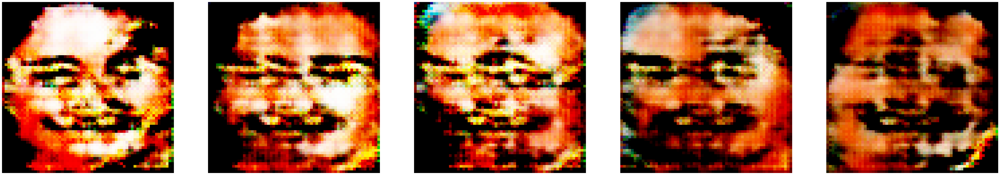

  0%|          | 0/19 [00:00<?, ?it/s]

[52/100][9/19] Loss_D: 1.1917 Loss_G: 1.6904 D(x): 0.4441 D(G(z)): 0.2863 / 0.1725
[52/100][18/19] Loss_D: 1.2694 Loss_G: 1.3515 D(x): 0.5482 D(G(z)): 0.4330 / 0.2458


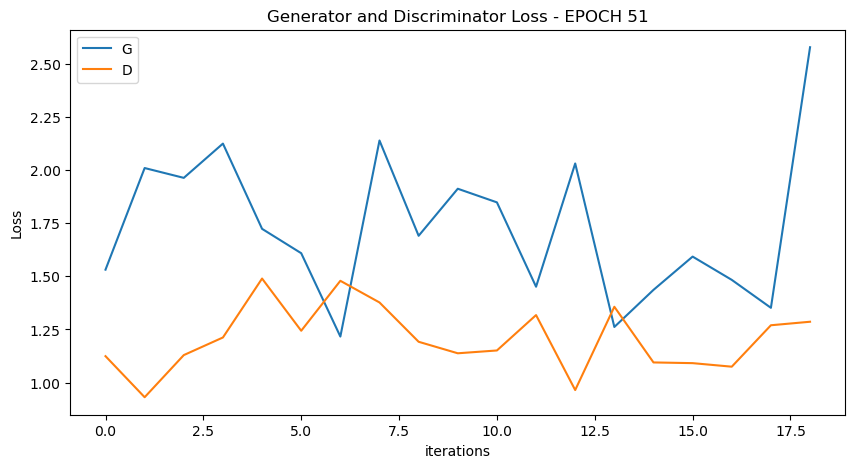

  0%|          | 0/19 [00:00<?, ?it/s]

[53/100][9/19] Loss_D: 1.2476 Loss_G: 2.0161 D(x): 0.5883 D(G(z)): 0.4464 / 0.1268
[53/100][18/19] Loss_D: 1.4814 Loss_G: 2.2291 D(x): 0.5769 D(G(z)): 0.4946 / 0.0979


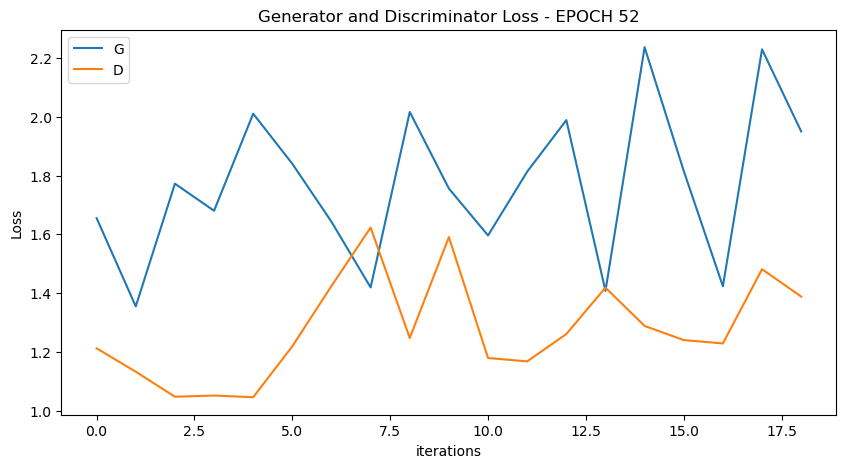

  0%|          | 0/19 [00:00<?, ?it/s]

[54/100][9/19] Loss_D: 1.3314 Loss_G: 1.6514 D(x): 0.4504 D(G(z)): 0.3748 / 0.1820
[54/100][18/19] Loss_D: 1.5618 Loss_G: 1.2060 D(x): 0.3557 D(G(z)): 0.3573 / 0.3000


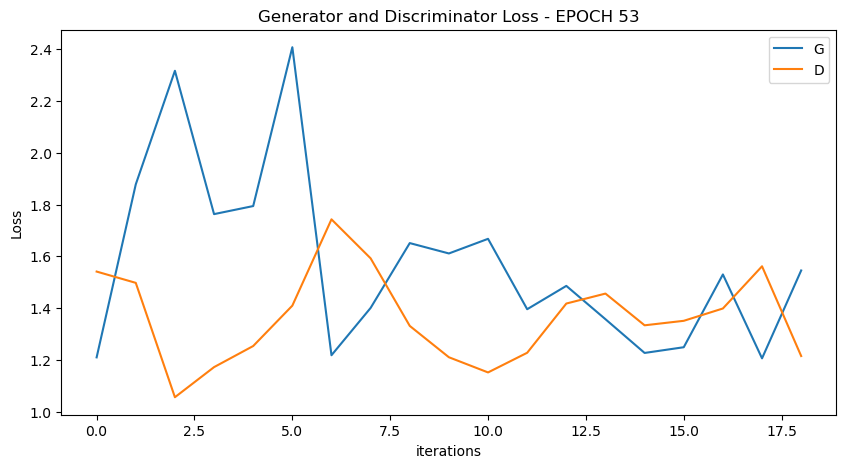

  0%|          | 0/19 [00:00<?, ?it/s]

[55/100][9/19] Loss_D: 1.1889 Loss_G: 1.6370 D(x): 0.6255 D(G(z)): 0.4568 / 0.1905
[55/100][18/19] Loss_D: 1.3359 Loss_G: 1.5717 D(x): 0.6193 D(G(z)): 0.4942 / 0.2299


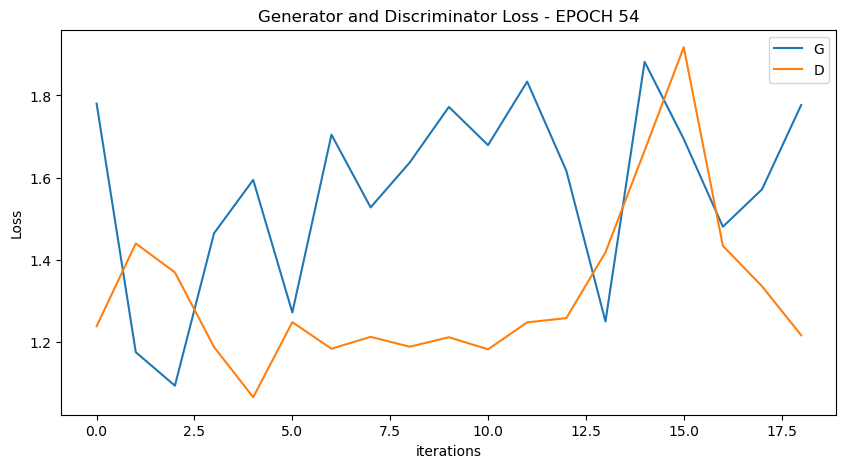

  0%|          | 0/19 [00:00<?, ?it/s]

[56/100][9/19] Loss_D: 1.4413 Loss_G: 1.4093 D(x): 0.4172 D(G(z)): 0.3933 / 0.2333
[56/100][18/19] Loss_D: 1.4917 Loss_G: 1.5076 D(x): 0.4448 D(G(z)): 0.4711 / 0.2064


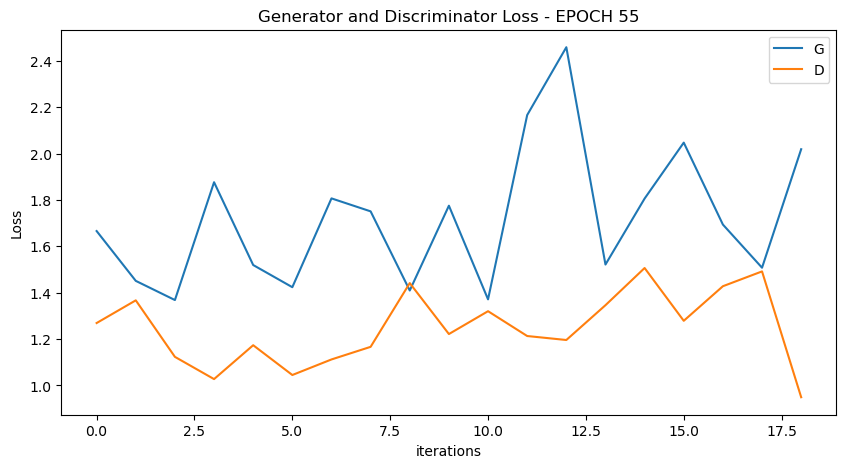

  0%|          | 0/19 [00:00<?, ?it/s]

[57/100][9/19] Loss_D: 1.1465 Loss_G: 1.6416 D(x): 0.5491 D(G(z)): 0.3694 / 0.1794
[57/100][18/19] Loss_D: 1.1971 Loss_G: 1.4656 D(x): 0.4460 D(G(z)): 0.2908 / 0.2257


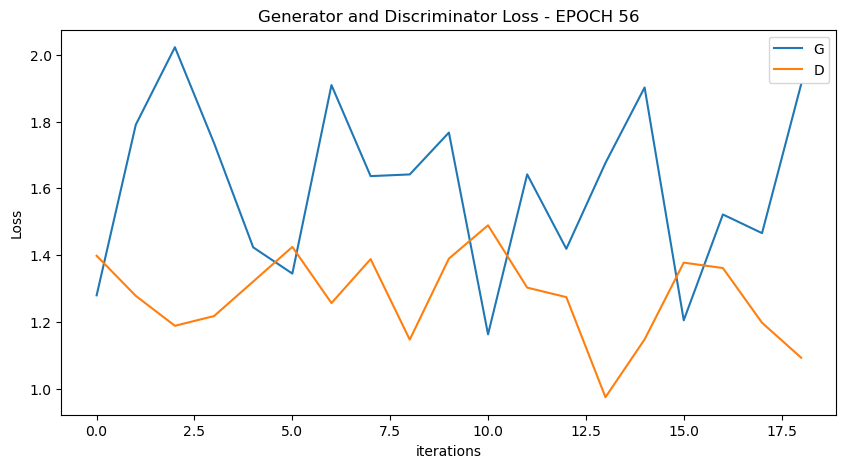

  0%|          | 0/19 [00:00<?, ?it/s]

[58/100][9/19] Loss_D: 1.6783 Loss_G: 1.3751 D(x): 0.3179 D(G(z)): 0.3956 / 0.2477
[58/100][18/19] Loss_D: 1.2265 Loss_G: 1.3912 D(x): 0.5745 D(G(z)): 0.4398 / 0.2439


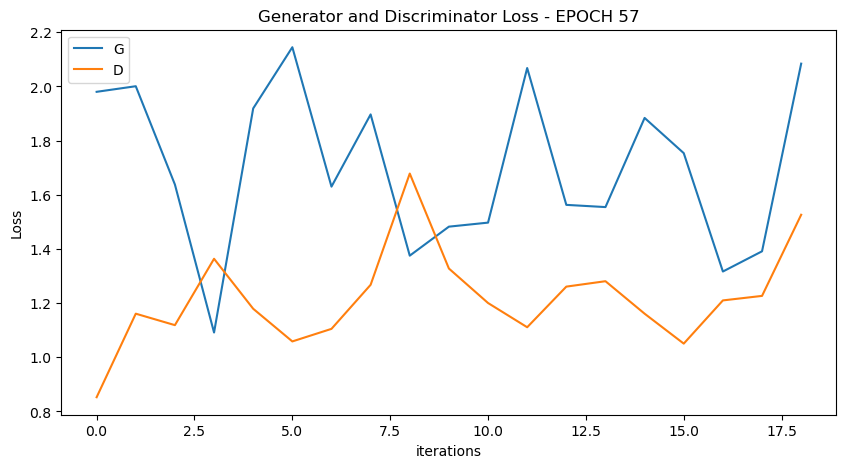

  0%|          | 0/19 [00:00<?, ?it/s]

[59/100][9/19] Loss_D: 1.3469 Loss_G: 1.5283 D(x): 0.3834 D(G(z)): 0.2988 / 0.2039
[59/100][18/19] Loss_D: 1.4415 Loss_G: 1.5061 D(x): 0.4880 D(G(z)): 0.4632 / 0.2106


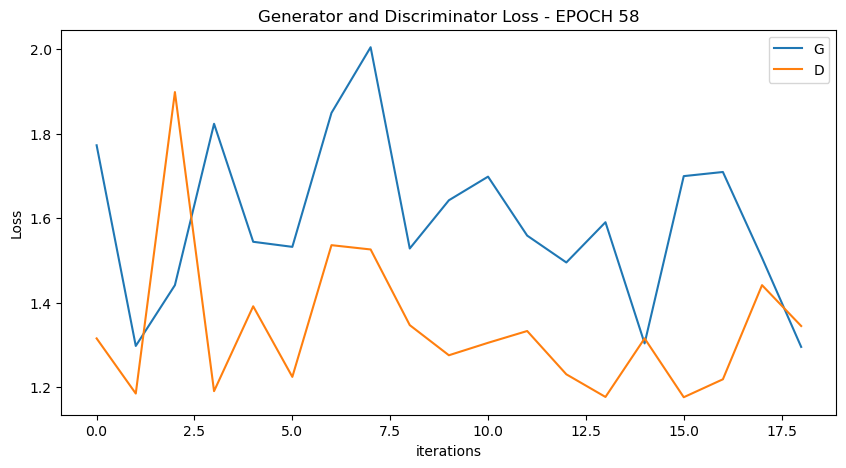

  0%|          | 0/19 [00:00<?, ?it/s]

[60/100][9/19] Loss_D: 1.1700 Loss_G: 1.6190 D(x): 0.5696 D(G(z)): 0.3871 / 0.1841
[60/100][18/19] Loss_D: 1.3162 Loss_G: 1.6168 D(x): 0.4686 D(G(z)): 0.3848 / 0.1886


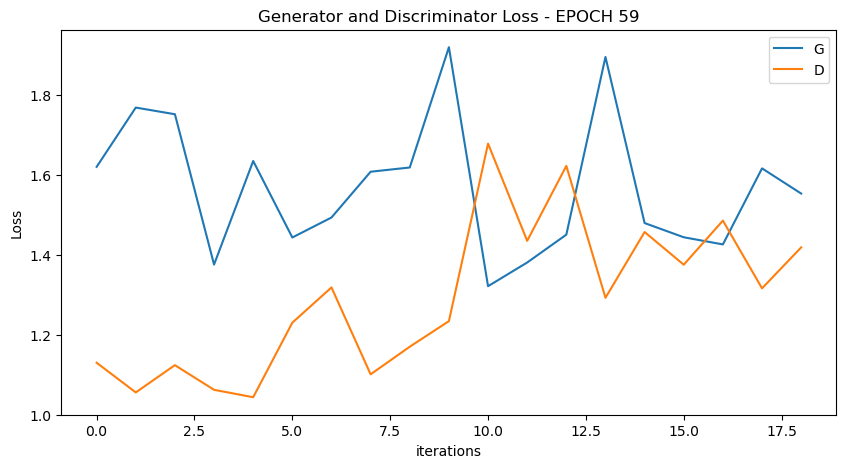

  0%|          | 0/19 [00:00<?, ?it/s]

[61/100][9/19] Loss_D: 1.1752 Loss_G: 1.7269 D(x): 0.5371 D(G(z)): 0.3657 / 0.1604
[61/100][18/19] Loss_D: 1.4218 Loss_G: 1.3823 D(x): 0.4082 D(G(z)): 0.3721 / 0.2387


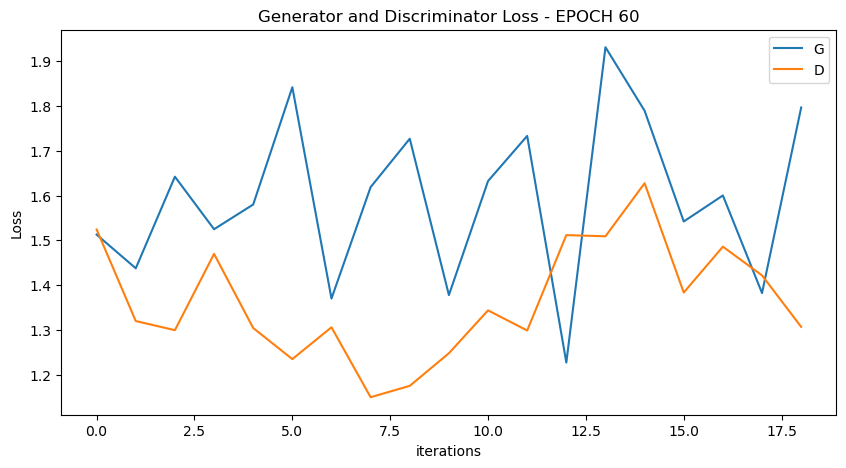

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


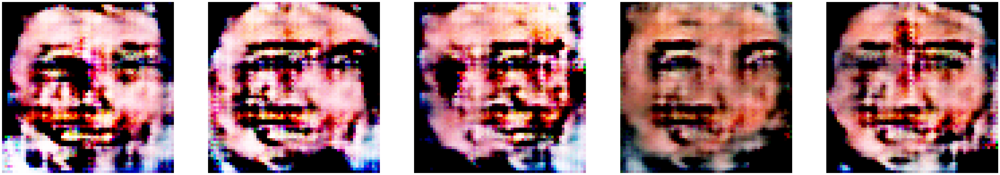

  0%|          | 0/19 [00:00<?, ?it/s]

[62/100][9/19] Loss_D: 1.5701 Loss_G: 1.2671 D(x): 0.3228 D(G(z)): 0.3540 / 0.2758
[62/100][18/19] Loss_D: 1.1241 Loss_G: 1.2743 D(x): 0.5136 D(G(z)): 0.3252 / 0.2701


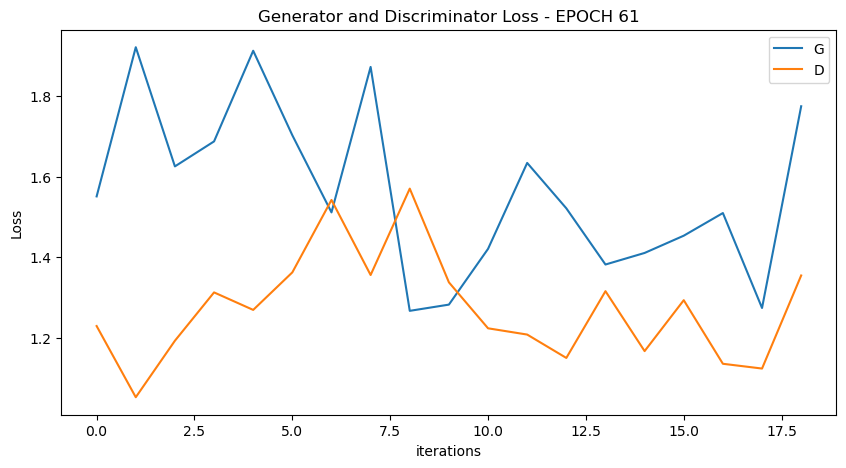

  0%|          | 0/19 [00:00<?, ?it/s]

[63/100][9/19] Loss_D: 1.3553 Loss_G: 1.3846 D(x): 0.5561 D(G(z)): 0.5021 / 0.2345
[63/100][18/19] Loss_D: 1.2083 Loss_G: 1.6905 D(x): 0.5365 D(G(z)): 0.4040 / 0.1723


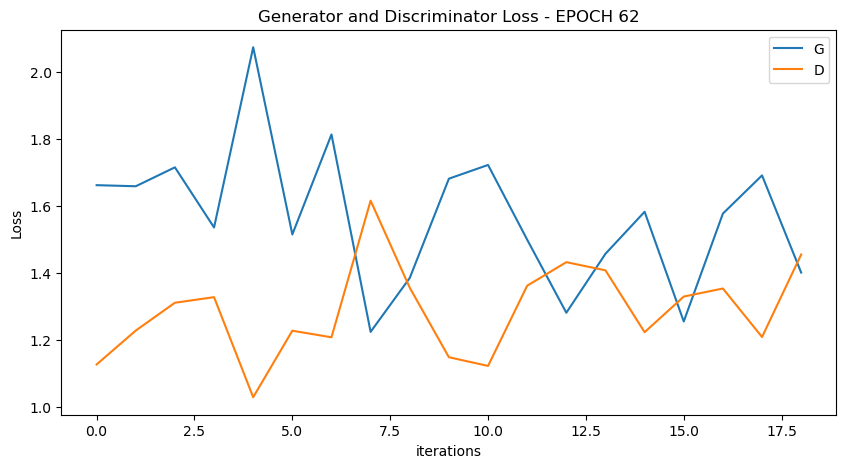

  0%|          | 0/19 [00:00<?, ?it/s]

[64/100][9/19] Loss_D: 1.4140 Loss_G: 1.4877 D(x): 0.4112 D(G(z)): 0.3821 / 0.2137
[64/100][18/19] Loss_D: 1.4489 Loss_G: 1.3694 D(x): 0.4355 D(G(z)): 0.4147 / 0.2448


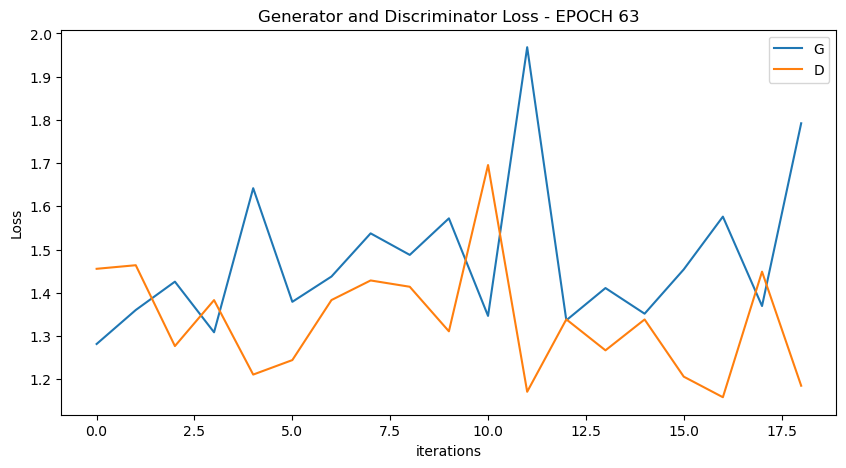

  0%|          | 0/19 [00:00<?, ?it/s]

[65/100][9/19] Loss_D: 1.2543 Loss_G: 1.6796 D(x): 0.4937 D(G(z)): 0.3820 / 0.1768
[65/100][18/19] Loss_D: 1.1300 Loss_G: 1.6375 D(x): 0.5631 D(G(z)): 0.3678 / 0.1858


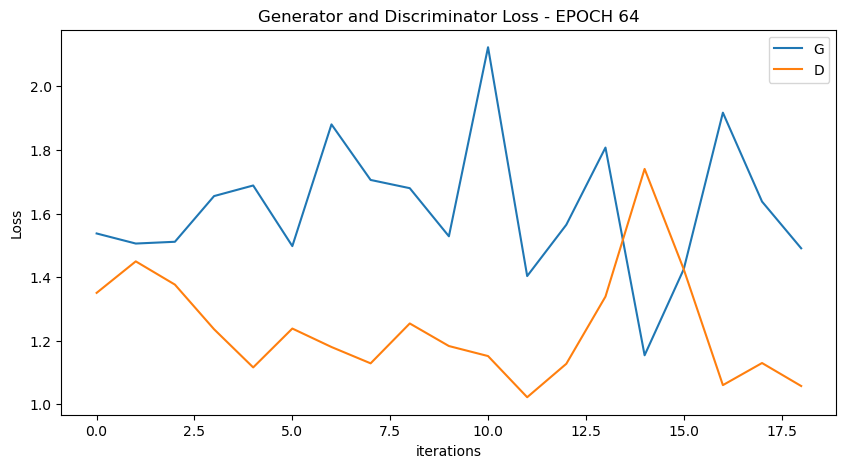

  0%|          | 0/19 [00:00<?, ?it/s]

[66/100][9/19] Loss_D: 1.3115 Loss_G: 1.1484 D(x): 0.4268 D(G(z)): 0.3388 / 0.3083
[66/100][18/19] Loss_D: 1.2098 Loss_G: 1.5591 D(x): 0.5349 D(G(z)): 0.3602 / 0.2119


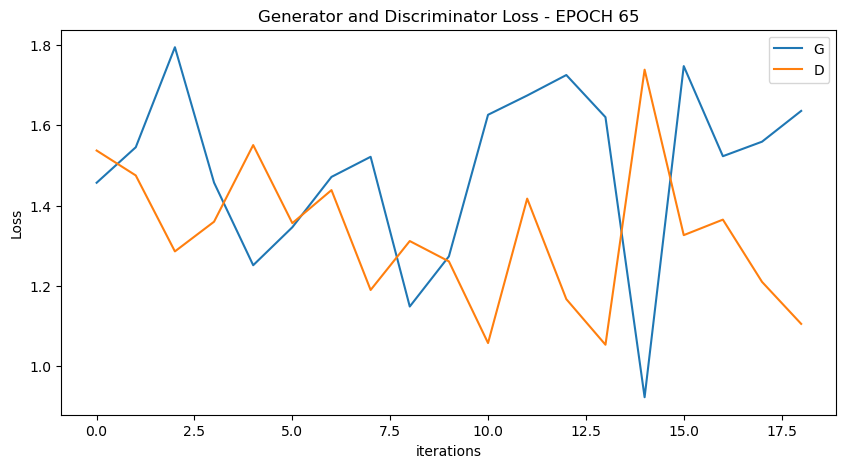

  0%|          | 0/19 [00:00<?, ?it/s]

[67/100][9/19] Loss_D: 1.3048 Loss_G: 1.6077 D(x): 0.4328 D(G(z)): 0.3449 / 0.1914
[67/100][18/19] Loss_D: 1.3391 Loss_G: 1.7627 D(x): 0.5876 D(G(z)): 0.4951 / 0.1643


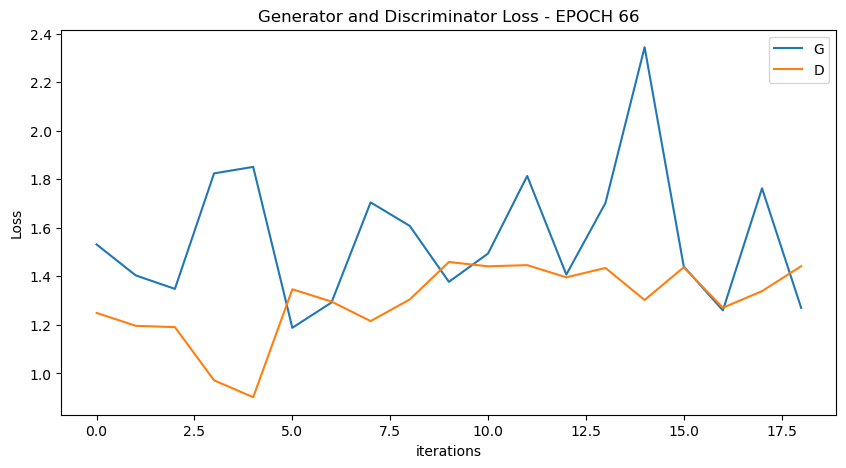

  0%|          | 0/19 [00:00<?, ?it/s]

[68/100][9/19] Loss_D: 1.2675 Loss_G: 1.4175 D(x): 0.4290 D(G(z)): 0.3255 / 0.2361
[68/100][18/19] Loss_D: 1.6724 Loss_G: 1.1935 D(x): 0.4327 D(G(z)): 0.5228 / 0.3038


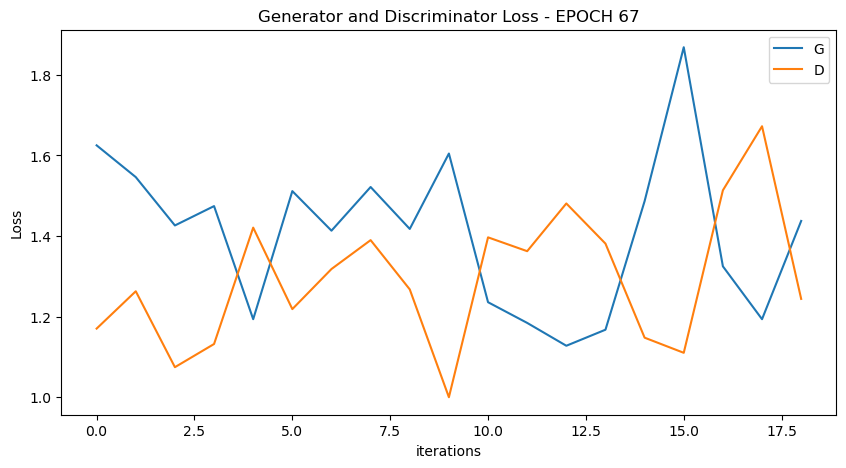

  0%|          | 0/19 [00:00<?, ?it/s]

[69/100][9/19] Loss_D: 1.2181 Loss_G: 1.3229 D(x): 0.4872 D(G(z)): 0.3582 / 0.2544
[69/100][18/19] Loss_D: 1.3742 Loss_G: 1.2372 D(x): 0.5104 D(G(z)): 0.4613 / 0.2837


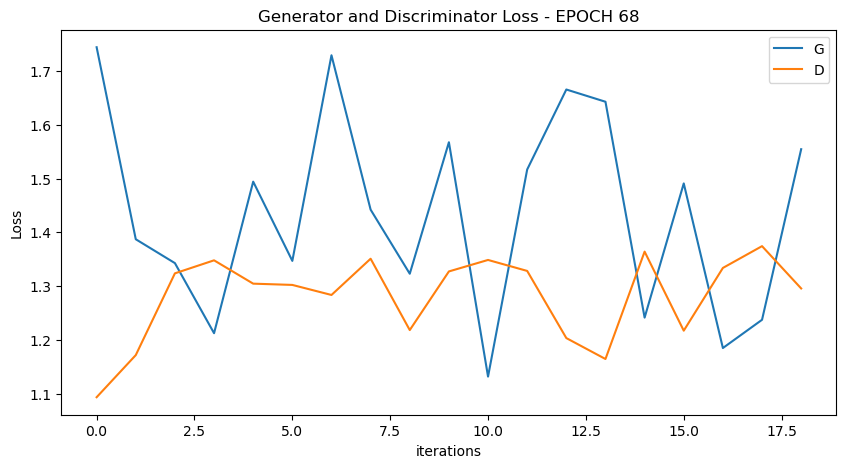

  0%|          | 0/19 [00:00<?, ?it/s]

[70/100][9/19] Loss_D: 1.2986 Loss_G: 1.7995 D(x): 0.4361 D(G(z)): 0.3445 / 0.1523
[70/100][18/19] Loss_D: 1.4398 Loss_G: 1.0179 D(x): 0.4363 D(G(z)): 0.4160 / 0.3474


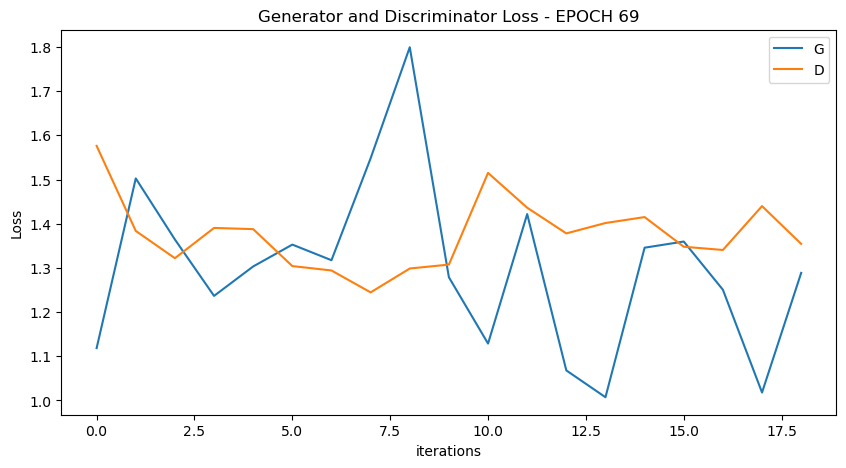

  0%|          | 0/19 [00:00<?, ?it/s]

[71/100][9/19] Loss_D: 1.2182 Loss_G: 1.3458 D(x): 0.5038 D(G(z)): 0.3400 / 0.2479
[71/100][18/19] Loss_D: 1.1667 Loss_G: 1.7676 D(x): 0.6246 D(G(z)): 0.4459 / 0.1541


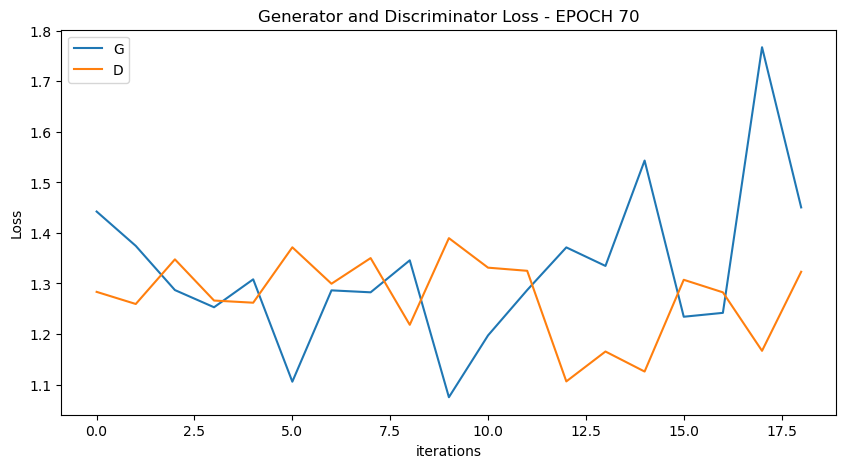

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


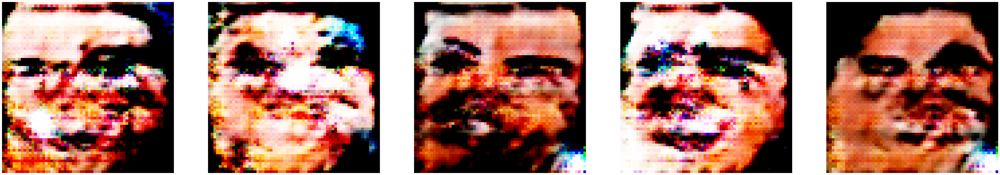

  0%|          | 0/19 [00:00<?, ?it/s]

[72/100][9/19] Loss_D: 1.4918 Loss_G: 1.6868 D(x): 0.4586 D(G(z)): 0.4693 / 0.1823
[72/100][18/19] Loss_D: 1.2809 Loss_G: 1.5421 D(x): 0.4968 D(G(z)): 0.3985 / 0.2161


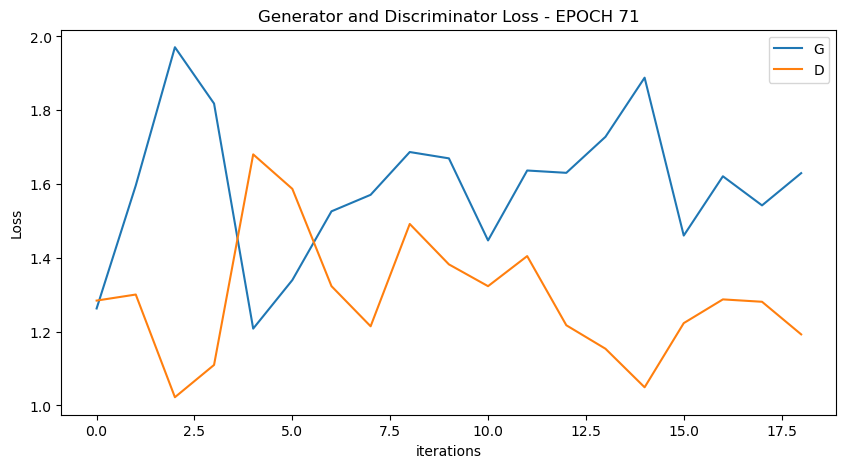

  0%|          | 0/19 [00:00<?, ?it/s]

[73/100][9/19] Loss_D: 1.2652 Loss_G: 1.3549 D(x): 0.4747 D(G(z)): 0.3787 / 0.2451
[73/100][18/19] Loss_D: 1.1885 Loss_G: 1.7298 D(x): 0.5233 D(G(z)): 0.3841 / 0.1615


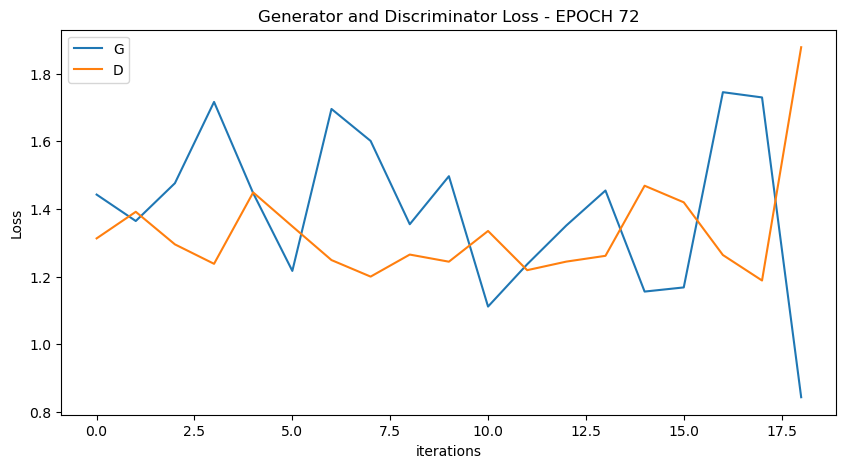

  0%|          | 0/19 [00:00<?, ?it/s]

[74/100][9/19] Loss_D: 1.3261 Loss_G: 1.1403 D(x): 0.5318 D(G(z)): 0.4626 / 0.3075
[74/100][18/19] Loss_D: 1.2818 Loss_G: 1.2708 D(x): 0.5146 D(G(z)): 0.4287 / 0.2705


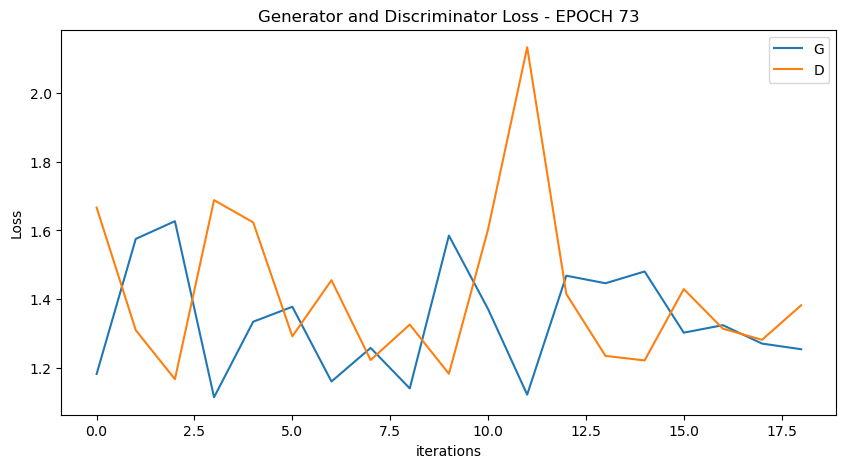

  0%|          | 0/19 [00:00<?, ?it/s]

[75/100][9/19] Loss_D: 1.1559 Loss_G: 1.4149 D(x): 0.5418 D(G(z)): 0.3902 / 0.2255
[75/100][18/19] Loss_D: 1.3158 Loss_G: 1.3995 D(x): 0.4782 D(G(z)): 0.3904 / 0.2324


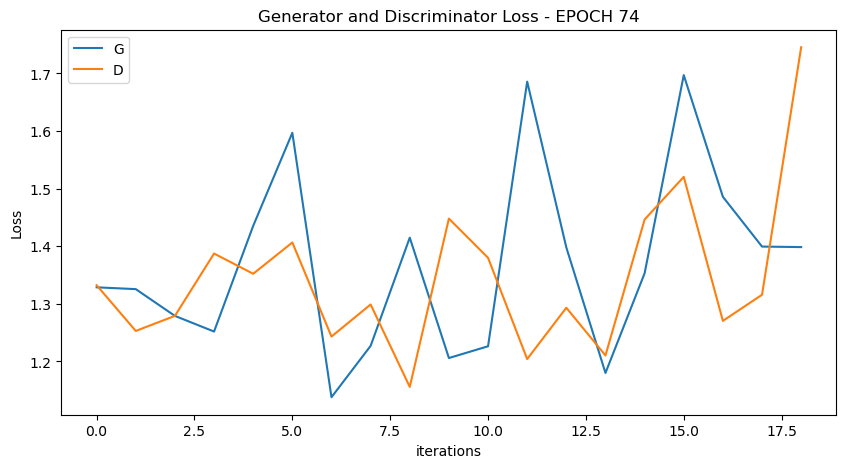

  0%|          | 0/19 [00:00<?, ?it/s]

[76/100][9/19] Loss_D: 1.4713 Loss_G: 1.3163 D(x): 0.4003 D(G(z)): 0.3893 / 0.2490
[76/100][18/19] Loss_D: 1.3062 Loss_G: 1.4048 D(x): 0.4534 D(G(z)): 0.3079 / 0.2292


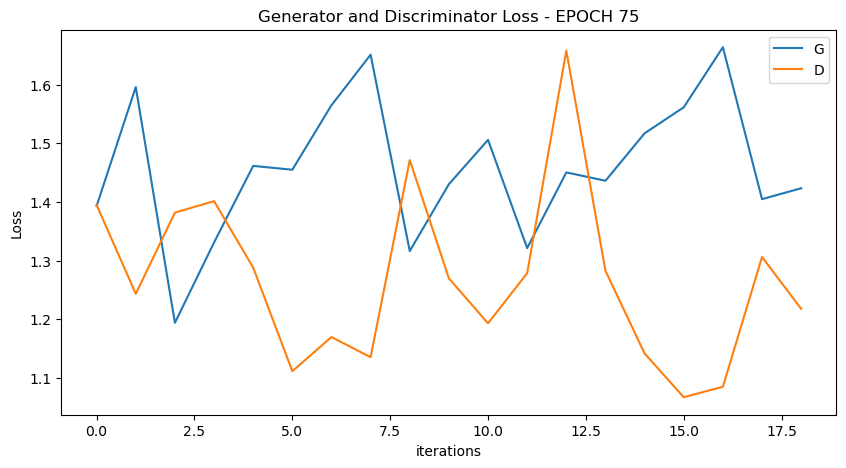

  0%|          | 0/19 [00:00<?, ?it/s]

[77/100][9/19] Loss_D: 1.1815 Loss_G: 1.6866 D(x): 0.5878 D(G(z)): 0.4162 / 0.1787
[77/100][18/19] Loss_D: 1.4648 Loss_G: 1.2801 D(x): 0.5061 D(G(z)): 0.5164 / 0.2726


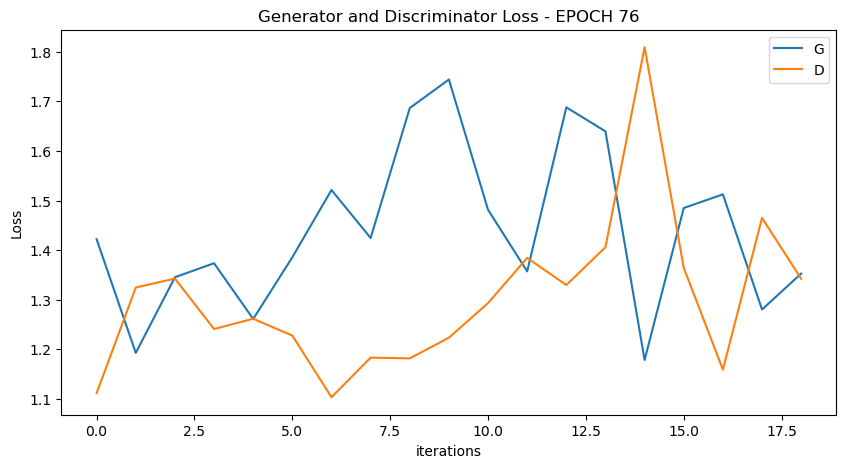

  0%|          | 0/19 [00:00<?, ?it/s]

[78/100][9/19] Loss_D: 1.1440 Loss_G: 1.4609 D(x): 0.5626 D(G(z)): 0.3959 / 0.2152
[78/100][18/19] Loss_D: 1.4189 Loss_G: 1.5712 D(x): 0.4625 D(G(z)): 0.4327 / 0.1969


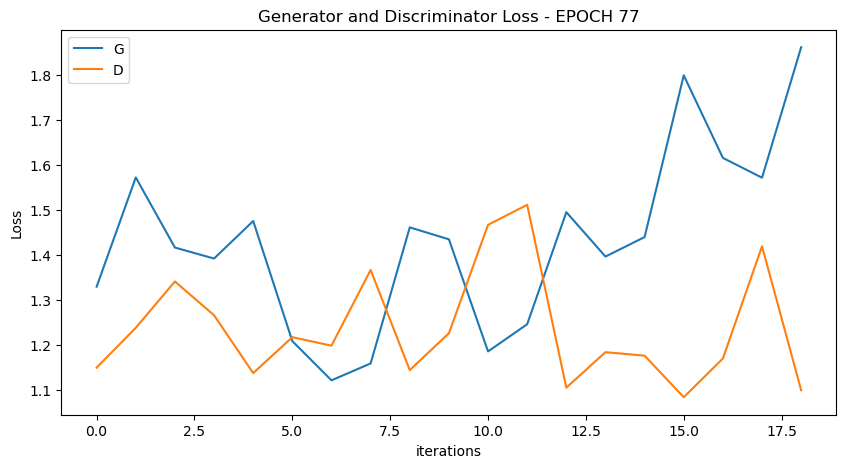

  0%|          | 0/19 [00:00<?, ?it/s]

[79/100][9/19] Loss_D: 1.4516 Loss_G: 1.1271 D(x): 0.4267 D(G(z)): 0.4371 / 0.3142
[79/100][18/19] Loss_D: 1.0387 Loss_G: 1.6398 D(x): 0.5969 D(G(z)): 0.3477 / 0.1758


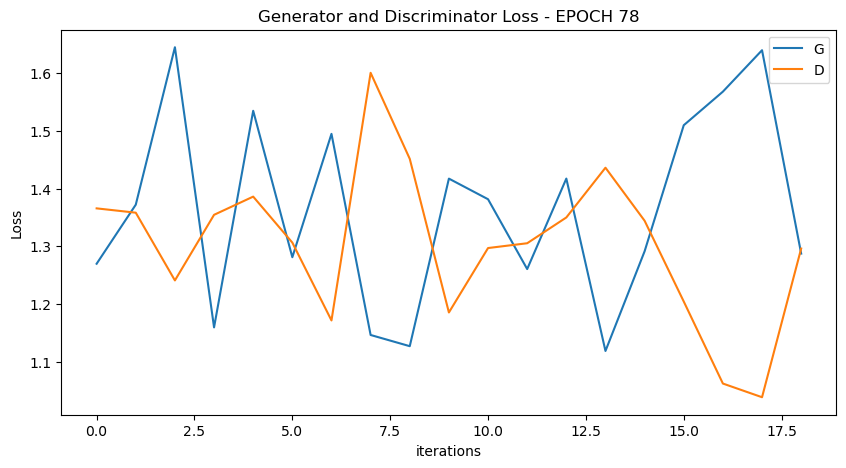

  0%|          | 0/19 [00:00<?, ?it/s]

[80/100][9/19] Loss_D: 1.2084 Loss_G: 1.3217 D(x): 0.5629 D(G(z)): 0.3875 / 0.2546
[80/100][18/19] Loss_D: 1.4019 Loss_G: 1.2428 D(x): 0.4826 D(G(z)): 0.4614 / 0.2792


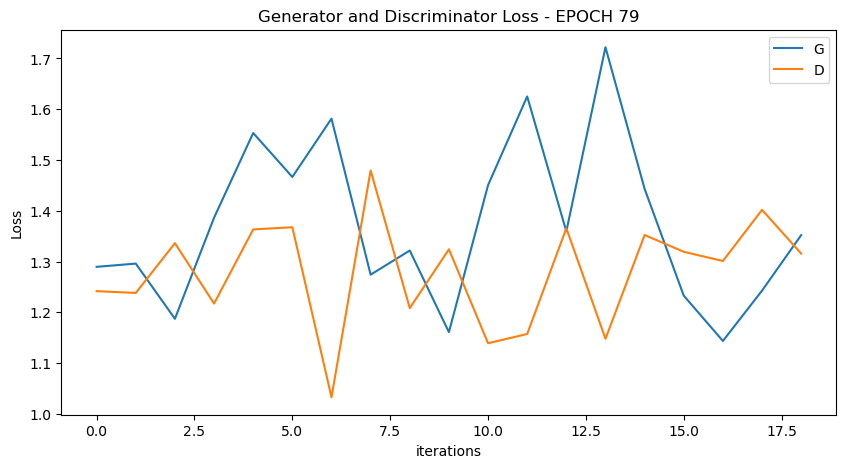

  0%|          | 0/19 [00:00<?, ?it/s]

[81/100][9/19] Loss_D: 1.2843 Loss_G: 1.3534 D(x): 0.4368 D(G(z)): 0.3331 / 0.2469
[81/100][18/19] Loss_D: 1.4422 Loss_G: 1.6591 D(x): 0.5093 D(G(z)): 0.5062 / 0.1725


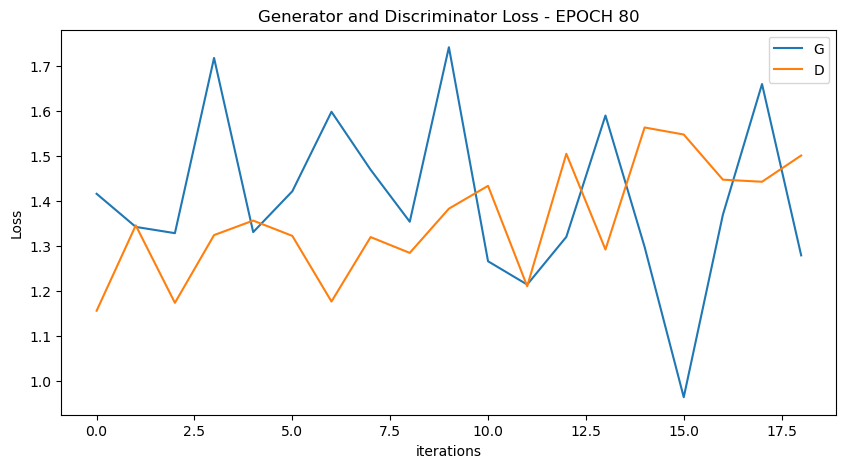

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


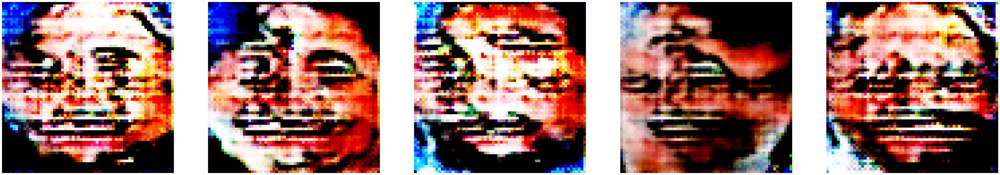

  0%|          | 0/19 [00:00<?, ?it/s]

[82/100][9/19] Loss_D: 1.2606 Loss_G: 1.0365 D(x): 0.4585 D(G(z)): 0.3537 / 0.3639
[82/100][18/19] Loss_D: 1.4381 Loss_G: 1.4078 D(x): 0.4598 D(G(z)): 0.4556 / 0.2330


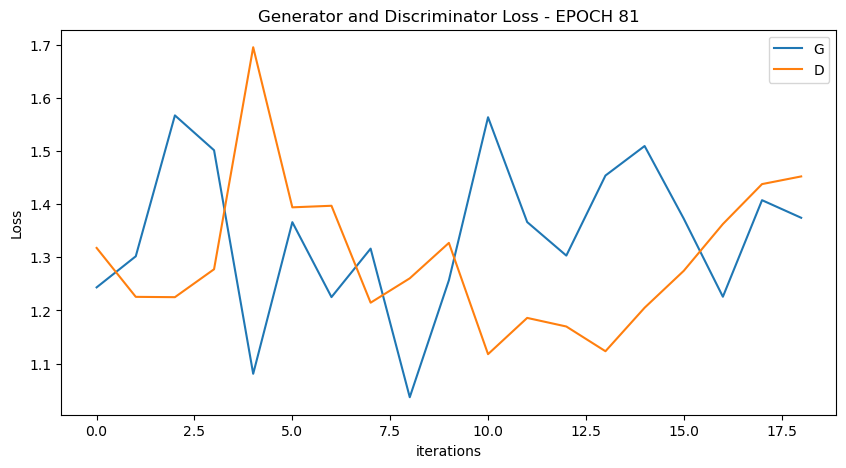

  0%|          | 0/19 [00:00<?, ?it/s]

[83/100][9/19] Loss_D: 1.1564 Loss_G: 1.5150 D(x): 0.5495 D(G(z)): 0.3789 / 0.2040
[83/100][18/19] Loss_D: 1.4301 Loss_G: 1.4216 D(x): 0.4741 D(G(z)): 0.4729 / 0.2339


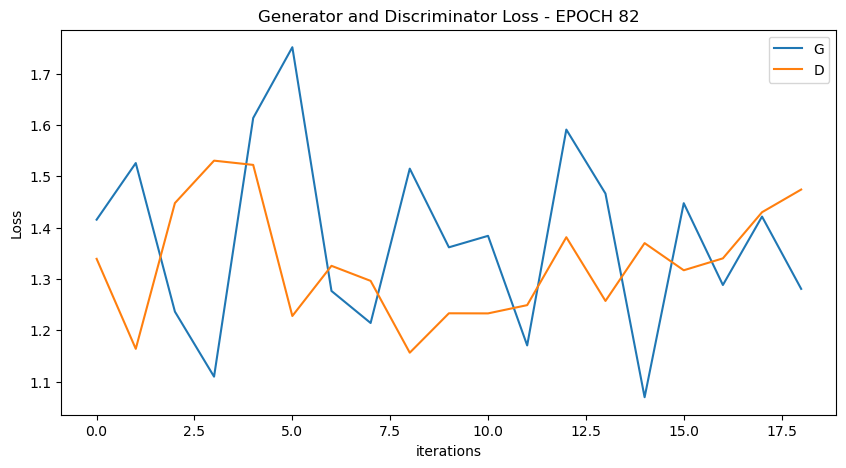

  0%|          | 0/19 [00:00<?, ?it/s]

[84/100][9/19] Loss_D: 1.4295 Loss_G: 1.4404 D(x): 0.5465 D(G(z)): 0.4934 / 0.2581
[84/100][18/19] Loss_D: 1.4065 Loss_G: 1.1254 D(x): 0.4311 D(G(z)): 0.3962 / 0.3136


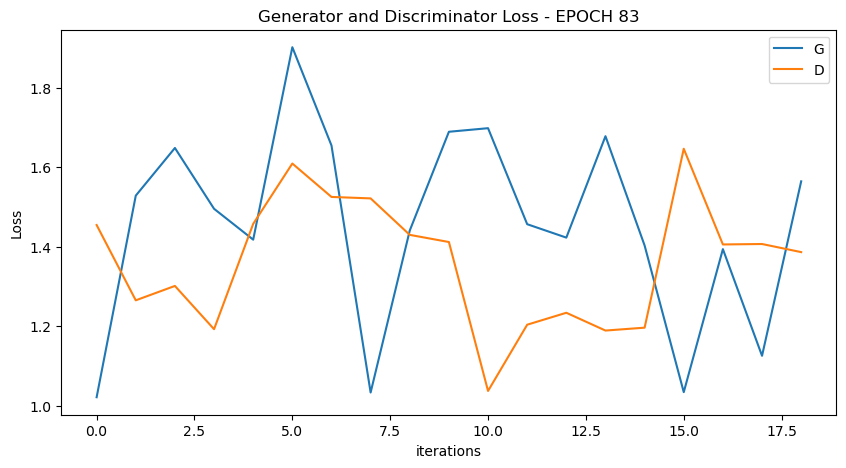

  0%|          | 0/19 [00:00<?, ?it/s]

[85/100][9/19] Loss_D: 1.2241 Loss_G: 1.6231 D(x): 0.4892 D(G(z)): 0.3652 / 0.1813
[85/100][18/19] Loss_D: 1.0868 Loss_G: 1.3676 D(x): 0.5155 D(G(z)): 0.2969 / 0.2433


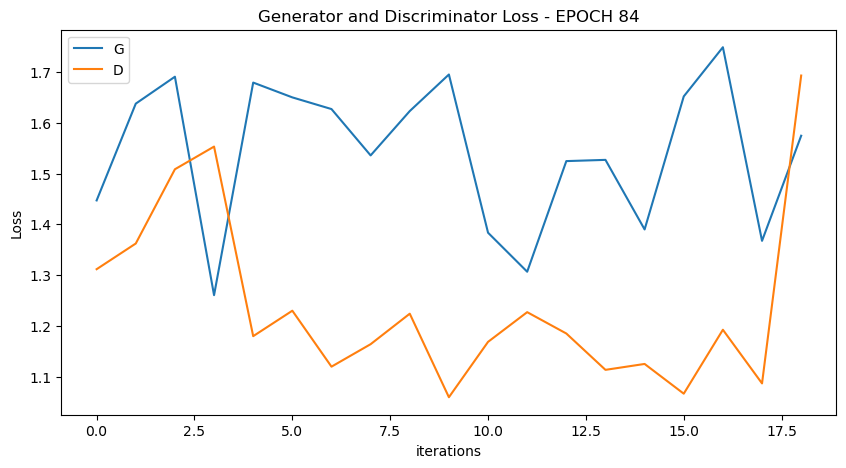

  0%|          | 0/19 [00:00<?, ?it/s]

[86/100][9/19] Loss_D: 1.1560 Loss_G: 1.4502 D(x): 0.4526 D(G(z)): 0.2747 / 0.2196
[86/100][18/19] Loss_D: 1.1708 Loss_G: 1.7278 D(x): 0.4868 D(G(z)): 0.3439 / 0.1608


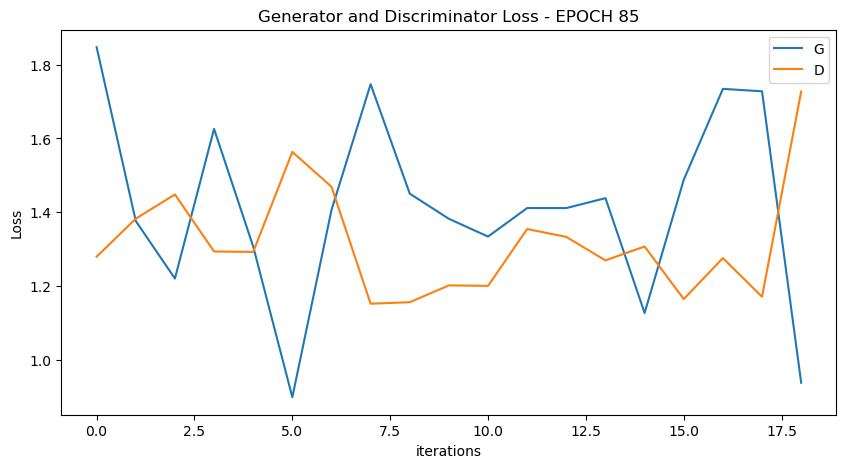

  0%|          | 0/19 [00:00<?, ?it/s]

[87/100][9/19] Loss_D: 1.2763 Loss_G: 1.5349 D(x): 0.6519 D(G(z)): 0.5208 / 0.1999
[87/100][18/19] Loss_D: 1.2126 Loss_G: 1.4724 D(x): 0.5359 D(G(z)): 0.3901 / 0.2102


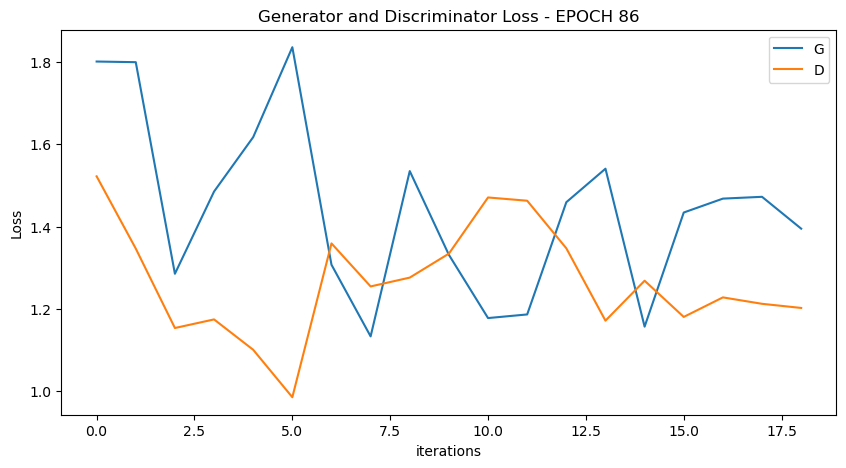

  0%|          | 0/19 [00:00<?, ?it/s]

[88/100][9/19] Loss_D: 1.2782 Loss_G: 1.3139 D(x): 0.5433 D(G(z)): 0.4451 / 0.2513
[88/100][18/19] Loss_D: 1.3057 Loss_G: 1.4345 D(x): 0.4756 D(G(z)): 0.3843 / 0.2399


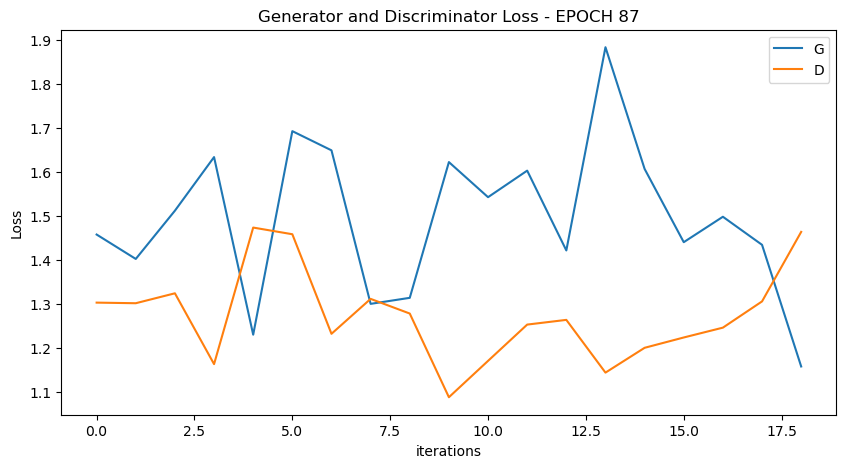

  0%|          | 0/19 [00:00<?, ?it/s]

[89/100][9/19] Loss_D: 1.3847 Loss_G: 1.3957 D(x): 0.3868 D(G(z)): 0.3185 / 0.2310
[89/100][18/19] Loss_D: 1.2261 Loss_G: 1.4842 D(x): 0.5292 D(G(z)): 0.4127 / 0.2042


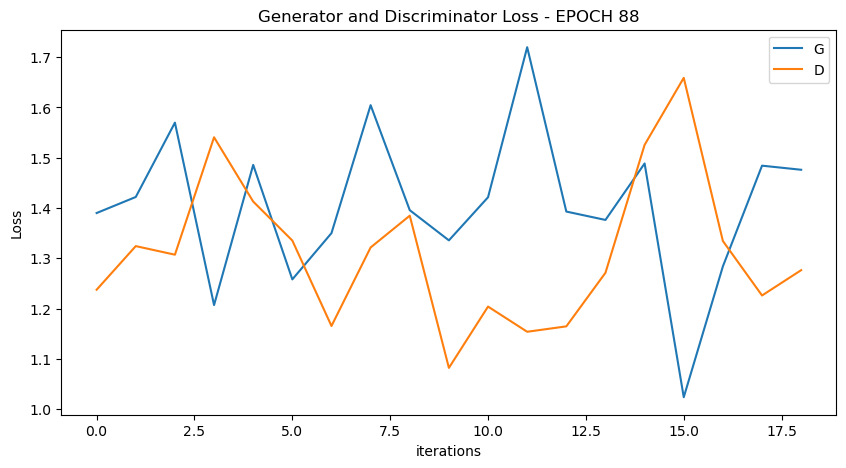

  0%|          | 0/19 [00:00<?, ?it/s]

[90/100][9/19] Loss_D: 1.2878 Loss_G: 1.3856 D(x): 0.4361 D(G(z)): 0.3427 / 0.2423
[90/100][18/19] Loss_D: 1.0333 Loss_G: 1.5925 D(x): 0.6178 D(G(z)): 0.3692 / 0.1917


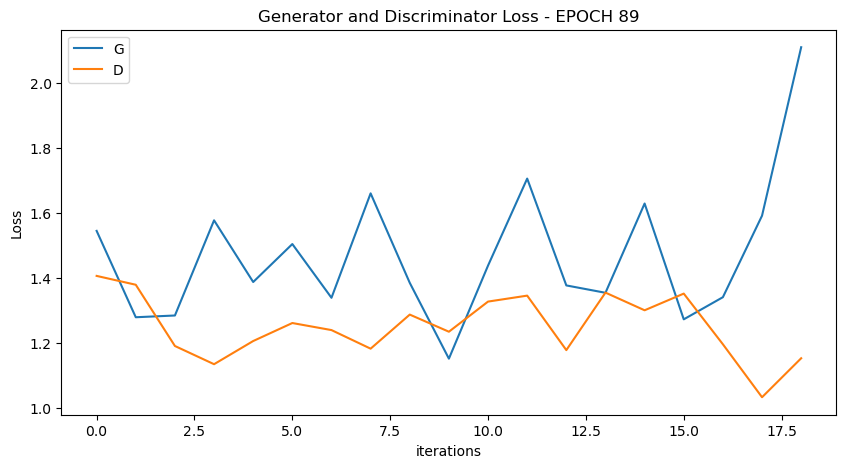

  0%|          | 0/19 [00:00<?, ?it/s]

[91/100][9/19] Loss_D: 1.3155 Loss_G: 1.2706 D(x): 0.4632 D(G(z)): 0.3770 / 0.2795
[91/100][18/19] Loss_D: 1.0803 Loss_G: 1.4257 D(x): 0.5416 D(G(z)): 0.3240 / 0.2300


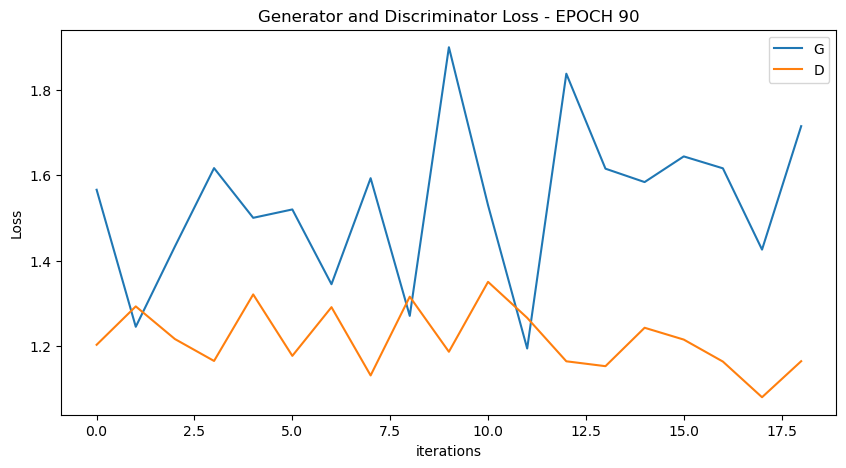

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


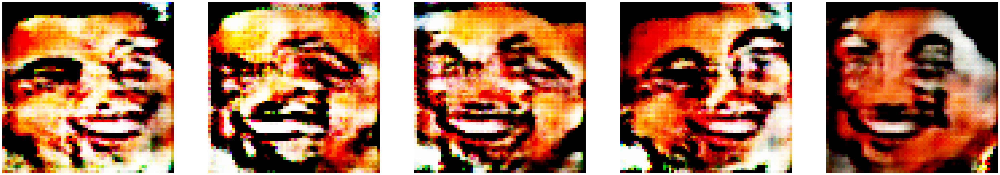

  0%|          | 0/19 [00:00<?, ?it/s]

[92/100][9/19] Loss_D: 1.3075 Loss_G: 1.8463 D(x): 0.6926 D(G(z)): 0.5471 / 0.1457
[92/100][18/19] Loss_D: 1.3366 Loss_G: 1.3303 D(x): 0.4566 D(G(z)): 0.3872 / 0.2573


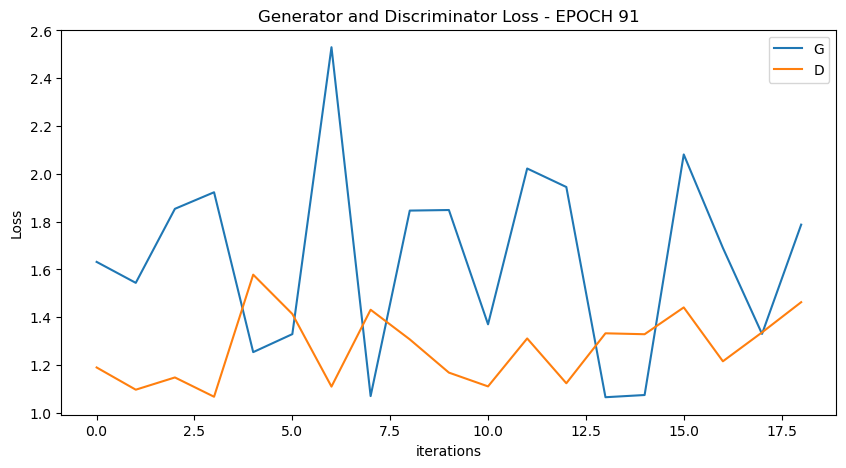

  0%|          | 0/19 [00:00<?, ?it/s]

[93/100][9/19] Loss_D: 1.0541 Loss_G: 1.7391 D(x): 0.5313 D(G(z)): 0.3002 / 0.1694
[93/100][18/19] Loss_D: 1.1364 Loss_G: 1.7142 D(x): 0.6398 D(G(z)): 0.4381 / 0.1680


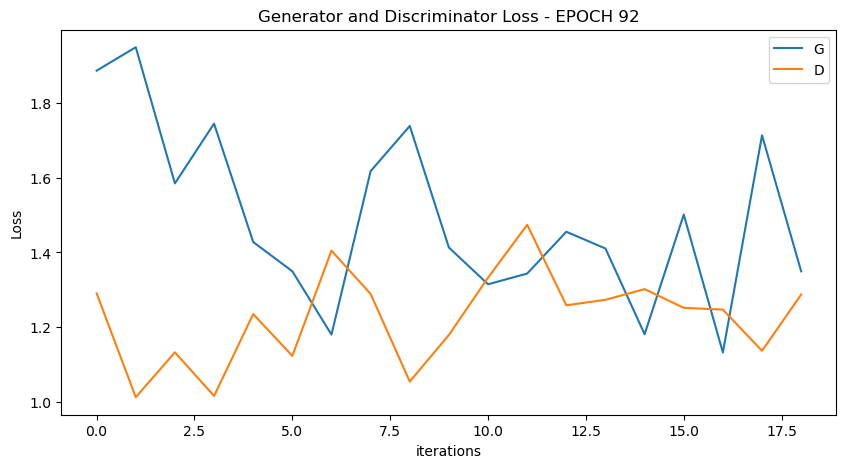

  0%|          | 0/19 [00:00<?, ?it/s]

[94/100][9/19] Loss_D: 1.2673 Loss_G: 1.6773 D(x): 0.5292 D(G(z)): 0.4231 / 0.1775
[94/100][18/19] Loss_D: 1.1482 Loss_G: 2.0208 D(x): 0.5811 D(G(z)): 0.3581 / 0.1188


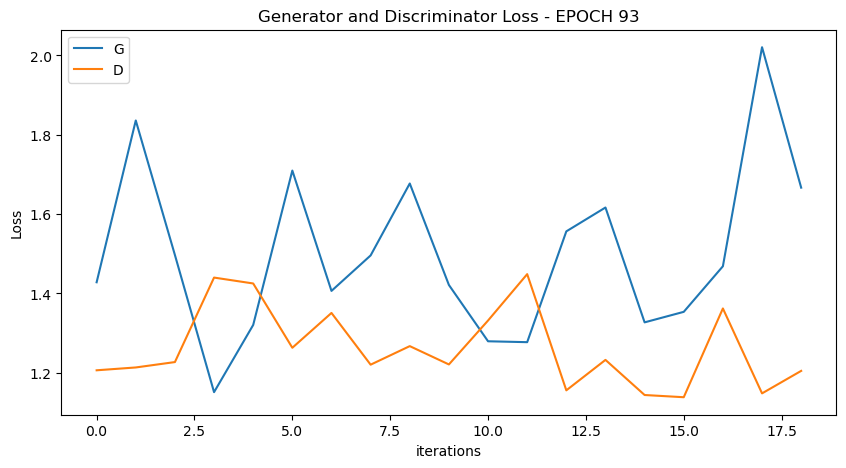

  0%|          | 0/19 [00:00<?, ?it/s]

[95/100][9/19] Loss_D: 1.0622 Loss_G: 1.8313 D(x): 0.6307 D(G(z)): 0.3940 / 0.1461
[95/100][18/19] Loss_D: 1.1738 Loss_G: 1.4266 D(x): 0.4692 D(G(z)): 0.2877 / 0.2389


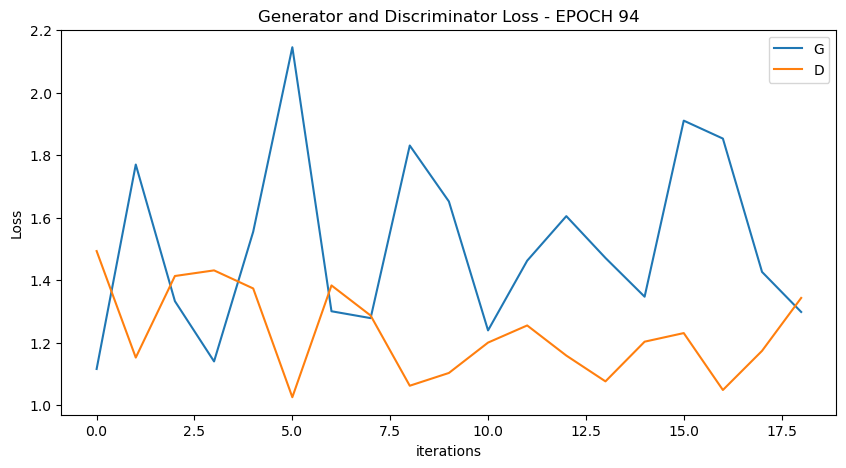

  0%|          | 0/19 [00:00<?, ?it/s]

[96/100][9/19] Loss_D: 1.1214 Loss_G: 2.0489 D(x): 0.5602 D(G(z)): 0.3712 / 0.1180
[96/100][18/19] Loss_D: 1.2093 Loss_G: 1.6664 D(x): 0.5537 D(G(z)): 0.3810 / 0.1907


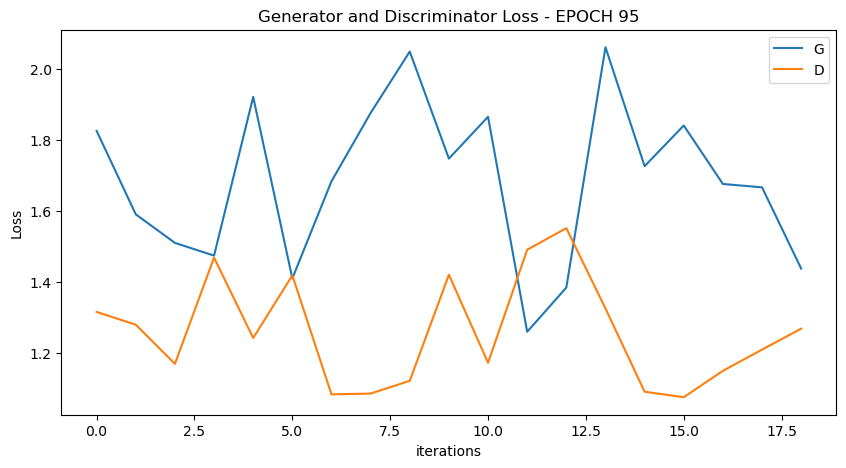

  0%|          | 0/19 [00:00<?, ?it/s]

[97/100][9/19] Loss_D: 1.1985 Loss_G: 1.5251 D(x): 0.5259 D(G(z)): 0.3894 / 0.1999
[97/100][18/19] Loss_D: 1.3186 Loss_G: 1.8417 D(x): 0.5577 D(G(z)): 0.4387 / 0.1546


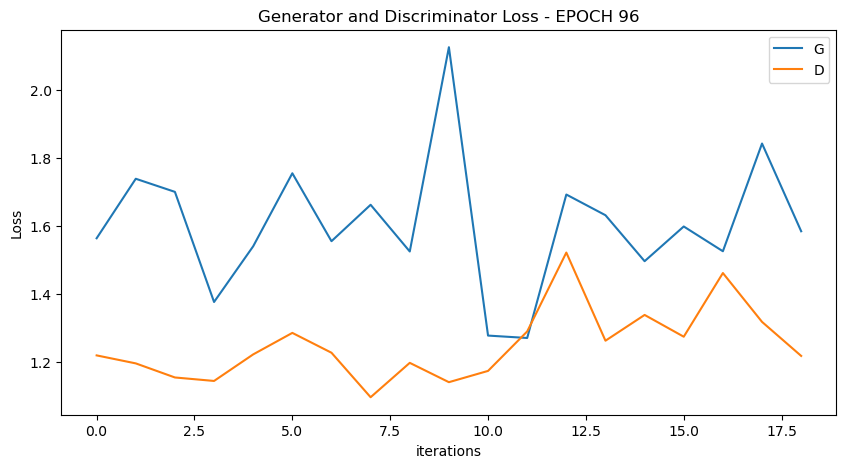

  0%|          | 0/19 [00:00<?, ?it/s]

[98/100][9/19] Loss_D: 1.2154 Loss_G: 1.7434 D(x): 0.5655 D(G(z)): 0.4312 / 0.1676
[98/100][18/19] Loss_D: 1.2805 Loss_G: 1.3364 D(x): 0.5086 D(G(z)): 0.4048 / 0.2514


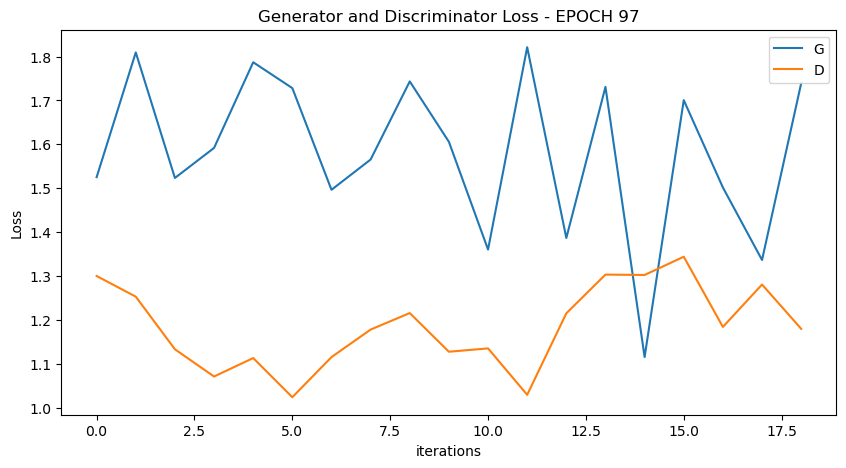

  0%|          | 0/19 [00:00<?, ?it/s]

[99/100][9/19] Loss_D: 1.2656 Loss_G: 1.6677 D(x): 0.5316 D(G(z)): 0.4258 / 0.1716
[99/100][18/19] Loss_D: 1.3791 Loss_G: 1.5678 D(x): 0.3726 D(G(z)): 0.3029 / 0.1922


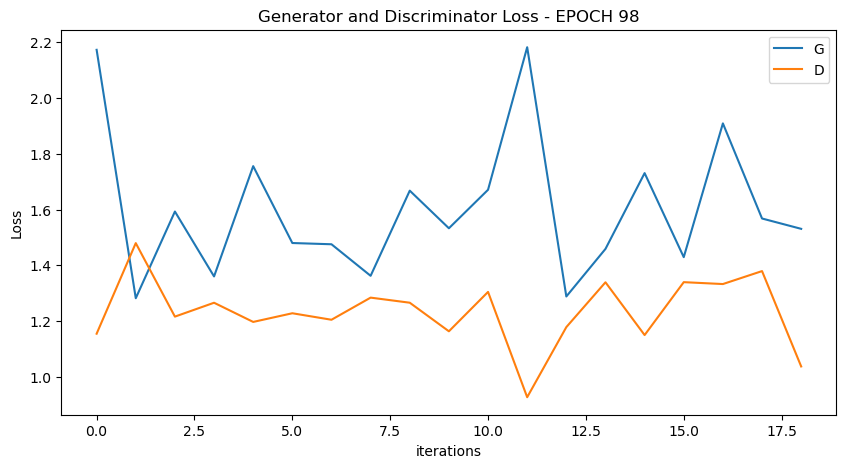

  0%|          | 0/19 [00:00<?, ?it/s]

[100/100][9/19] Loss_D: 1.0424 Loss_G: 1.7904 D(x): 0.5350 D(G(z)): 0.2862 / 0.1585
[100/100][18/19] Loss_D: 1.6946 Loss_G: 2.5185 D(x): 0.6716 D(G(z)): 0.6678 / 0.0756


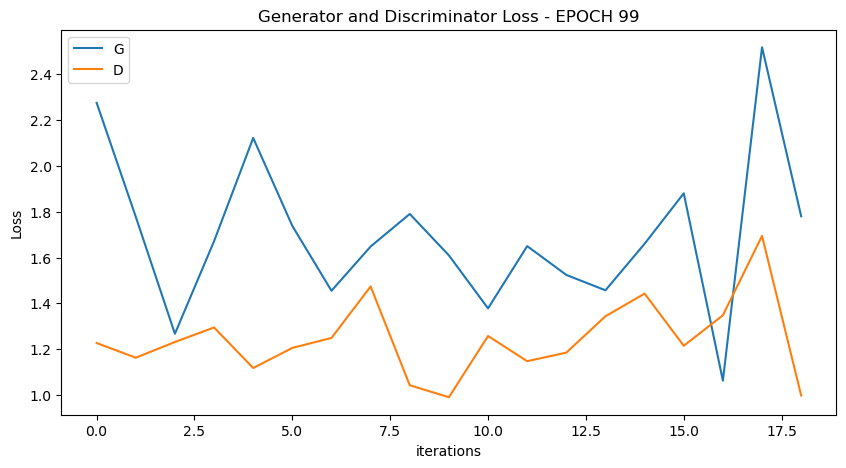

  0%|          | 0/2 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


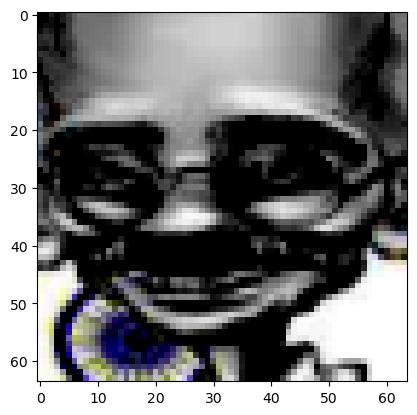

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


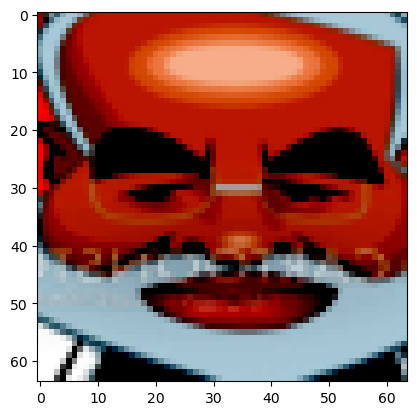

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


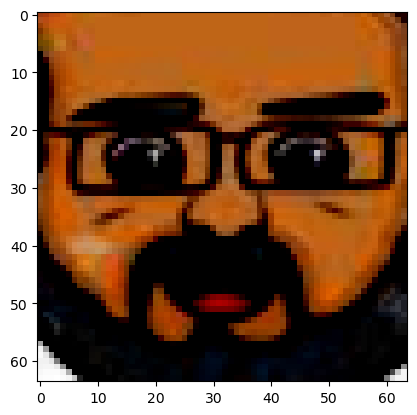

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


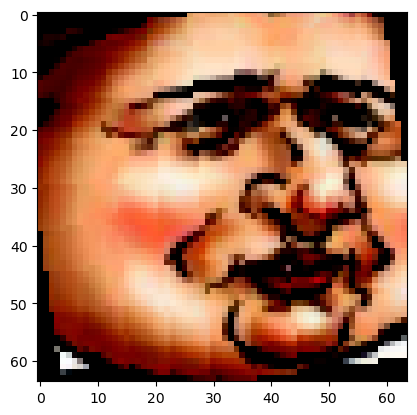

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


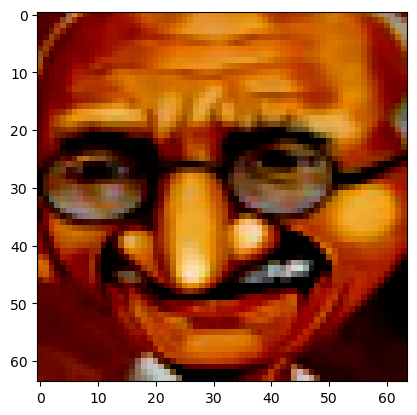

  0%|          | 0/19 [00:00<?, ?it/s]

[1/100][9/19] Loss_D: 0.4478 Loss_G: 5.6278 D(x): 0.8332 D(G(z)): 0.0383 / 0.0019
[1/100][18/19] Loss_D: 1.4833 Loss_G: 8.2678 D(x): 0.9150 D(G(z)): 0.6466 / 0.0002


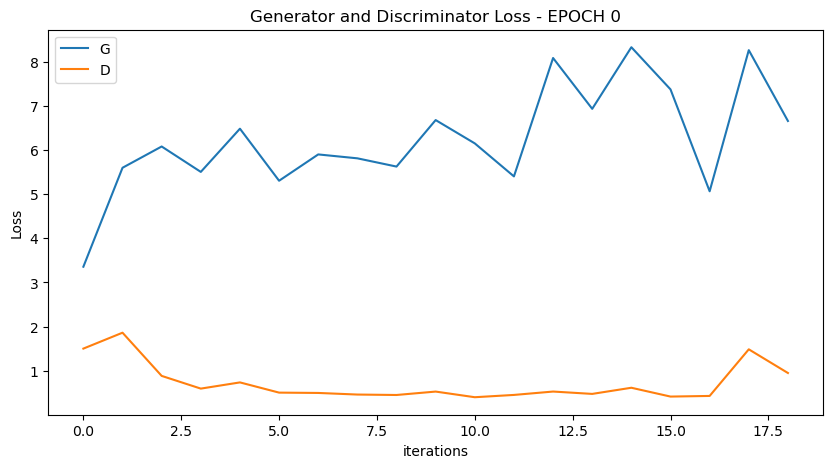

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


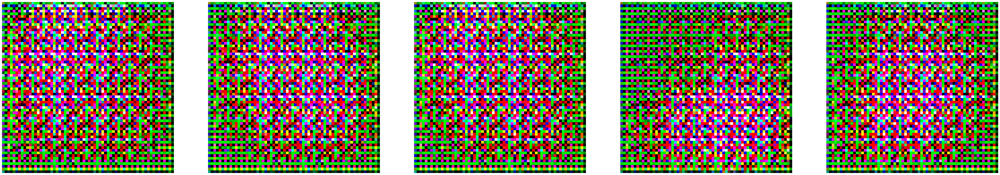

  0%|          | 0/19 [00:00<?, ?it/s]

[2/100][9/19] Loss_D: 0.8875 Loss_G: 4.9446 D(x): 0.7678 D(G(z)): 0.2279 / 0.0048
[2/100][18/19] Loss_D: 0.9960 Loss_G: 3.5758 D(x): 0.6698 D(G(z)): 0.2625 / 0.0259


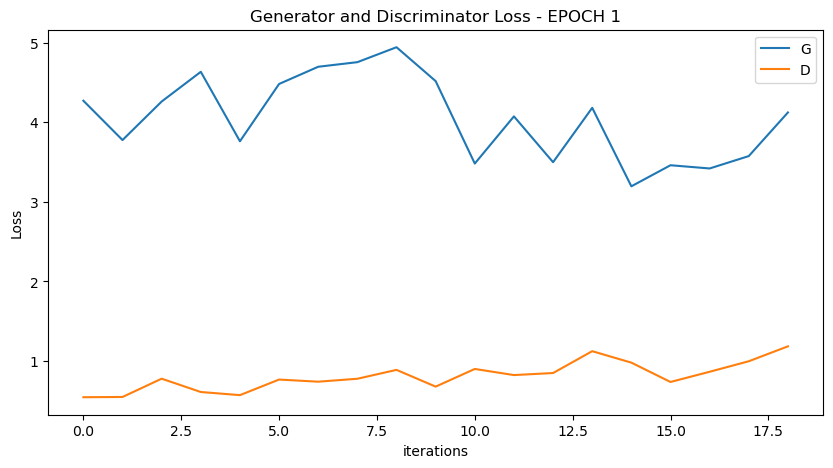

  0%|          | 0/19 [00:00<?, ?it/s]

[3/100][9/19] Loss_D: 1.5505 Loss_G: 1.9424 D(x): 0.3138 D(G(z)): 0.0725 / 0.1546
[3/100][18/19] Loss_D: 1.2375 Loss_G: 3.0024 D(x): 0.6412 D(G(z)): 0.4044 / 0.0441


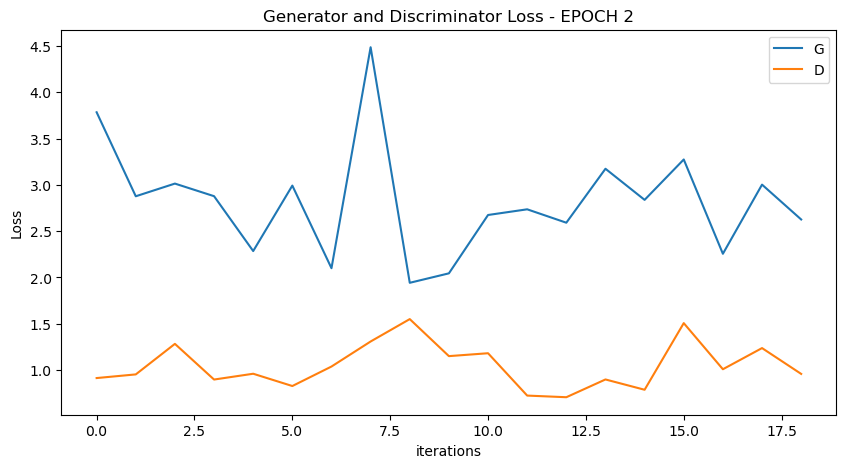

  0%|          | 0/19 [00:00<?, ?it/s]

[4/100][9/19] Loss_D: 1.1418 Loss_G: 1.7640 D(x): 0.4843 D(G(z)): 0.2719 / 0.1586
[4/100][18/19] Loss_D: 1.7374 Loss_G: 3.2428 D(x): 0.6459 D(G(z)): 0.6456 / 0.0354


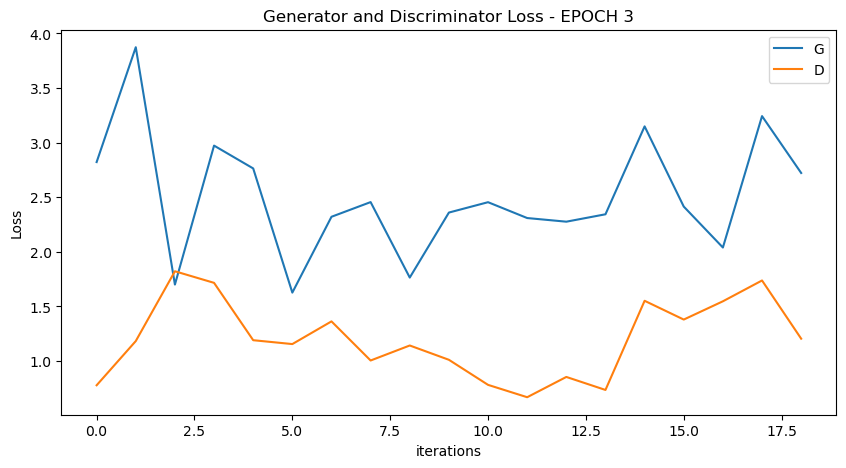

  0%|          | 0/19 [00:00<?, ?it/s]

[5/100][9/19] Loss_D: 1.3158 Loss_G: 1.3371 D(x): 0.4168 D(G(z)): 0.3226 / 0.2587
[5/100][18/19] Loss_D: 1.0955 Loss_G: 1.6059 D(x): 0.5111 D(G(z)): 0.3031 / 0.1885


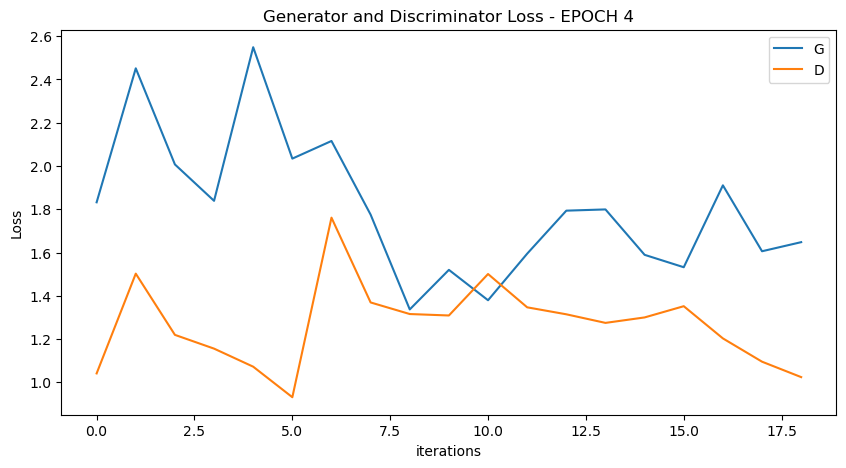

  0%|          | 0/19 [00:00<?, ?it/s]

[6/100][9/19] Loss_D: 1.2634 Loss_G: 1.2346 D(x): 0.5034 D(G(z)): 0.4007 / 0.2857
[6/100][18/19] Loss_D: 1.1283 Loss_G: 1.5271 D(x): 0.5318 D(G(z)): 0.3502 / 0.2054


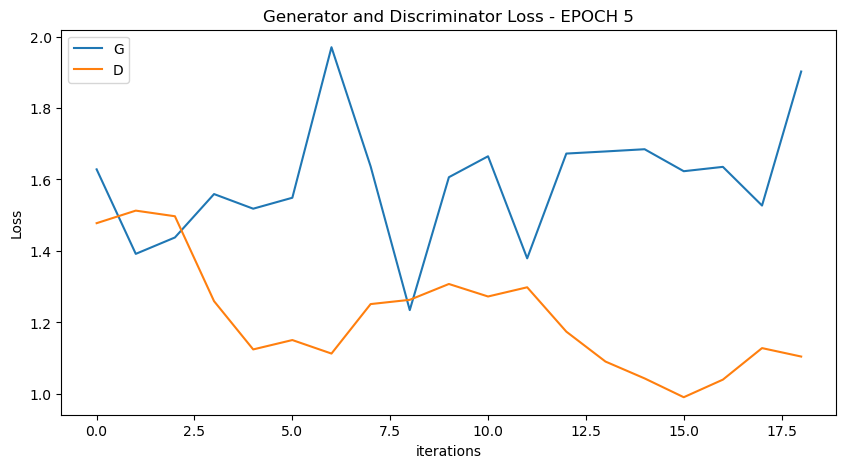

  0%|          | 0/19 [00:00<?, ?it/s]

[7/100][9/19] Loss_D: 1.3536 Loss_G: 1.3328 D(x): 0.5904 D(G(z)): 0.4917 / 0.2578
[7/100][18/19] Loss_D: 1.1662 Loss_G: 1.4153 D(x): 0.5526 D(G(z)): 0.3910 / 0.2367


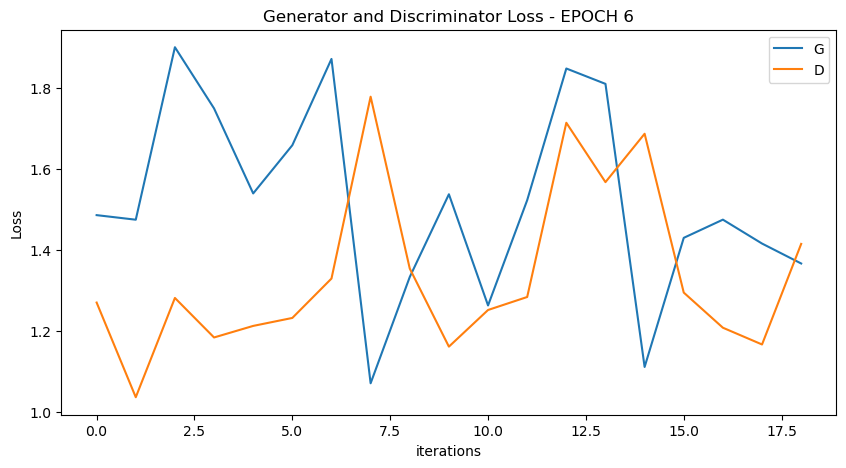

  0%|          | 0/19 [00:00<?, ?it/s]

[8/100][9/19] Loss_D: 1.2648 Loss_G: 1.1998 D(x): 0.5145 D(G(z)): 0.4032 / 0.2867
[8/100][18/19] Loss_D: 1.1123 Loss_G: 1.4798 D(x): 0.4535 D(G(z)): 0.2408 / 0.2163


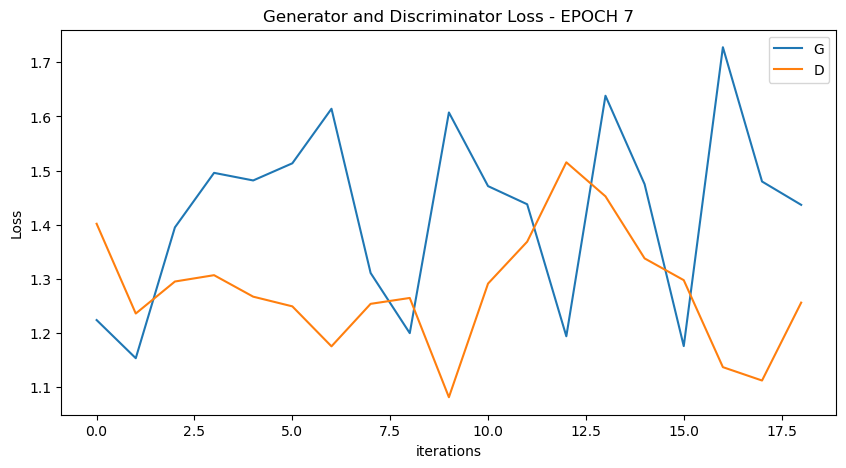

  0%|          | 0/19 [00:00<?, ?it/s]

[9/100][9/19] Loss_D: 1.2188 Loss_G: 1.3936 D(x): 0.4379 D(G(z)): 0.2978 / 0.2288
[9/100][18/19] Loss_D: 1.5739 Loss_G: 1.6748 D(x): 0.4650 D(G(z)): 0.4787 / 0.1759


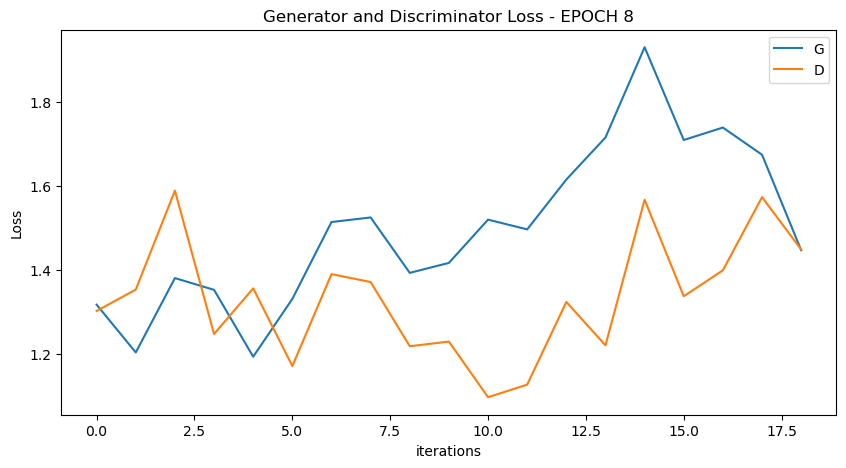

  0%|          | 0/19 [00:00<?, ?it/s]

[10/100][9/19] Loss_D: 1.0390 Loss_G: 1.6922 D(x): 0.6072 D(G(z)): 0.3319 / 0.1761
[10/100][18/19] Loss_D: 1.3721 Loss_G: 1.3157 D(x): 0.4315 D(G(z)): 0.3781 / 0.2677


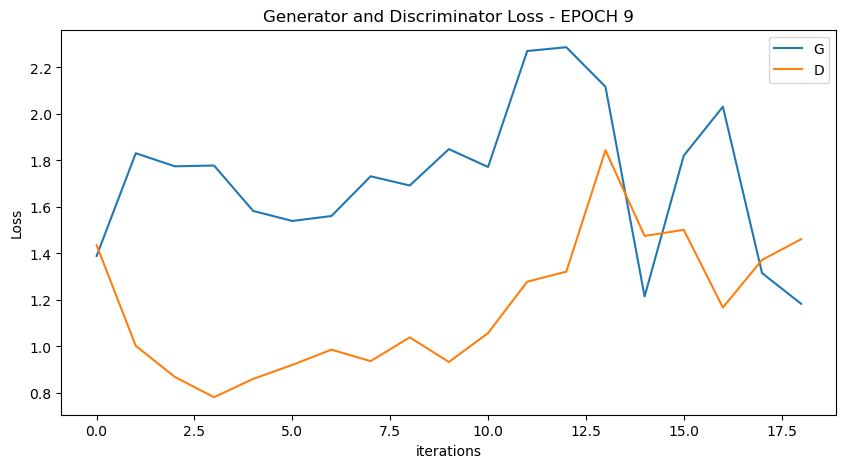

  0%|          | 0/19 [00:00<?, ?it/s]

[11/100][9/19] Loss_D: 1.2329 Loss_G: 1.6636 D(x): 0.5947 D(G(z)): 0.4707 / 0.1692
[11/100][18/19] Loss_D: 1.2554 Loss_G: 1.5535 D(x): 0.4807 D(G(z)): 0.3764 / 0.1922


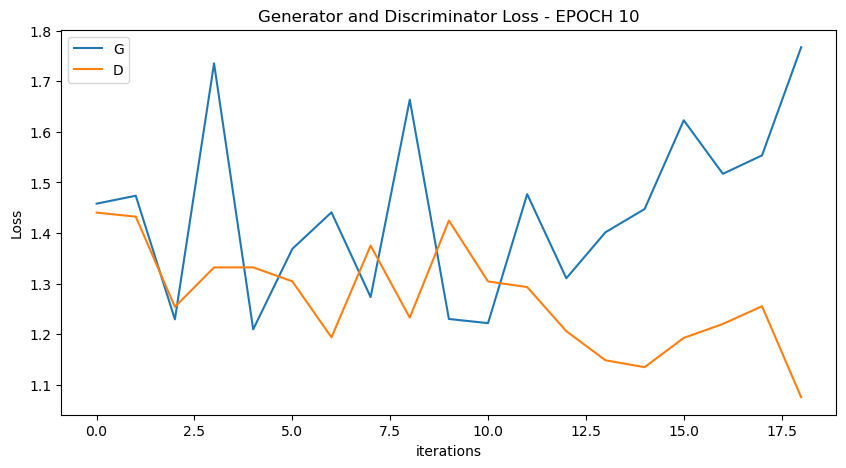

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


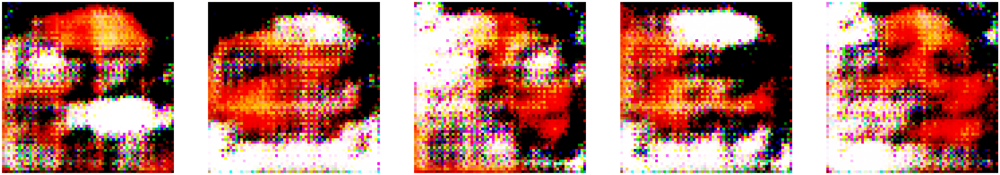

  0%|          | 0/19 [00:00<?, ?it/s]

[12/100][9/19] Loss_D: 1.5317 Loss_G: 1.2405 D(x): 0.4407 D(G(z)): 0.4792 / 0.2788
[12/100][18/19] Loss_D: 1.0908 Loss_G: 1.5970 D(x): 0.5392 D(G(z)): 0.3142 / 0.1894


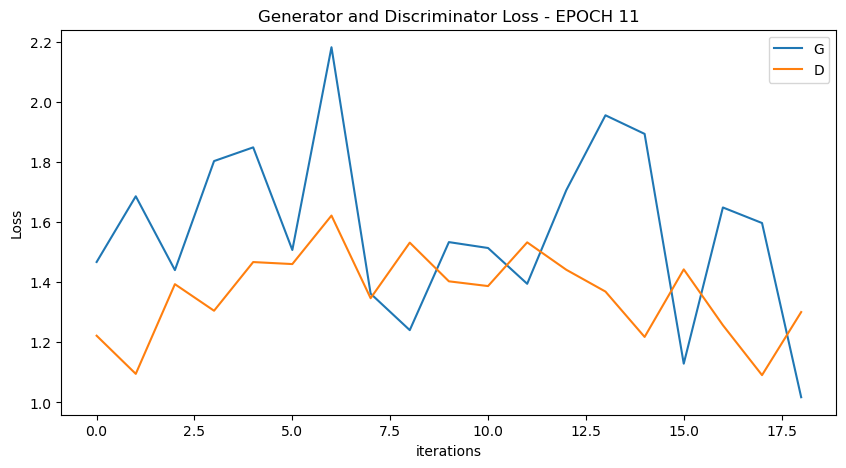

  0%|          | 0/19 [00:00<?, ?it/s]

[13/100][9/19] Loss_D: 1.3819 Loss_G: 1.1781 D(x): 0.4038 D(G(z)): 0.3262 / 0.2918
[13/100][18/19] Loss_D: 1.2129 Loss_G: 1.6069 D(x): 0.6040 D(G(z)): 0.4471 / 0.1888


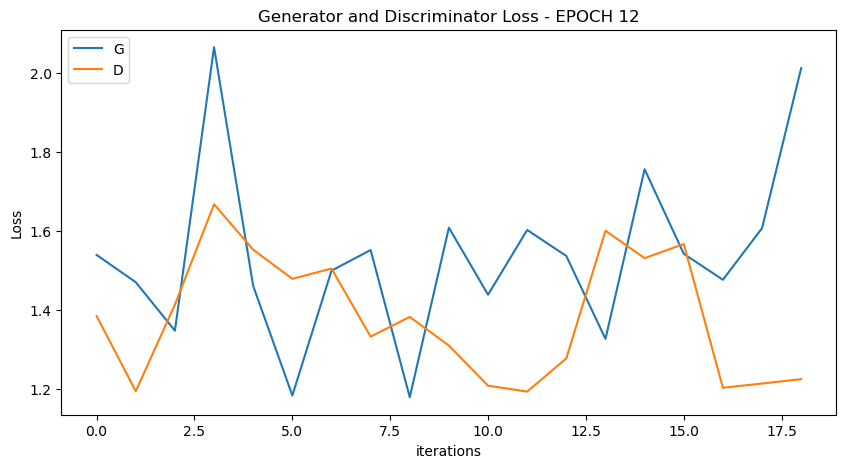

  0%|          | 0/19 [00:00<?, ?it/s]

[14/100][9/19] Loss_D: 1.6368 Loss_G: 1.3802 D(x): 0.3307 D(G(z)): 0.4054 / 0.2353
[14/100][18/19] Loss_D: 1.3216 Loss_G: 1.3934 D(x): 0.4985 D(G(z)): 0.4317 / 0.2269


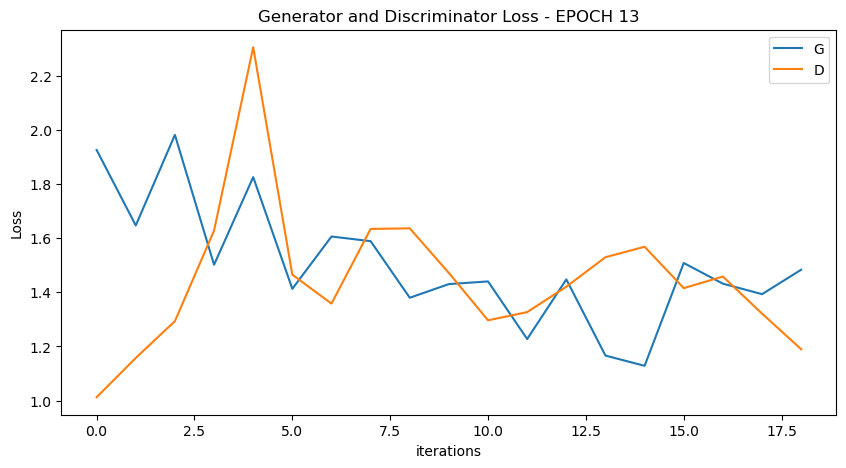

  0%|          | 0/19 [00:00<?, ?it/s]

[15/100][9/19] Loss_D: 1.0527 Loss_G: 1.5855 D(x): 0.5664 D(G(z)): 0.3381 / 0.1877
[15/100][18/19] Loss_D: 1.3295 Loss_G: 1.5517 D(x): 0.4939 D(G(z)): 0.4169 / 0.1969


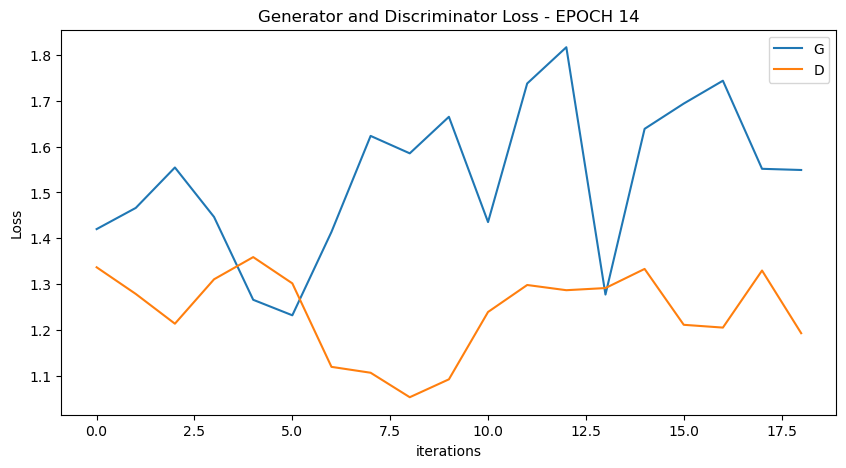

  0%|          | 0/19 [00:00<?, ?it/s]

[16/100][9/19] Loss_D: 1.4821 Loss_G: 1.4113 D(x): 0.4718 D(G(z)): 0.4765 / 0.2261
[16/100][18/19] Loss_D: 1.5313 Loss_G: 1.3979 D(x): 0.3116 D(G(z)): 0.3143 / 0.2435


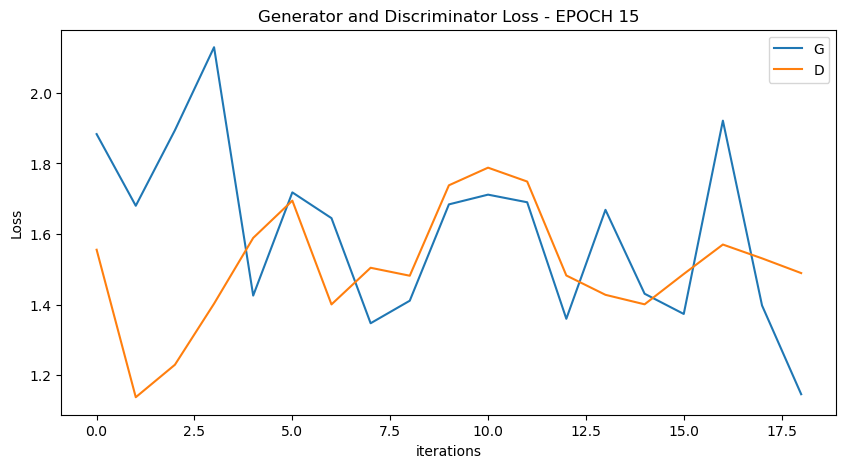

  0%|          | 0/19 [00:00<?, ?it/s]

[17/100][9/19] Loss_D: 1.2647 Loss_G: 1.1946 D(x): 0.4923 D(G(z)): 0.3961 / 0.2858
[17/100][18/19] Loss_D: 1.5370 Loss_G: 1.2056 D(x): 0.3883 D(G(z)): 0.3904 / 0.2876


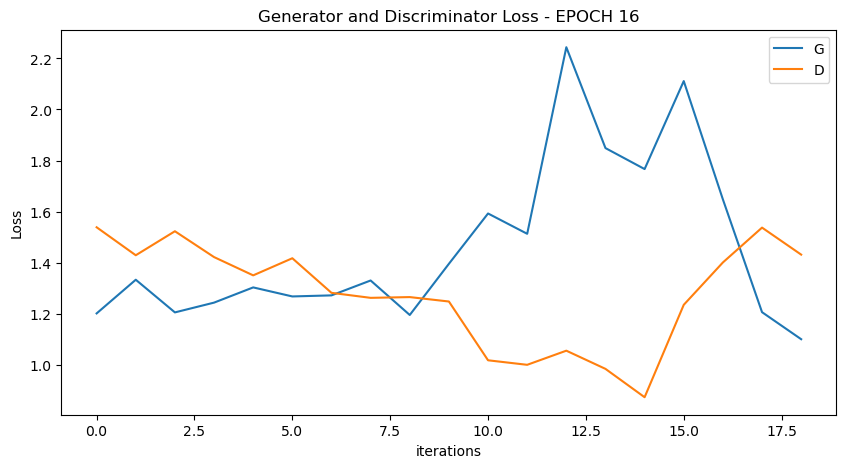

  0%|          | 0/19 [00:00<?, ?it/s]

[18/100][9/19] Loss_D: 1.5966 Loss_G: 1.8788 D(x): 0.4680 D(G(z)): 0.5322 / 0.1437
[18/100][18/19] Loss_D: 1.1966 Loss_G: 1.4388 D(x): 0.5666 D(G(z)): 0.4093 / 0.2267


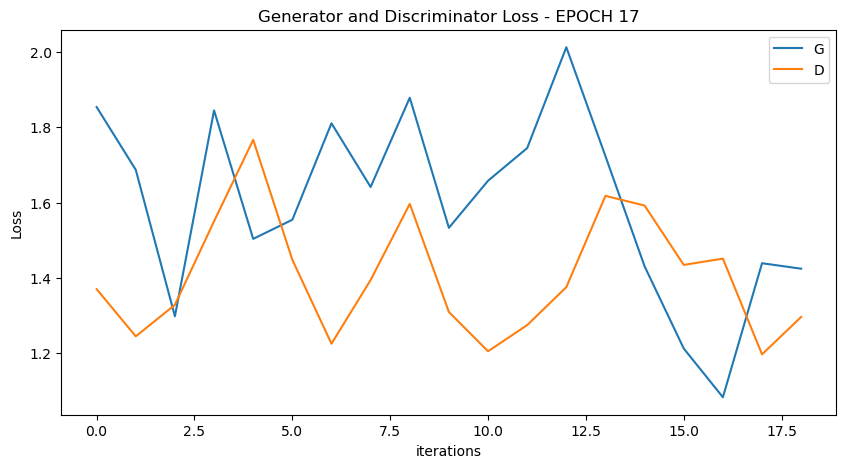

  0%|          | 0/19 [00:00<?, ?it/s]

[19/100][9/19] Loss_D: 1.2909 Loss_G: 1.3260 D(x): 0.4757 D(G(z)): 0.3995 / 0.2435
[19/100][18/19] Loss_D: 1.4573 Loss_G: 1.2915 D(x): 0.3497 D(G(z)): 0.3070 / 0.2556


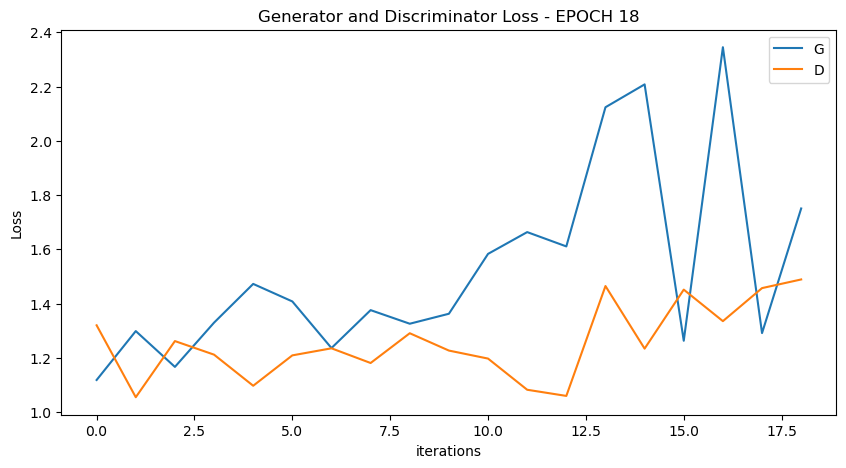

  0%|          | 0/19 [00:00<?, ?it/s]

[20/100][9/19] Loss_D: 1.4983 Loss_G: 1.1723 D(x): 0.3050 D(G(z)): 0.2573 / 0.2933
[20/100][18/19] Loss_D: 1.0978 Loss_G: 1.7446 D(x): 0.5801 D(G(z)): 0.3543 / 0.1658


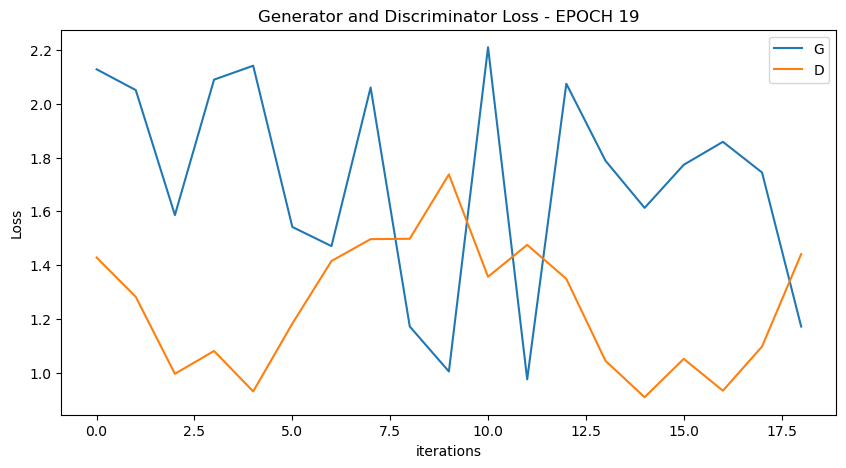

  0%|          | 0/19 [00:00<?, ?it/s]

[21/100][9/19] Loss_D: 1.2239 Loss_G: 1.5011 D(x): 0.5672 D(G(z)): 0.4254 / 0.2207
[21/100][18/19] Loss_D: 1.5989 Loss_G: 1.2441 D(x): 0.2859 D(G(z)): 0.3023 / 0.2743


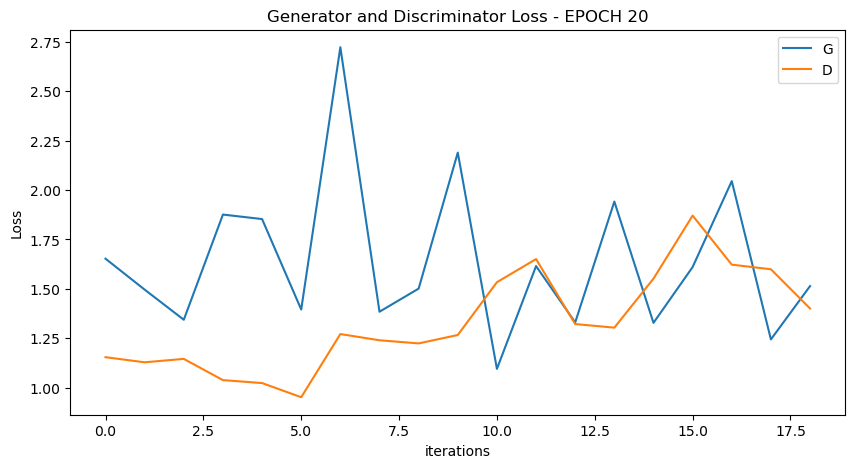

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


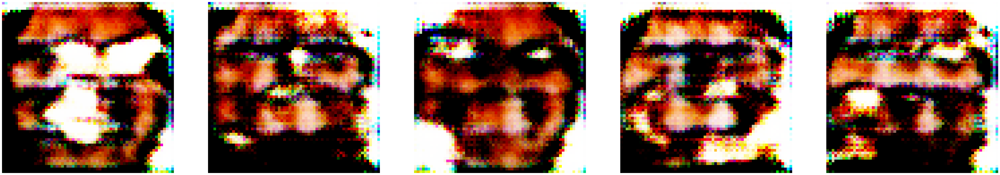

  0%|          | 0/19 [00:00<?, ?it/s]

[22/100][9/19] Loss_D: 1.5910 Loss_G: 0.8658 D(x): 0.3923 D(G(z)): 0.4680 / 0.4179
[22/100][18/19] Loss_D: 1.3004 Loss_G: 1.4252 D(x): 0.4234 D(G(z)): 0.3343 / 0.2218


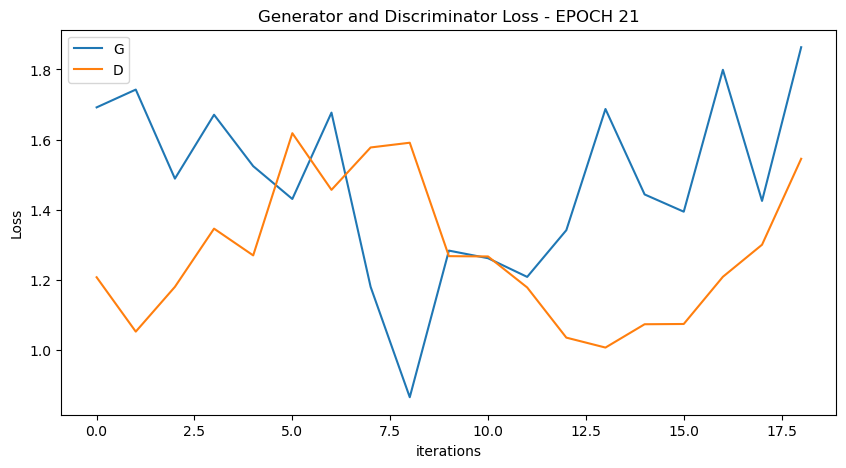

  0%|          | 0/19 [00:00<?, ?it/s]

[23/100][9/19] Loss_D: 1.4052 Loss_G: 1.8388 D(x): 0.4184 D(G(z)): 0.3678 / 0.1469
[23/100][18/19] Loss_D: 1.4809 Loss_G: 1.0609 D(x): 0.3467 D(G(z)): 0.3068 / 0.3455


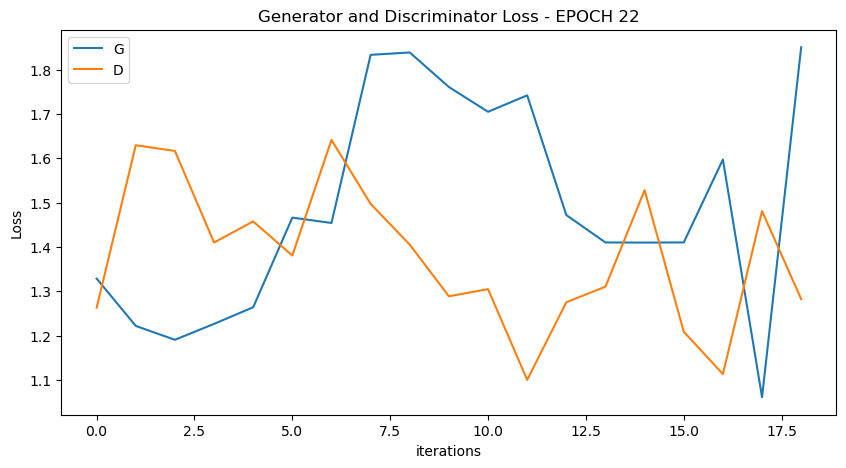

  0%|          | 0/19 [00:00<?, ?it/s]

[24/100][9/19] Loss_D: 1.1269 Loss_G: 1.5125 D(x): 0.5990 D(G(z)): 0.3969 / 0.2133
[24/100][18/19] Loss_D: 1.5671 Loss_G: 1.7533 D(x): 0.4423 D(G(z)): 0.4759 / 0.1683


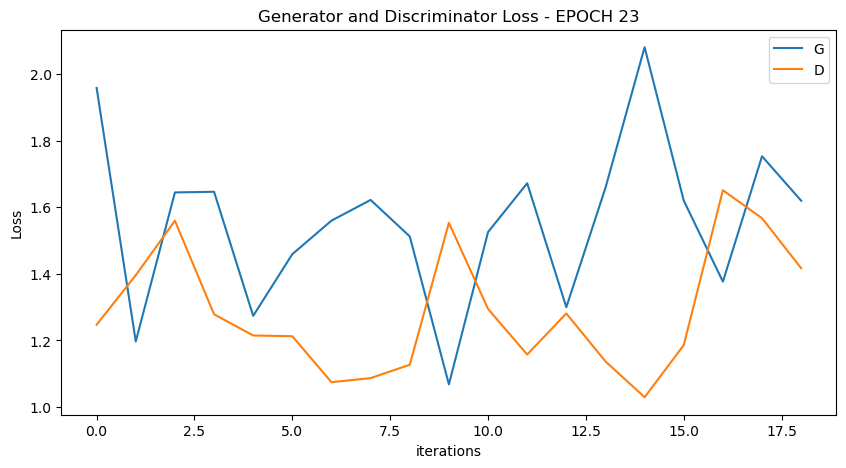

  0%|          | 0/19 [00:00<?, ?it/s]

[25/100][9/19] Loss_D: 1.2351 Loss_G: 1.6639 D(x): 0.4593 D(G(z)): 0.3233 / 0.1740
[25/100][18/19] Loss_D: 1.1657 Loss_G: 1.8154 D(x): 0.5859 D(G(z)): 0.4141 / 0.1452


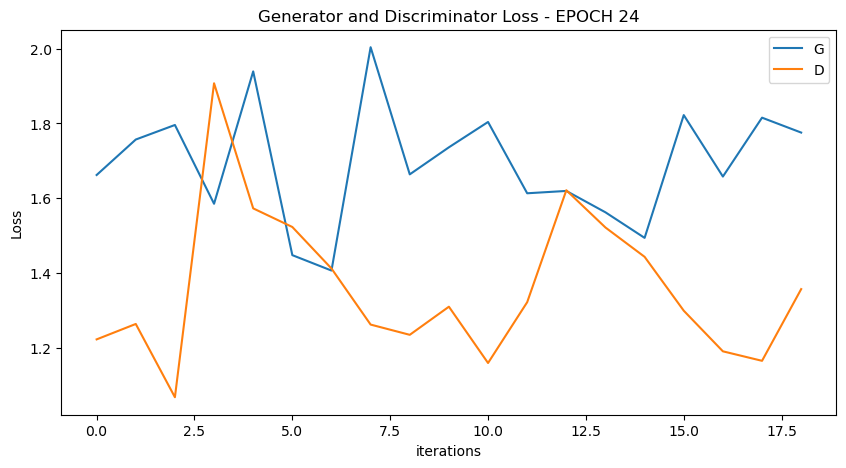

  0%|          | 0/19 [00:00<?, ?it/s]

[26/100][9/19] Loss_D: 1.2513 Loss_G: 1.4014 D(x): 0.5775 D(G(z)): 0.4610 / 0.2343
[26/100][18/19] Loss_D: 1.3060 Loss_G: 1.5122 D(x): 0.5086 D(G(z)): 0.4164 / 0.2029


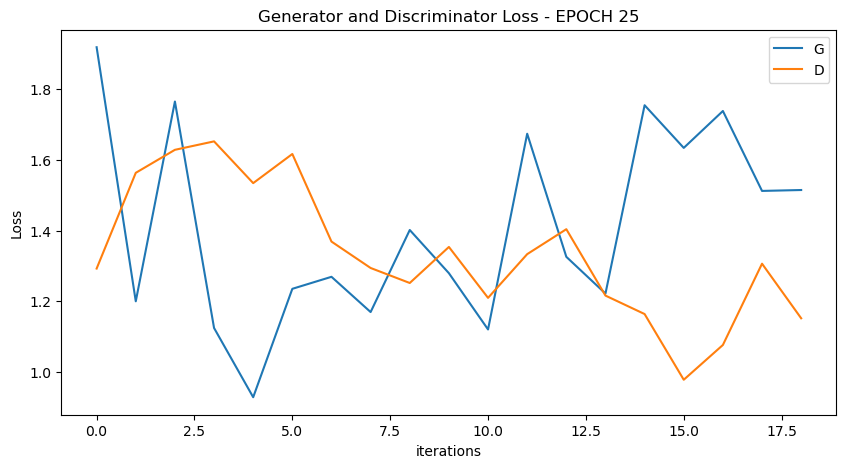

  0%|          | 0/19 [00:00<?, ?it/s]

[27/100][9/19] Loss_D: 1.2829 Loss_G: 1.8492 D(x): 0.4901 D(G(z)): 0.3362 / 0.1574
[27/100][18/19] Loss_D: 1.6204 Loss_G: 1.5946 D(x): 0.4902 D(G(z)): 0.5477 / 0.2006


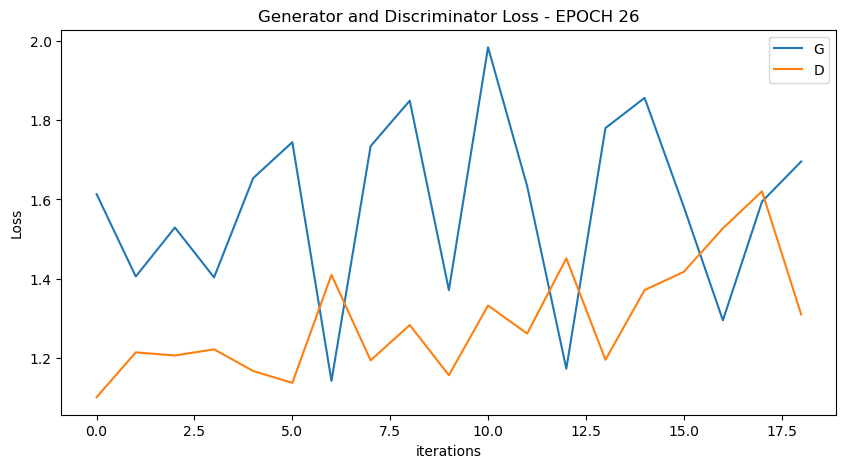

  0%|          | 0/19 [00:00<?, ?it/s]

[28/100][9/19] Loss_D: 1.1510 Loss_G: 1.3774 D(x): 0.4648 D(G(z)): 0.2902 / 0.2394
[28/100][18/19] Loss_D: 1.2655 Loss_G: 1.2173 D(x): 0.5685 D(G(z)): 0.4561 / 0.2831


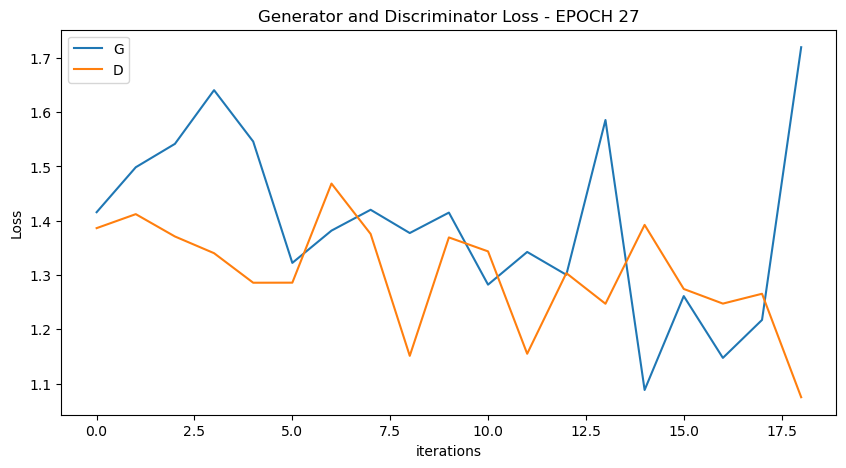

  0%|          | 0/19 [00:00<?, ?it/s]

[29/100][9/19] Loss_D: 1.2977 Loss_G: 1.4548 D(x): 0.4906 D(G(z)): 0.3562 / 0.2254
[29/100][18/19] Loss_D: 1.3538 Loss_G: 1.7297 D(x): 0.4385 D(G(z)): 0.3695 / 0.1606


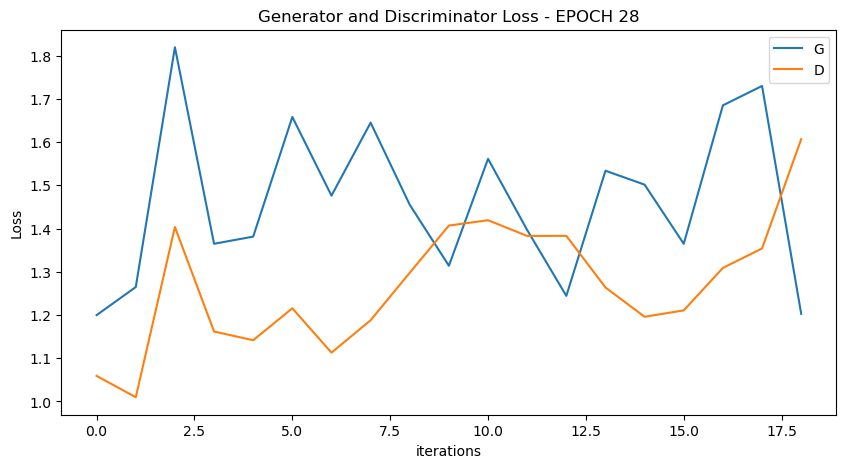

  0%|          | 0/19 [00:00<?, ?it/s]

[30/100][9/19] Loss_D: 1.3834 Loss_G: 1.9097 D(x): 0.4195 D(G(z)): 0.3762 / 0.1360
[30/100][18/19] Loss_D: 1.4045 Loss_G: 1.3109 D(x): 0.5146 D(G(z)): 0.4766 / 0.2518


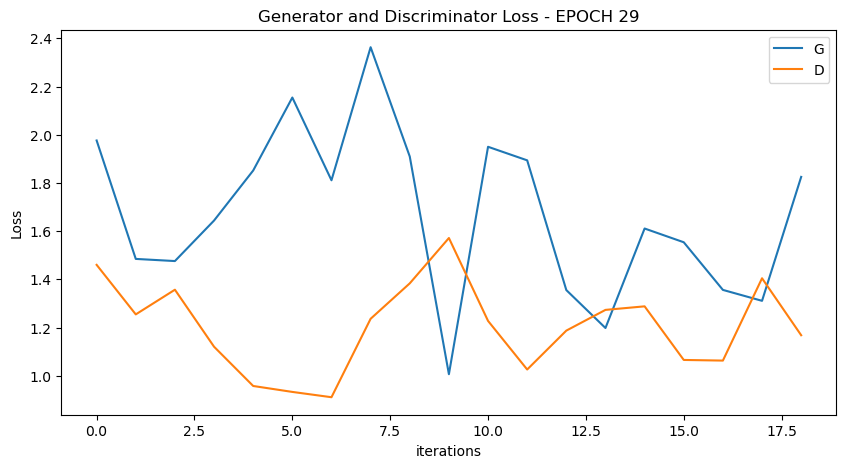

  0%|          | 0/19 [00:00<?, ?it/s]

[31/100][9/19] Loss_D: 1.2768 Loss_G: 1.6960 D(x): 0.4633 D(G(z)): 0.3262 / 0.1776
[31/100][18/19] Loss_D: 1.1752 Loss_G: 1.5904 D(x): 0.4617 D(G(z)): 0.2984 / 0.2081


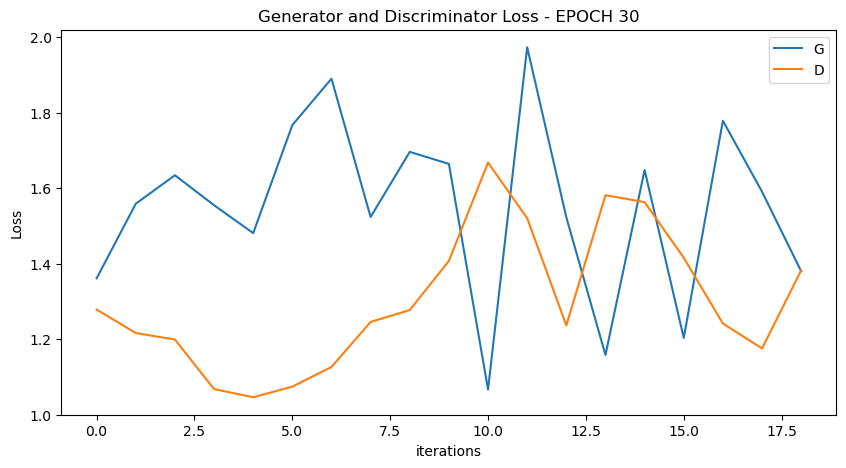

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


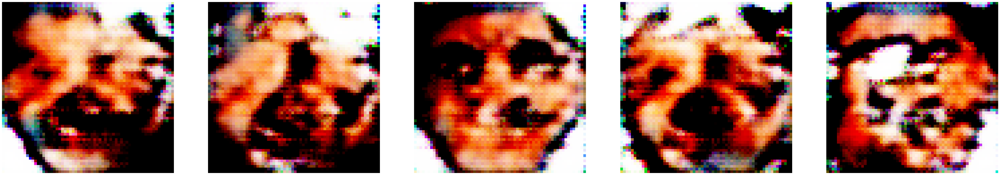

  0%|          | 0/19 [00:00<?, ?it/s]

[32/100][9/19] Loss_D: 1.8782 Loss_G: 0.9960 D(x): 0.1882 D(G(z)): 0.2152 / 0.3733
[32/100][18/19] Loss_D: 1.7322 Loss_G: 1.6249 D(x): 0.3497 D(G(z)): 0.3485 / 0.1886


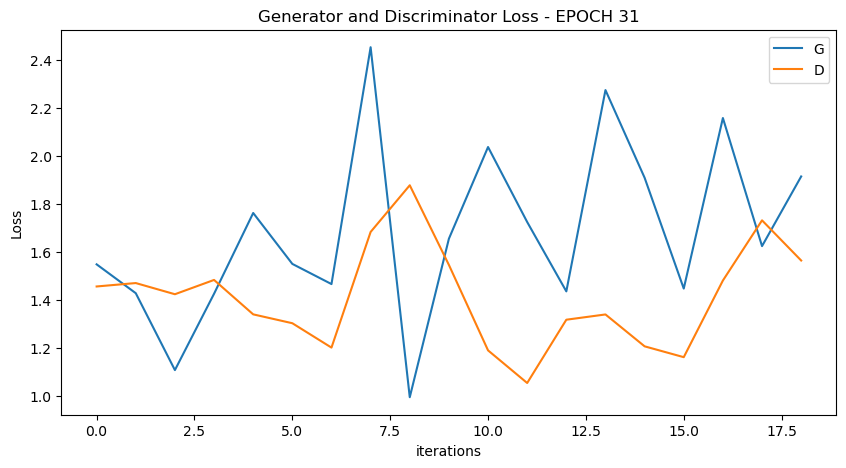

  0%|          | 0/19 [00:00<?, ?it/s]

[33/100][9/19] Loss_D: 1.2347 Loss_G: 1.5776 D(x): 0.5511 D(G(z)): 0.3935 / 0.2015
[33/100][18/19] Loss_D: 1.1449 Loss_G: 1.5030 D(x): 0.5029 D(G(z)): 0.3461 / 0.2040


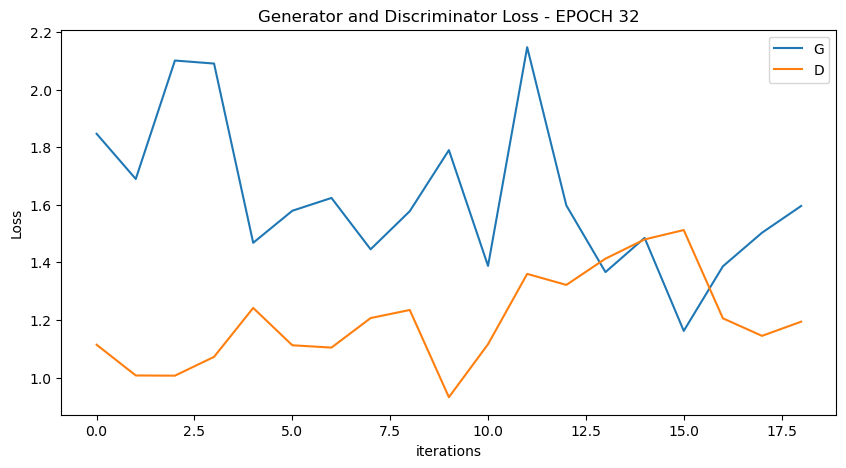

  0%|          | 0/19 [00:00<?, ?it/s]

[34/100][9/19] Loss_D: 1.2211 Loss_G: 1.5423 D(x): 0.5428 D(G(z)): 0.3901 / 0.1955
[34/100][18/19] Loss_D: 1.3125 Loss_G: 1.3150 D(x): 0.4616 D(G(z)): 0.3813 / 0.2545


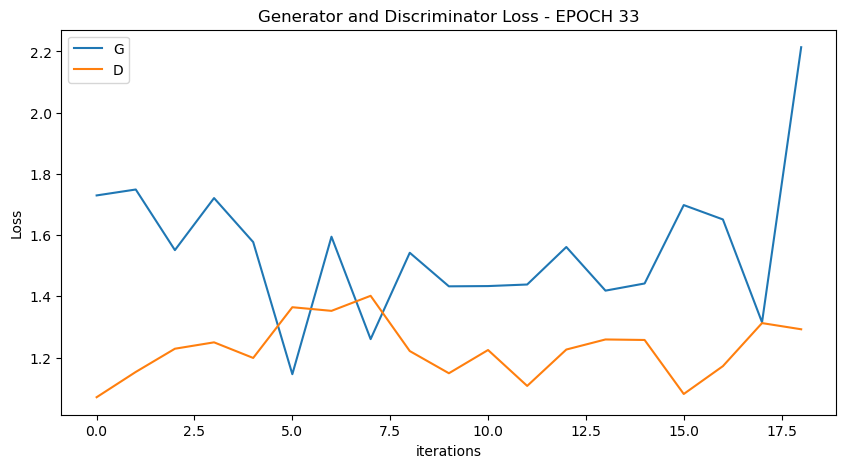

  0%|          | 0/19 [00:00<?, ?it/s]

[35/100][9/19] Loss_D: 1.7798 Loss_G: 1.0230 D(x): 0.2137 D(G(z)): 0.1825 / 0.3706
[35/100][18/19] Loss_D: 1.2323 Loss_G: 1.5385 D(x): 0.5500 D(G(z)): 0.4307 / 0.2017


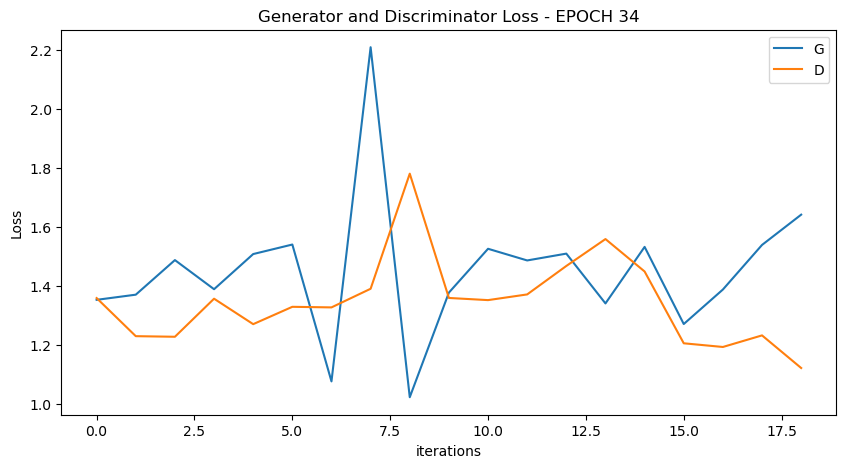

  0%|          | 0/19 [00:00<?, ?it/s]

[36/100][9/19] Loss_D: 1.2224 Loss_G: 1.4949 D(x): 0.4512 D(G(z)): 0.3035 / 0.2078
[36/100][18/19] Loss_D: 1.4421 Loss_G: 1.4117 D(x): 0.4281 D(G(z)): 0.4260 / 0.2339


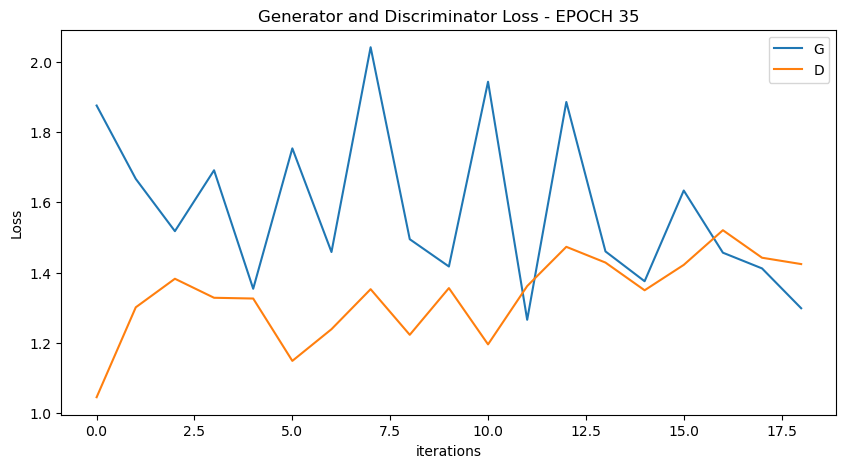

  0%|          | 0/19 [00:00<?, ?it/s]

[37/100][9/19] Loss_D: 1.2644 Loss_G: 1.3111 D(x): 0.4746 D(G(z)): 0.3421 / 0.2611
[37/100][18/19] Loss_D: 1.1863 Loss_G: 1.2866 D(x): 0.4501 D(G(z)): 0.2971 / 0.2635


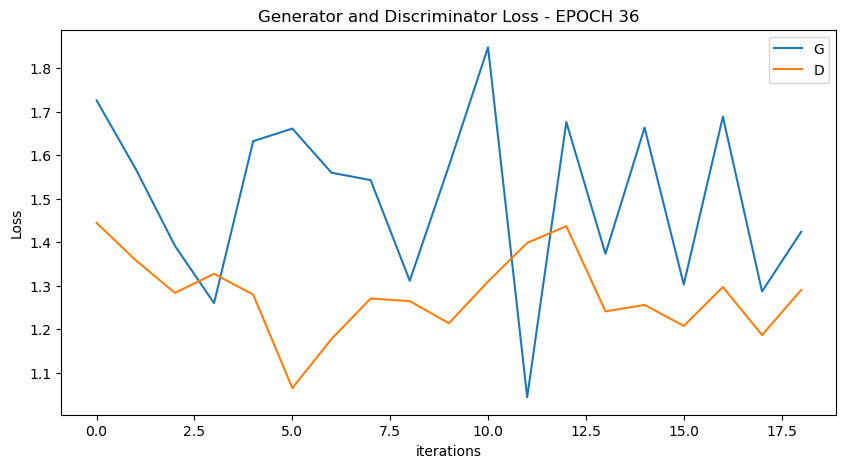

  0%|          | 0/19 [00:00<?, ?it/s]

[38/100][9/19] Loss_D: 1.0778 Loss_G: 1.4767 D(x): 0.4987 D(G(z)): 0.2897 / 0.2123
[38/100][18/19] Loss_D: 1.3023 Loss_G: 1.2077 D(x): 0.5027 D(G(z)): 0.4217 / 0.2947


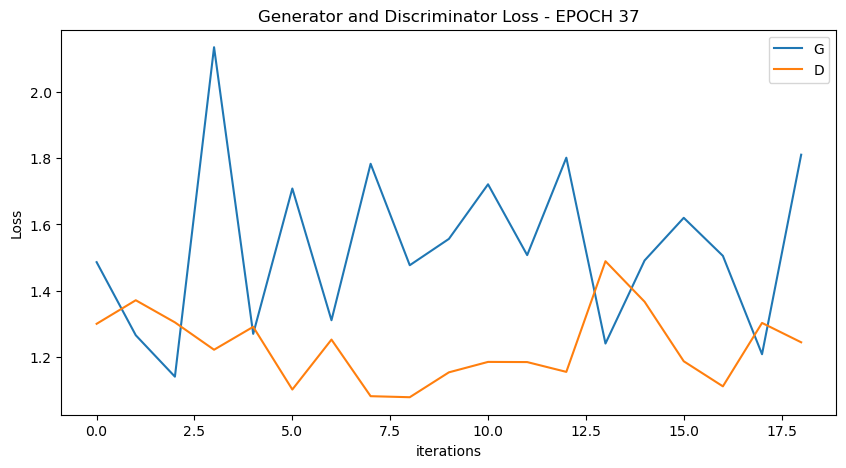

  0%|          | 0/19 [00:00<?, ?it/s]

[39/100][9/19] Loss_D: 1.2612 Loss_G: 1.2907 D(x): 0.4806 D(G(z)): 0.3796 / 0.2639
[39/100][18/19] Loss_D: 1.3667 Loss_G: 2.5827 D(x): 0.5525 D(G(z)): 0.4909 / 0.0615


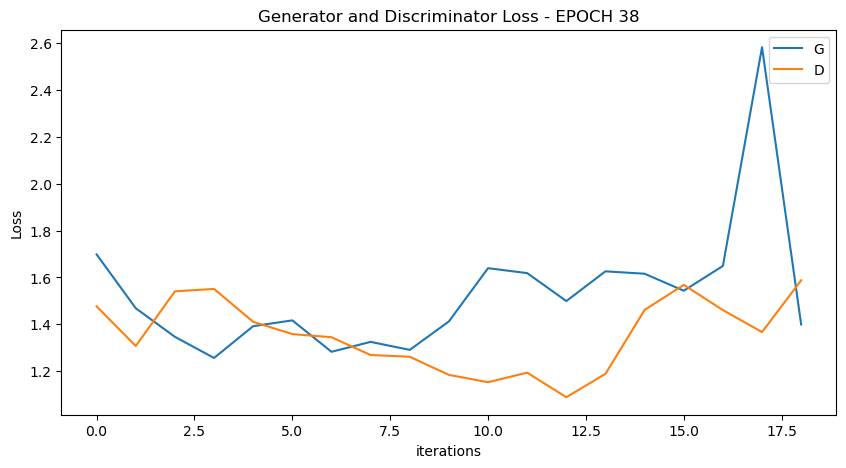

  0%|          | 0/19 [00:00<?, ?it/s]

[40/100][9/19] Loss_D: 1.3515 Loss_G: 1.3566 D(x): 0.3878 D(G(z)): 0.2977 / 0.2615
[40/100][18/19] Loss_D: 1.2837 Loss_G: 1.8441 D(x): 0.5658 D(G(z)): 0.4588 / 0.1443


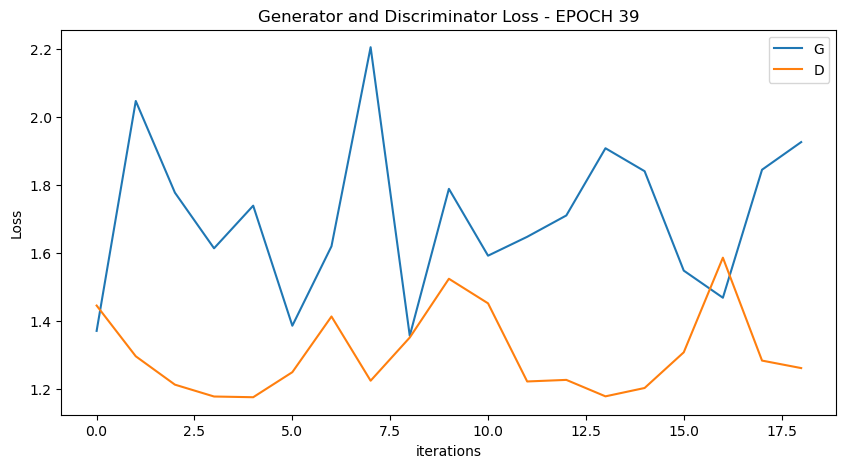

  0%|          | 0/19 [00:00<?, ?it/s]

[41/100][9/19] Loss_D: 1.0801 Loss_G: 2.2146 D(x): 0.6817 D(G(z)): 0.4241 / 0.1147
[41/100][18/19] Loss_D: 1.3032 Loss_G: 1.6936 D(x): 0.5269 D(G(z)): 0.4440 / 0.1734


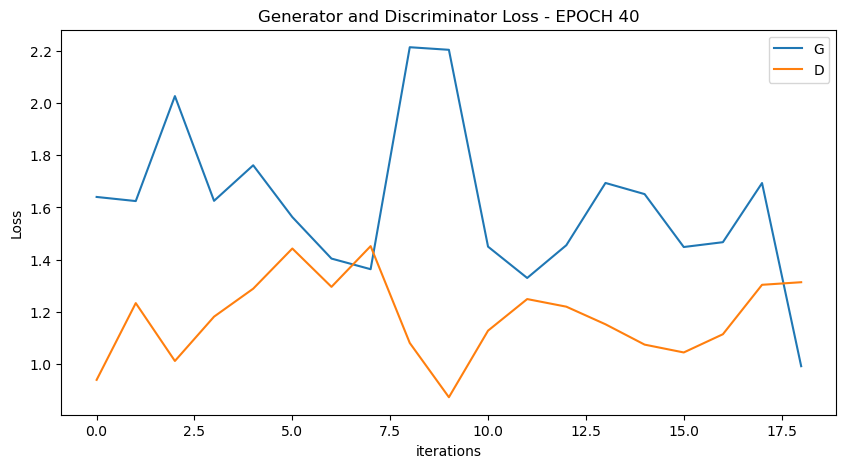

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


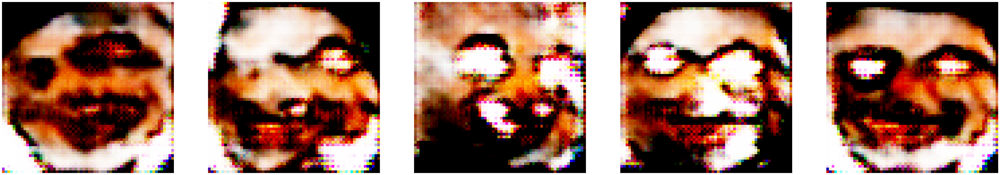

  0%|          | 0/19 [00:00<?, ?it/s]

[42/100][9/19] Loss_D: 1.2175 Loss_G: 1.8751 D(x): 0.5257 D(G(z)): 0.3731 / 0.1516
[42/100][18/19] Loss_D: 1.2846 Loss_G: 1.8533 D(x): 0.6254 D(G(z)): 0.4909 / 0.1531


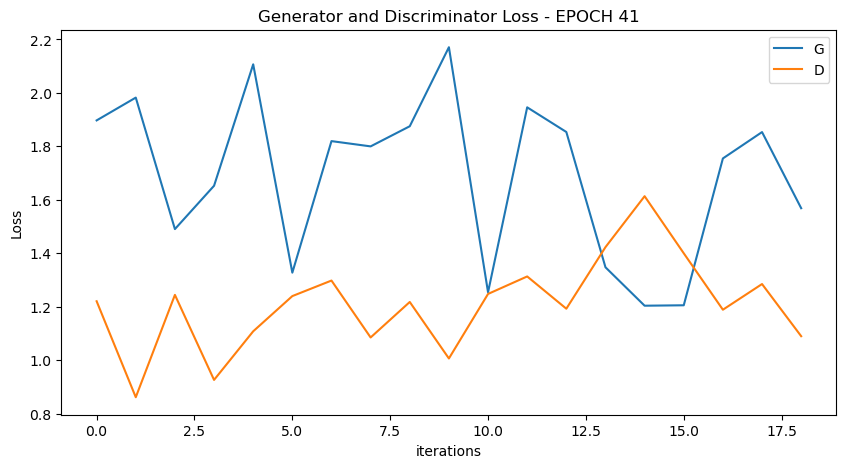

  0%|          | 0/19 [00:00<?, ?it/s]

[43/100][9/19] Loss_D: 1.1035 Loss_G: 1.4855 D(x): 0.5722 D(G(z)): 0.3597 / 0.2192
[43/100][18/19] Loss_D: 1.0324 Loss_G: 1.4470 D(x): 0.5360 D(G(z)): 0.2979 / 0.2160


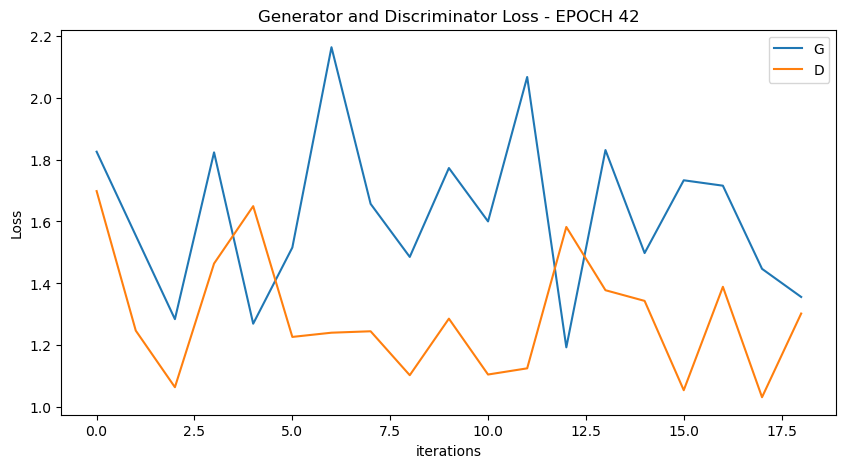

  0%|          | 0/19 [00:00<?, ?it/s]

[44/100][9/19] Loss_D: 1.4750 Loss_G: 1.2737 D(x): 0.4268 D(G(z)): 0.4289 / 0.2611
[44/100][18/19] Loss_D: 1.2154 Loss_G: 1.5170 D(x): 0.4810 D(G(z)): 0.3353 / 0.2010


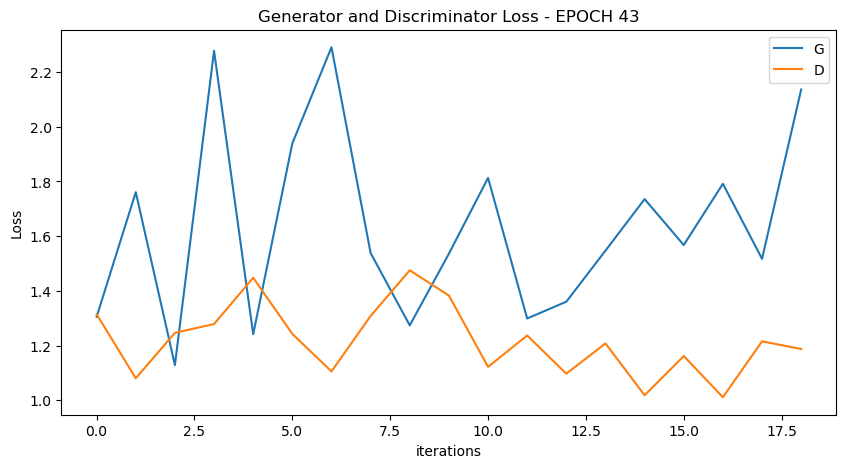

  0%|          | 0/19 [00:00<?, ?it/s]

[45/100][9/19] Loss_D: 1.0930 Loss_G: 1.3010 D(x): 0.5125 D(G(z)): 0.3079 / 0.2514
[45/100][18/19] Loss_D: 1.2777 Loss_G: 1.6482 D(x): 0.5180 D(G(z)): 0.4320 / 0.1976


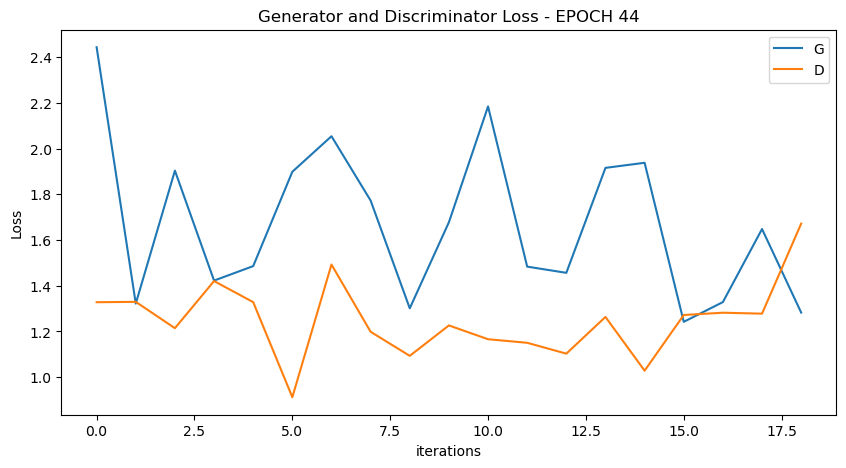

  0%|          | 0/19 [00:00<?, ?it/s]

[46/100][9/19] Loss_D: 1.2440 Loss_G: 1.2597 D(x): 0.4412 D(G(z)): 0.2836 / 0.2685
[46/100][18/19] Loss_D: 1.3980 Loss_G: 1.2905 D(x): 0.4472 D(G(z)): 0.4214 / 0.2650


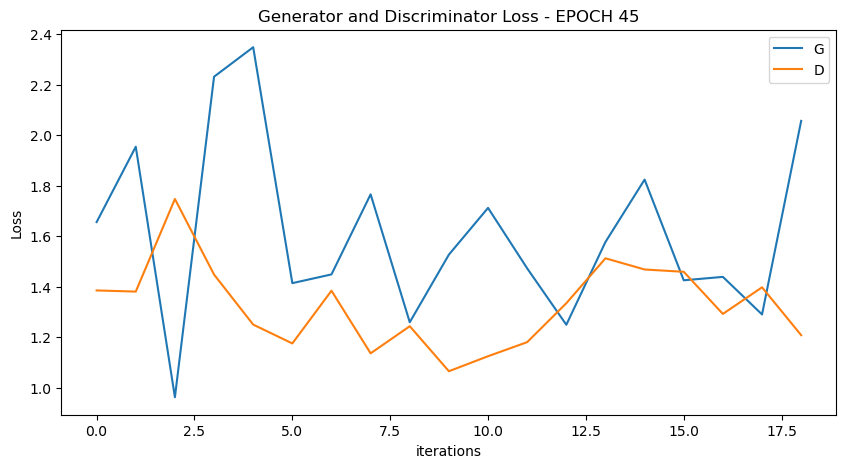

  0%|          | 0/19 [00:00<?, ?it/s]

[47/100][9/19] Loss_D: 0.9502 Loss_G: 2.0327 D(x): 0.6058 D(G(z)): 0.2861 / 0.1405
[47/100][18/19] Loss_D: 1.1096 Loss_G: 1.8214 D(x): 0.6040 D(G(z)): 0.3959 / 0.1667


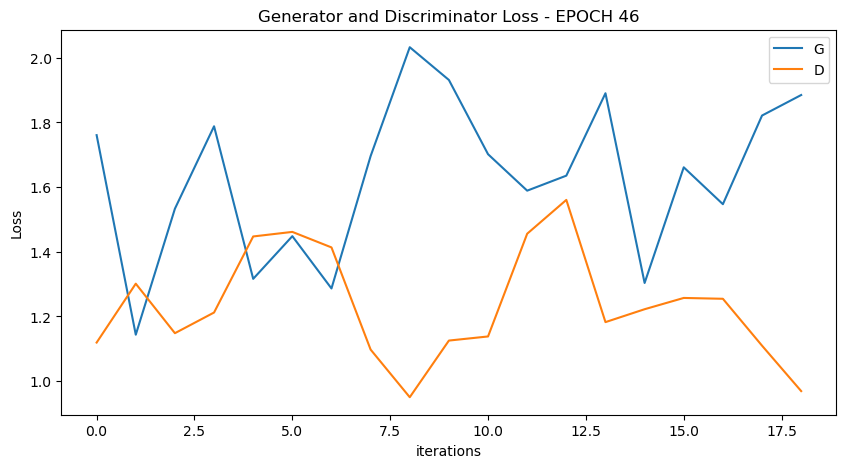

  0%|          | 0/19 [00:00<?, ?it/s]

[48/100][9/19] Loss_D: 1.1193 Loss_G: 1.7831 D(x): 0.5928 D(G(z)): 0.3939 / 0.1577
[48/100][18/19] Loss_D: 1.0325 Loss_G: 1.9809 D(x): 0.6353 D(G(z)): 0.3704 / 0.1354


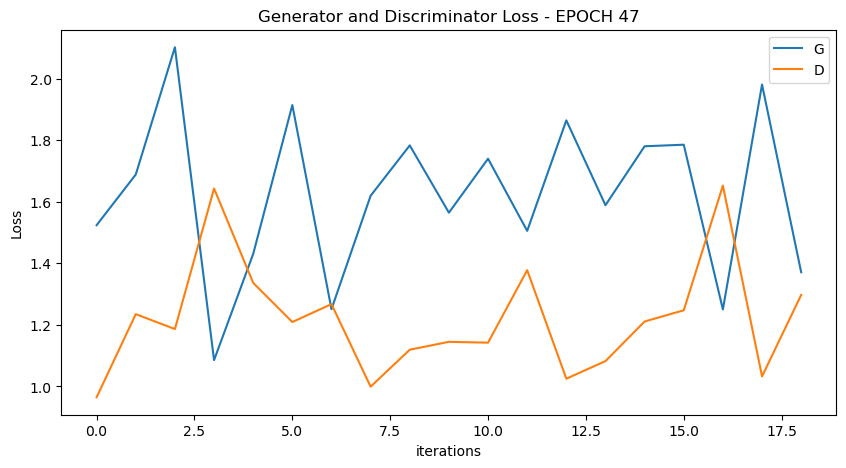

  0%|          | 0/19 [00:00<?, ?it/s]

[49/100][9/19] Loss_D: 1.2197 Loss_G: 1.6854 D(x): 0.4400 D(G(z)): 0.3038 / 0.1699
[49/100][18/19] Loss_D: 1.2721 Loss_G: 1.2675 D(x): 0.4632 D(G(z)): 0.3609 / 0.2691


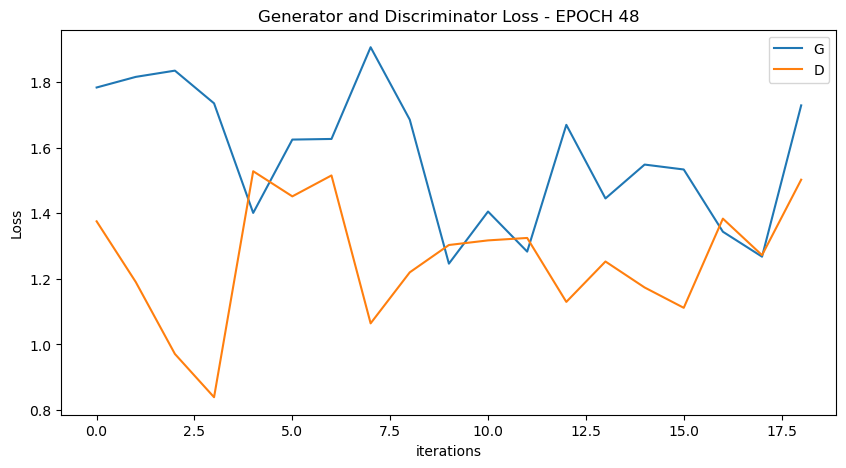

  0%|          | 0/19 [00:00<?, ?it/s]

[50/100][9/19] Loss_D: 1.0918 Loss_G: 1.6782 D(x): 0.6215 D(G(z)): 0.4064 / 0.1722
[50/100][18/19] Loss_D: 1.4109 Loss_G: 1.1460 D(x): 0.3259 D(G(z)): 0.2490 / 0.3137


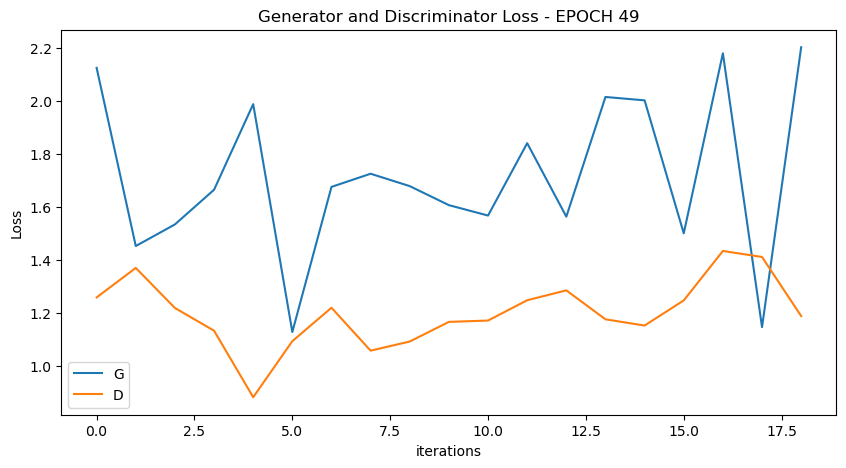

  0%|          | 0/19 [00:00<?, ?it/s]

[51/100][9/19] Loss_D: 1.0806 Loss_G: 1.9347 D(x): 0.6567 D(G(z)): 0.4271 / 0.1326
[51/100][18/19] Loss_D: 1.1611 Loss_G: 1.4403 D(x): 0.6348 D(G(z)): 0.4590 / 0.2252


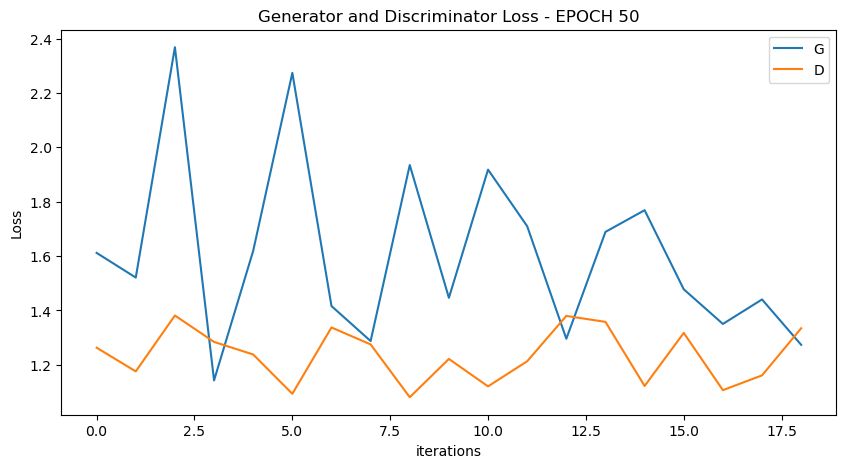

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


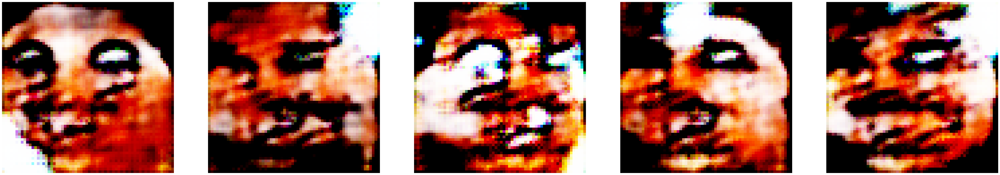

  0%|          | 0/19 [00:00<?, ?it/s]

[52/100][9/19] Loss_D: 1.1554 Loss_G: 1.3609 D(x): 0.6152 D(G(z)): 0.4121 / 0.2466
[52/100][18/19] Loss_D: 1.2616 Loss_G: 1.5149 D(x): 0.5499 D(G(z)): 0.4332 / 0.2093


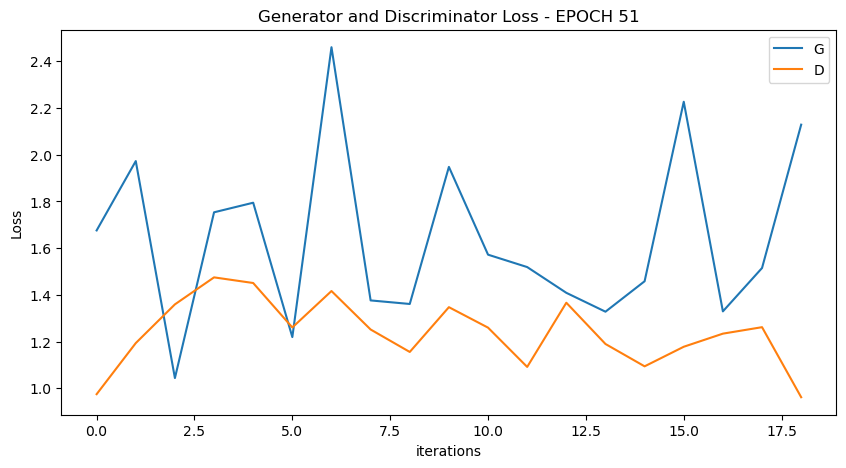

  0%|          | 0/19 [00:00<?, ?it/s]

[53/100][9/19] Loss_D: 1.1464 Loss_G: 1.6678 D(x): 0.5756 D(G(z)): 0.3946 / 0.1697
[53/100][18/19] Loss_D: 1.2862 Loss_G: 1.2153 D(x): 0.3504 D(G(z)): 0.2131 / 0.2899


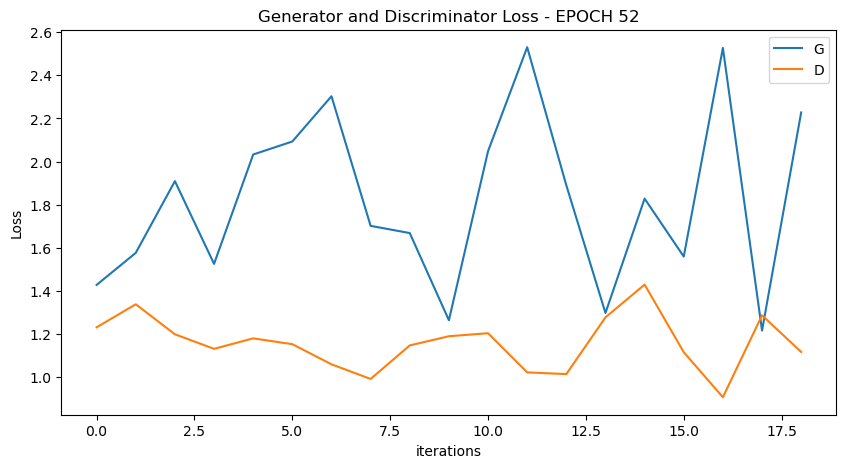

  0%|          | 0/19 [00:00<?, ?it/s]

[54/100][9/19] Loss_D: 1.1586 Loss_G: 1.5653 D(x): 0.5629 D(G(z)): 0.3884 / 0.1998
[54/100][18/19] Loss_D: 1.4156 Loss_G: 1.9734 D(x): 0.6283 D(G(z)): 0.5538 / 0.1386


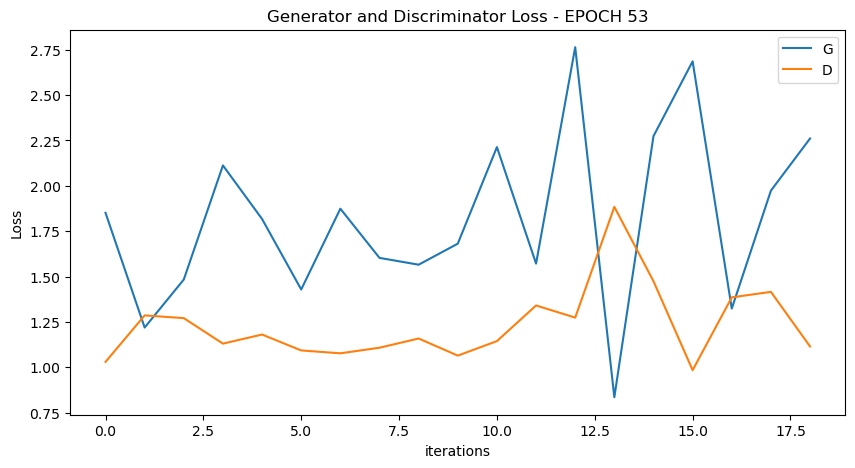

  0%|          | 0/19 [00:00<?, ?it/s]

[55/100][9/19] Loss_D: 1.1250 Loss_G: 1.8982 D(x): 0.6056 D(G(z)): 0.4032 / 0.1460
[55/100][18/19] Loss_D: 1.3601 Loss_G: 1.5242 D(x): 0.4178 D(G(z)): 0.3499 / 0.2328


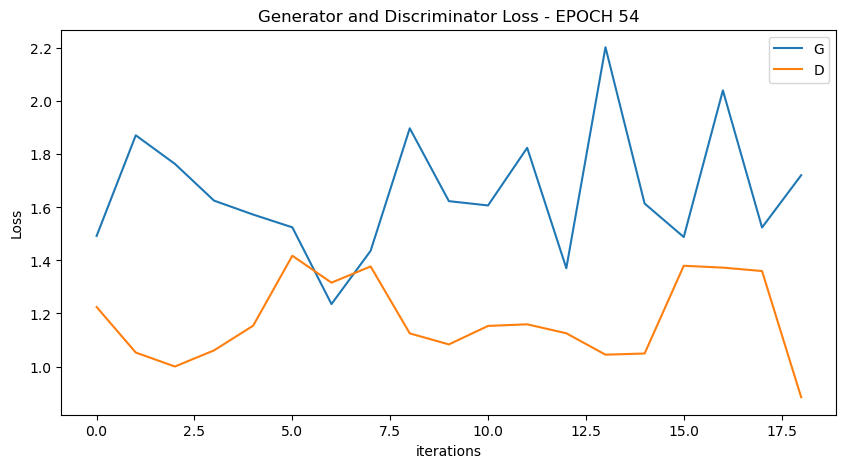

  0%|          | 0/19 [00:00<?, ?it/s]

[56/100][9/19] Loss_D: 1.3816 Loss_G: 3.0318 D(x): 0.6077 D(G(z)): 0.5192 / 0.0397
[56/100][18/19] Loss_D: 1.0094 Loss_G: 2.0023 D(x): 0.5818 D(G(z)): 0.2970 / 0.1270


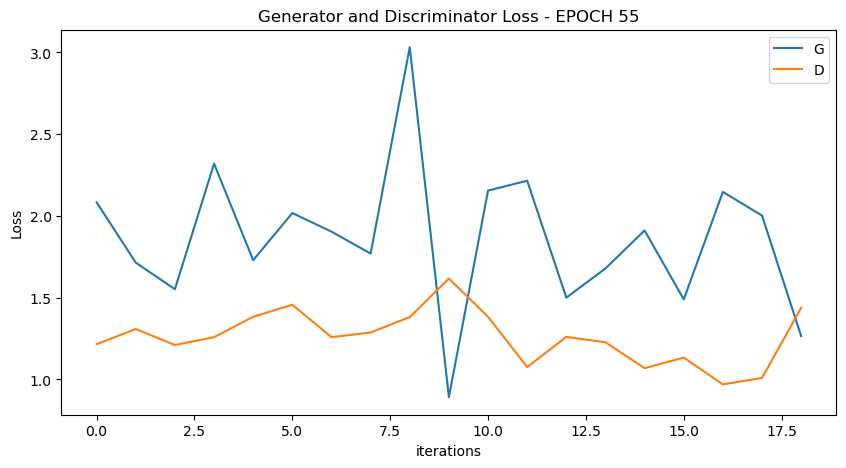

  0%|          | 0/19 [00:00<?, ?it/s]

[57/100][9/19] Loss_D: 1.0354 Loss_G: 2.0197 D(x): 0.4980 D(G(z)): 0.2376 / 0.1230
[57/100][18/19] Loss_D: 1.3138 Loss_G: 1.2529 D(x): 0.4815 D(G(z)): 0.3991 / 0.2767


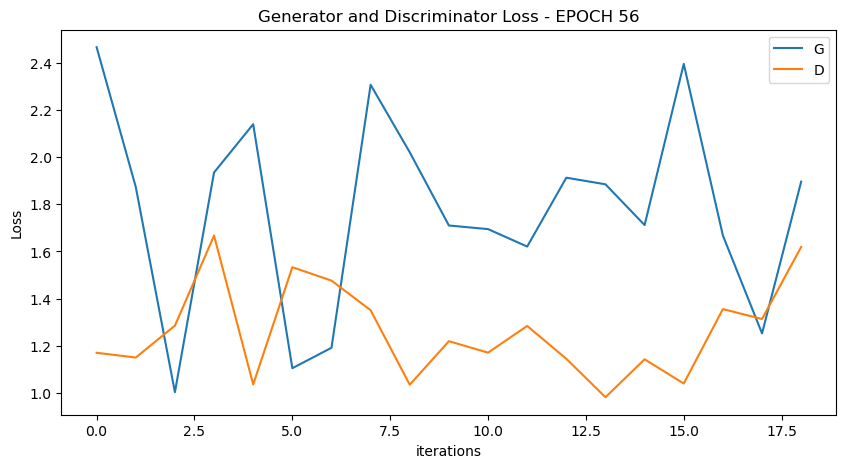

  0%|          | 0/19 [00:00<?, ?it/s]

[58/100][9/19] Loss_D: 1.3442 Loss_G: 1.8426 D(x): 0.5645 D(G(z)): 0.4887 / 0.1532
[58/100][18/19] Loss_D: 1.3996 Loss_G: 1.4082 D(x): 0.4769 D(G(z)): 0.4237 / 0.2364


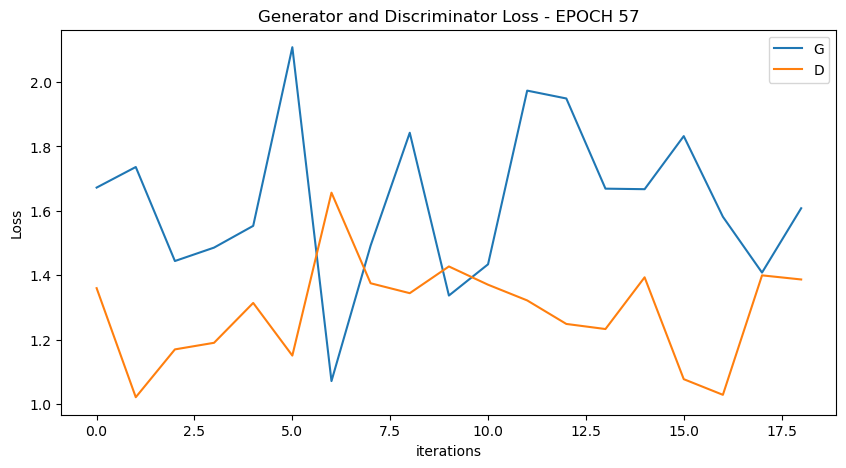

  0%|          | 0/19 [00:00<?, ?it/s]

[59/100][9/19] Loss_D: 0.9361 Loss_G: 2.0055 D(x): 0.5384 D(G(z)): 0.1929 / 0.1377
[59/100][18/19] Loss_D: 1.2899 Loss_G: 1.4327 D(x): 0.4291 D(G(z)): 0.3048 / 0.2227


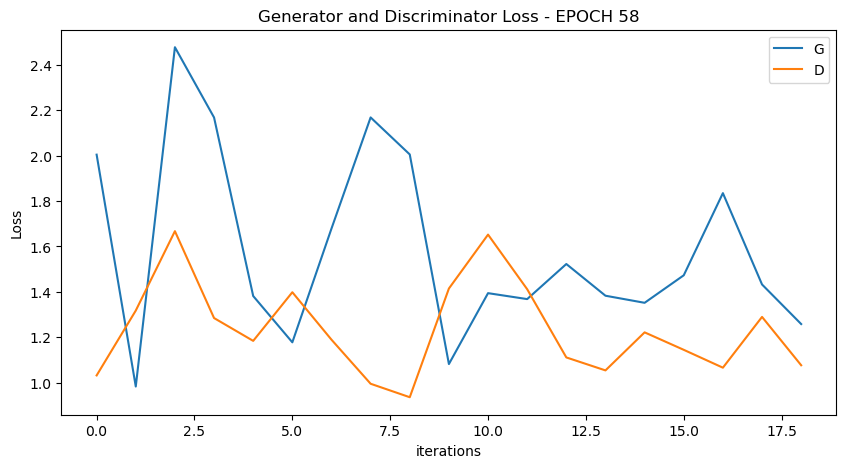

  0%|          | 0/19 [00:00<?, ?it/s]

[60/100][9/19] Loss_D: 1.3682 Loss_G: 1.6865 D(x): 0.5122 D(G(z)): 0.4536 / 0.1849
[60/100][18/19] Loss_D: 1.2654 Loss_G: 1.6127 D(x): 0.5254 D(G(z)): 0.4209 / 0.1833


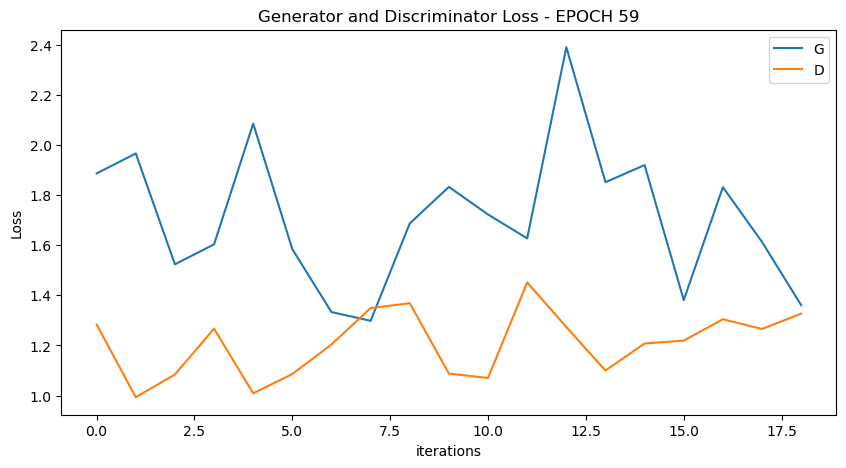

  0%|          | 0/19 [00:00<?, ?it/s]

[61/100][9/19] Loss_D: 1.2316 Loss_G: 1.6667 D(x): 0.4293 D(G(z)): 0.2935 / 0.1742
[61/100][18/19] Loss_D: 1.0581 Loss_G: 2.3644 D(x): 0.3987 D(G(z)): 0.0859 / 0.0829


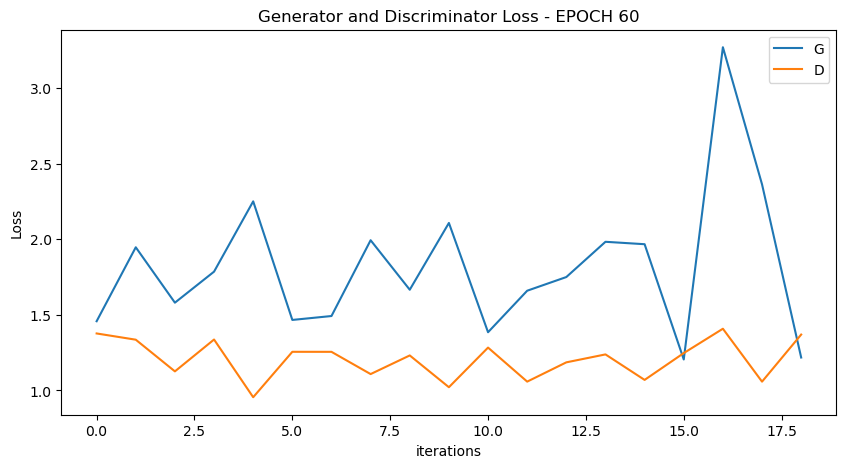

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


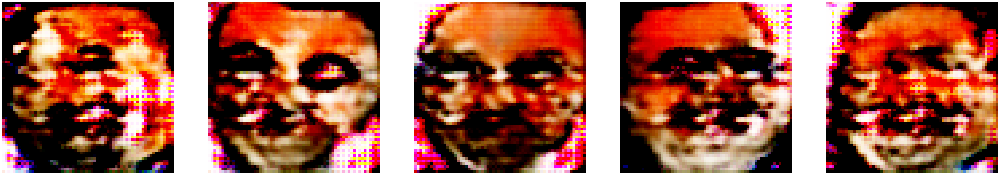

  0%|          | 0/19 [00:00<?, ?it/s]

[62/100][9/19] Loss_D: 1.0948 Loss_G: 2.0065 D(x): 0.5604 D(G(z)): 0.3533 / 0.1216
[62/100][18/19] Loss_D: 1.1071 Loss_G: 2.0295 D(x): 0.6547 D(G(z)): 0.4133 / 0.1290


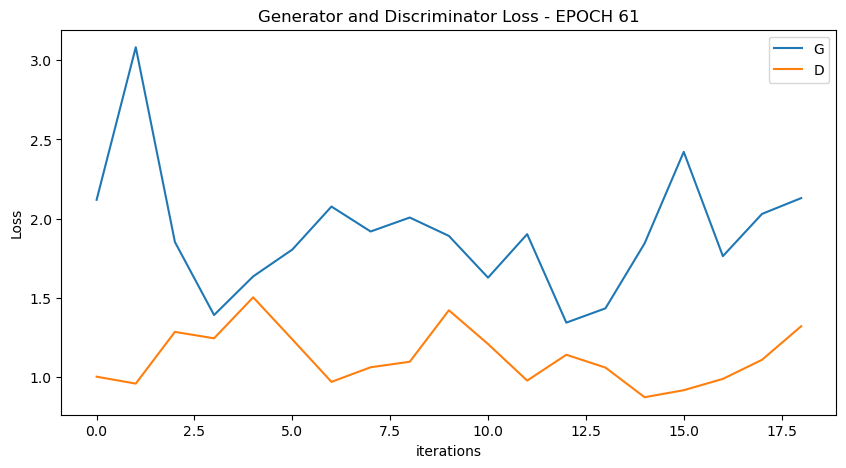

  0%|          | 0/19 [00:00<?, ?it/s]

[63/100][9/19] Loss_D: 1.2156 Loss_G: 1.8622 D(x): 0.5757 D(G(z)): 0.4289 / 0.1449
[63/100][18/19] Loss_D: 1.1563 Loss_G: 1.9892 D(x): 0.5264 D(G(z)): 0.3420 / 0.1339


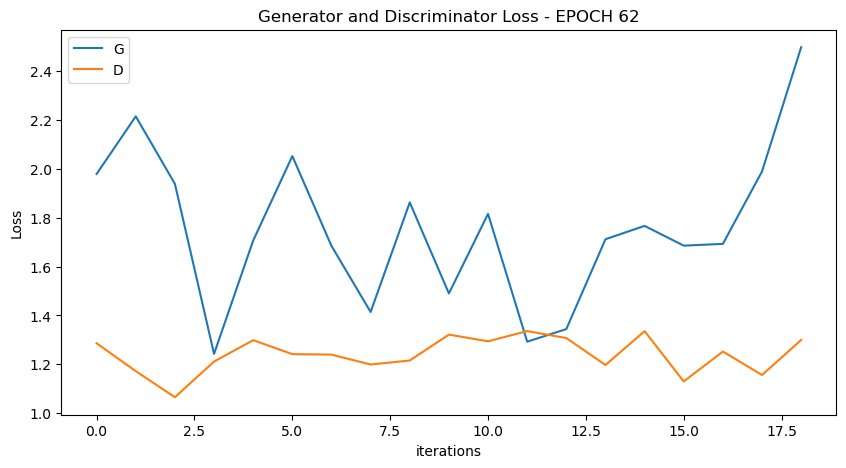

  0%|          | 0/19 [00:00<?, ?it/s]

[64/100][9/19] Loss_D: 1.1042 Loss_G: 1.9123 D(x): 0.5514 D(G(z)): 0.3531 / 0.1351
[64/100][18/19] Loss_D: 1.4414 Loss_G: 1.6567 D(x): 0.4114 D(G(z)): 0.3961 / 0.1790


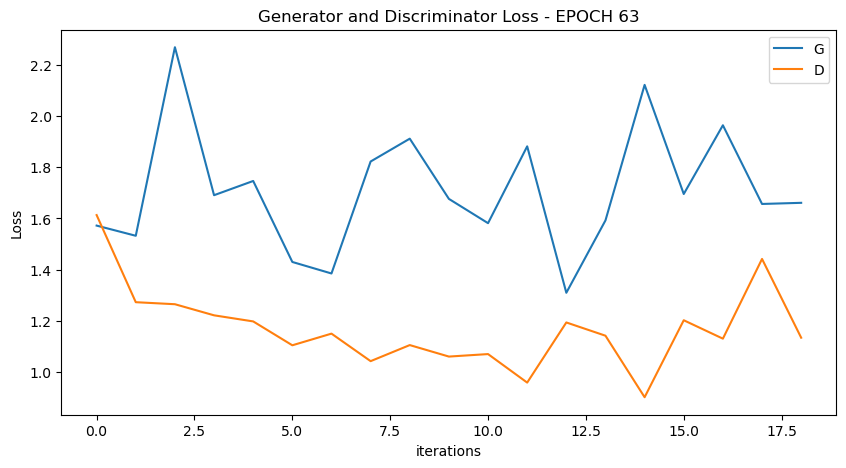

  0%|          | 0/19 [00:00<?, ?it/s]

[65/100][9/19] Loss_D: 1.2875 Loss_G: 1.7903 D(x): 0.4391 D(G(z)): 0.3299 / 0.1606
[65/100][18/19] Loss_D: 1.3900 Loss_G: 1.6447 D(x): 0.4539 D(G(z)): 0.4151 / 0.1728


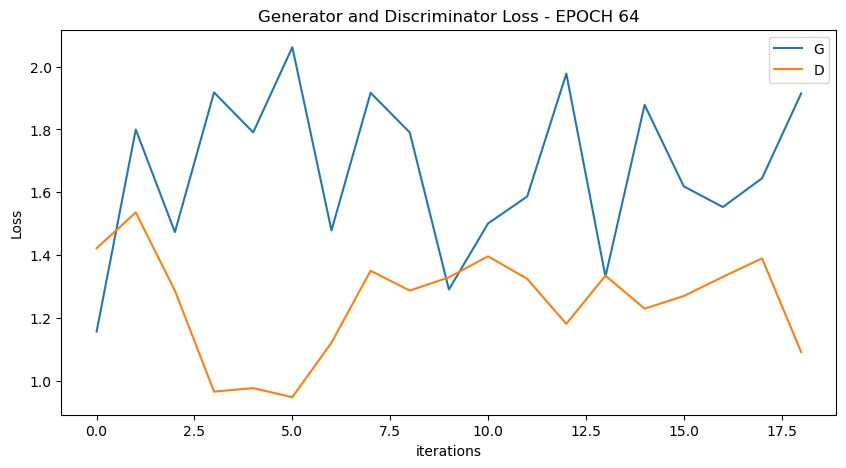

  0%|          | 0/19 [00:00<?, ?it/s]

[66/100][9/19] Loss_D: 1.4167 Loss_G: 1.6475 D(x): 0.5404 D(G(z)): 0.4844 / 0.1831
[66/100][18/19] Loss_D: 1.1027 Loss_G: 1.6204 D(x): 0.5745 D(G(z)): 0.3662 / 0.1779


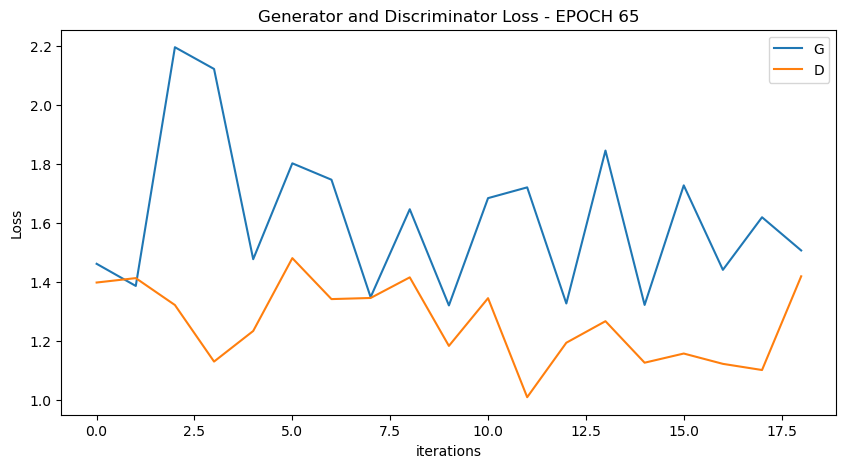

  0%|          | 0/19 [00:00<?, ?it/s]

[67/100][9/19] Loss_D: 1.3699 Loss_G: 1.5596 D(x): 0.5306 D(G(z)): 0.4655 / 0.2040
[67/100][18/19] Loss_D: 1.2895 Loss_G: 1.6783 D(x): 0.5075 D(G(z)): 0.4136 / 0.1864


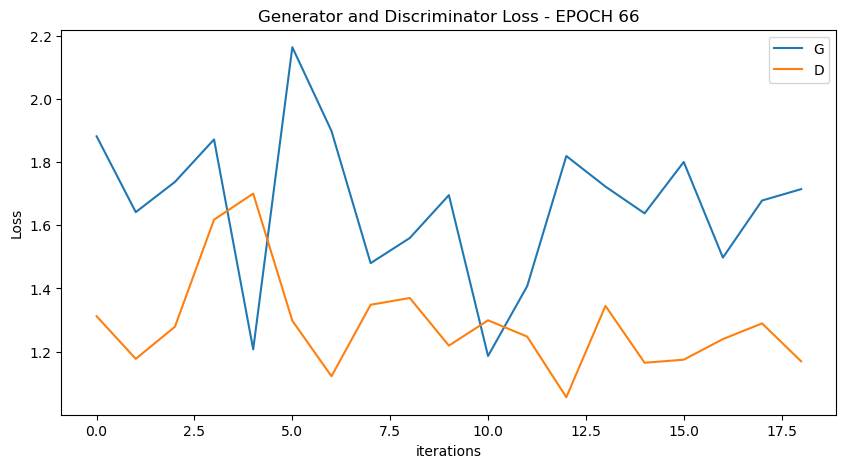

  0%|          | 0/19 [00:00<?, ?it/s]

[68/100][9/19] Loss_D: 1.4184 Loss_G: 1.6057 D(x): 0.3857 D(G(z)): 0.3295 / 0.1829
[68/100][18/19] Loss_D: 1.2253 Loss_G: 1.9166 D(x): 0.5503 D(G(z)): 0.3996 / 0.1467


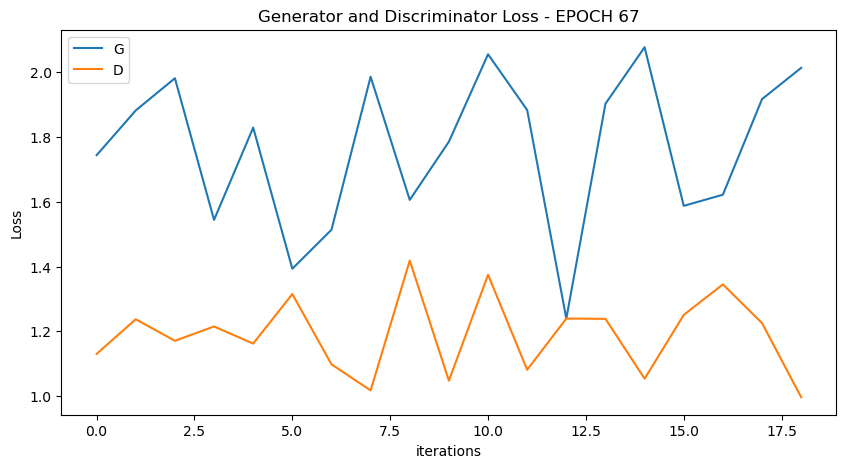

  0%|          | 0/19 [00:00<?, ?it/s]

[69/100][9/19] Loss_D: 1.2796 Loss_G: 1.9825 D(x): 0.4276 D(G(z)): 0.3086 / 0.1327
[69/100][18/19] Loss_D: 1.6258 Loss_G: 2.0033 D(x): 0.5003 D(G(z)): 0.5100 / 0.1341


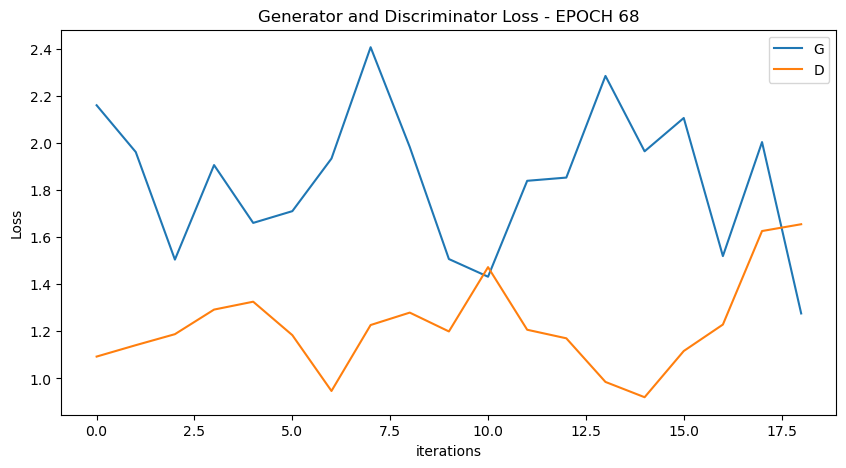

  0%|          | 0/19 [00:00<?, ?it/s]

[70/100][9/19] Loss_D: 1.2713 Loss_G: 1.7610 D(x): 0.6410 D(G(z)): 0.4956 / 0.1665
[70/100][18/19] Loss_D: 1.1564 Loss_G: 1.3929 D(x): 0.4367 D(G(z)): 0.2343 / 0.2612


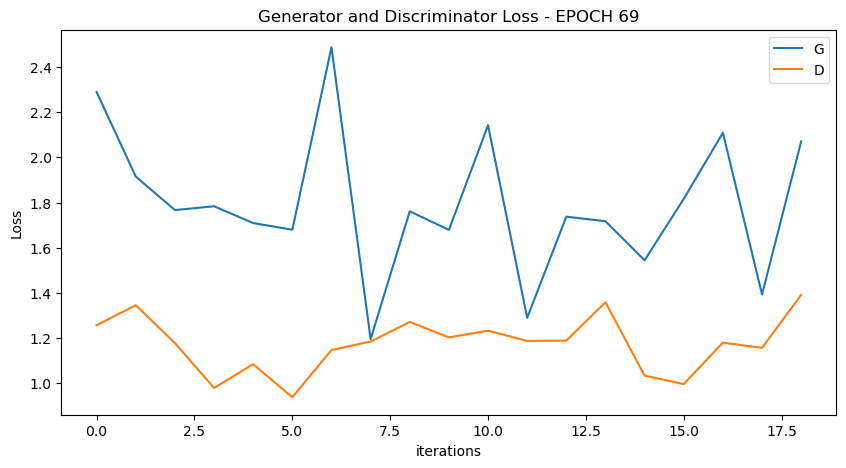

  0%|          | 0/19 [00:00<?, ?it/s]

[71/100][9/19] Loss_D: 1.3508 Loss_G: 2.0096 D(x): 0.5578 D(G(z)): 0.4831 / 0.1354
[71/100][18/19] Loss_D: 1.2655 Loss_G: 2.1402 D(x): 0.6297 D(G(z)): 0.4881 / 0.1144


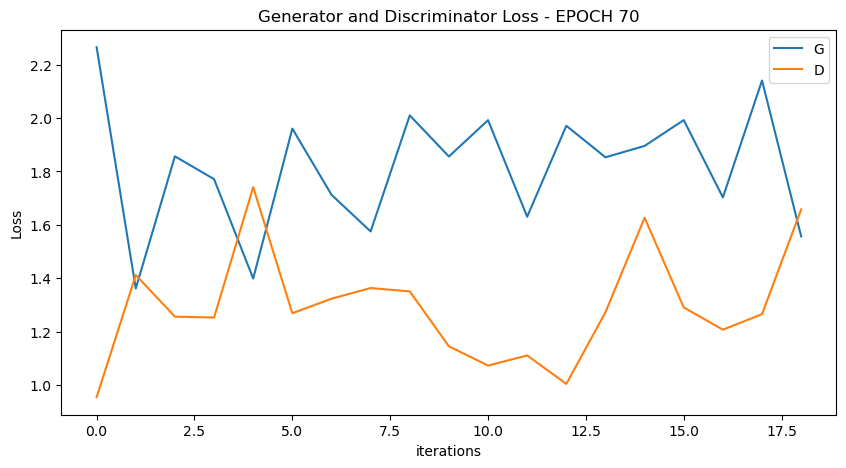

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


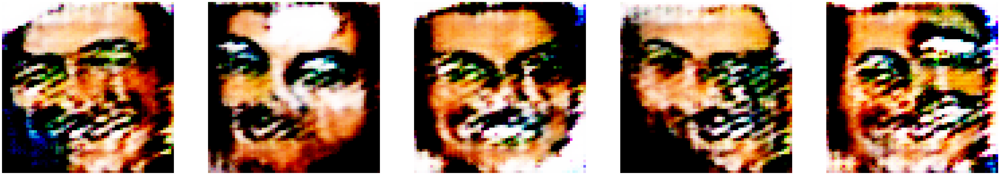

  0%|          | 0/19 [00:00<?, ?it/s]

[72/100][9/19] Loss_D: 1.5191 Loss_G: 1.2522 D(x): 0.3665 D(G(z)): 0.3830 / 0.2839
[72/100][18/19] Loss_D: 1.3213 Loss_G: 1.3514 D(x): 0.4476 D(G(z)): 0.3474 / 0.2523


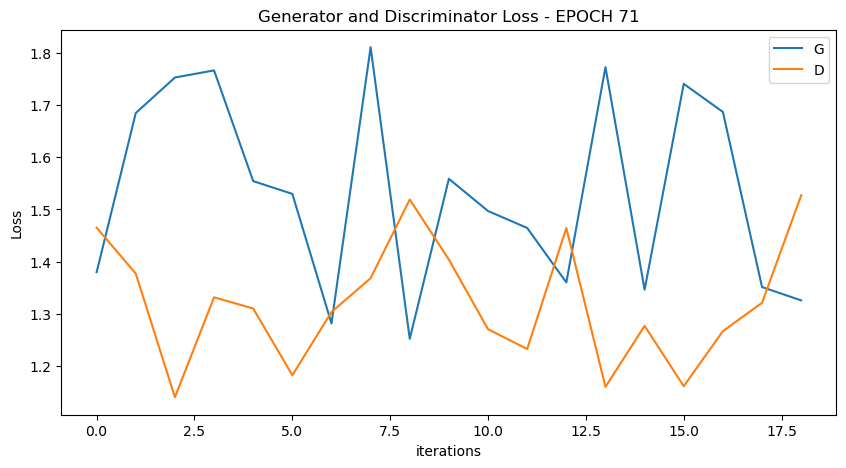

  0%|          | 0/19 [00:00<?, ?it/s]

[73/100][9/19] Loss_D: 1.1668 Loss_G: 1.5844 D(x): 0.4480 D(G(z)): 0.2697 / 0.1947
[73/100][18/19] Loss_D: 1.0967 Loss_G: 1.7969 D(x): 0.6076 D(G(z)): 0.3896 / 0.1477


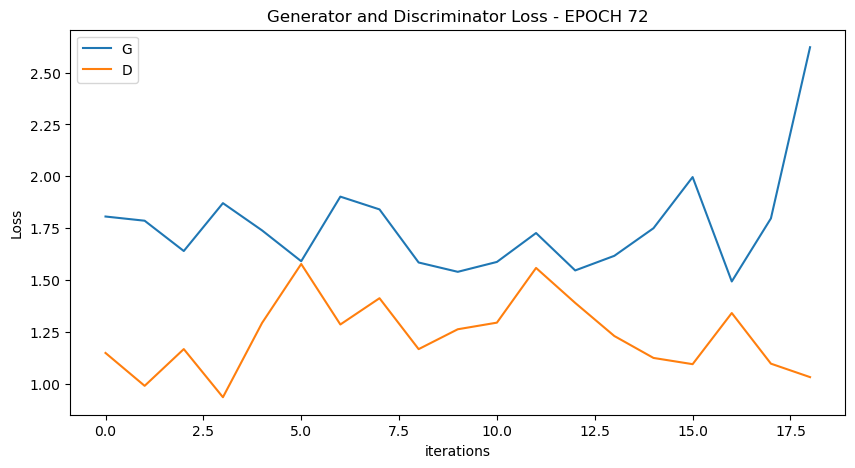

  0%|          | 0/19 [00:00<?, ?it/s]

[74/100][9/19] Loss_D: 1.3385 Loss_G: 1.6249 D(x): 0.4531 D(G(z)): 0.3668 / 0.2005
[74/100][18/19] Loss_D: 1.1378 Loss_G: 2.0868 D(x): 0.6624 D(G(z)): 0.4436 / 0.1172


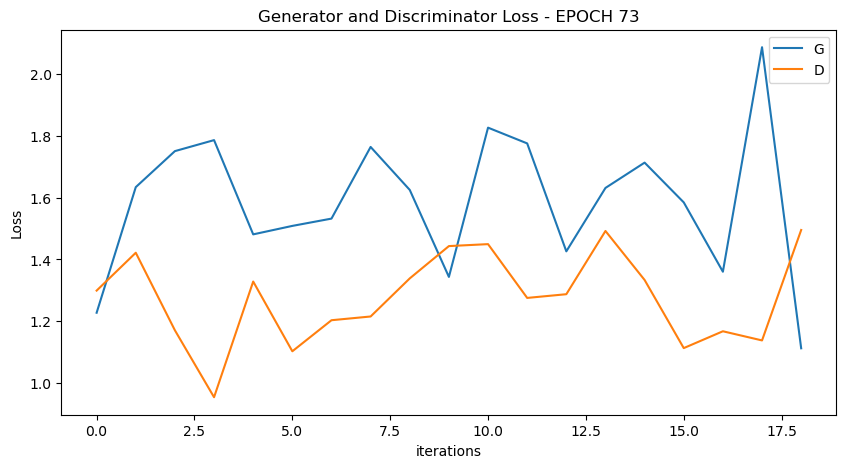

  0%|          | 0/19 [00:00<?, ?it/s]

[75/100][9/19] Loss_D: 1.2153 Loss_G: 1.7552 D(x): 0.5010 D(G(z)): 0.3660 / 0.1556
[75/100][18/19] Loss_D: 1.1895 Loss_G: 1.8583 D(x): 0.6544 D(G(z)): 0.4603 / 0.1441


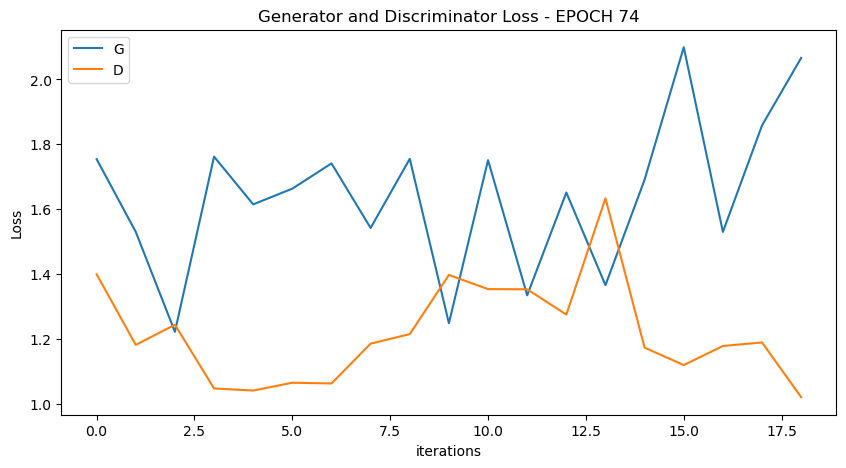

  0%|          | 0/19 [00:00<?, ?it/s]

[76/100][9/19] Loss_D: 1.3015 Loss_G: 1.4513 D(x): 0.4676 D(G(z)): 0.3548 / 0.2197
[76/100][18/19] Loss_D: 1.2287 Loss_G: 1.8976 D(x): 0.4904 D(G(z)): 0.3470 / 0.1373


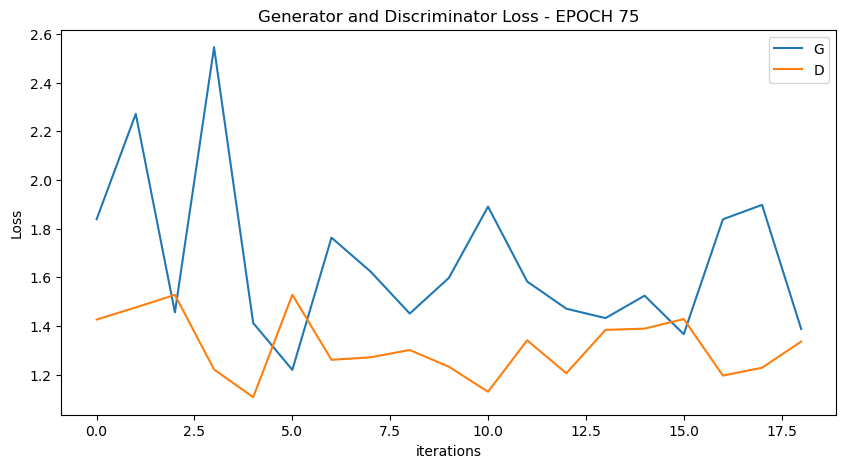

  0%|          | 0/19 [00:00<?, ?it/s]

[77/100][9/19] Loss_D: 1.1408 Loss_G: 2.0211 D(x): 0.5732 D(G(z)): 0.3677 / 0.1244
[77/100][18/19] Loss_D: 1.1164 Loss_G: 1.6488 D(x): 0.5589 D(G(z)): 0.3490 / 0.1902


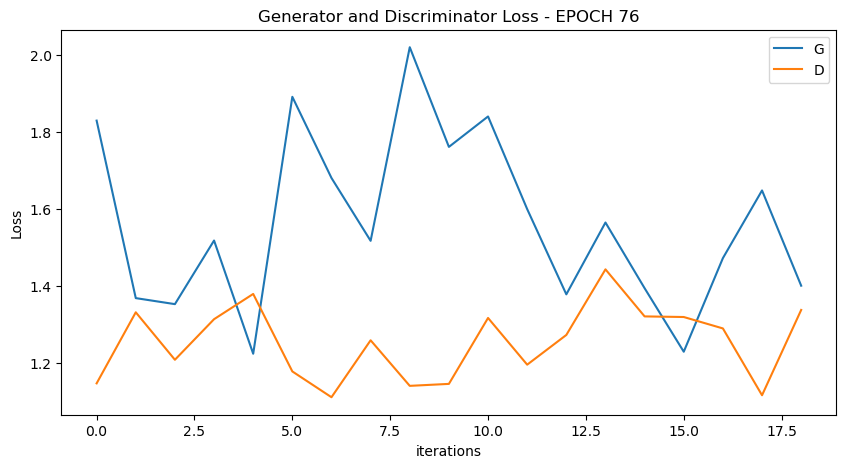

  0%|          | 0/19 [00:00<?, ?it/s]

[78/100][9/19] Loss_D: 1.1384 Loss_G: 1.7679 D(x): 0.4722 D(G(z)): 0.2749 / 0.1631
[78/100][18/19] Loss_D: 1.1523 Loss_G: 1.5284 D(x): 0.4356 D(G(z)): 0.2546 / 0.2056


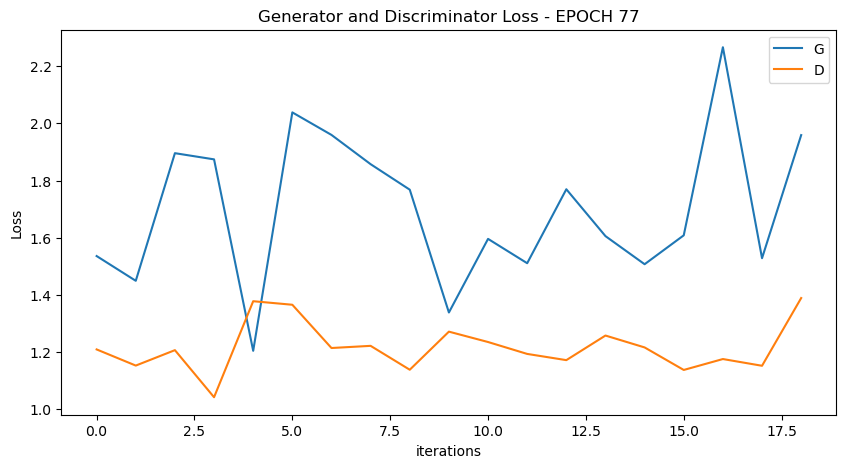

  0%|          | 0/19 [00:00<?, ?it/s]

[79/100][9/19] Loss_D: 1.3336 Loss_G: 1.4273 D(x): 0.4535 D(G(z)): 0.2914 / 0.2338
[79/100][18/19] Loss_D: 1.1571 Loss_G: 2.1211 D(x): 0.5385 D(G(z)): 0.3737 / 0.1039


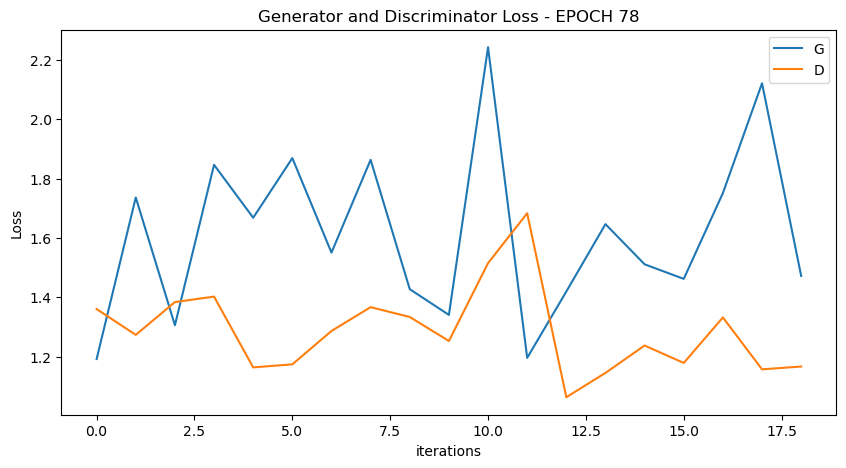

  0%|          | 0/19 [00:00<?, ?it/s]

[80/100][9/19] Loss_D: 1.0470 Loss_G: 2.0072 D(x): 0.6421 D(G(z)): 0.3951 / 0.1183
[80/100][18/19] Loss_D: 1.3429 Loss_G: 1.9539 D(x): 0.5757 D(G(z)): 0.4845 / 0.1361


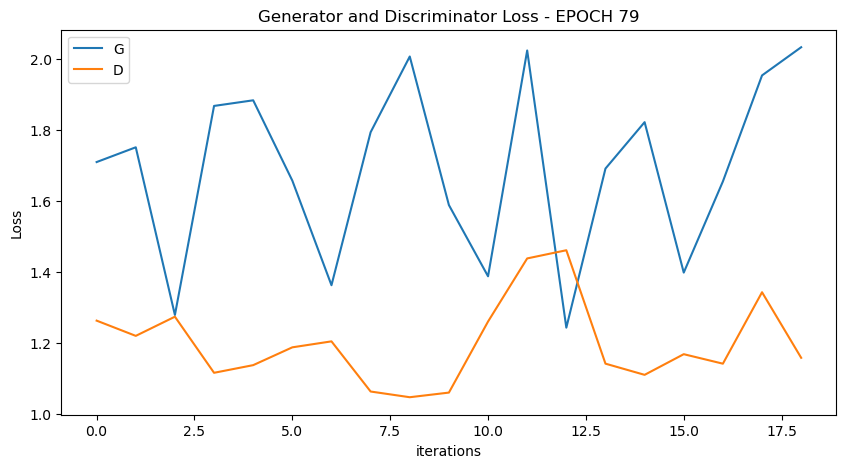

  0%|          | 0/19 [00:00<?, ?it/s]

[81/100][9/19] Loss_D: 1.4613 Loss_G: 1.5974 D(x): 0.7094 D(G(z)): 0.5837 / 0.1913
[81/100][18/19] Loss_D: 1.1629 Loss_G: 2.4487 D(x): 0.6752 D(G(z)): 0.4624 / 0.0752


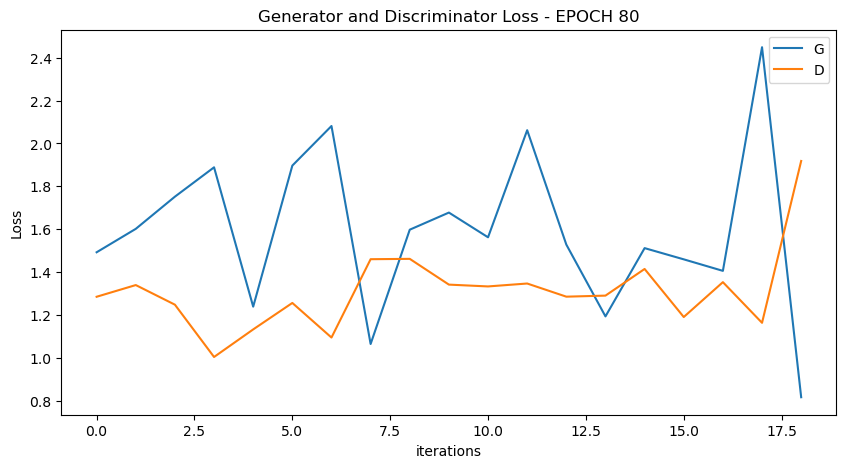

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


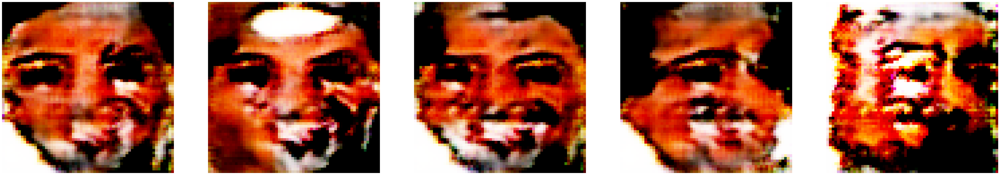

  0%|          | 0/19 [00:00<?, ?it/s]

[82/100][9/19] Loss_D: 1.2136 Loss_G: 1.9317 D(x): 0.5926 D(G(z)): 0.4373 / 0.1335
[82/100][18/19] Loss_D: 1.4667 Loss_G: 1.5985 D(x): 0.4512 D(G(z)): 0.4593 / 0.1827


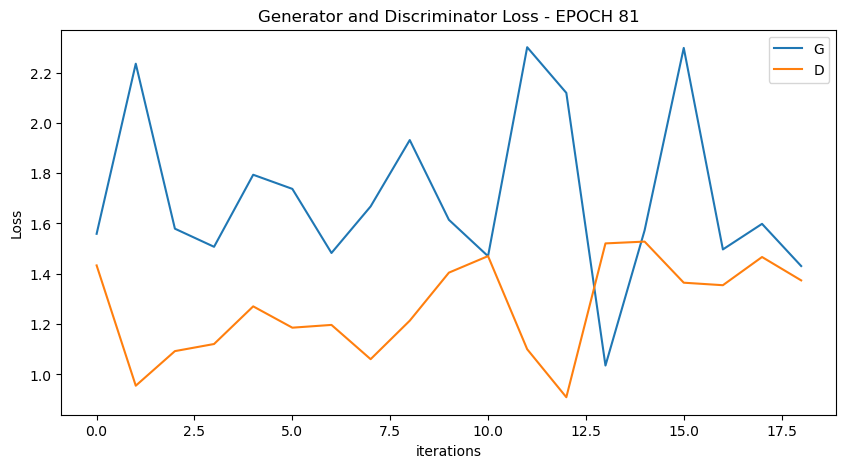

  0%|          | 0/19 [00:00<?, ?it/s]

[83/100][9/19] Loss_D: 1.4034 Loss_G: 1.2673 D(x): 0.4404 D(G(z)): 0.3840 / 0.2820
[83/100][18/19] Loss_D: 1.1409 Loss_G: 1.4135 D(x): 0.5329 D(G(z)): 0.3432 / 0.2351


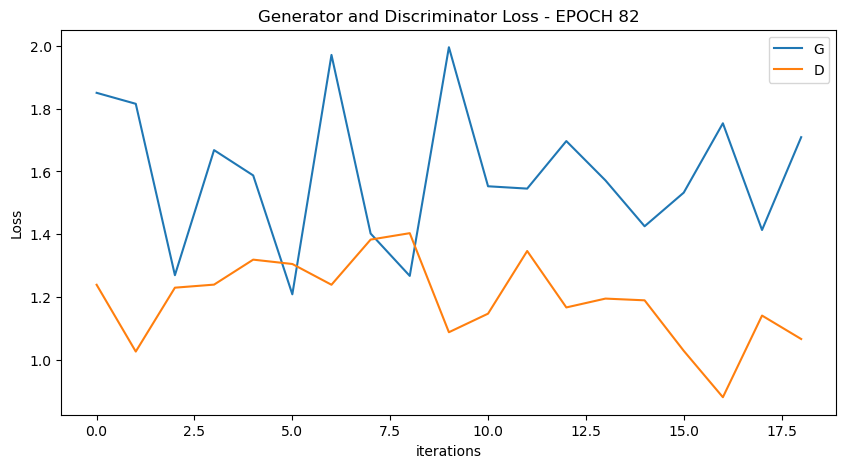

  0%|          | 0/19 [00:00<?, ?it/s]

[84/100][9/19] Loss_D: 1.1843 Loss_G: 1.3851 D(x): 0.4471 D(G(z)): 0.2867 / 0.2385
[84/100][18/19] Loss_D: 1.3214 Loss_G: 1.5924 D(x): 0.4409 D(G(z)): 0.3549 / 0.1913


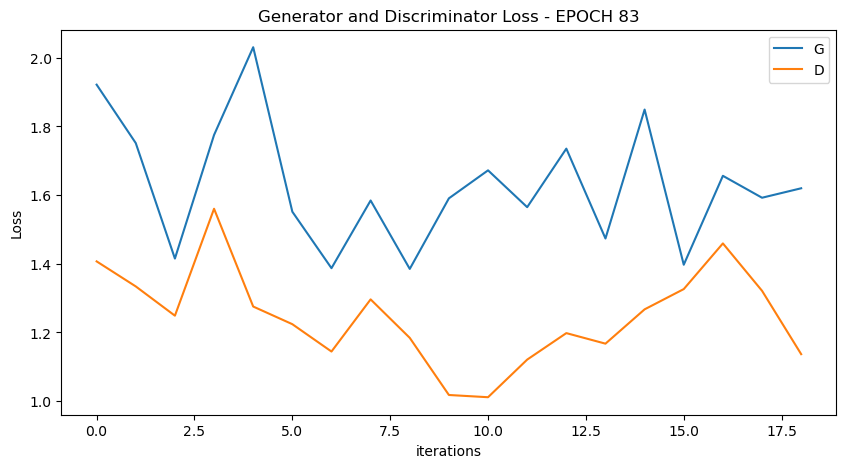

  0%|          | 0/19 [00:00<?, ?it/s]

[85/100][9/19] Loss_D: 1.0921 Loss_G: 1.5158 D(x): 0.5038 D(G(z)): 0.2889 / 0.2214
[85/100][18/19] Loss_D: 1.2031 Loss_G: 1.8547 D(x): 0.5597 D(G(z)): 0.4133 / 0.1465


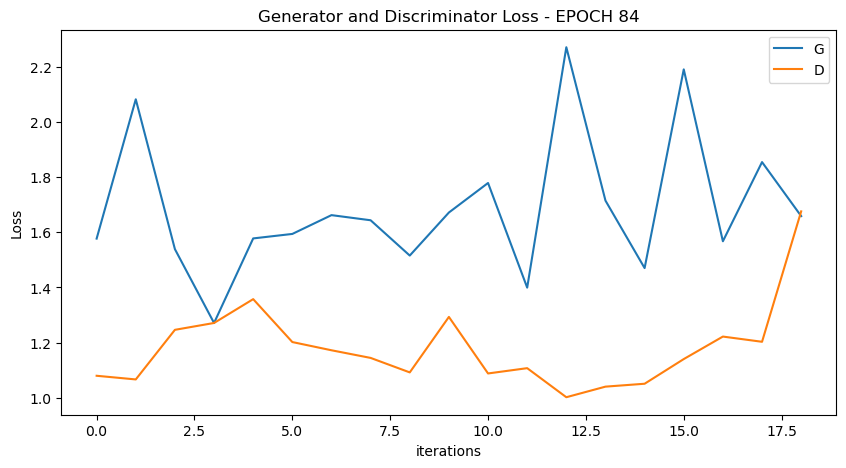

  0%|          | 0/19 [00:00<?, ?it/s]

[86/100][9/19] Loss_D: 1.3083 Loss_G: 2.1402 D(x): 0.6192 D(G(z)): 0.5020 / 0.1143
[86/100][18/19] Loss_D: 1.3814 Loss_G: 1.6359 D(x): 0.6038 D(G(z)): 0.4803 / 0.1839


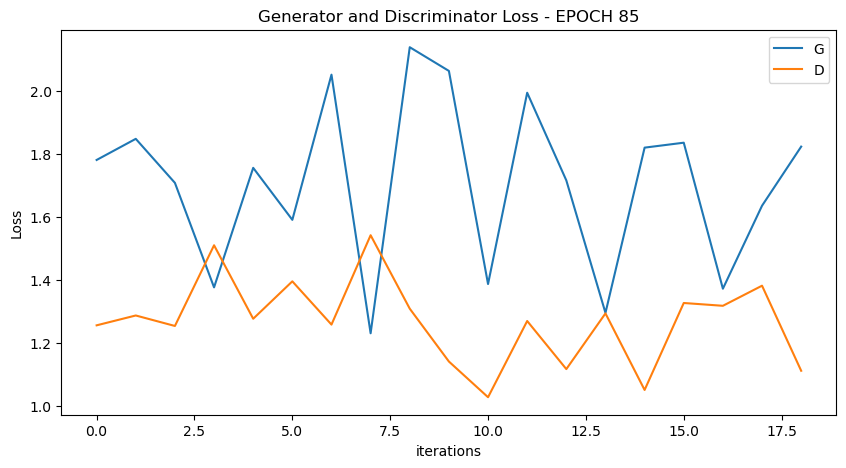

  0%|          | 0/19 [00:00<?, ?it/s]

[87/100][9/19] Loss_D: 0.9606 Loss_G: 1.8022 D(x): 0.5533 D(G(z)): 0.2360 / 0.1479
[87/100][18/19] Loss_D: 1.1575 Loss_G: 1.5563 D(x): 0.5162 D(G(z)): 0.3297 / 0.1996


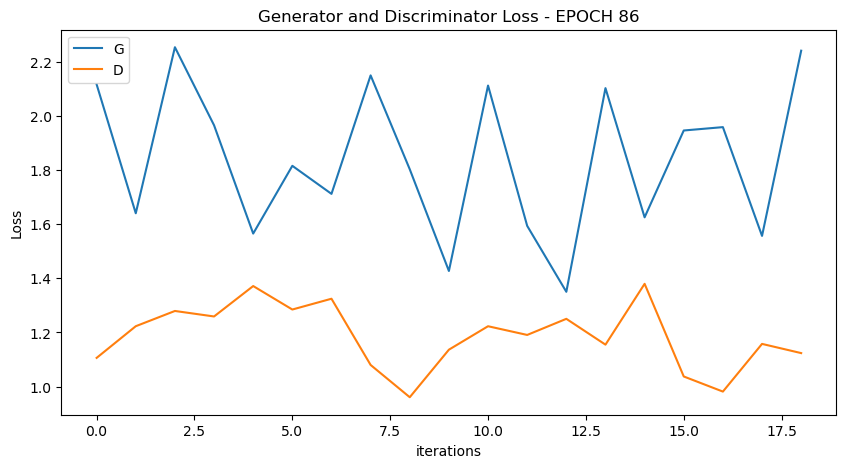

  0%|          | 0/19 [00:00<?, ?it/s]

[88/100][9/19] Loss_D: 1.0816 Loss_G: 1.3934 D(x): 0.5068 D(G(z)): 0.2843 / 0.2334
[88/100][18/19] Loss_D: 0.9745 Loss_G: 1.8108 D(x): 0.6082 D(G(z)): 0.3174 / 0.1506


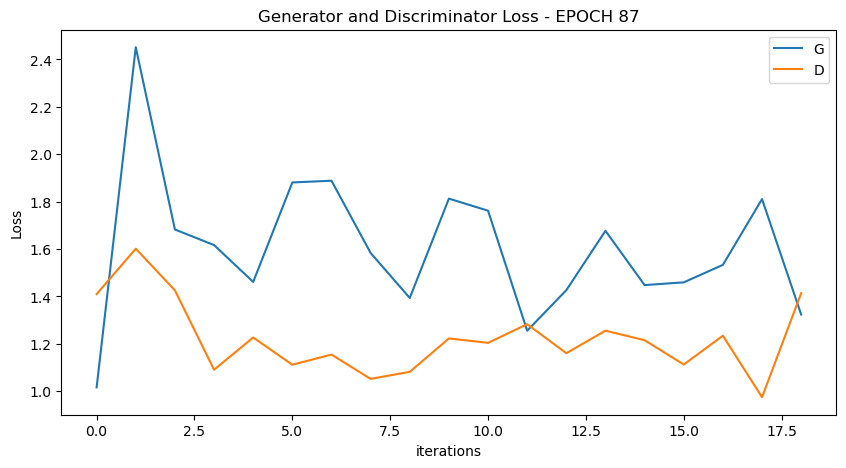

  0%|          | 0/19 [00:00<?, ?it/s]

[89/100][9/19] Loss_D: 1.1750 Loss_G: 1.7526 D(x): 0.4397 D(G(z)): 0.2505 / 0.1679
[89/100][18/19] Loss_D: 1.1997 Loss_G: 1.9296 D(x): 0.6346 D(G(z)): 0.4482 / 0.1460


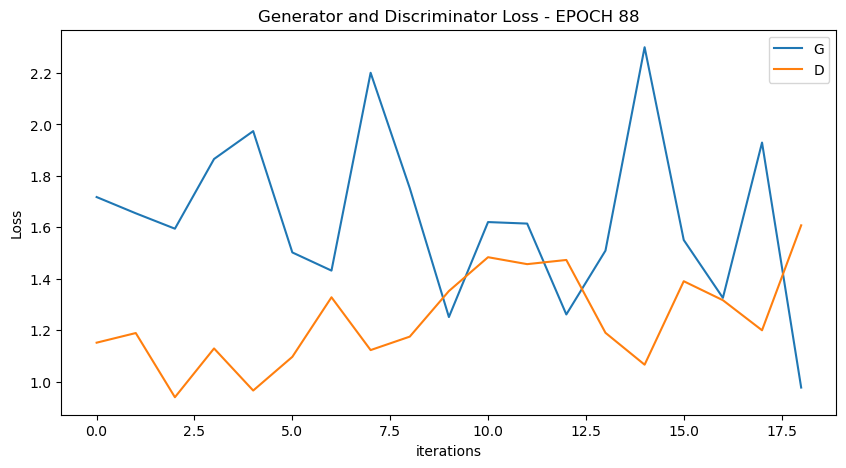

  0%|          | 0/19 [00:00<?, ?it/s]

[90/100][9/19] Loss_D: 1.4016 Loss_G: 1.7417 D(x): 0.5468 D(G(z)): 0.5021 / 0.1669
[90/100][18/19] Loss_D: 1.2688 Loss_G: 1.5118 D(x): 0.4265 D(G(z)): 0.2695 / 0.2055


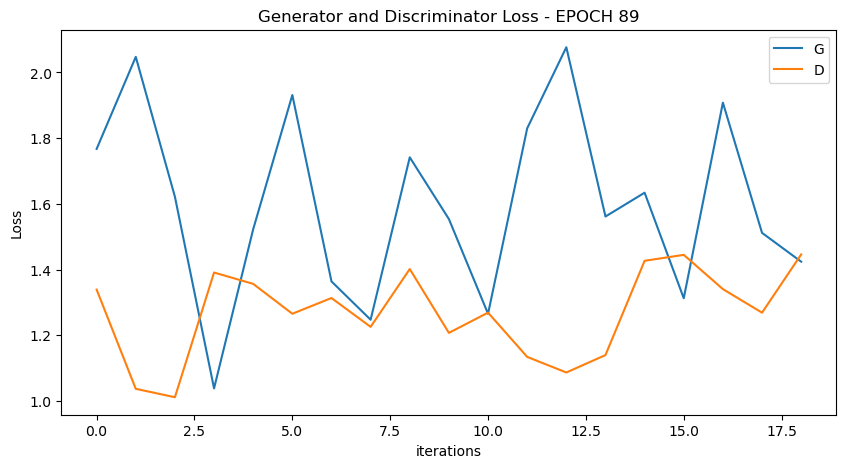

  0%|          | 0/19 [00:00<?, ?it/s]

[91/100][9/19] Loss_D: 1.1396 Loss_G: 1.4322 D(x): 0.4866 D(G(z)): 0.3036 / 0.2230
[91/100][18/19] Loss_D: 1.1422 Loss_G: 1.6051 D(x): 0.5183 D(G(z)): 0.3344 / 0.1981


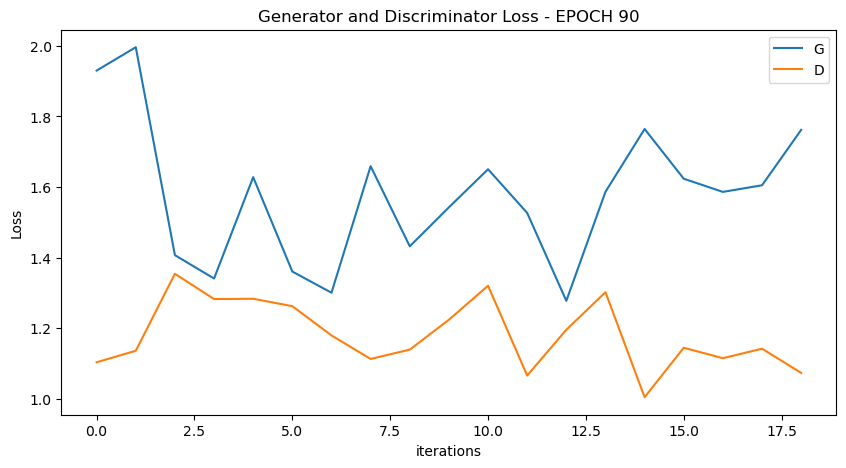

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


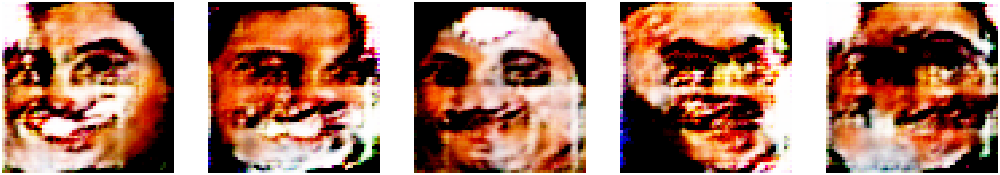

  0%|          | 0/19 [00:00<?, ?it/s]

[92/100][9/19] Loss_D: 1.3871 Loss_G: 1.7145 D(x): 0.5952 D(G(z)): 0.5253 / 0.1723
[92/100][18/19] Loss_D: 1.2217 Loss_G: 1.8117 D(x): 0.5424 D(G(z)): 0.3922 / 0.1555


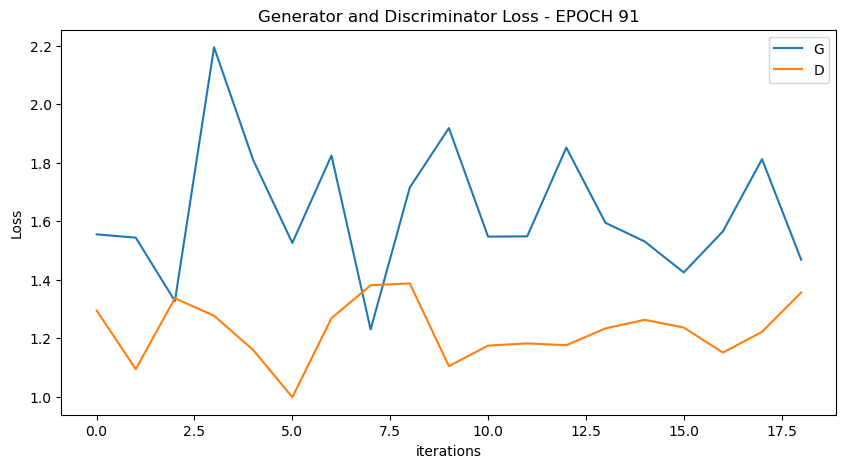

  0%|          | 0/19 [00:00<?, ?it/s]

[93/100][9/19] Loss_D: 1.3388 Loss_G: 1.6686 D(x): 0.4970 D(G(z)): 0.4236 / 0.1760
[93/100][18/19] Loss_D: 0.9826 Loss_G: 1.8243 D(x): 0.5915 D(G(z)): 0.2996 / 0.1495


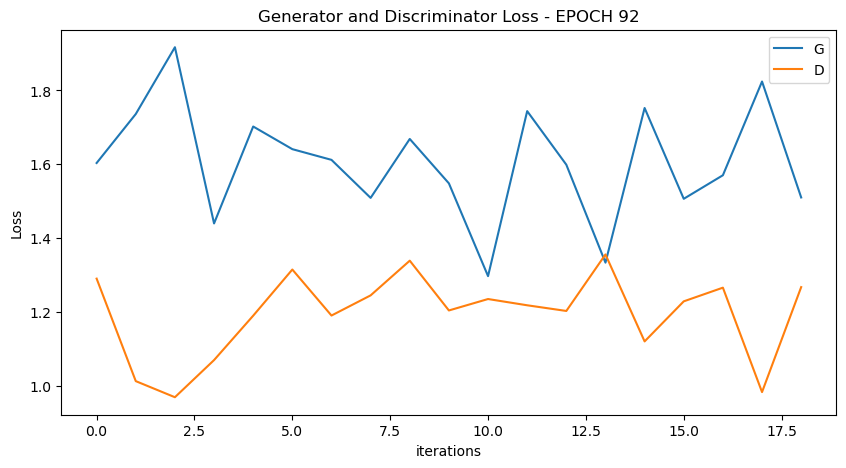

  0%|          | 0/19 [00:00<?, ?it/s]

[94/100][9/19] Loss_D: 1.0693 Loss_G: 1.6745 D(x): 0.5106 D(G(z)): 0.2820 / 0.1762
[94/100][18/19] Loss_D: 1.2625 Loss_G: 1.6144 D(x): 0.4519 D(G(z)): 0.3376 / 0.1831


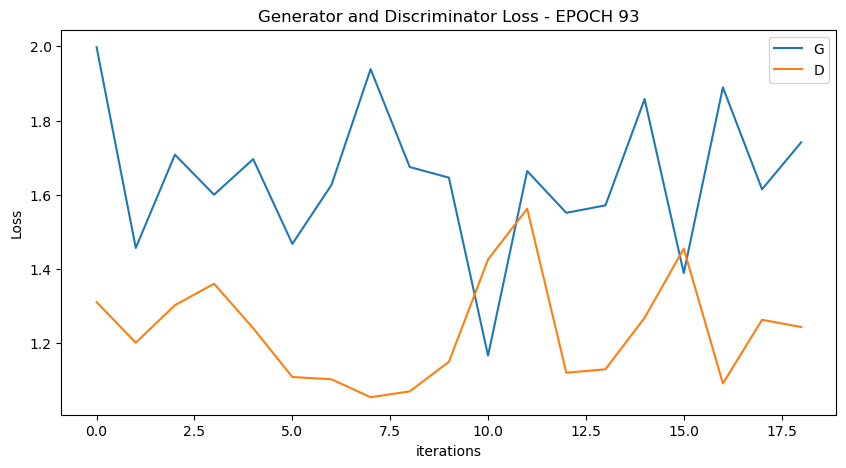

  0%|          | 0/19 [00:00<?, ?it/s]

[95/100][9/19] Loss_D: 0.9323 Loss_G: 2.2531 D(x): 0.6345 D(G(z)): 0.2931 / 0.1008
[95/100][18/19] Loss_D: 0.9814 Loss_G: 2.0012 D(x): 0.5782 D(G(z)): 0.2782 / 0.1218


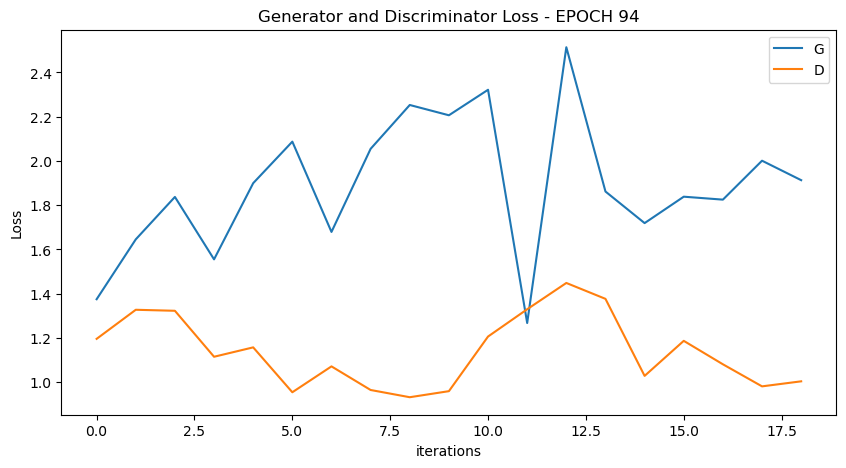

  0%|          | 0/19 [00:00<?, ?it/s]

[96/100][9/19] Loss_D: 1.2337 Loss_G: 1.8538 D(x): 0.6529 D(G(z)): 0.4904 / 0.1476
[96/100][18/19] Loss_D: 1.1260 Loss_G: 1.7071 D(x): 0.5834 D(G(z)): 0.3900 / 0.1734


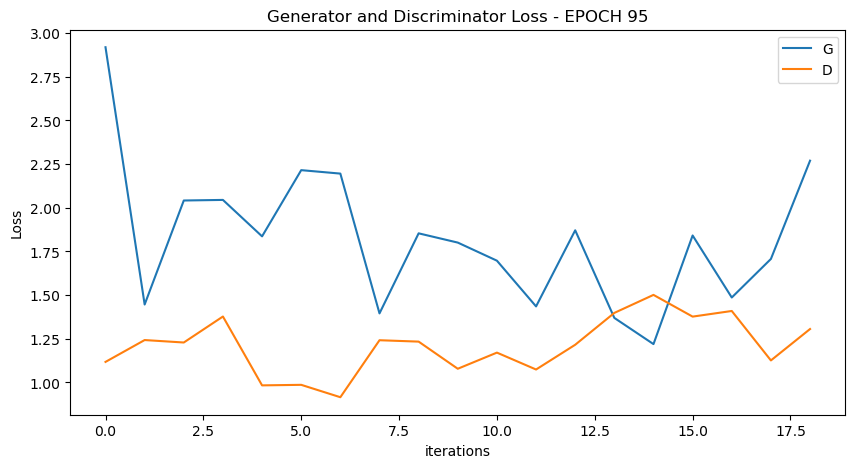

  0%|          | 0/19 [00:00<?, ?it/s]

[97/100][9/19] Loss_D: 1.1620 Loss_G: 1.4253 D(x): 0.6499 D(G(z)): 0.4417 / 0.2323
[97/100][18/19] Loss_D: 1.1501 Loss_G: 1.9126 D(x): 0.4816 D(G(z)): 0.2737 / 0.1398


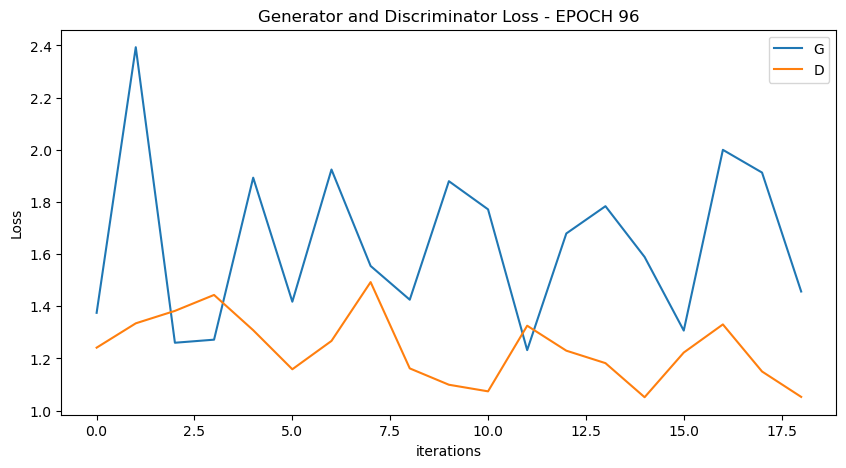

  0%|          | 0/19 [00:00<?, ?it/s]

[98/100][9/19] Loss_D: 1.0294 Loss_G: 1.6629 D(x): 0.6113 D(G(z)): 0.3437 / 0.1810
[98/100][18/19] Loss_D: 1.0697 Loss_G: 2.6137 D(x): 0.6084 D(G(z)): 0.3523 / 0.0695


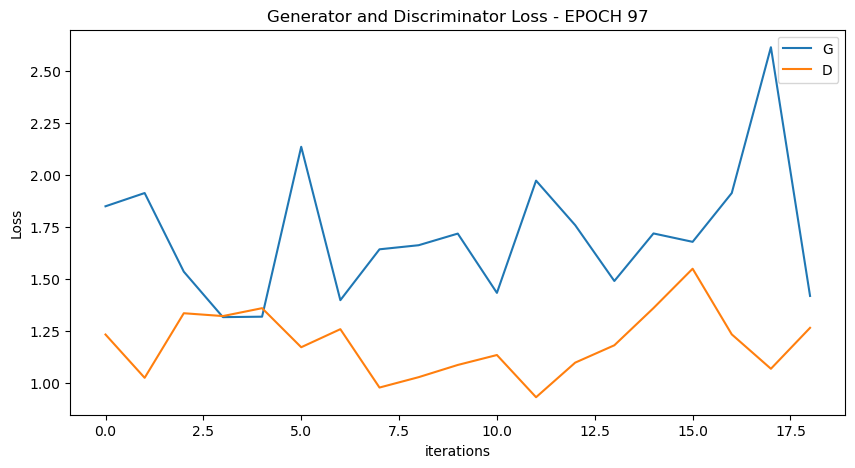

  0%|          | 0/19 [00:00<?, ?it/s]

[99/100][9/19] Loss_D: 1.4783 Loss_G: 2.1624 D(x): 0.6873 D(G(z)): 0.5784 / 0.1085
[99/100][18/19] Loss_D: 1.2472 Loss_G: 2.0381 D(x): 0.4880 D(G(z)): 0.3672 / 0.1249


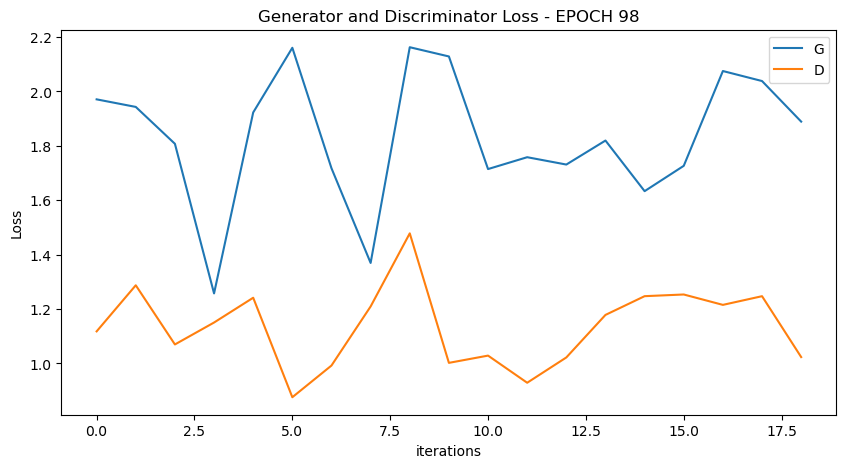

  0%|          | 0/19 [00:00<?, ?it/s]

[100/100][9/19] Loss_D: 1.3050 Loss_G: 1.8159 D(x): 0.4993 D(G(z)): 0.3914 / 0.1498
[100/100][18/19] Loss_D: 1.1343 Loss_G: 1.7200 D(x): 0.5213 D(G(z)): 0.3306 / 0.1674


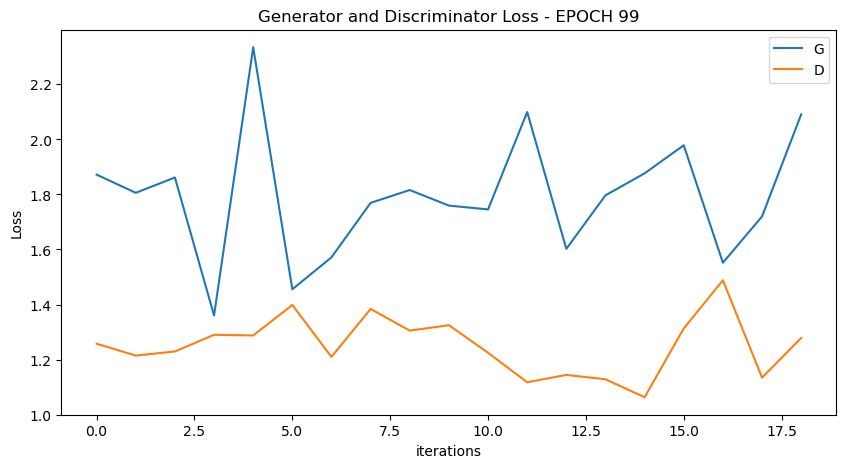

  0%|          | 0/2 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


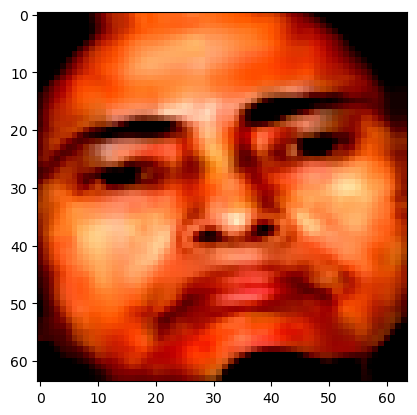

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


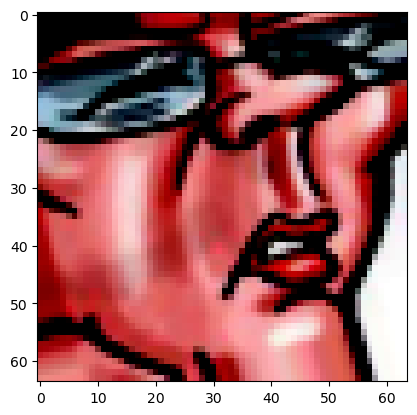

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


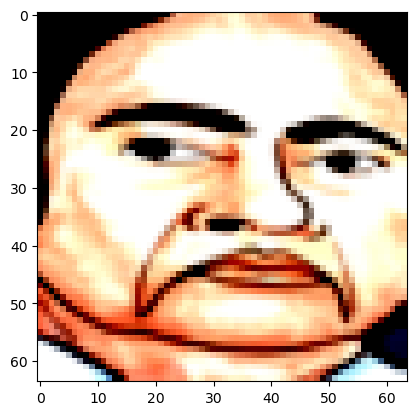

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


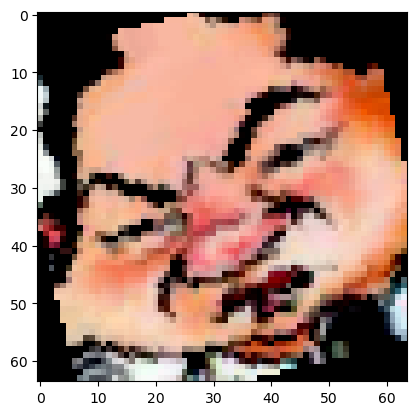

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


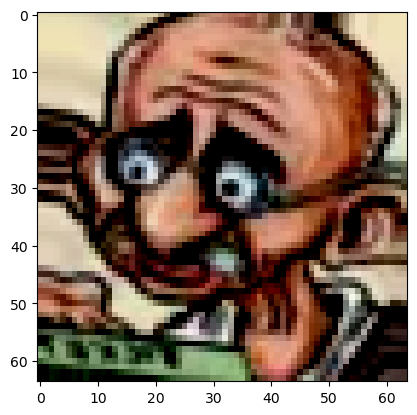

  0%|          | 0/19 [00:00<?, ?it/s]

[1/100][9/19] Loss_D: 0.5172 Loss_G: 5.2443 D(x): 0.7757 D(G(z)): 0.0641 / 0.0030
[1/100][18/19] Loss_D: 0.4609 Loss_G: 5.7681 D(x): 0.7399 D(G(z)): 0.0055 / 0.0018


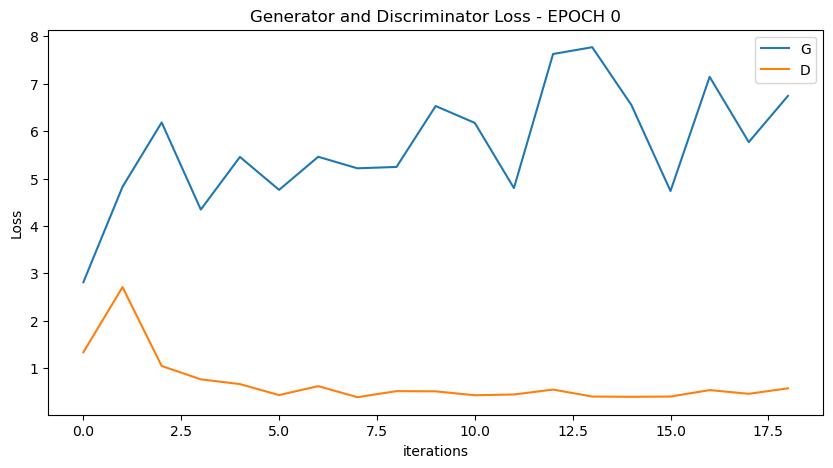

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


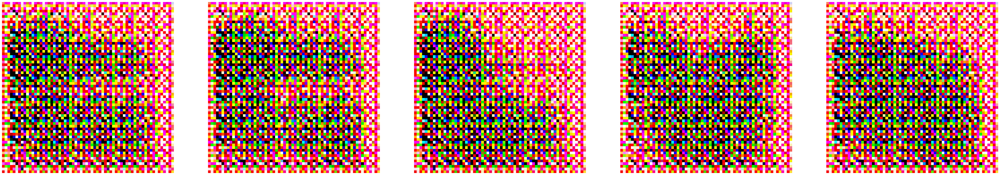

  0%|          | 0/19 [00:00<?, ?it/s]

[2/100][9/19] Loss_D: 0.8740 Loss_G: 3.3382 D(x): 0.6365 D(G(z)): 0.1307 / 0.0308
[2/100][18/19] Loss_D: 1.0394 Loss_G: 3.2654 D(x): 0.4746 D(G(z)): 0.1098 / 0.0294


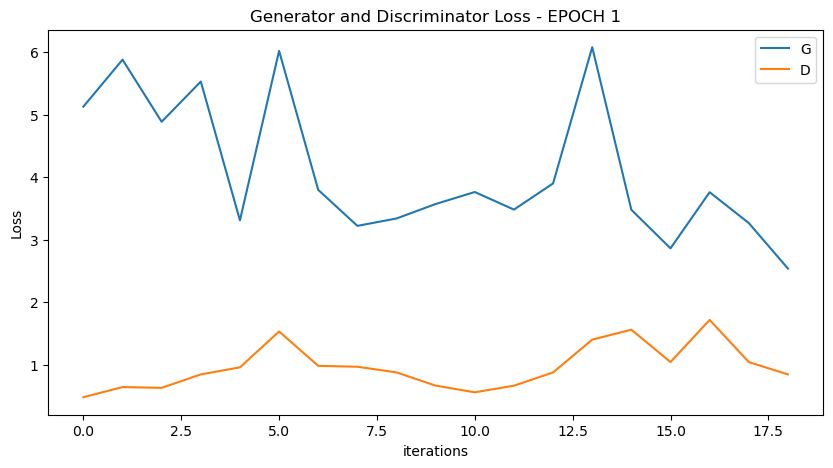

  0%|          | 0/19 [00:00<?, ?it/s]

[3/100][9/19] Loss_D: 0.8832 Loss_G: 4.3371 D(x): 0.6519 D(G(z)): 0.2696 / 0.0100
[3/100][18/19] Loss_D: 1.1563 Loss_G: 2.1536 D(x): 0.5179 D(G(z)): 0.3507 / 0.1048


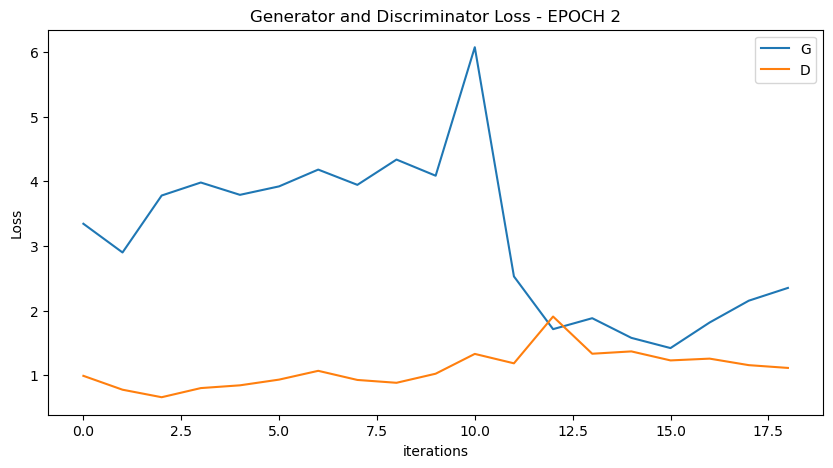

  0%|          | 0/19 [00:00<?, ?it/s]

[4/100][9/19] Loss_D: 0.9329 Loss_G: 3.0677 D(x): 0.6951 D(G(z)): 0.3385 / 0.0364
[4/100][18/19] Loss_D: 0.7137 Loss_G: 3.9372 D(x): 0.6636 D(G(z)): 0.1687 / 0.0139


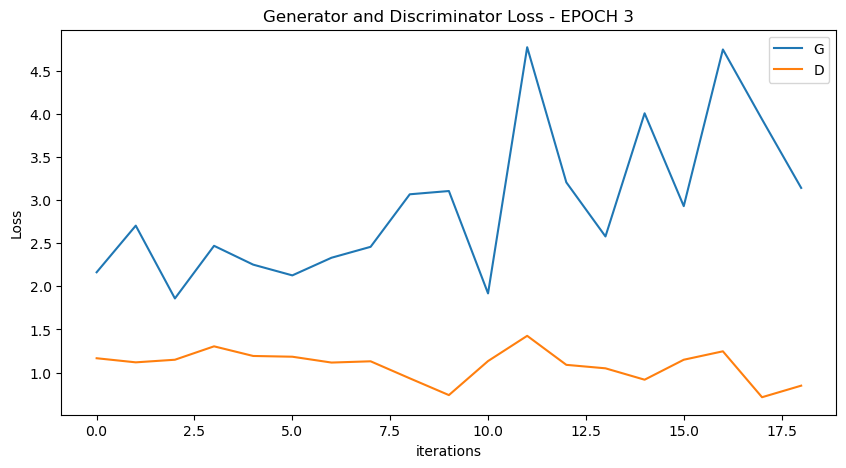

  0%|          | 0/19 [00:00<?, ?it/s]

[5/100][9/19] Loss_D: 1.7151 Loss_G: 3.2958 D(x): 0.3590 D(G(z)): 0.4198 / 0.0323
[5/100][18/19] Loss_D: 1.3447 Loss_G: 1.8353 D(x): 0.3880 D(G(z)): 0.2922 / 0.1398


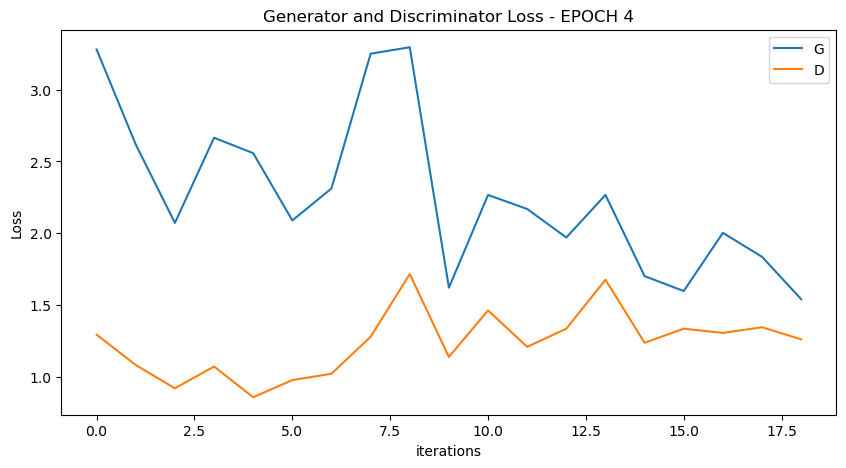

  0%|          | 0/19 [00:00<?, ?it/s]

[6/100][9/19] Loss_D: 1.2371 Loss_G: 1.4853 D(x): 0.6548 D(G(z)): 0.4667 / 0.2106
[6/100][18/19] Loss_D: 1.3270 Loss_G: 1.6187 D(x): 0.5524 D(G(z)): 0.4649 / 0.1796


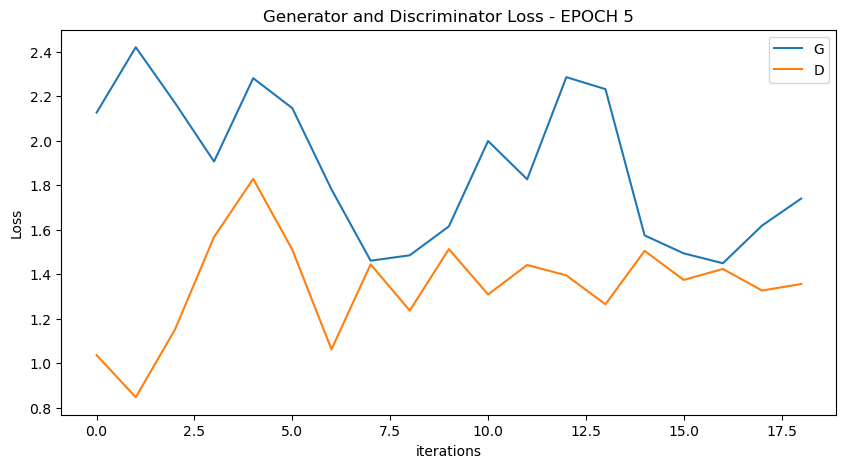

  0%|          | 0/19 [00:00<?, ?it/s]

[7/100][9/19] Loss_D: 1.3215 Loss_G: 1.6768 D(x): 0.4259 D(G(z)): 0.3417 / 0.1729
[7/100][18/19] Loss_D: 1.0790 Loss_G: 1.5971 D(x): 0.5628 D(G(z)): 0.3323 / 0.1913


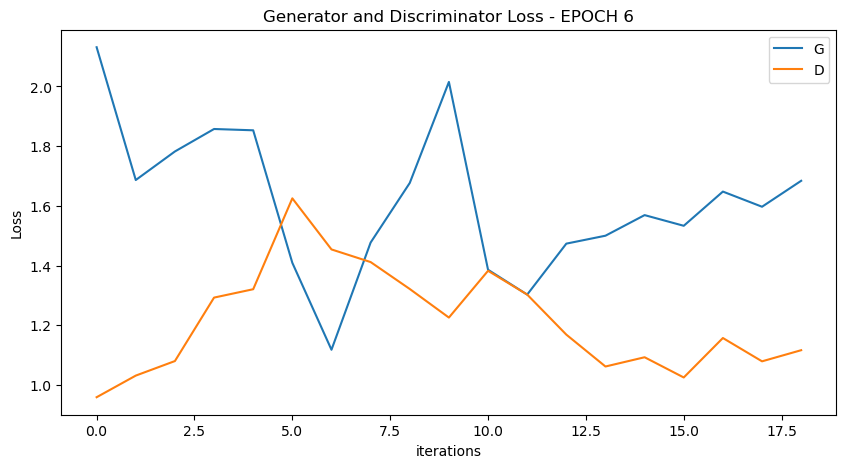

  0%|          | 0/19 [00:00<?, ?it/s]

[8/100][9/19] Loss_D: 1.3648 Loss_G: 1.6343 D(x): 0.5012 D(G(z)): 0.4454 / 0.1730
[8/100][18/19] Loss_D: 1.3251 Loss_G: 1.1441 D(x): 0.5105 D(G(z)): 0.4413 / 0.3049


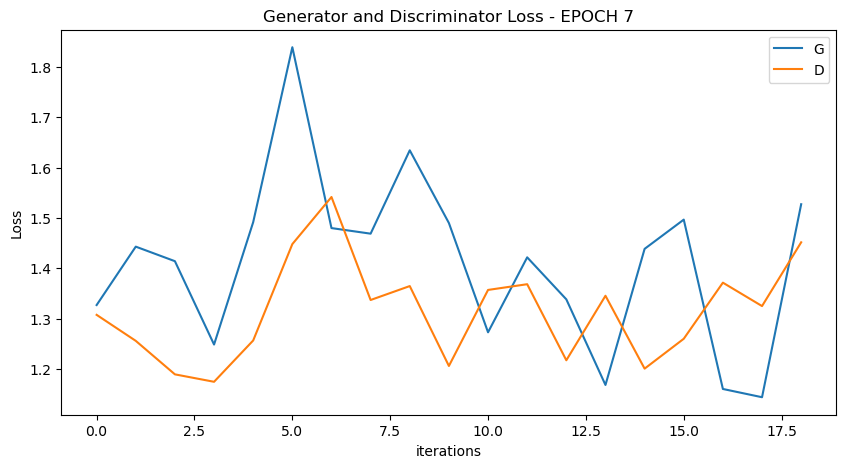

  0%|          | 0/19 [00:00<?, ?it/s]

[9/100][9/19] Loss_D: 1.4458 Loss_G: 1.2318 D(x): 0.4905 D(G(z)): 0.4767 / 0.2706
[9/100][18/19] Loss_D: 1.4220 Loss_G: 1.1670 D(x): 0.4527 D(G(z)): 0.4536 / 0.2937


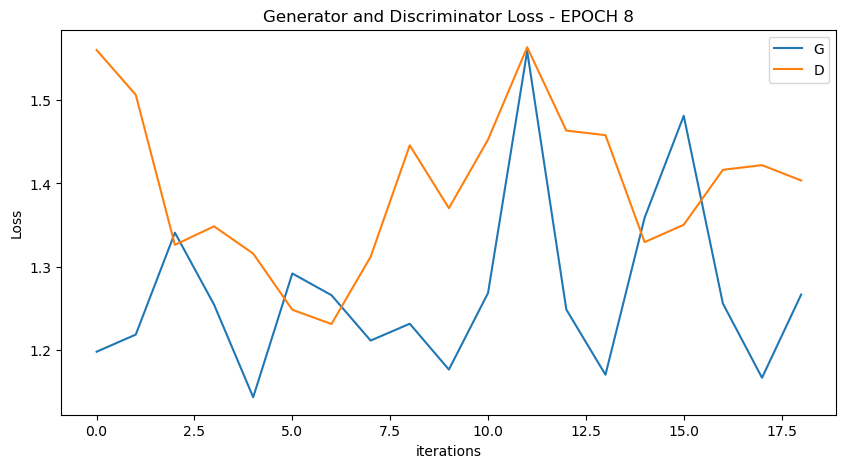

  0%|          | 0/19 [00:00<?, ?it/s]

[10/100][9/19] Loss_D: 1.2431 Loss_G: 1.5109 D(x): 0.5426 D(G(z)): 0.4171 / 0.1994
[10/100][18/19] Loss_D: 1.4145 Loss_G: 2.1025 D(x): 0.4872 D(G(z)): 0.4545 / 0.1073


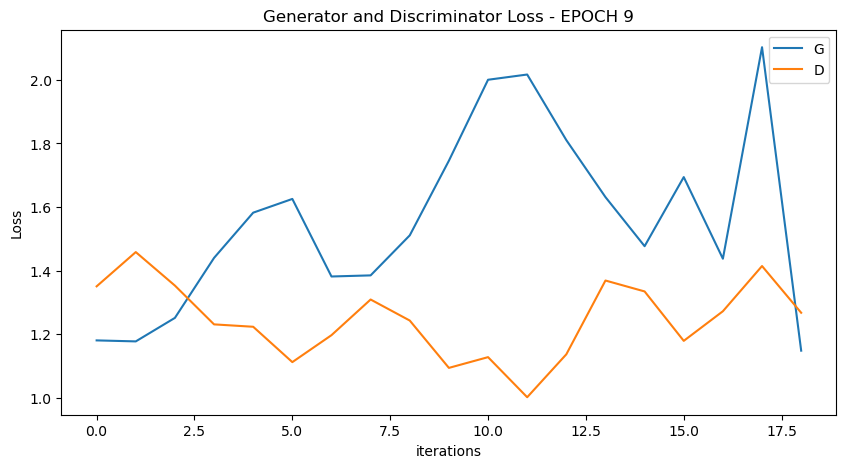

  0%|          | 0/19 [00:00<?, ?it/s]

[11/100][9/19] Loss_D: 1.4530 Loss_G: 1.0664 D(x): 0.3651 D(G(z)): 0.3509 / 0.3352
[11/100][18/19] Loss_D: 1.2057 Loss_G: 1.5057 D(x): 0.5180 D(G(z)): 0.3786 / 0.2061


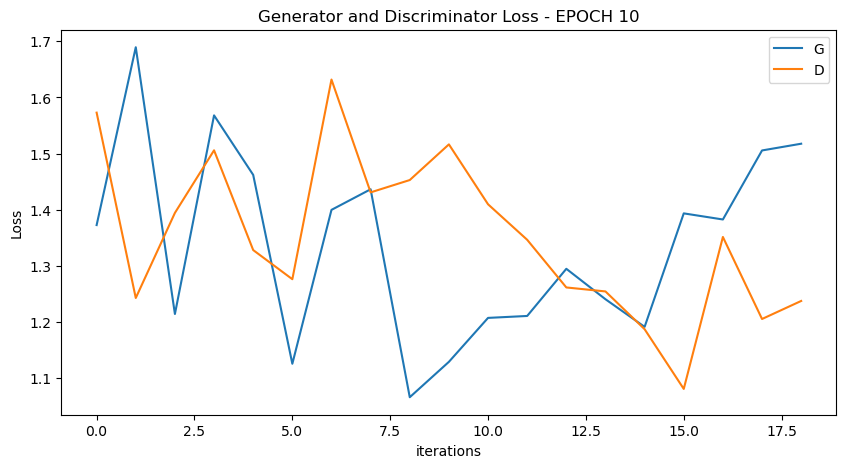

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


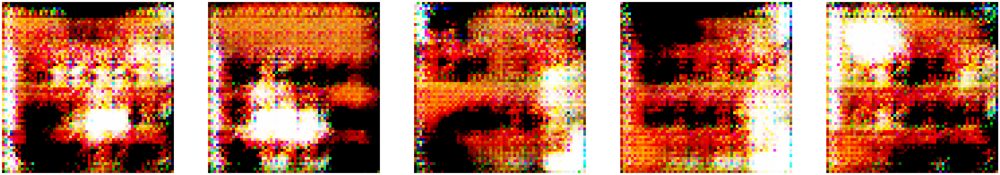

  0%|          | 0/19 [00:00<?, ?it/s]

[12/100][9/19] Loss_D: 1.1535 Loss_G: 1.6305 D(x): 0.5233 D(G(z)): 0.3309 / 0.1813
[12/100][18/19] Loss_D: 1.2563 Loss_G: 1.2894 D(x): 0.4834 D(G(z)): 0.3529 / 0.2529


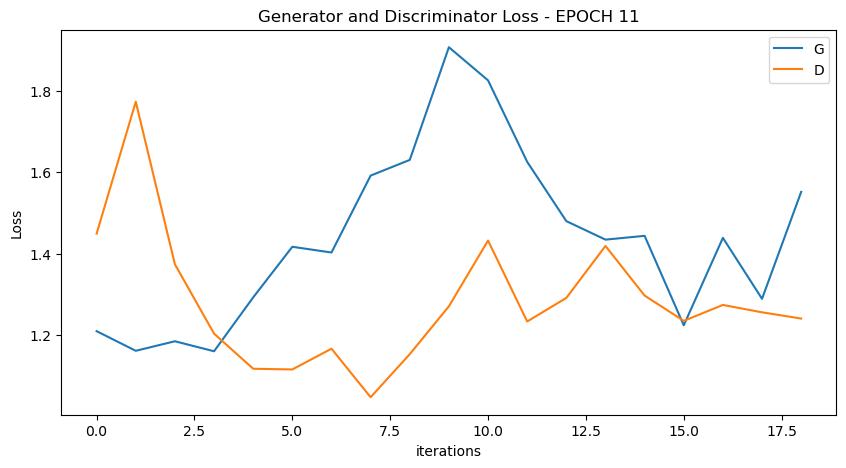

  0%|          | 0/19 [00:00<?, ?it/s]

[13/100][9/19] Loss_D: 1.2533 Loss_G: 1.0829 D(x): 0.5682 D(G(z)): 0.4482 / 0.3240
[13/100][18/19] Loss_D: 1.2068 Loss_G: 1.2659 D(x): 0.4426 D(G(z)): 0.3106 / 0.2595


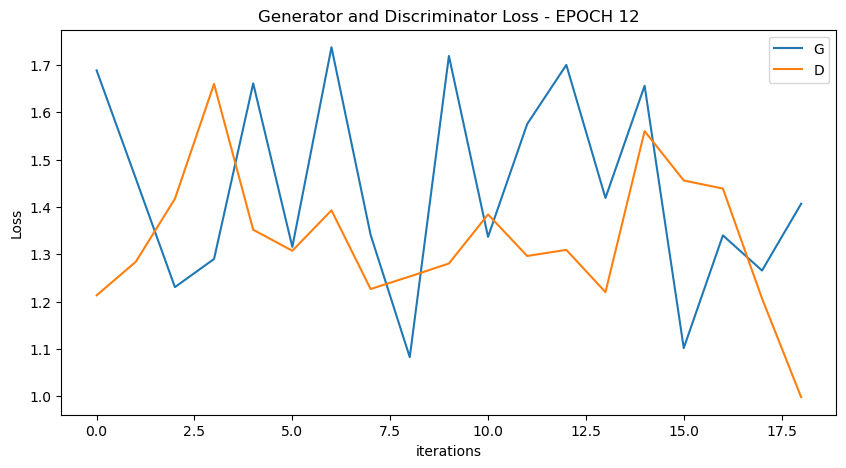

  0%|          | 0/19 [00:00<?, ?it/s]

[14/100][9/19] Loss_D: 1.5592 Loss_G: 1.1442 D(x): 0.4395 D(G(z)): 0.4686 / 0.3136
[14/100][18/19] Loss_D: 1.6924 Loss_G: 1.8110 D(x): 0.3675 D(G(z)): 0.4435 / 0.1609


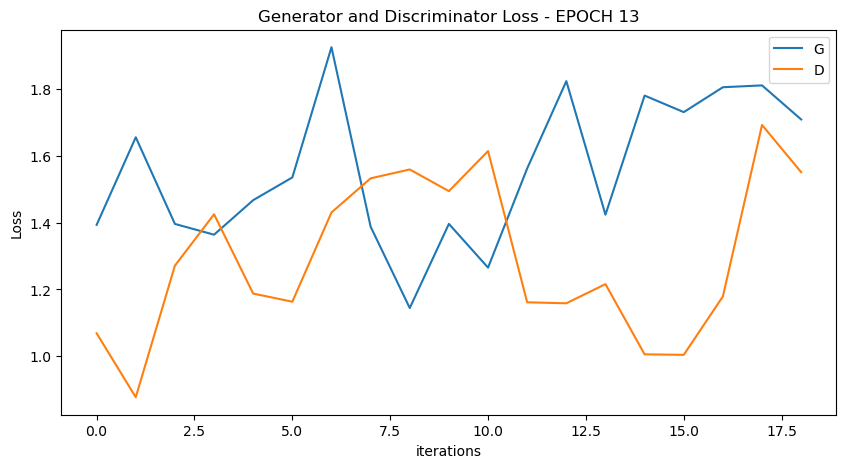

  0%|          | 0/19 [00:00<?, ?it/s]

[15/100][9/19] Loss_D: 1.4032 Loss_G: 1.5846 D(x): 0.5061 D(G(z)): 0.4786 / 0.1852
[15/100][18/19] Loss_D: 1.2174 Loss_G: 1.3300 D(x): 0.5026 D(G(z)): 0.3555 / 0.2524


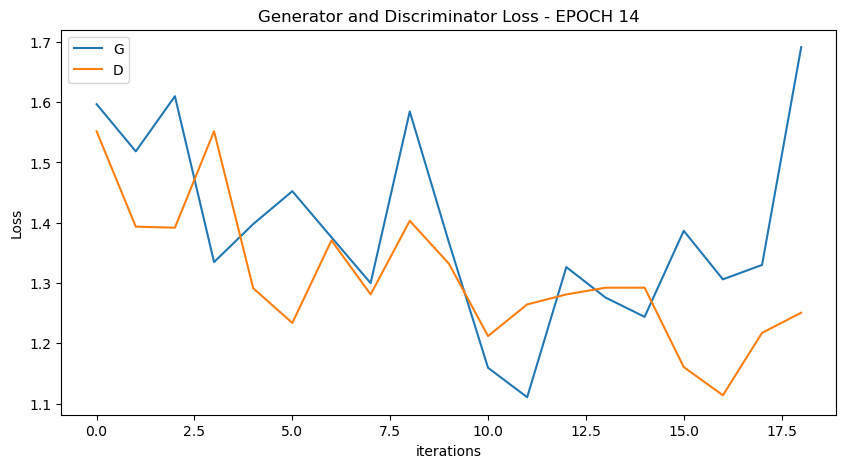

  0%|          | 0/19 [00:00<?, ?it/s]

[16/100][9/19] Loss_D: 1.4060 Loss_G: 1.7435 D(x): 0.4904 D(G(z)): 0.4436 / 0.1605
[16/100][18/19] Loss_D: 1.2440 Loss_G: 1.9200 D(x): 0.6002 D(G(z)): 0.4563 / 0.1427


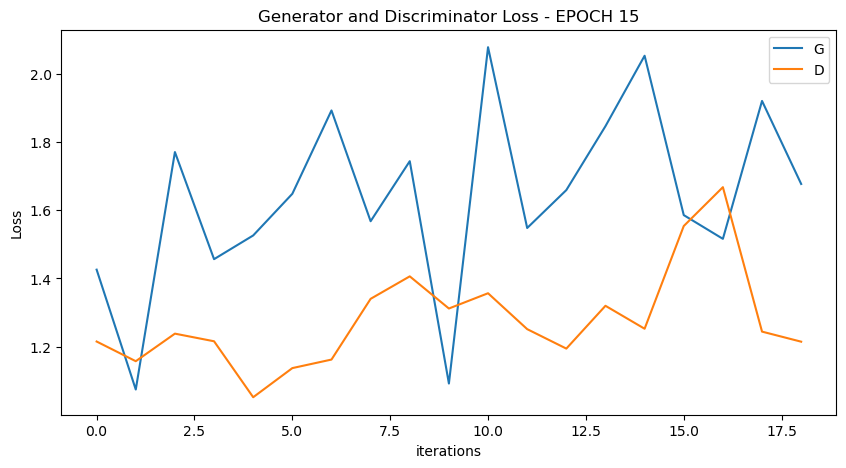

  0%|          | 0/19 [00:00<?, ?it/s]

[17/100][9/19] Loss_D: 1.6353 Loss_G: 1.9506 D(x): 0.3831 D(G(z)): 0.4516 / 0.1262
[17/100][18/19] Loss_D: 1.4818 Loss_G: 2.0111 D(x): 0.4284 D(G(z)): 0.4500 / 0.1200


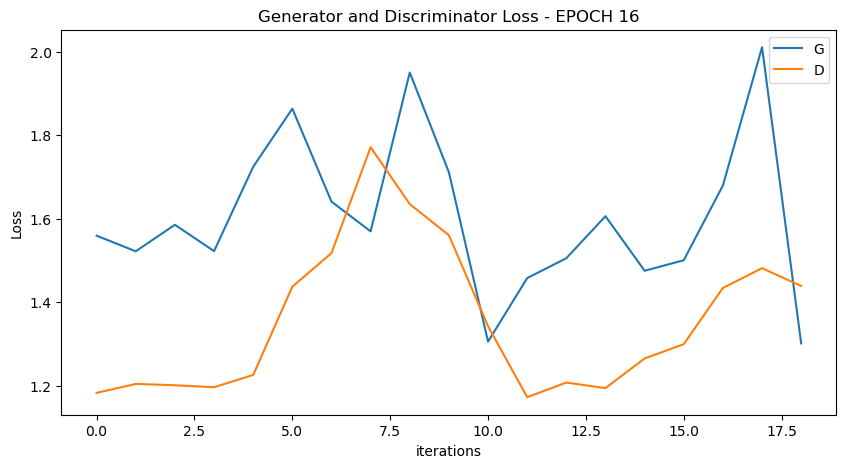

  0%|          | 0/19 [00:00<?, ?it/s]

[18/100][9/19] Loss_D: 1.0820 Loss_G: 1.6755 D(x): 0.5744 D(G(z)): 0.3588 / 0.1694
[18/100][18/19] Loss_D: 1.1313 Loss_G: 1.7087 D(x): 0.5131 D(G(z)): 0.3035 / 0.1752


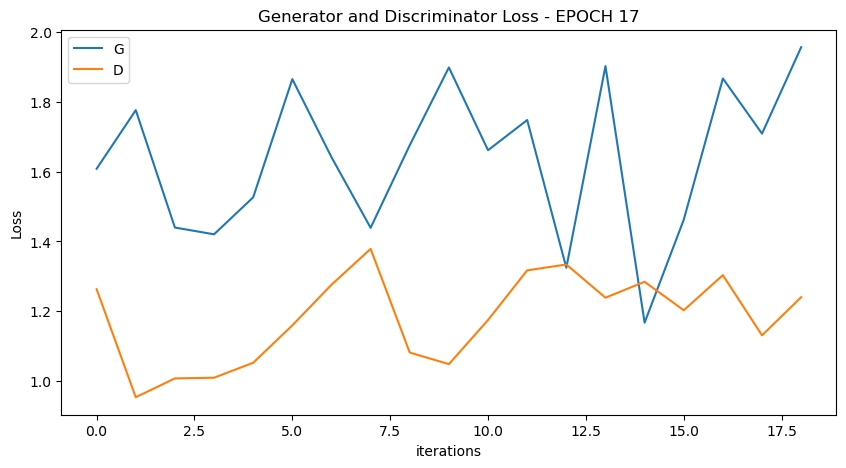

  0%|          | 0/19 [00:00<?, ?it/s]

[19/100][9/19] Loss_D: 1.2342 Loss_G: 1.4502 D(x): 0.5660 D(G(z)): 0.4341 / 0.2266
[19/100][18/19] Loss_D: 1.3340 Loss_G: 1.3239 D(x): 0.4733 D(G(z)): 0.4002 / 0.2512


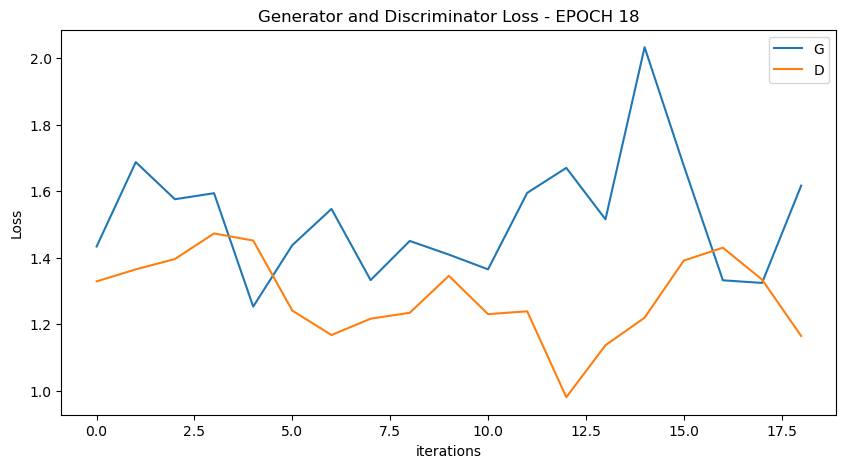

  0%|          | 0/19 [00:00<?, ?it/s]

[20/100][9/19] Loss_D: 1.0593 Loss_G: 1.7611 D(x): 0.5756 D(G(z)): 0.3272 / 0.1506
[20/100][18/19] Loss_D: 1.2821 Loss_G: 1.9079 D(x): 0.5627 D(G(z)): 0.4651 / 0.1306


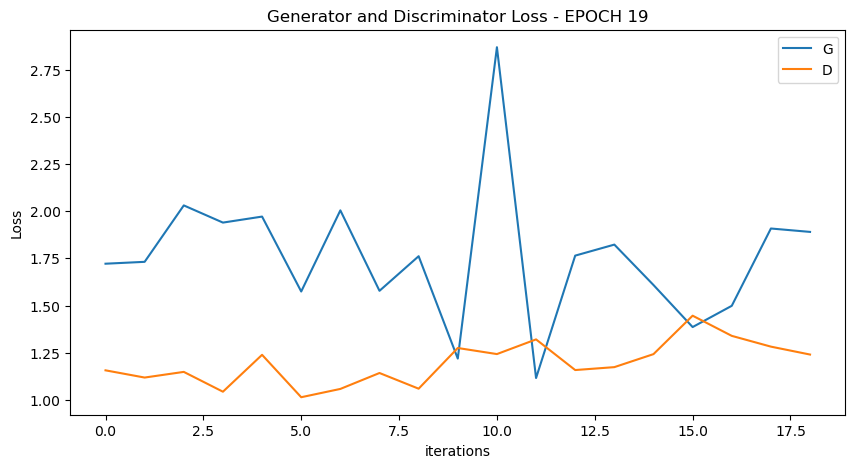

  0%|          | 0/19 [00:00<?, ?it/s]

[21/100][9/19] Loss_D: 1.4848 Loss_G: 1.6845 D(x): 0.5375 D(G(z)): 0.5385 / 0.1759
[21/100][18/19] Loss_D: 1.3363 Loss_G: 1.2742 D(x): 0.3672 D(G(z)): 0.2008 / 0.2579


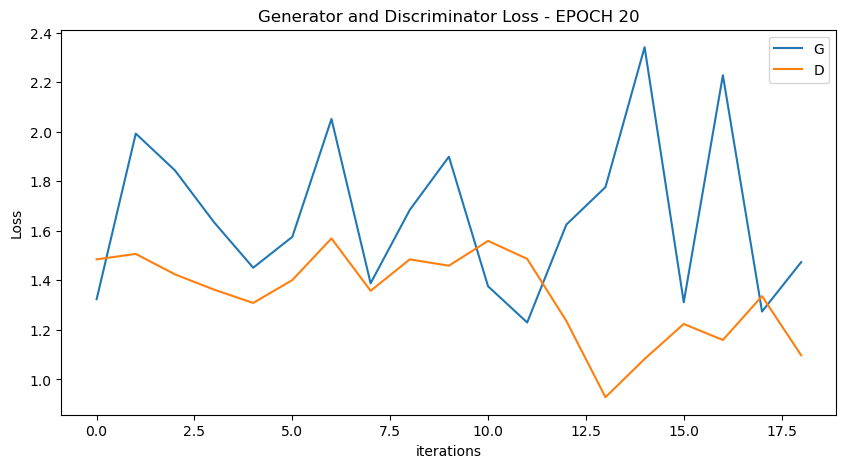

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


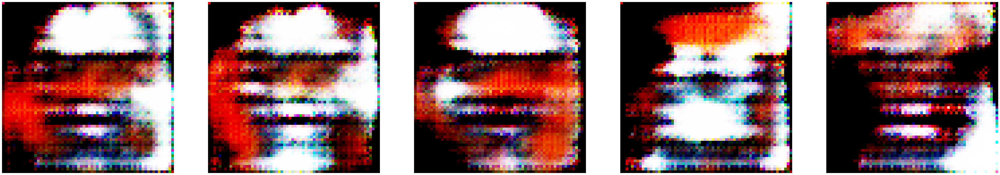

  0%|          | 0/19 [00:00<?, ?it/s]

[22/100][9/19] Loss_D: 1.4313 Loss_G: 1.5493 D(x): 0.4750 D(G(z)): 0.4238 / 0.2075
[22/100][18/19] Loss_D: 1.2739 Loss_G: 1.3352 D(x): 0.4532 D(G(z)): 0.3525 / 0.2527


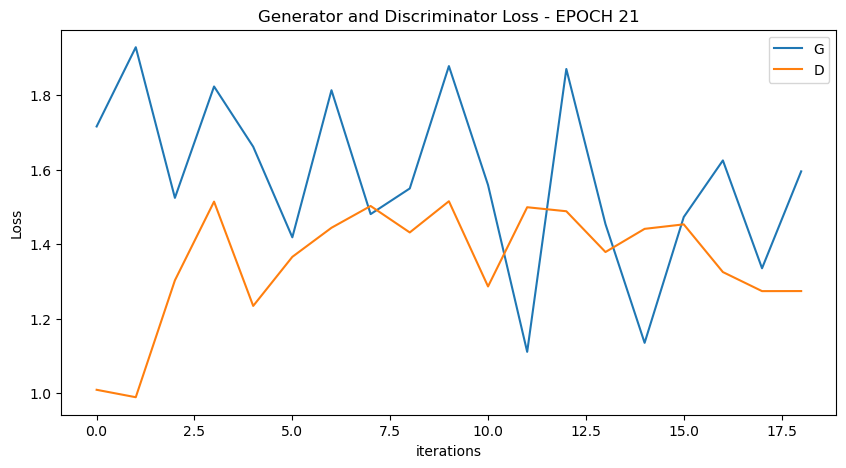

  0%|          | 0/19 [00:00<?, ?it/s]

[23/100][9/19] Loss_D: 1.3166 Loss_G: 1.4343 D(x): 0.4476 D(G(z)): 0.3786 / 0.2168
[23/100][18/19] Loss_D: 1.0778 Loss_G: 1.4975 D(x): 0.5216 D(G(z)): 0.2939 / 0.2101


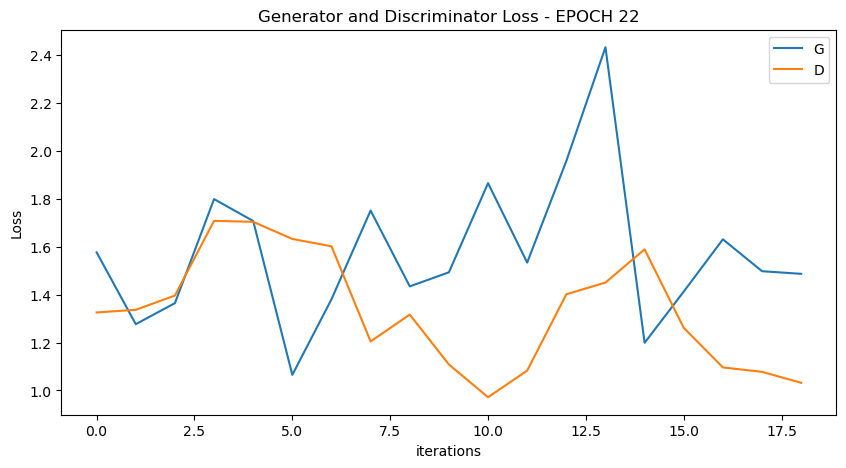

  0%|          | 0/19 [00:00<?, ?it/s]

[24/100][9/19] Loss_D: 1.1179 Loss_G: 2.2480 D(x): 0.6873 D(G(z)): 0.4425 / 0.0938
[24/100][18/19] Loss_D: 1.4646 Loss_G: 1.3812 D(x): 0.3682 D(G(z)): 0.3139 / 0.2401


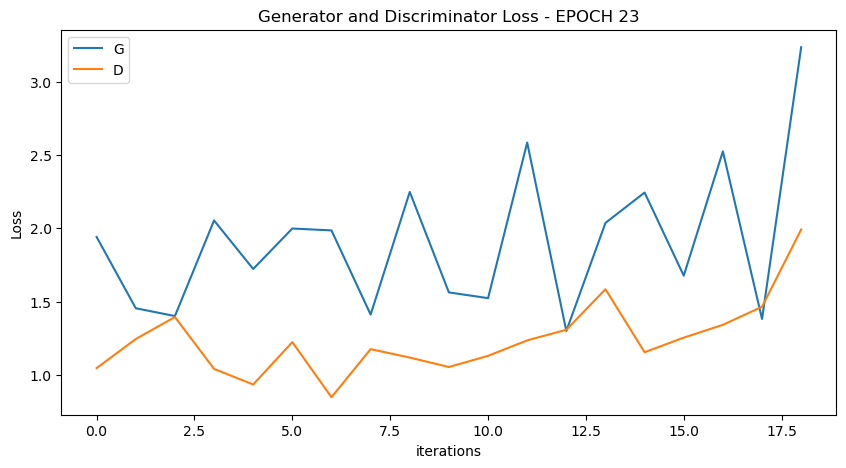

  0%|          | 0/19 [00:00<?, ?it/s]

[25/100][9/19] Loss_D: 1.0507 Loss_G: 1.4343 D(x): 0.6100 D(G(z)): 0.3695 / 0.2244
[25/100][18/19] Loss_D: 1.5160 Loss_G: 1.2012 D(x): 0.3470 D(G(z)): 0.2827 / 0.2982


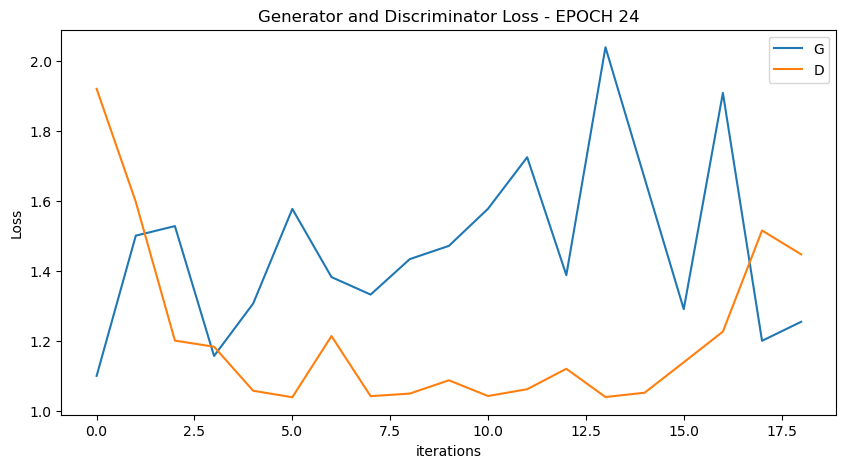

  0%|          | 0/19 [00:00<?, ?it/s]

[26/100][9/19] Loss_D: 1.5449 Loss_G: 1.3439 D(x): 0.4667 D(G(z)): 0.5063 / 0.2450
[26/100][18/19] Loss_D: 1.6475 Loss_G: 1.1946 D(x): 0.3424 D(G(z)): 0.3739 / 0.3018


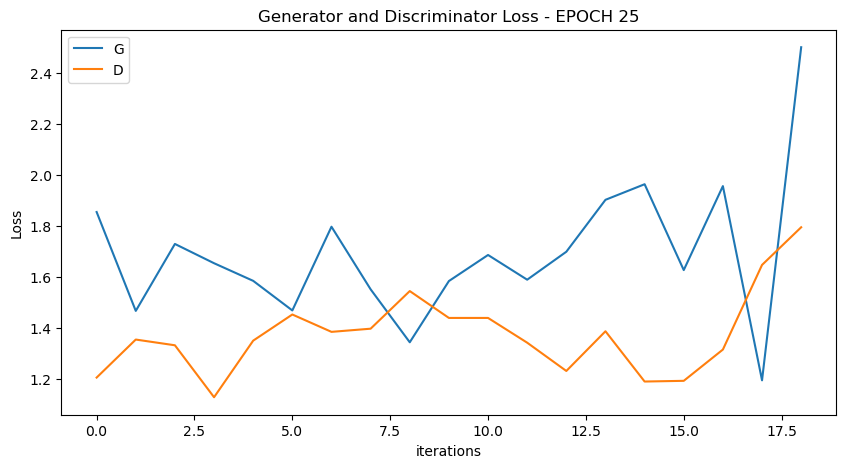

  0%|          | 0/19 [00:00<?, ?it/s]

[27/100][9/19] Loss_D: 1.5905 Loss_G: 1.0242 D(x): 0.3760 D(G(z)): 0.4364 / 0.3481
[27/100][18/19] Loss_D: 1.0576 Loss_G: 1.3395 D(x): 0.5459 D(G(z)): 0.3185 / 0.2439


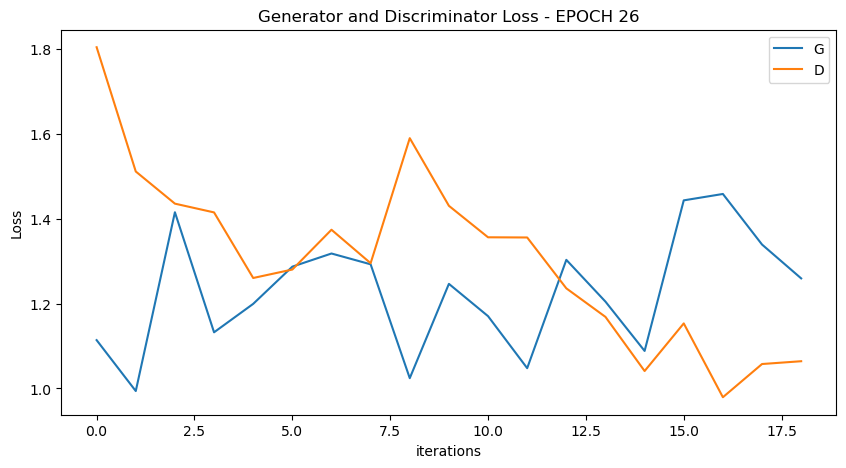

  0%|          | 0/19 [00:00<?, ?it/s]

[28/100][9/19] Loss_D: 1.1786 Loss_G: 1.2804 D(x): 0.5491 D(G(z)): 0.3959 / 0.2591
[28/100][18/19] Loss_D: 1.3719 Loss_G: 1.5960 D(x): 0.4822 D(G(z)): 0.4327 / 0.1812


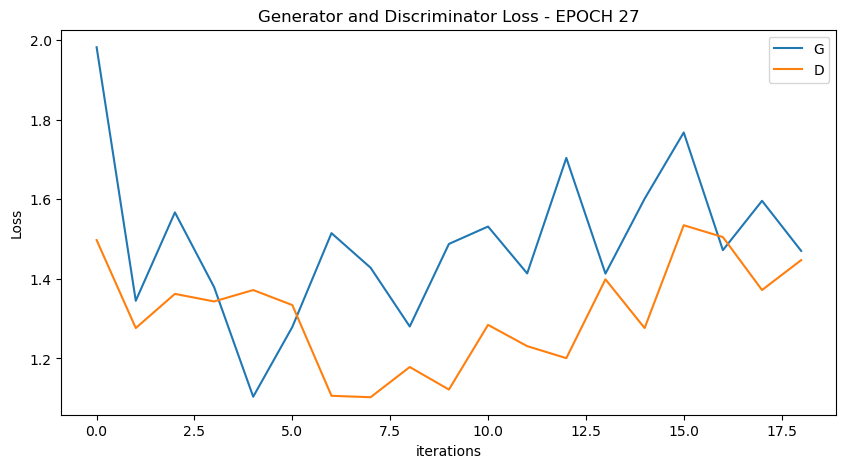

  0%|          | 0/19 [00:00<?, ?it/s]

[29/100][9/19] Loss_D: 1.1938 Loss_G: 1.7551 D(x): 0.6831 D(G(z)): 0.4779 / 0.1593
[29/100][18/19] Loss_D: 1.1756 Loss_G: 1.7387 D(x): 0.4281 D(G(z)): 0.2489 / 0.1651


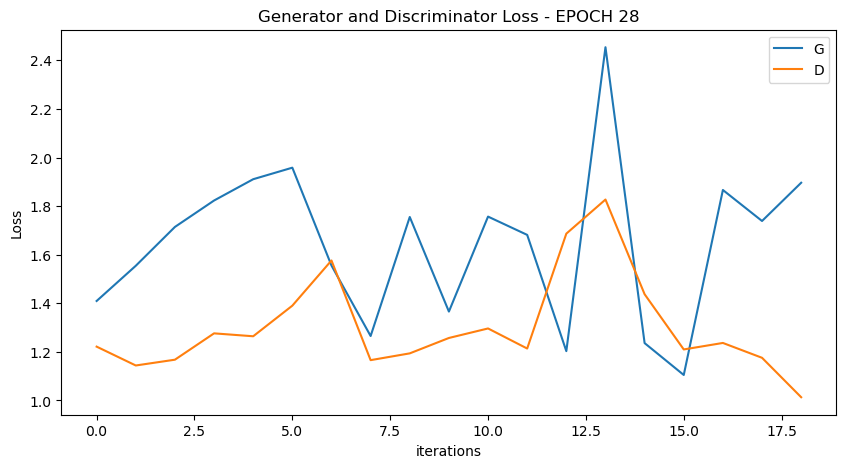

  0%|          | 0/19 [00:00<?, ?it/s]

[30/100][9/19] Loss_D: 1.7624 Loss_G: 1.5893 D(x): 0.5626 D(G(z)): 0.6416 / 0.1904
[30/100][18/19] Loss_D: 1.4617 Loss_G: 1.4817 D(x): 0.4217 D(G(z)): 0.4335 / 0.2112


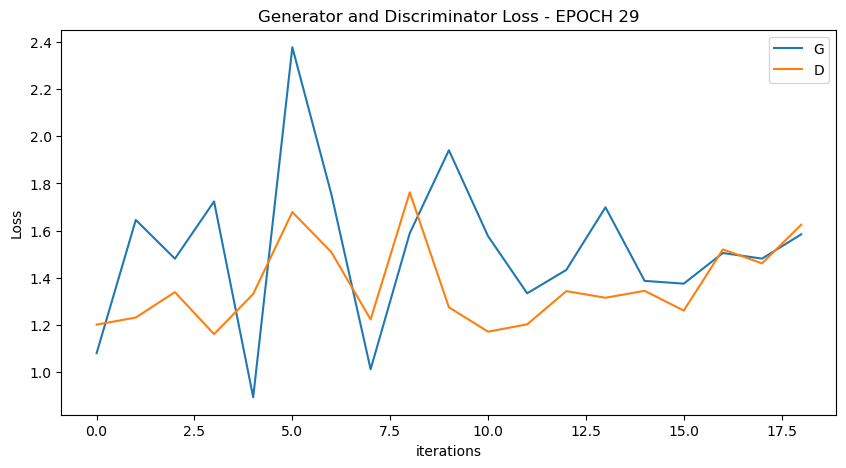

  0%|          | 0/19 [00:00<?, ?it/s]

[31/100][9/19] Loss_D: 1.3060 Loss_G: 1.3229 D(x): 0.5713 D(G(z)): 0.4777 / 0.2539
[31/100][18/19] Loss_D: 1.3236 Loss_G: 1.4088 D(x): 0.4987 D(G(z)): 0.4370 / 0.2345


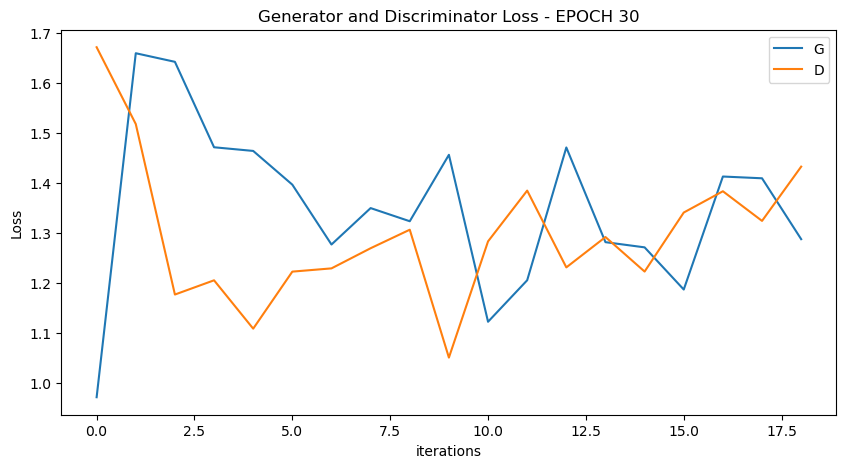

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


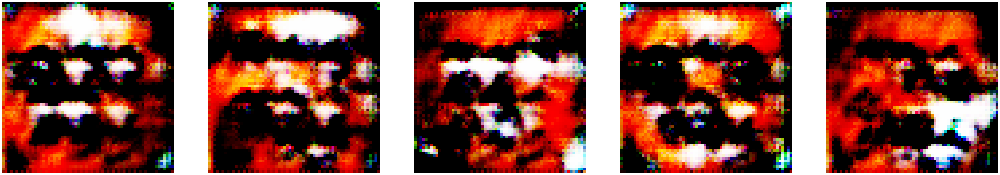

  0%|          | 0/19 [00:00<?, ?it/s]

[32/100][9/19] Loss_D: 1.3680 Loss_G: 1.5380 D(x): 0.4102 D(G(z)): 0.3415 / 0.2142
[32/100][18/19] Loss_D: 1.2427 Loss_G: 1.1140 D(x): 0.4384 D(G(z)): 0.3083 / 0.3190


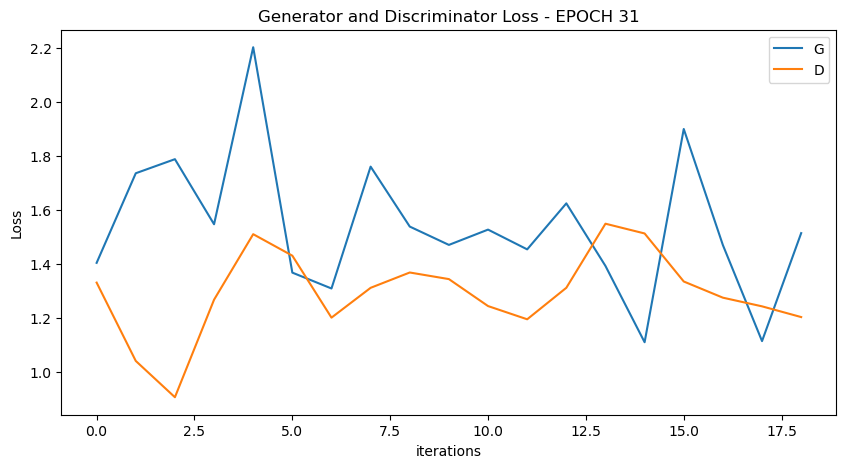

  0%|          | 0/19 [00:00<?, ?it/s]

[33/100][9/19] Loss_D: 1.3372 Loss_G: 1.6562 D(x): 0.5492 D(G(z)): 0.4537 / 0.1751
[33/100][18/19] Loss_D: 1.3437 Loss_G: 1.6182 D(x): 0.4892 D(G(z)): 0.4208 / 0.2005


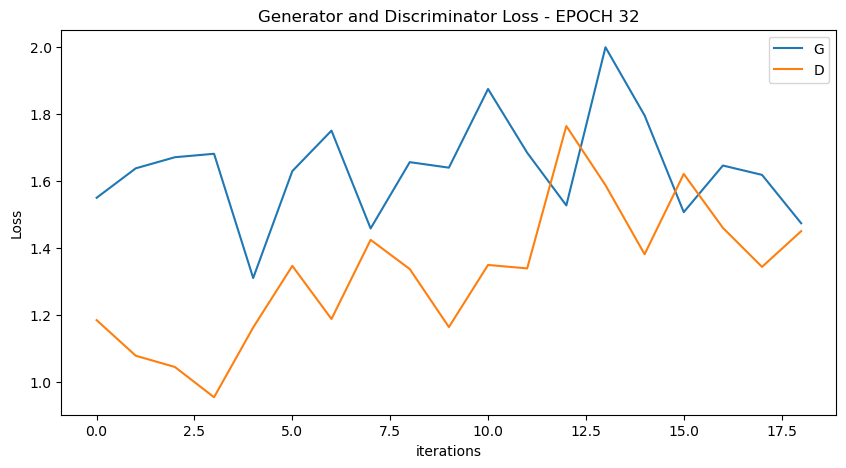

  0%|          | 0/19 [00:00<?, ?it/s]

[34/100][9/19] Loss_D: 1.5149 Loss_G: 1.7023 D(x): 0.2962 D(G(z)): 0.2271 / 0.1753
[34/100][18/19] Loss_D: 1.2234 Loss_G: 1.5392 D(x): 0.5323 D(G(z)): 0.4035 / 0.2078


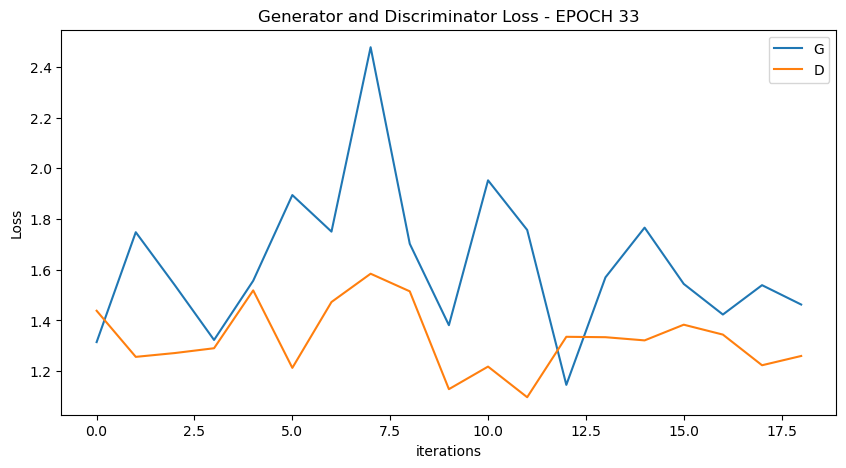

  0%|          | 0/19 [00:00<?, ?it/s]

[35/100][9/19] Loss_D: 1.3669 Loss_G: 1.3812 D(x): 0.4220 D(G(z)): 0.3508 / 0.2346
[35/100][18/19] Loss_D: 1.4527 Loss_G: 1.1774 D(x): 0.3983 D(G(z)): 0.3789 / 0.2976


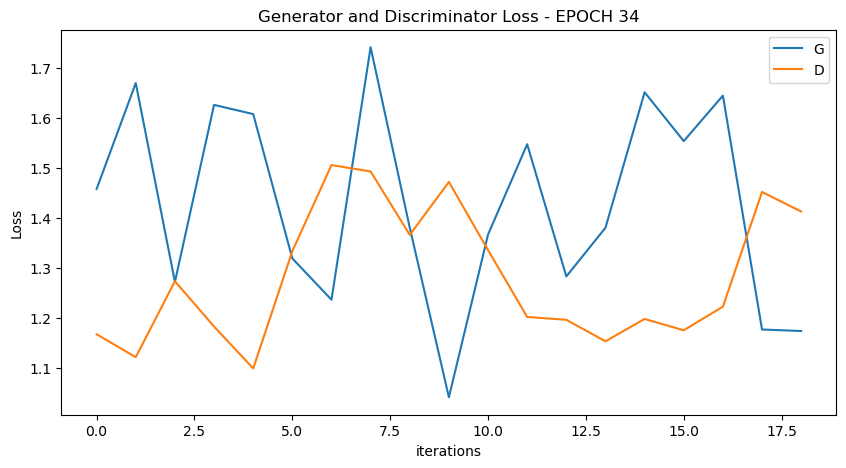

  0%|          | 0/19 [00:00<?, ?it/s]

[36/100][9/19] Loss_D: 1.6594 Loss_G: 1.0728 D(x): 0.2675 D(G(z)): 0.3269 / 0.3250
[36/100][18/19] Loss_D: 1.1786 Loss_G: 1.4347 D(x): 0.5389 D(G(z)): 0.3805 / 0.2256


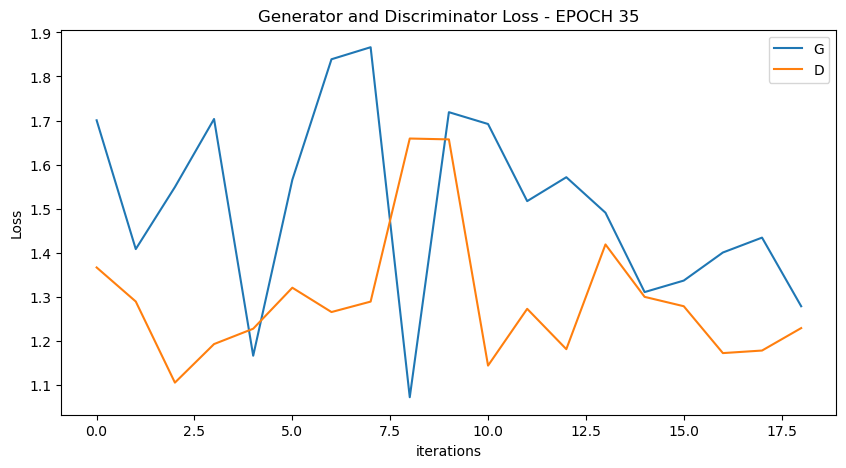

  0%|          | 0/19 [00:00<?, ?it/s]

[37/100][9/19] Loss_D: 1.5497 Loss_G: 1.5806 D(x): 0.3943 D(G(z)): 0.4279 / 0.1990
[37/100][18/19] Loss_D: 1.4856 Loss_G: 1.1656 D(x): 0.4337 D(G(z)): 0.4169 / 0.2983


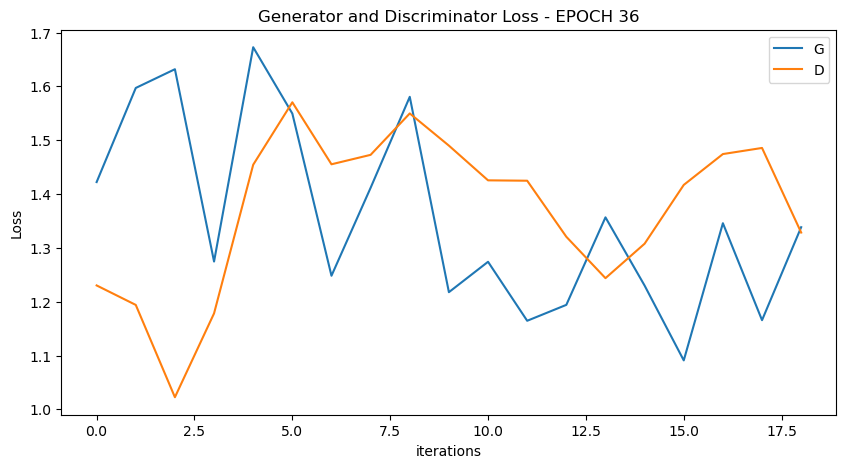

  0%|          | 0/19 [00:00<?, ?it/s]

[38/100][9/19] Loss_D: 1.3978 Loss_G: 1.2069 D(x): 0.4339 D(G(z)): 0.4088 / 0.3030
[38/100][18/19] Loss_D: 1.3252 Loss_G: 1.5337 D(x): 0.5754 D(G(z)): 0.4952 / 0.2117


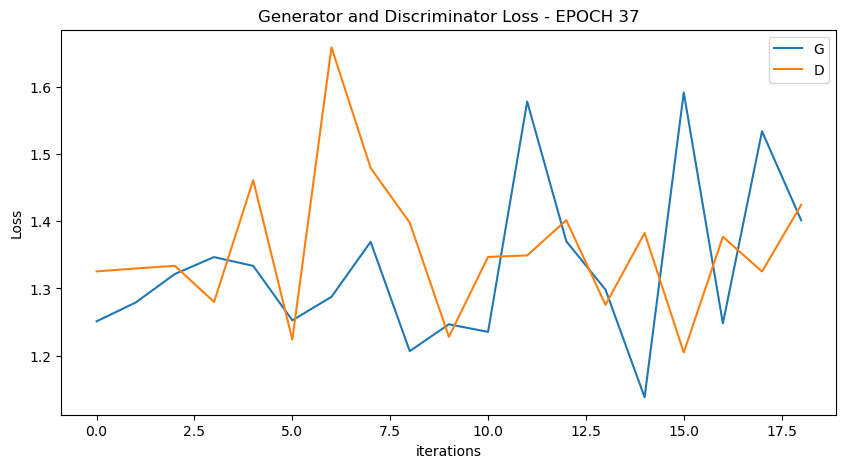

  0%|          | 0/19 [00:00<?, ?it/s]

[39/100][9/19] Loss_D: 1.1395 Loss_G: 1.3880 D(x): 0.5262 D(G(z)): 0.3588 / 0.2286
[39/100][18/19] Loss_D: 1.1823 Loss_G: 1.7097 D(x): 0.5359 D(G(z)): 0.3880 / 0.1714


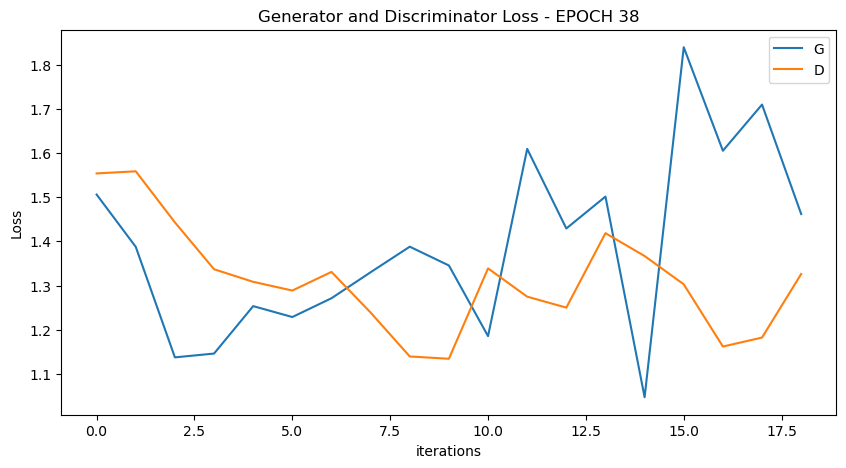

  0%|          | 0/19 [00:00<?, ?it/s]

[40/100][9/19] Loss_D: 1.3725 Loss_G: 1.5310 D(x): 0.4802 D(G(z)): 0.3676 / 0.2052
[40/100][18/19] Loss_D: 1.3896 Loss_G: 1.6064 D(x): 0.4883 D(G(z)): 0.4513 / 0.1790


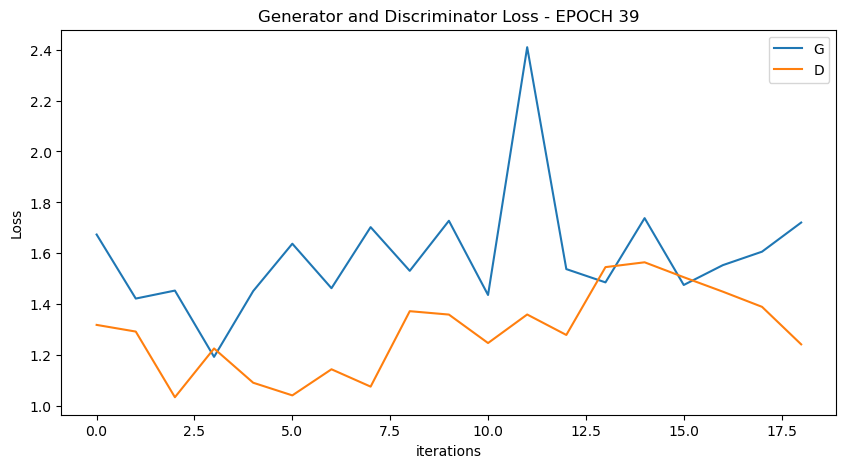

  0%|          | 0/19 [00:00<?, ?it/s]

[41/100][9/19] Loss_D: 1.1211 Loss_G: 1.3386 D(x): 0.5012 D(G(z)): 0.2926 / 0.2423
[41/100][18/19] Loss_D: 1.2031 Loss_G: 1.4895 D(x): 0.5380 D(G(z)): 0.3798 / 0.2191


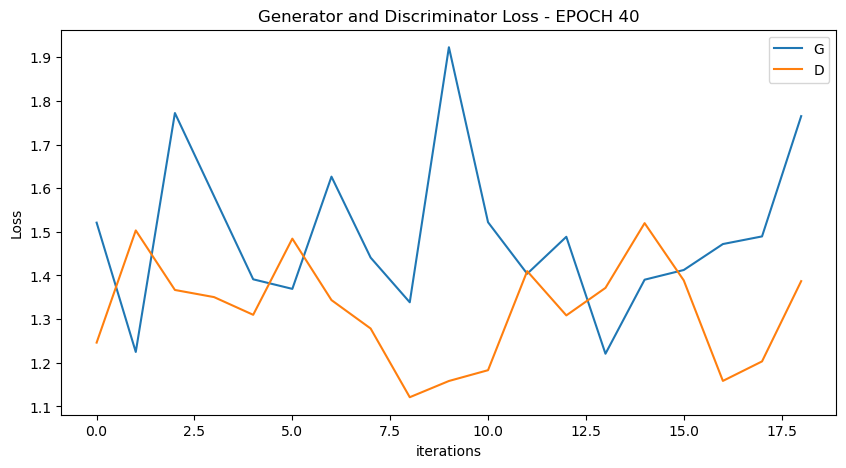

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


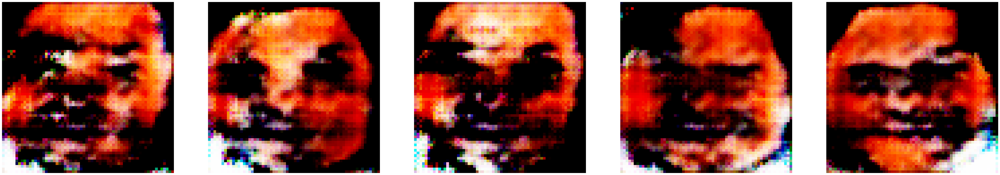

  0%|          | 0/19 [00:00<?, ?it/s]

[42/100][9/19] Loss_D: 1.5565 Loss_G: 1.5163 D(x): 0.5949 D(G(z)): 0.5961 / 0.2094
[42/100][18/19] Loss_D: 1.5126 Loss_G: 1.2842 D(x): 0.4495 D(G(z)): 0.4619 / 0.2789


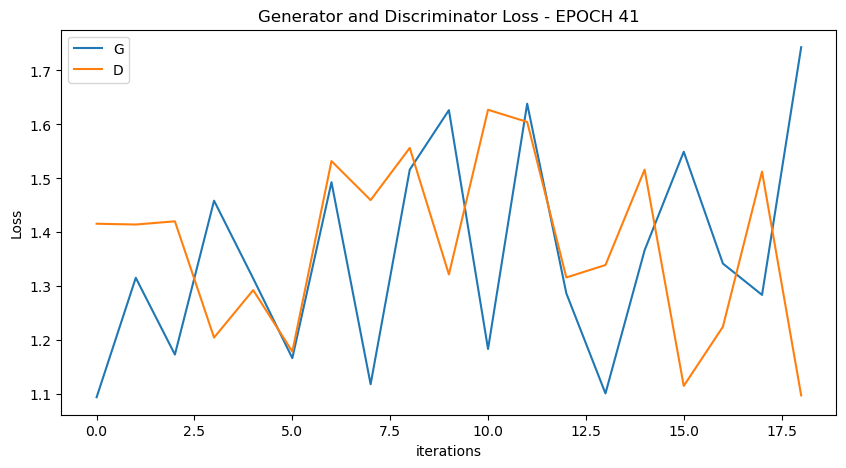

  0%|          | 0/19 [00:00<?, ?it/s]

[43/100][9/19] Loss_D: 1.4524 Loss_G: 1.5405 D(x): 0.5235 D(G(z)): 0.5168 / 0.2111
[43/100][18/19] Loss_D: 1.2160 Loss_G: 1.4761 D(x): 0.4812 D(G(z)): 0.3348 / 0.2178


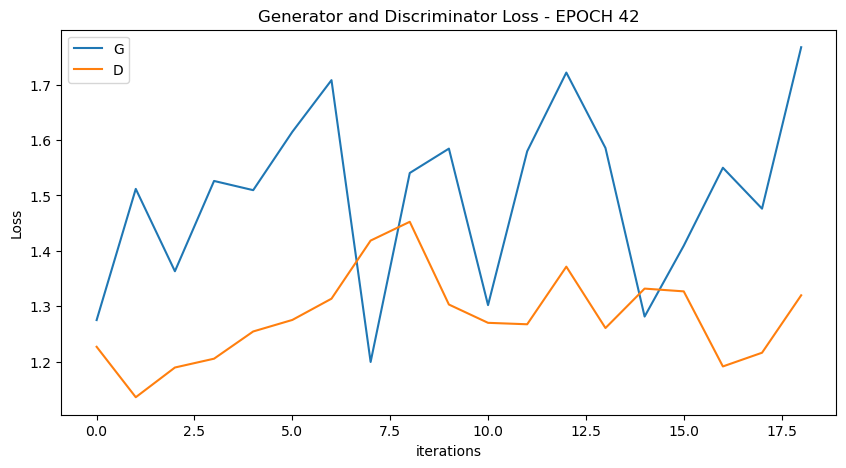

  0%|          | 0/19 [00:00<?, ?it/s]

[44/100][9/19] Loss_D: 1.4564 Loss_G: 1.0515 D(x): 0.3333 D(G(z)): 0.2878 / 0.3370
[44/100][18/19] Loss_D: 1.8032 Loss_G: 1.4208 D(x): 0.5055 D(G(z)): 0.6394 / 0.2462


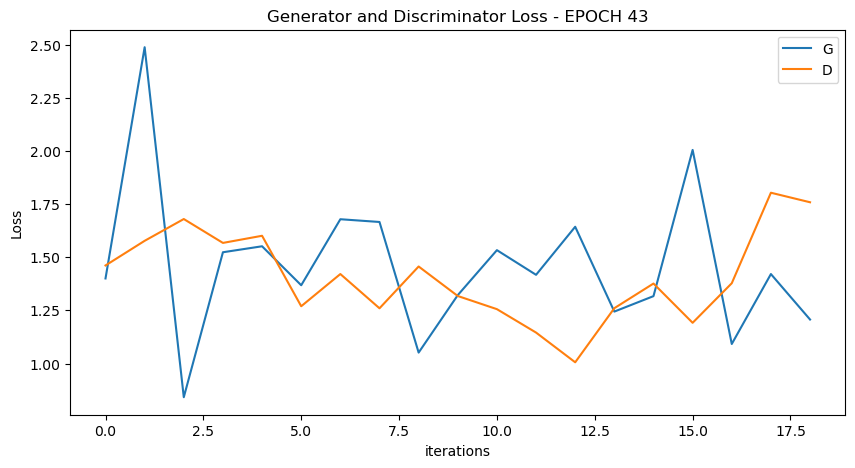

  0%|          | 0/19 [00:00<?, ?it/s]

[45/100][9/19] Loss_D: 1.4113 Loss_G: 1.2177 D(x): 0.5340 D(G(z)): 0.4891 / 0.2839
[45/100][18/19] Loss_D: 1.3871 Loss_G: 1.1507 D(x): 0.4262 D(G(z)): 0.3916 / 0.3074


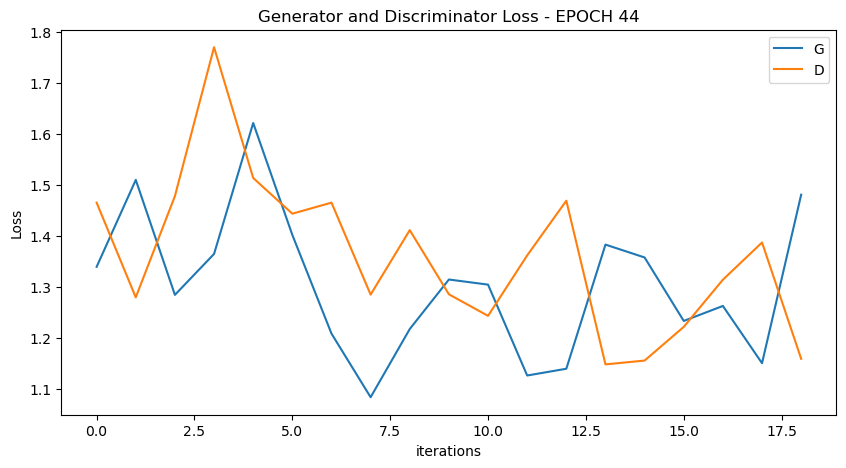

  0%|          | 0/19 [00:00<?, ?it/s]

[46/100][9/19] Loss_D: 1.4956 Loss_G: 1.1899 D(x): 0.4201 D(G(z)): 0.4465 / 0.2880
[46/100][18/19] Loss_D: 1.3037 Loss_G: 1.1150 D(x): 0.5216 D(G(z)): 0.4477 / 0.3122


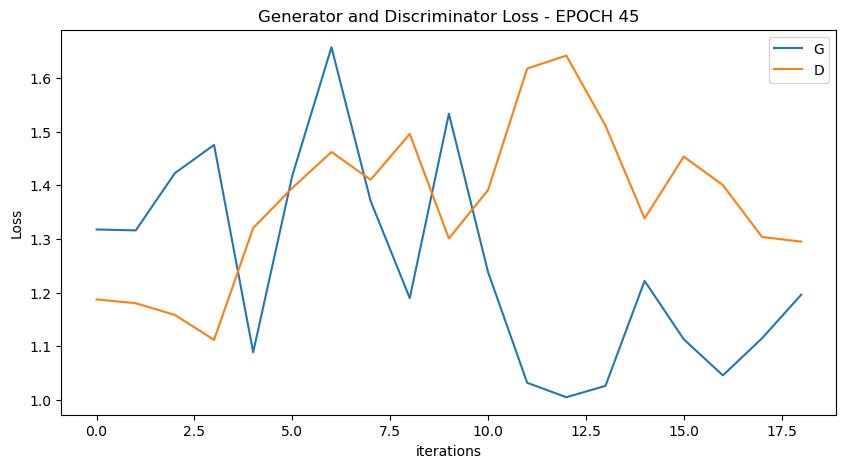

  0%|          | 0/19 [00:00<?, ?it/s]

[47/100][9/19] Loss_D: 1.3274 Loss_G: 1.4279 D(x): 0.4810 D(G(z)): 0.4241 / 0.2233
[47/100][18/19] Loss_D: 1.4801 Loss_G: 1.2188 D(x): 0.4793 D(G(z)): 0.4982 / 0.2926


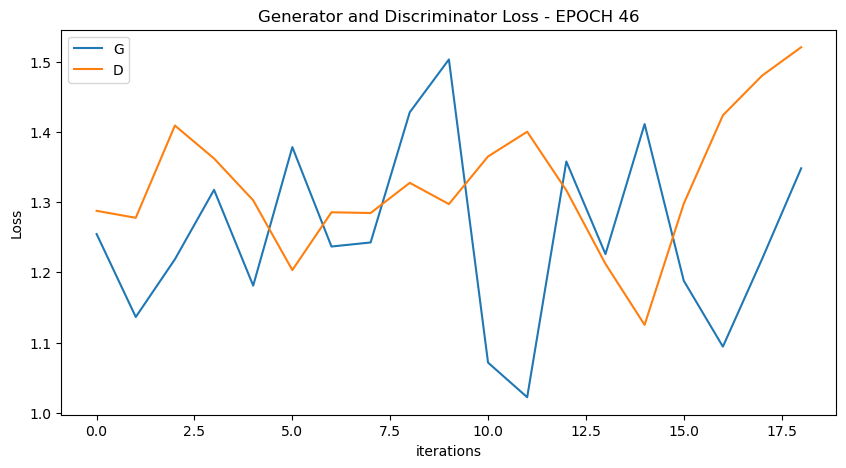

  0%|          | 0/19 [00:00<?, ?it/s]

[48/100][9/19] Loss_D: 1.4685 Loss_G: 1.4907 D(x): 0.4619 D(G(z)): 0.4569 / 0.2185
[48/100][18/19] Loss_D: 1.4760 Loss_G: 1.5095 D(x): 0.4097 D(G(z)): 0.4186 / 0.2201


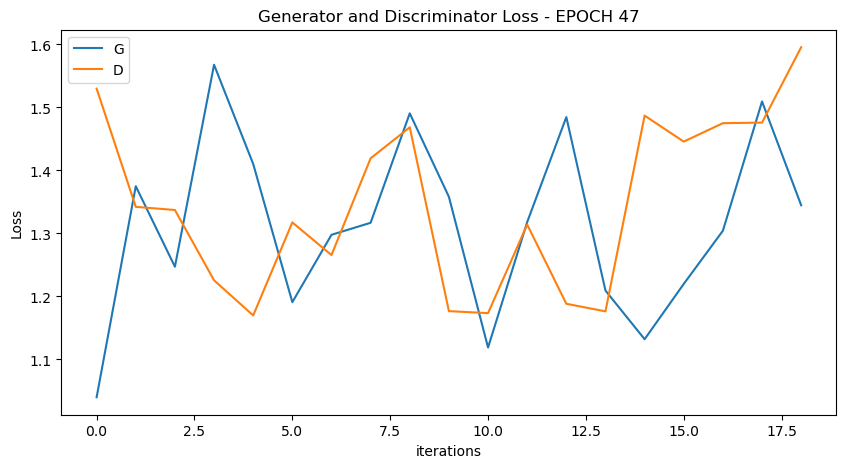

  0%|          | 0/19 [00:00<?, ?it/s]

[49/100][9/19] Loss_D: 1.0579 Loss_G: 1.5880 D(x): 0.5917 D(G(z)): 0.3546 / 0.2020
[49/100][18/19] Loss_D: 1.2663 Loss_G: 1.7747 D(x): 0.6835 D(G(z)): 0.5140 / 0.1506


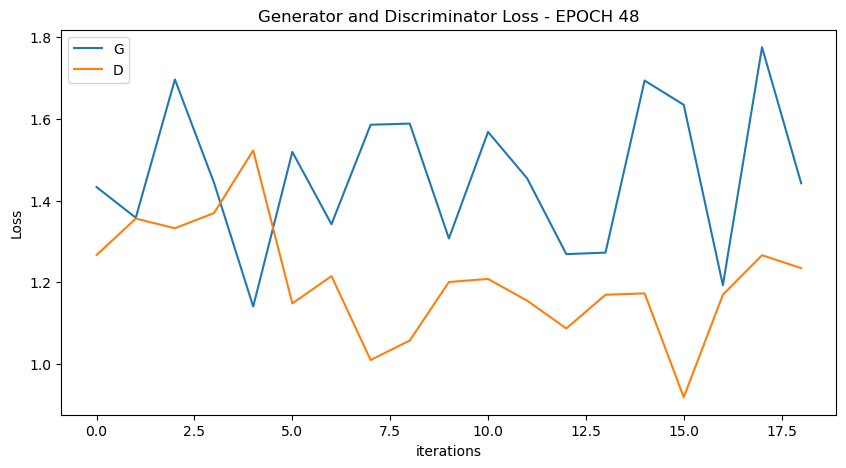

  0%|          | 0/19 [00:00<?, ?it/s]

[50/100][9/19] Loss_D: 1.5267 Loss_G: 1.5300 D(x): 0.4596 D(G(z)): 0.4784 / 0.2055
[50/100][18/19] Loss_D: 1.2332 Loss_G: 1.4390 D(x): 0.4848 D(G(z)): 0.3564 / 0.2283


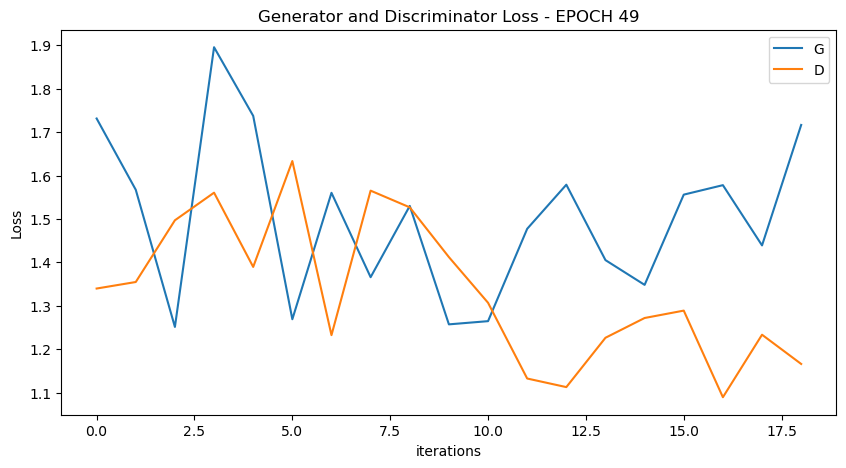

  0%|          | 0/19 [00:00<?, ?it/s]

[51/100][9/19] Loss_D: 1.2044 Loss_G: 1.3897 D(x): 0.5094 D(G(z)): 0.3800 / 0.2433
[51/100][18/19] Loss_D: 1.1524 Loss_G: 1.3680 D(x): 0.5014 D(G(z)): 0.3298 / 0.2444


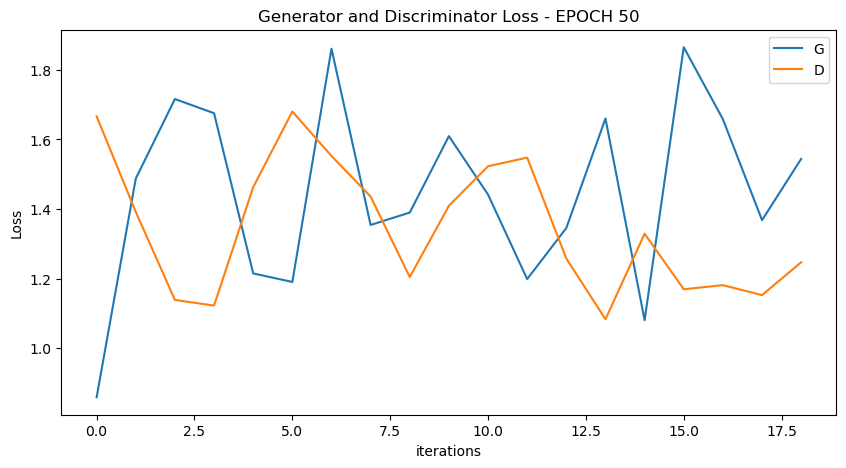

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


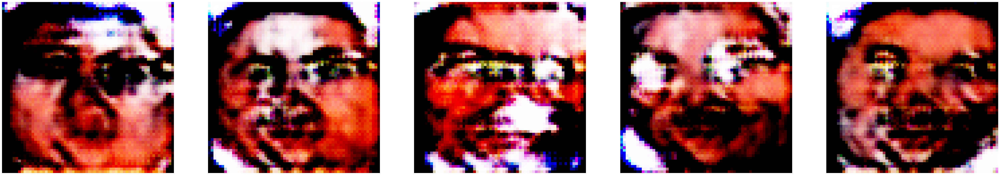

  0%|          | 0/19 [00:00<?, ?it/s]

[52/100][9/19] Loss_D: 1.3360 Loss_G: 1.0884 D(x): 0.4745 D(G(z)): 0.4307 / 0.3235
[52/100][18/19] Loss_D: 1.1747 Loss_G: 1.3279 D(x): 0.5758 D(G(z)): 0.4202 / 0.2556


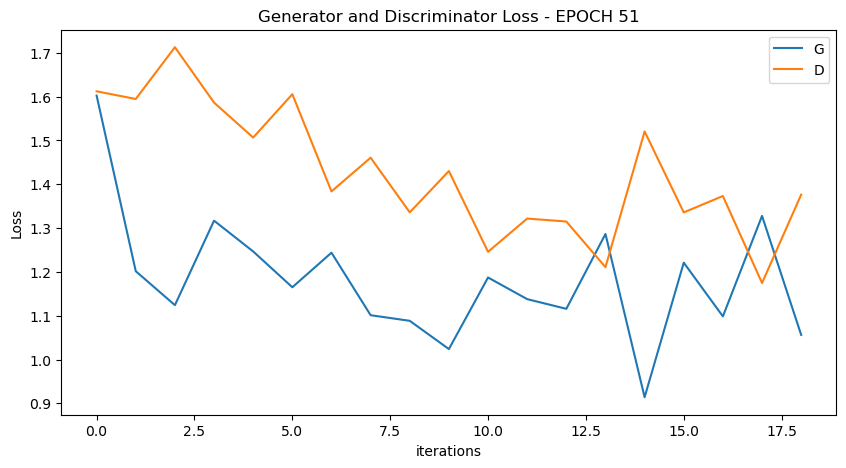

  0%|          | 0/19 [00:00<?, ?it/s]

[53/100][9/19] Loss_D: 1.2101 Loss_G: 1.2468 D(x): 0.5435 D(G(z)): 0.4133 / 0.2717
[53/100][18/19] Loss_D: 1.1894 Loss_G: 1.2765 D(x): 0.4822 D(G(z)): 0.3154 / 0.2684


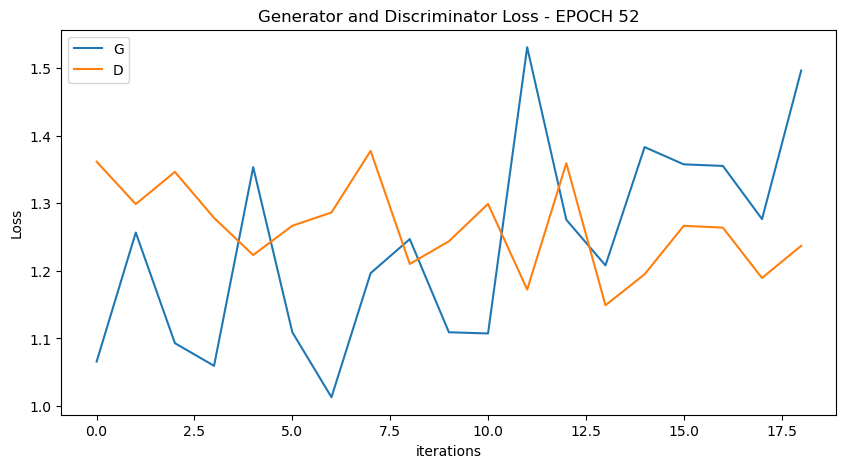

  0%|          | 0/19 [00:00<?, ?it/s]

[54/100][9/19] Loss_D: 1.2003 Loss_G: 1.3580 D(x): 0.5391 D(G(z)): 0.4037 / 0.2361
[54/100][18/19] Loss_D: 1.3875 Loss_G: 1.1185 D(x): 0.4449 D(G(z)): 0.4045 / 0.3132


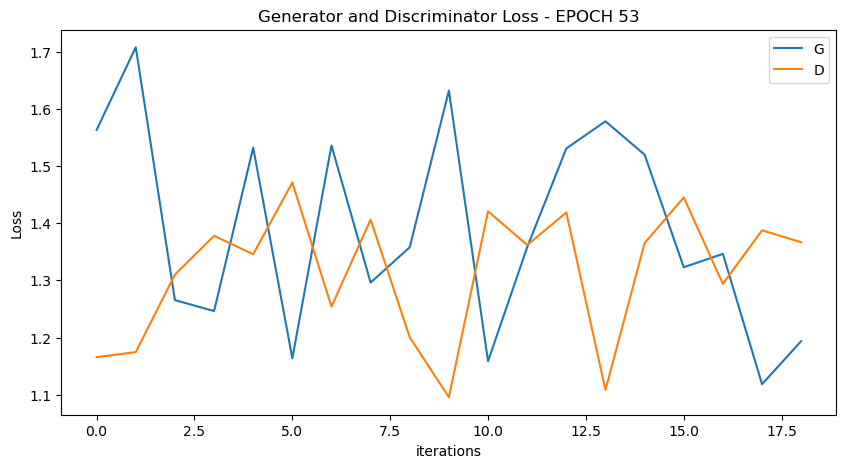

  0%|          | 0/19 [00:00<?, ?it/s]

[55/100][9/19] Loss_D: 1.2935 Loss_G: 1.7189 D(x): 0.5159 D(G(z)): 0.4174 / 0.1693
[55/100][18/19] Loss_D: 1.4673 Loss_G: 1.2355 D(x): 0.3793 D(G(z)): 0.3835 / 0.2805


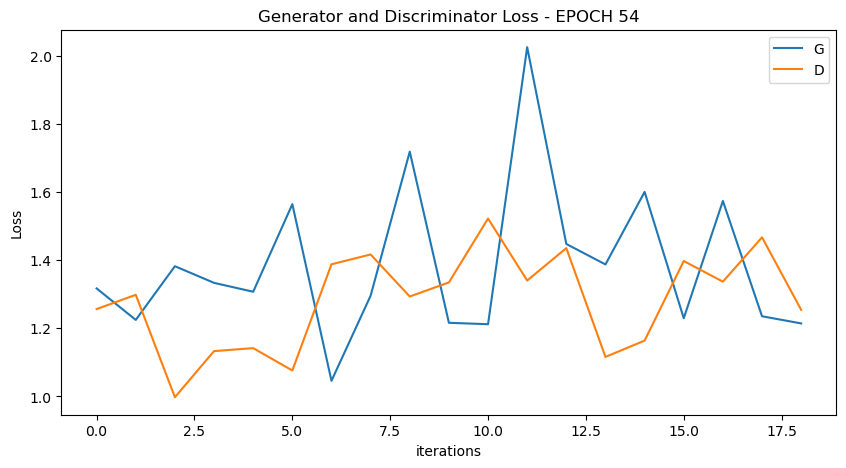

  0%|          | 0/19 [00:00<?, ?it/s]

[56/100][9/19] Loss_D: 1.3455 Loss_G: 1.3362 D(x): 0.5185 D(G(z)): 0.4669 / 0.2468
[56/100][18/19] Loss_D: 1.1403 Loss_G: 1.4998 D(x): 0.5340 D(G(z)): 0.3165 / 0.2072


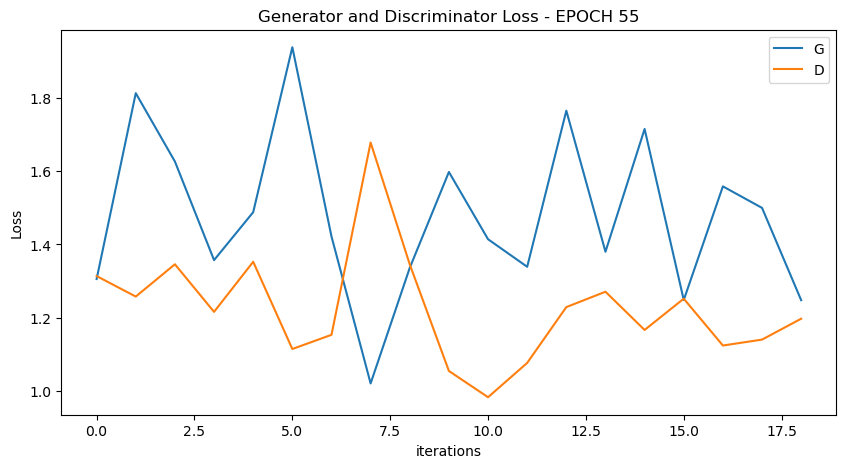

  0%|          | 0/19 [00:00<?, ?it/s]

[57/100][9/19] Loss_D: 1.3789 Loss_G: 1.0740 D(x): 0.4087 D(G(z)): 0.3700 / 0.3411
[57/100][18/19] Loss_D: 1.2087 Loss_G: 1.4914 D(x): 0.6122 D(G(z)): 0.4602 / 0.2160


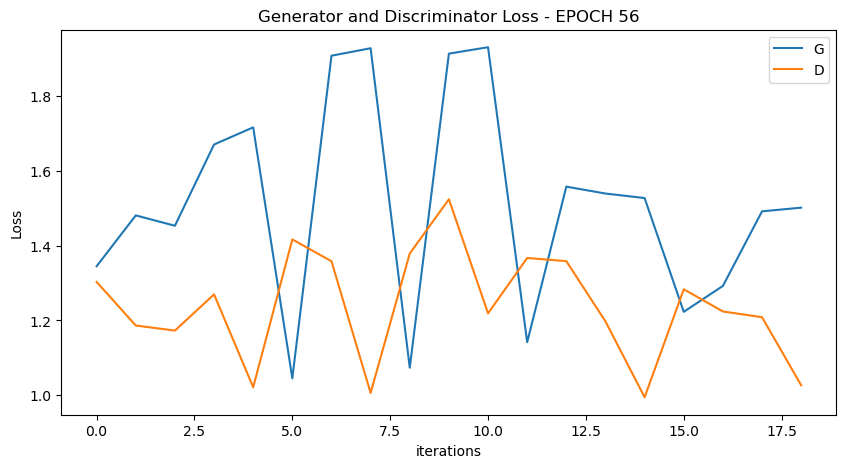

  0%|          | 0/19 [00:00<?, ?it/s]

[58/100][9/19] Loss_D: 1.3985 Loss_G: 1.6920 D(x): 0.5563 D(G(z)): 0.5062 / 0.1736
[58/100][18/19] Loss_D: 1.1124 Loss_G: 1.3923 D(x): 0.4741 D(G(z)): 0.2634 / 0.2306


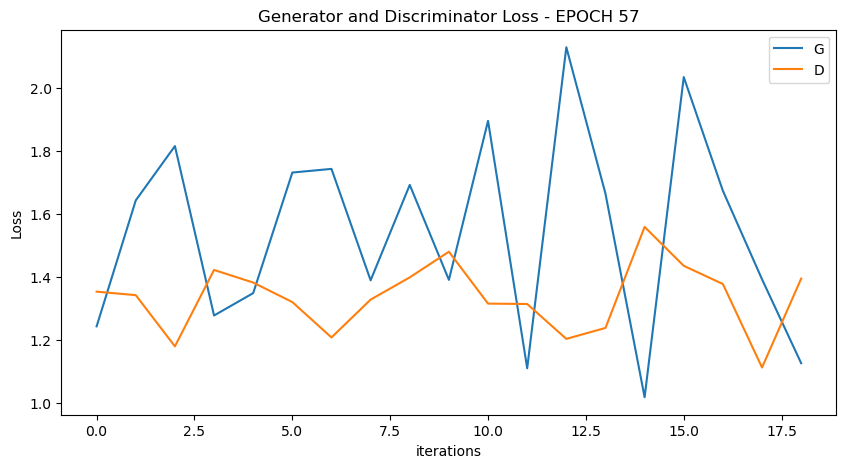

  0%|          | 0/19 [00:00<?, ?it/s]

[59/100][9/19] Loss_D: 1.0865 Loss_G: 1.2177 D(x): 0.5153 D(G(z)): 0.2996 / 0.2900
[59/100][18/19] Loss_D: 1.4040 Loss_G: 1.2333 D(x): 0.3935 D(G(z)): 0.3438 / 0.2731


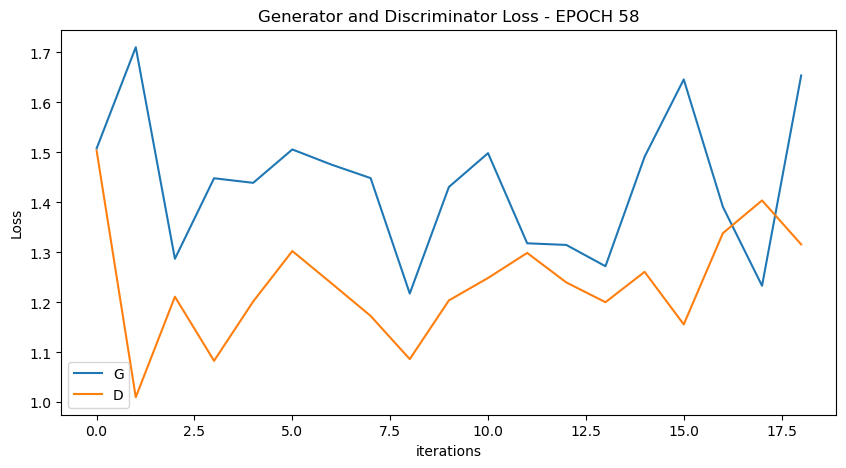

  0%|          | 0/19 [00:00<?, ?it/s]

[60/100][9/19] Loss_D: 1.2792 Loss_G: 1.2694 D(x): 0.4157 D(G(z)): 0.2782 / 0.2723
[60/100][18/19] Loss_D: 1.5578 Loss_G: 1.1049 D(x): 0.3133 D(G(z)): 0.3132 / 0.3330


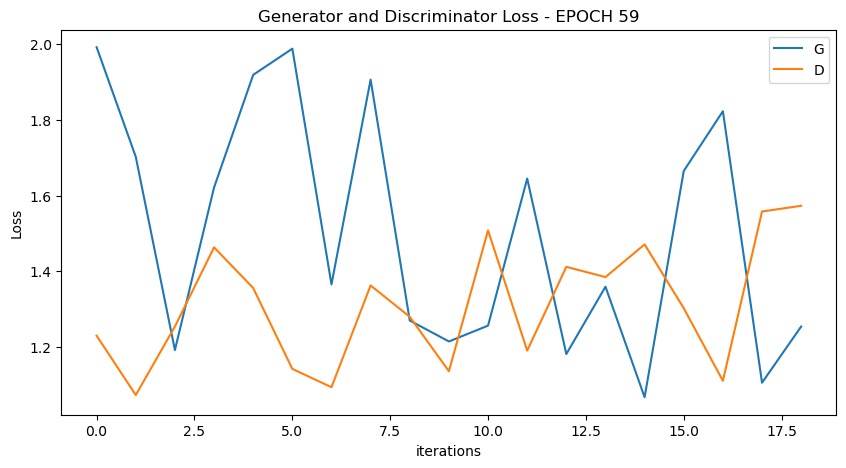

  0%|          | 0/19 [00:00<?, ?it/s]

[61/100][9/19] Loss_D: 1.2516 Loss_G: 1.7439 D(x): 0.4511 D(G(z)): 0.3387 / 0.1621
[61/100][18/19] Loss_D: 1.0006 Loss_G: 1.6893 D(x): 0.6336 D(G(z)): 0.3538 / 0.1692


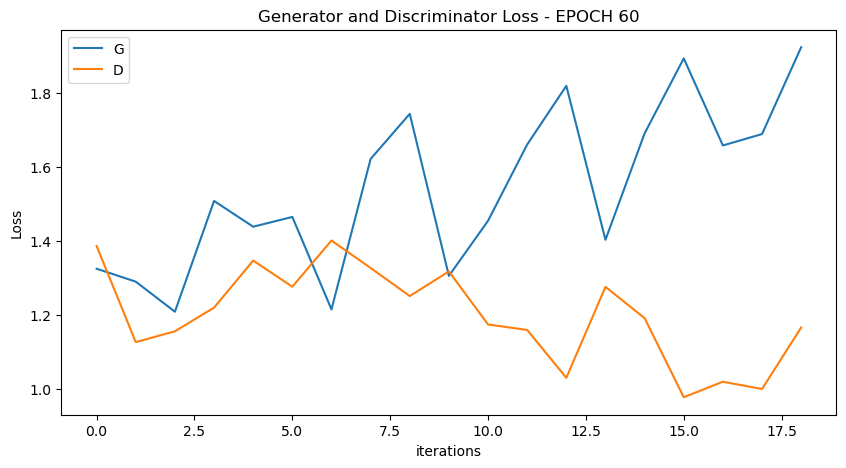

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


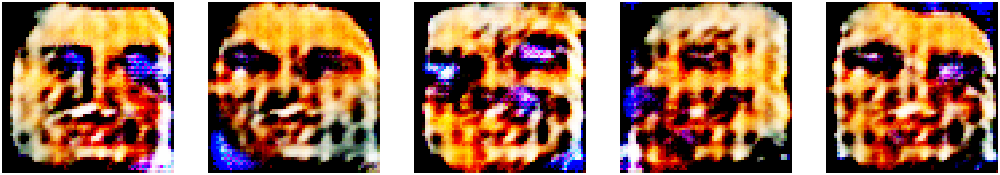

  0%|          | 0/19 [00:00<?, ?it/s]

[62/100][9/19] Loss_D: 1.3359 Loss_G: 1.7637 D(x): 0.5616 D(G(z)): 0.4785 / 0.1596
[62/100][18/19] Loss_D: 1.6590 Loss_G: 0.9946 D(x): 0.2636 D(G(z)): 0.2788 / 0.3767


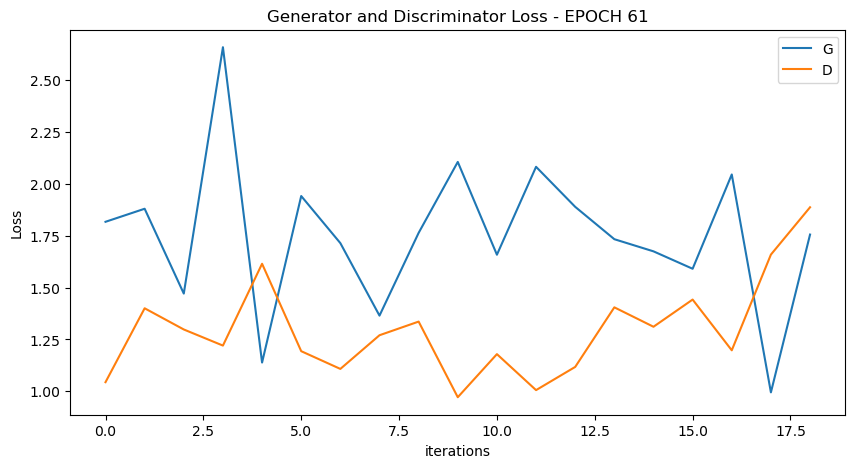

  0%|          | 0/19 [00:00<?, ?it/s]

[63/100][9/19] Loss_D: 1.1666 Loss_G: 1.5369 D(x): 0.5348 D(G(z)): 0.3667 / 0.2142
[63/100][18/19] Loss_D: 1.3476 Loss_G: 1.4096 D(x): 0.5228 D(G(z)): 0.4374 / 0.2278


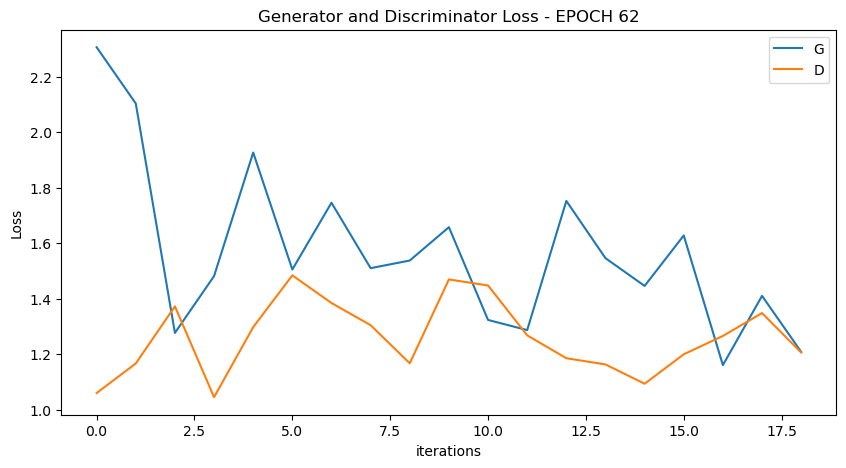

  0%|          | 0/19 [00:00<?, ?it/s]

[64/100][9/19] Loss_D: 1.1529 Loss_G: 1.4274 D(x): 0.6776 D(G(z)): 0.4802 / 0.2239
[64/100][18/19] Loss_D: 1.3964 Loss_G: 1.5442 D(x): 0.4886 D(G(z)): 0.4427 / 0.2098


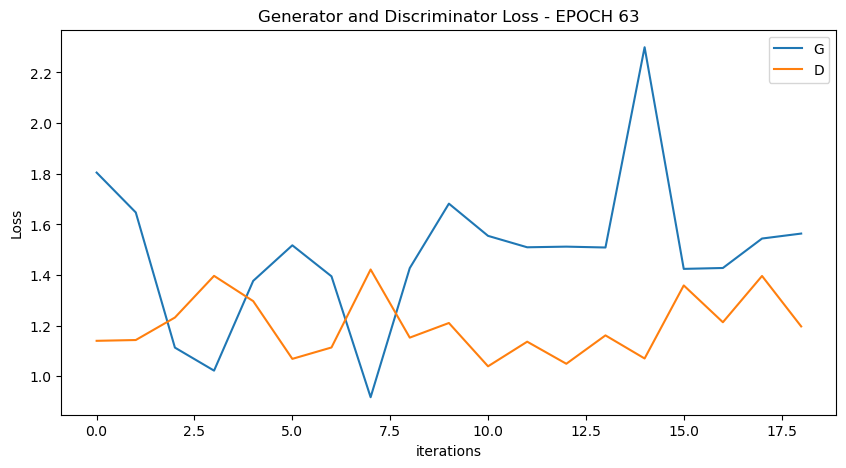

  0%|          | 0/19 [00:00<?, ?it/s]

[65/100][9/19] Loss_D: 1.2695 Loss_G: 1.6062 D(x): 0.5961 D(G(z)): 0.4733 / 0.1942
[65/100][18/19] Loss_D: 1.3332 Loss_G: 1.4600 D(x): 0.5806 D(G(z)): 0.5082 / 0.2251


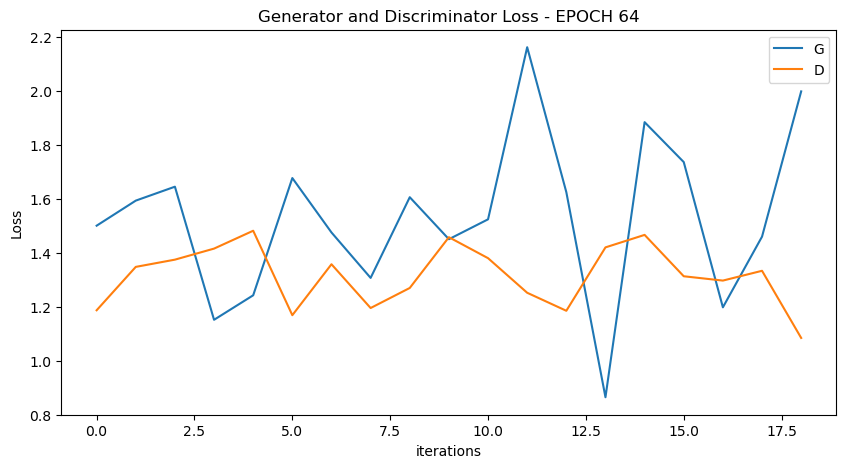

  0%|          | 0/19 [00:00<?, ?it/s]

[66/100][9/19] Loss_D: 1.2752 Loss_G: 1.4270 D(x): 0.4918 D(G(z)): 0.3820 / 0.2337
[66/100][18/19] Loss_D: 1.0521 Loss_G: 1.9495 D(x): 0.7217 D(G(z)): 0.4403 / 0.1367


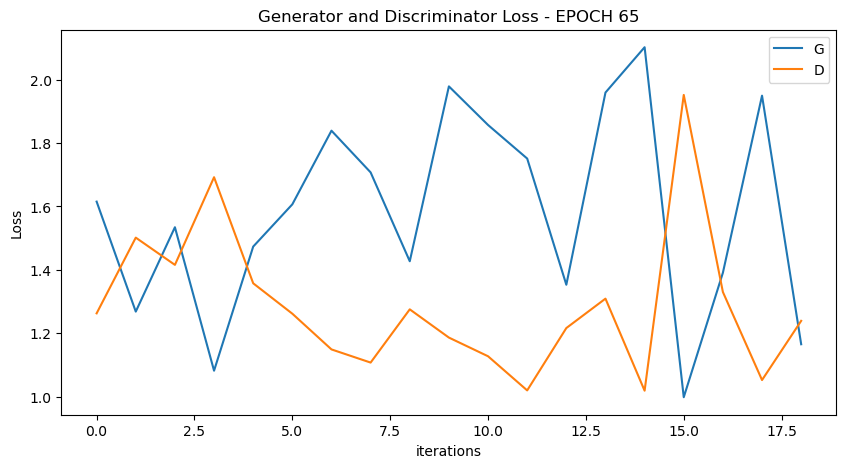

  0%|          | 0/19 [00:00<?, ?it/s]

[67/100][9/19] Loss_D: 1.1914 Loss_G: 1.5209 D(x): 0.5416 D(G(z)): 0.3937 / 0.2116
[67/100][18/19] Loss_D: 1.4232 Loss_G: 1.2780 D(x): 0.5954 D(G(z)): 0.5219 / 0.2866


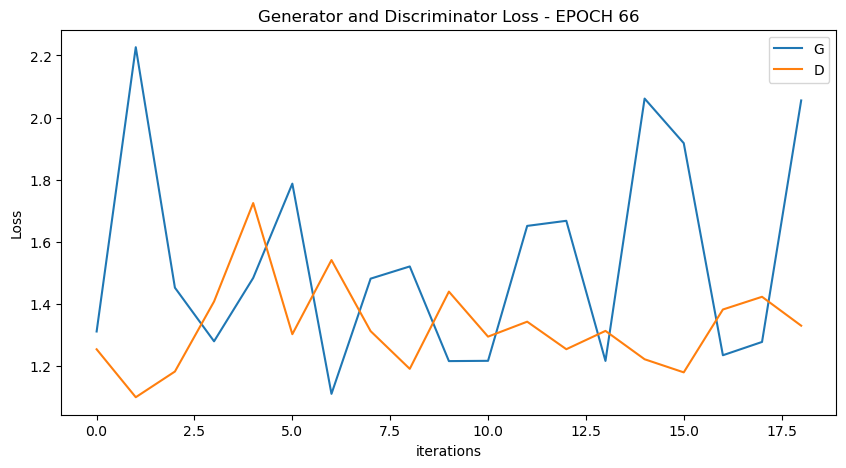

  0%|          | 0/19 [00:00<?, ?it/s]

[68/100][9/19] Loss_D: 1.1174 Loss_G: 1.8258 D(x): 0.5798 D(G(z)): 0.3699 / 0.1574
[68/100][18/19] Loss_D: 1.3876 Loss_G: 1.2662 D(x): 0.4312 D(G(z)): 0.3936 / 0.2798


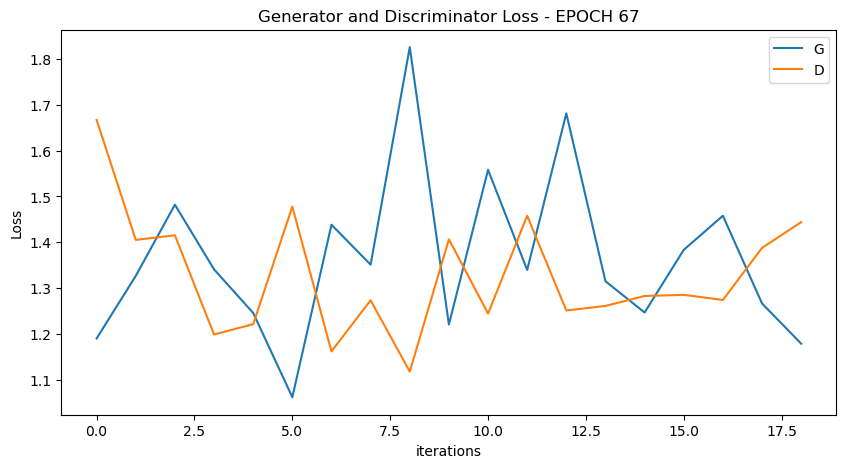

  0%|          | 0/19 [00:00<?, ?it/s]

[69/100][9/19] Loss_D: 1.3735 Loss_G: 0.9945 D(x): 0.3786 D(G(z)): 0.3370 / 0.3595
[69/100][18/19] Loss_D: 1.1891 Loss_G: 1.4750 D(x): 0.5515 D(G(z)): 0.4045 / 0.2121


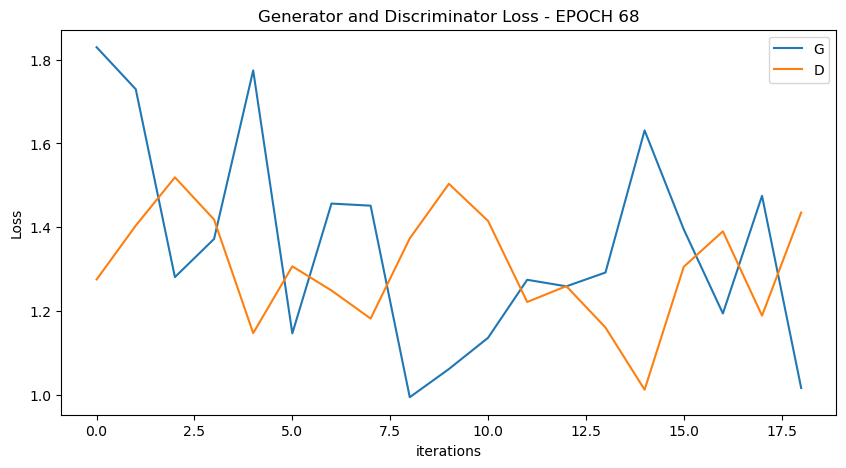

  0%|          | 0/19 [00:00<?, ?it/s]

[70/100][9/19] Loss_D: 1.0939 Loss_G: 1.5025 D(x): 0.5280 D(G(z)): 0.3330 / 0.2105
[70/100][18/19] Loss_D: 1.4174 Loss_G: 1.3886 D(x): 0.4883 D(G(z)): 0.4601 / 0.2410


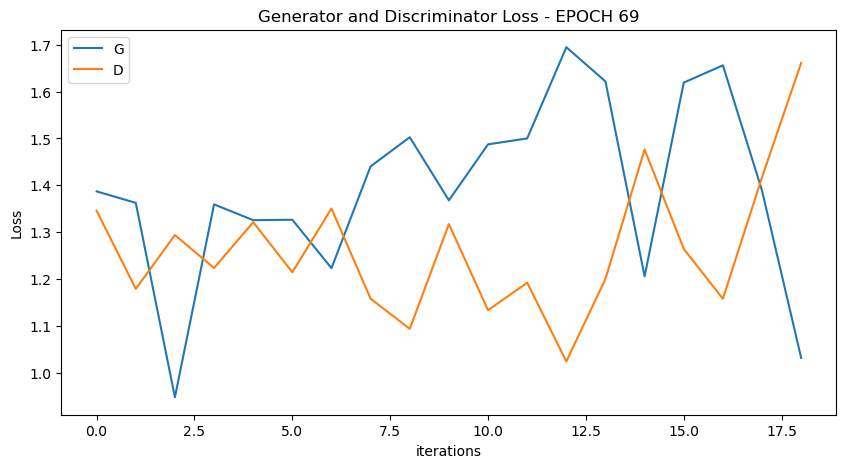

  0%|          | 0/19 [00:00<?, ?it/s]

[71/100][9/19] Loss_D: 1.5357 Loss_G: 0.9633 D(x): 0.2643 D(G(z)): 0.2047 / 0.3792
[71/100][18/19] Loss_D: 1.0817 Loss_G: 1.8180 D(x): 0.6878 D(G(z)): 0.4364 / 0.1496


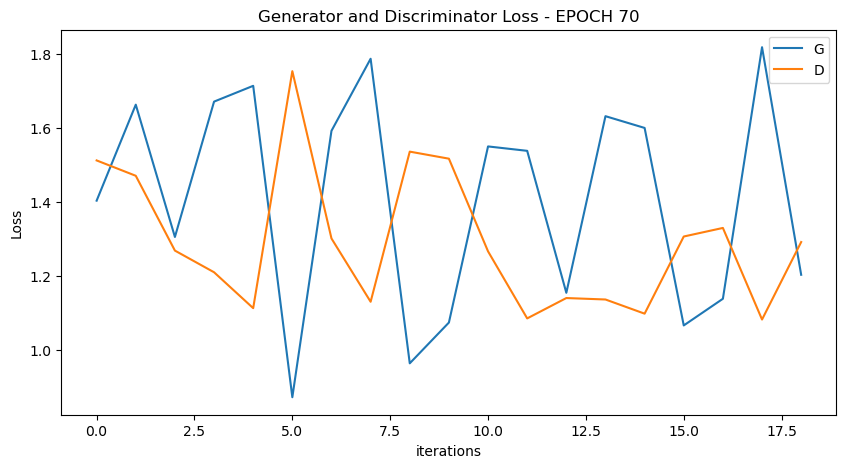

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


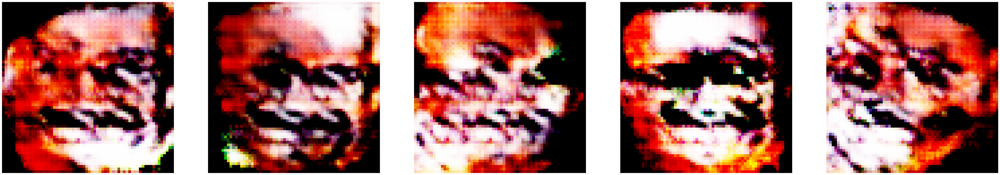

  0%|          | 0/19 [00:00<?, ?it/s]

[72/100][9/19] Loss_D: 1.2732 Loss_G: 1.3648 D(x): 0.4662 D(G(z)): 0.3774 / 0.2374
[72/100][18/19] Loss_D: 1.1773 Loss_G: 2.5797 D(x): 0.5842 D(G(z)): 0.4121 / 0.0669


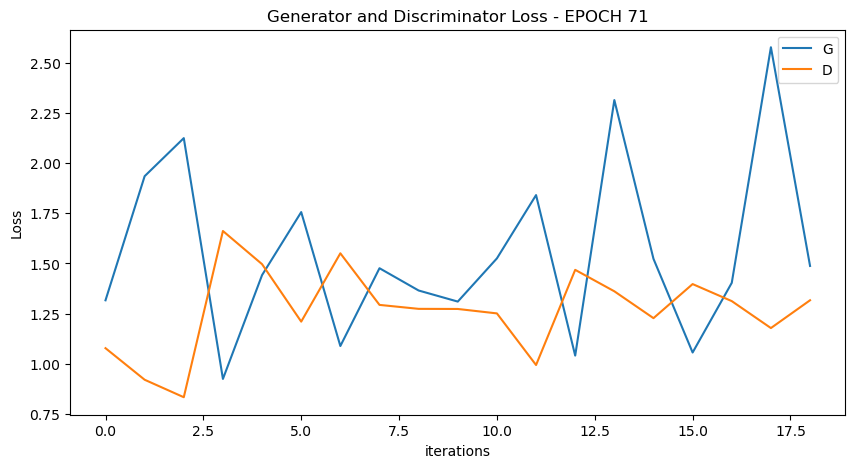

  0%|          | 0/19 [00:00<?, ?it/s]

[73/100][9/19] Loss_D: 1.3359 Loss_G: 1.1886 D(x): 0.4311 D(G(z)): 0.3521 / 0.2944
[73/100][18/19] Loss_D: 1.2557 Loss_G: 1.1763 D(x): 0.4445 D(G(z)): 0.3462 / 0.2921


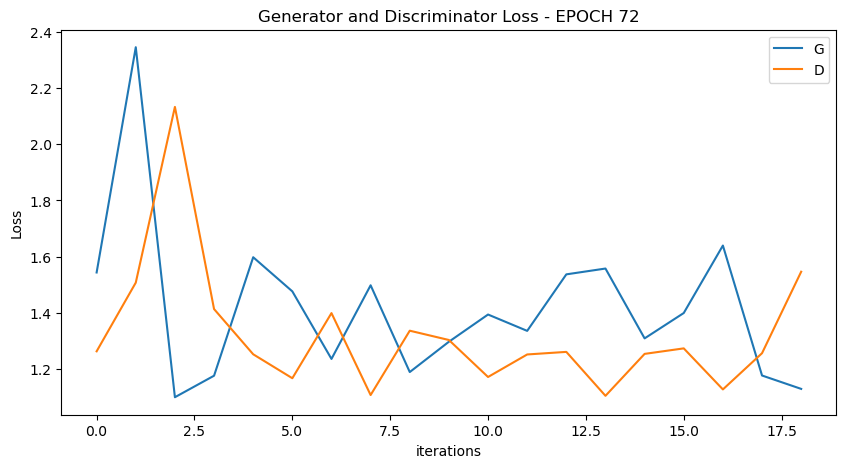

  0%|          | 0/19 [00:00<?, ?it/s]

[74/100][9/19] Loss_D: 1.2897 Loss_G: 1.4738 D(x): 0.5326 D(G(z)): 0.4444 / 0.2159
[74/100][18/19] Loss_D: 1.1146 Loss_G: 1.5159 D(x): 0.5222 D(G(z)): 0.3312 / 0.2093


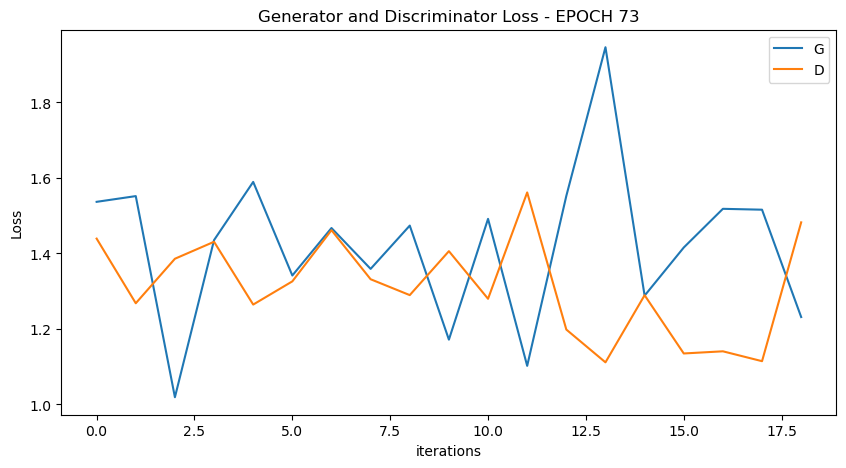

  0%|          | 0/19 [00:00<?, ?it/s]

[75/100][9/19] Loss_D: 1.4300 Loss_G: 1.8040 D(x): 0.6555 D(G(z)): 0.5785 / 0.1480
[75/100][18/19] Loss_D: 1.3408 Loss_G: 1.1218 D(x): 0.5263 D(G(z)): 0.4705 / 0.3220


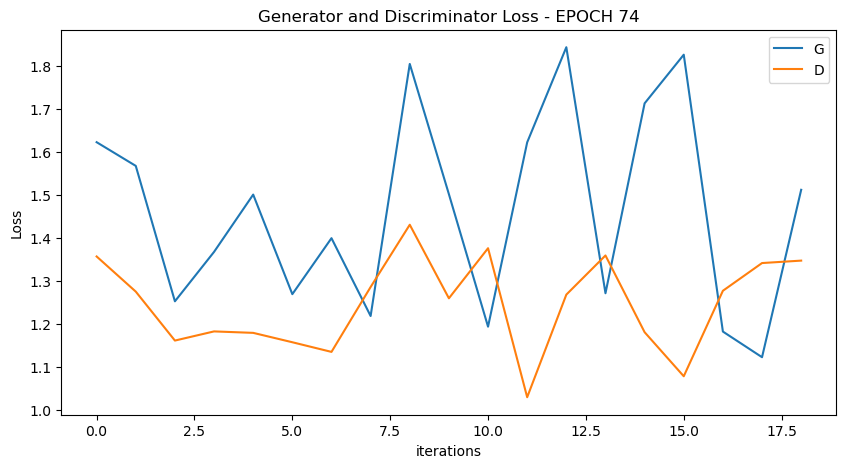

  0%|          | 0/19 [00:00<?, ?it/s]

[76/100][9/19] Loss_D: 1.3707 Loss_G: 1.4160 D(x): 0.6751 D(G(z)): 0.5776 / 0.2337
[76/100][18/19] Loss_D: 1.2851 Loss_G: 1.4027 D(x): 0.4579 D(G(z)): 0.3631 / 0.2310


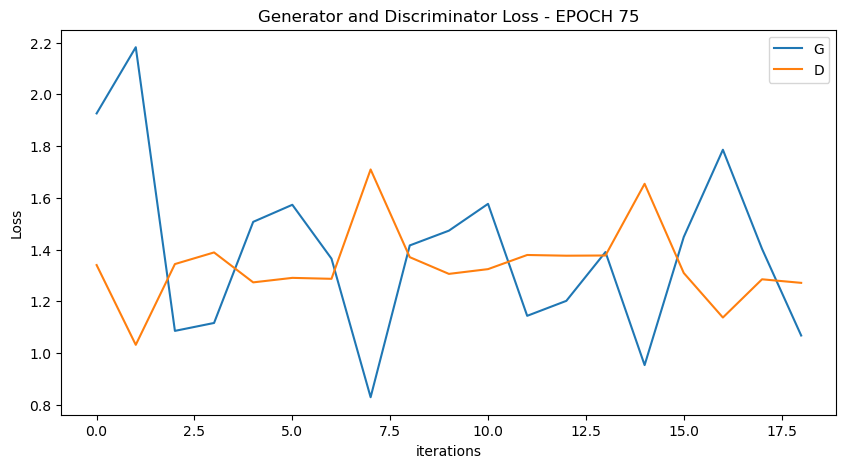

  0%|          | 0/19 [00:00<?, ?it/s]

[77/100][9/19] Loss_D: 1.6631 Loss_G: 1.1621 D(x): 0.3202 D(G(z)): 0.4026 / 0.3110
[77/100][18/19] Loss_D: 1.2490 Loss_G: 1.2092 D(x): 0.5222 D(G(z)): 0.4064 / 0.2884


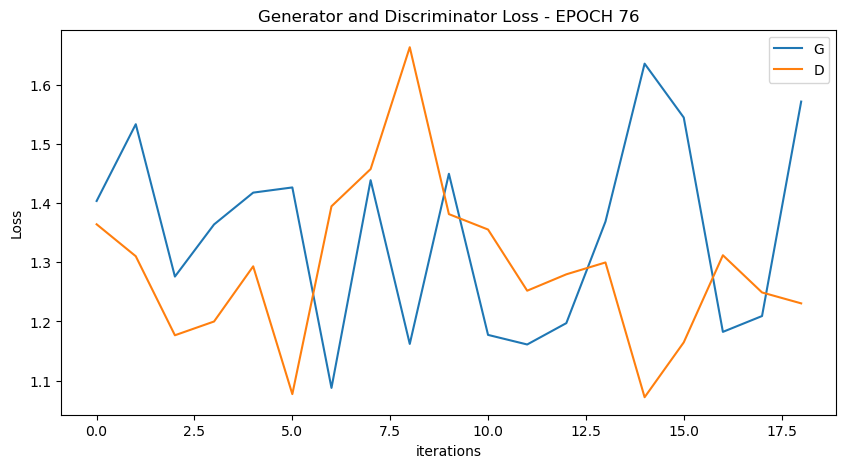

  0%|          | 0/19 [00:00<?, ?it/s]

[78/100][9/19] Loss_D: 1.3658 Loss_G: 1.4350 D(x): 0.6025 D(G(z)): 0.5224 / 0.2208
[78/100][18/19] Loss_D: 1.1215 Loss_G: 1.7205 D(x): 0.5654 D(G(z)): 0.3786 / 0.1625


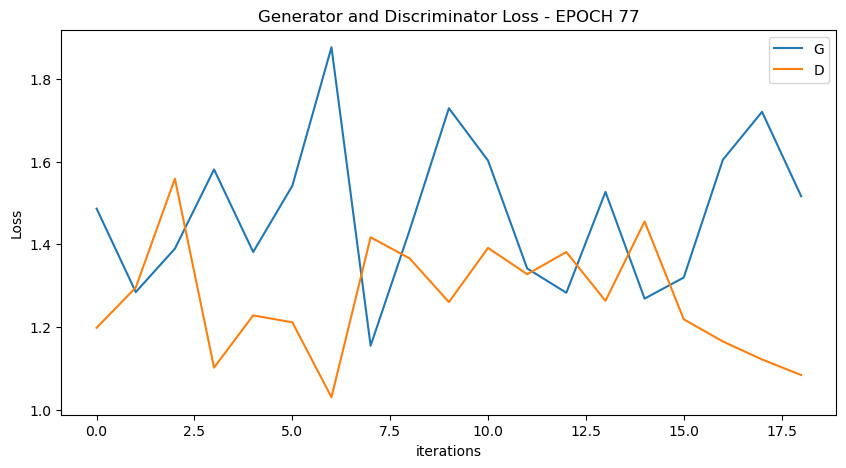

  0%|          | 0/19 [00:00<?, ?it/s]

[79/100][9/19] Loss_D: 1.3896 Loss_G: 1.3594 D(x): 0.4953 D(G(z)): 0.4609 / 0.2439
[79/100][18/19] Loss_D: 1.4949 Loss_G: 1.2658 D(x): 0.5559 D(G(z)): 0.5418 / 0.2769


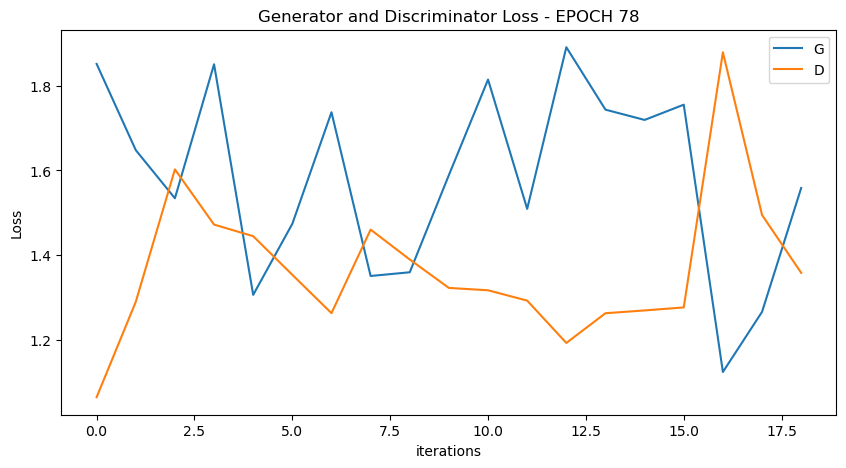

  0%|          | 0/19 [00:00<?, ?it/s]

[80/100][9/19] Loss_D: 1.1695 Loss_G: 1.5295 D(x): 0.4964 D(G(z)): 0.3403 / 0.1977
[80/100][18/19] Loss_D: 1.2369 Loss_G: 1.8784 D(x): 0.6028 D(G(z)): 0.4446 / 0.1406


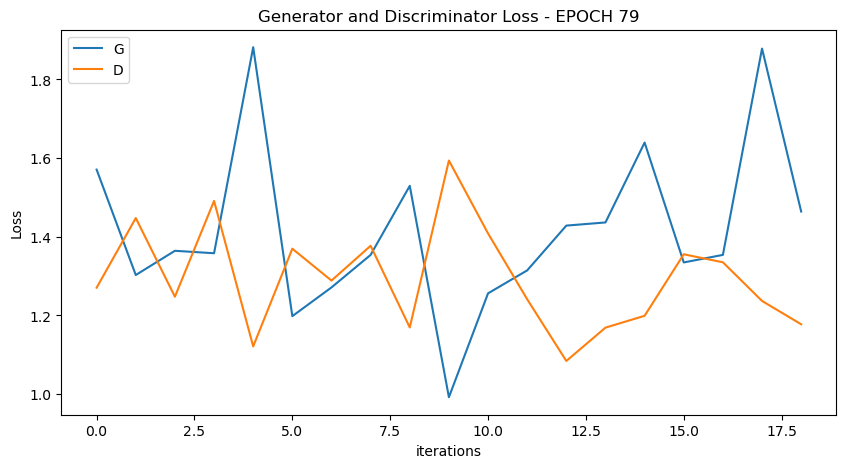

  0%|          | 0/19 [00:00<?, ?it/s]

[81/100][9/19] Loss_D: 1.3390 Loss_G: 1.3671 D(x): 0.3767 D(G(z)): 0.2941 / 0.2394
[81/100][18/19] Loss_D: 1.1976 Loss_G: 1.5181 D(x): 0.4956 D(G(z)): 0.3670 / 0.2090


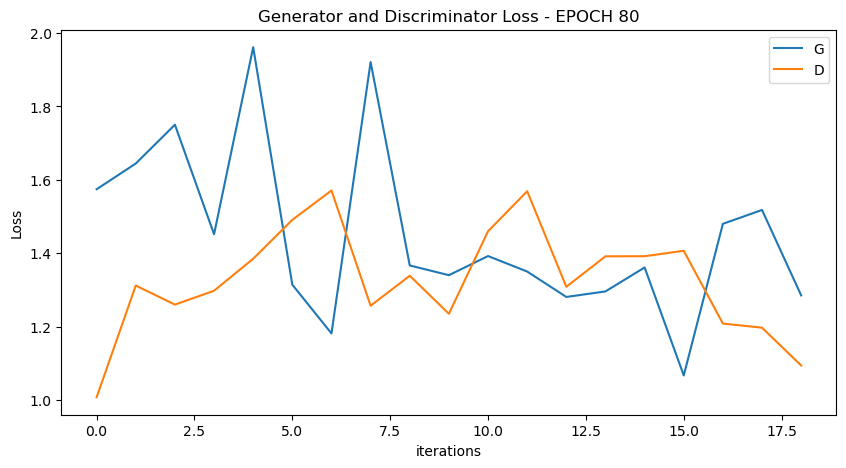

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


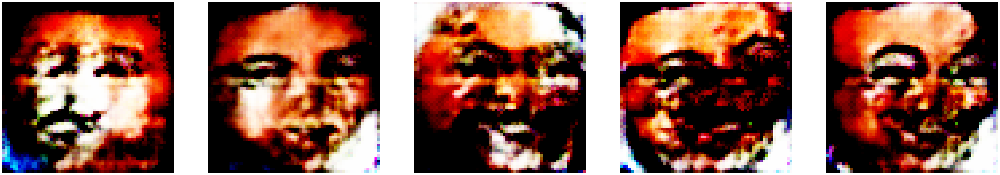

  0%|          | 0/19 [00:00<?, ?it/s]

[82/100][9/19] Loss_D: 1.5356 Loss_G: 1.1149 D(x): 0.3587 D(G(z)): 0.3958 / 0.3174
[82/100][18/19] Loss_D: 1.2183 Loss_G: 1.2019 D(x): 0.6028 D(G(z)): 0.4571 / 0.2887


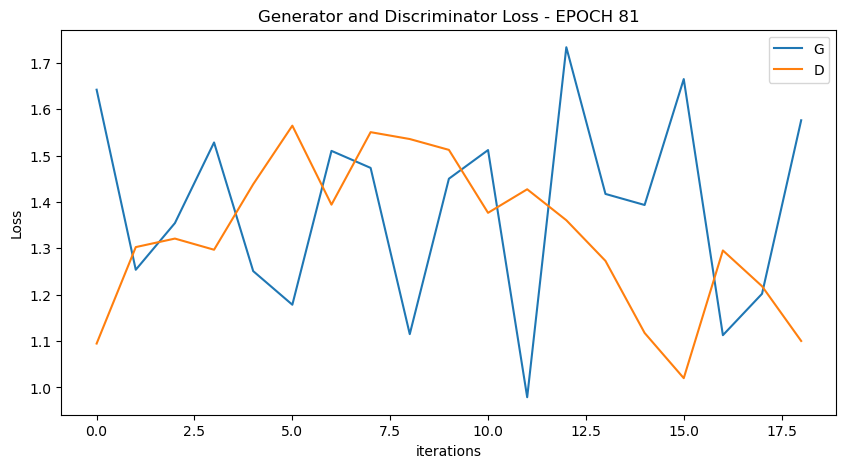

  0%|          | 0/19 [00:00<?, ?it/s]

[83/100][9/19] Loss_D: 1.1686 Loss_G: 1.6796 D(x): 0.5164 D(G(z)): 0.3547 / 0.1730
[83/100][18/19] Loss_D: 1.5833 Loss_G: 1.3141 D(x): 0.3164 D(G(z)): 0.3323 / 0.2508


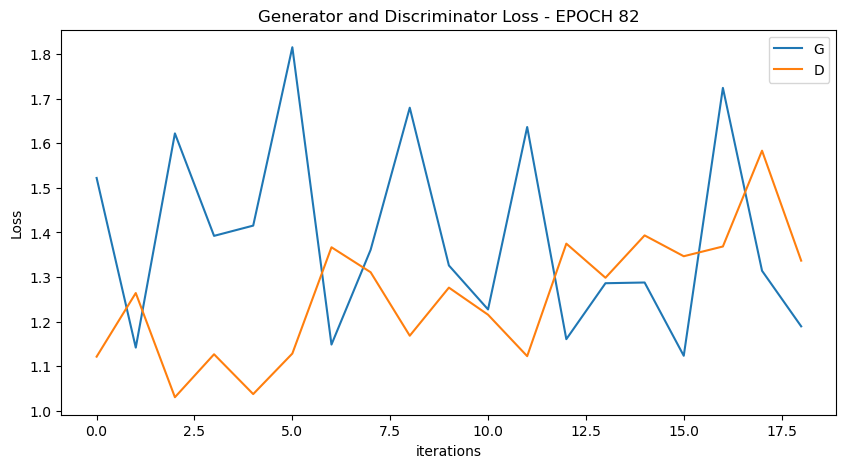

  0%|          | 0/19 [00:00<?, ?it/s]

[84/100][9/19] Loss_D: 1.3794 Loss_G: 1.3127 D(x): 0.4591 D(G(z)): 0.3840 / 0.2512
[84/100][18/19] Loss_D: 1.1519 Loss_G: 1.0657 D(x): 0.5038 D(G(z)): 0.3354 / 0.3396


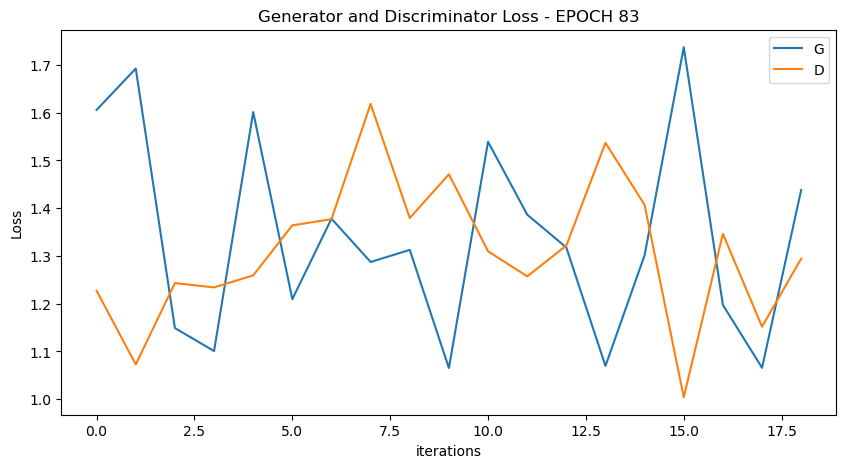

  0%|          | 0/19 [00:00<?, ?it/s]

[85/100][9/19] Loss_D: 1.2730 Loss_G: 1.7260 D(x): 0.6174 D(G(z)): 0.4924 / 0.1586
[85/100][18/19] Loss_D: 1.2900 Loss_G: 1.2917 D(x): 0.5368 D(G(z)): 0.4392 / 0.2663


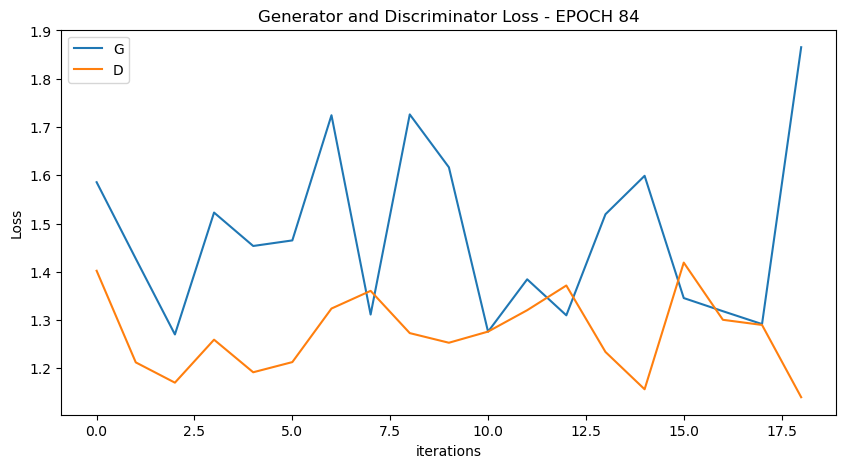

  0%|          | 0/19 [00:00<?, ?it/s]

[86/100][9/19] Loss_D: 1.3293 Loss_G: 1.2850 D(x): 0.4883 D(G(z)): 0.4176 / 0.2655
[86/100][18/19] Loss_D: 1.3888 Loss_G: 1.4567 D(x): 0.4062 D(G(z)): 0.3385 / 0.2256


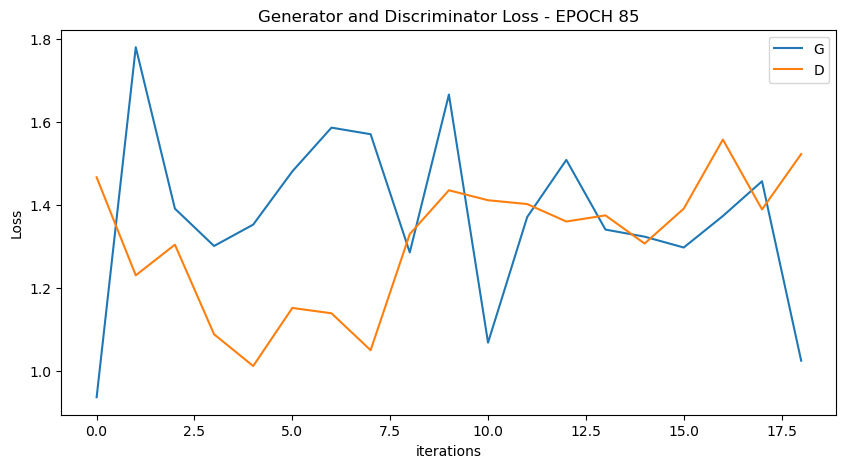

  0%|          | 0/19 [00:00<?, ?it/s]

[87/100][9/19] Loss_D: 1.2121 Loss_G: 1.5045 D(x): 0.4915 D(G(z)): 0.3714 / 0.2012
[87/100][18/19] Loss_D: 1.1947 Loss_G: 1.4405 D(x): 0.5983 D(G(z)): 0.4289 / 0.2216


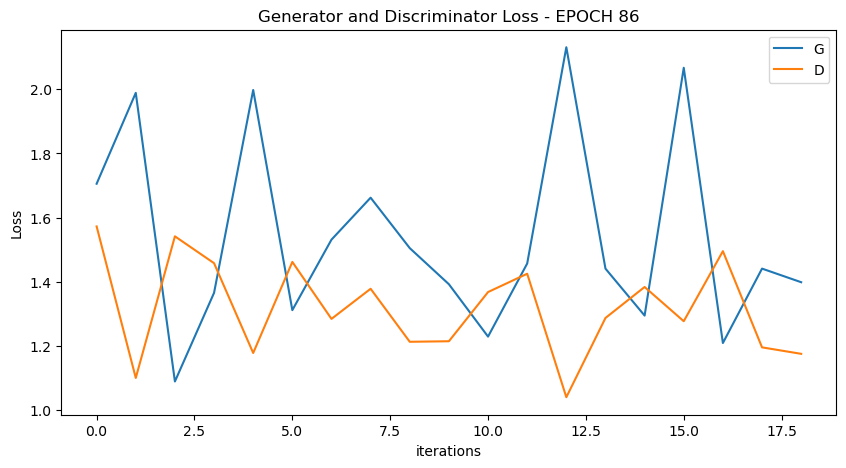

  0%|          | 0/19 [00:00<?, ?it/s]

[88/100][9/19] Loss_D: 1.0545 Loss_G: 1.7920 D(x): 0.5690 D(G(z)): 0.3427 / 0.1582
[88/100][18/19] Loss_D: 1.3331 Loss_G: 1.5586 D(x): 0.4756 D(G(z)): 0.4090 / 0.1912


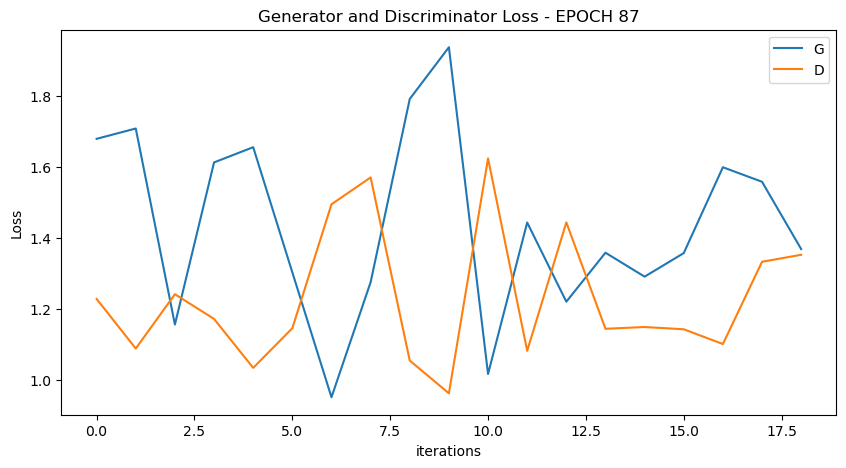

  0%|          | 0/19 [00:00<?, ?it/s]

[89/100][9/19] Loss_D: 1.1086 Loss_G: 1.5625 D(x): 0.5597 D(G(z)): 0.3655 / 0.1979
[89/100][18/19] Loss_D: 1.3639 Loss_G: 1.3105 D(x): 0.4875 D(G(z)): 0.4431 / 0.2513


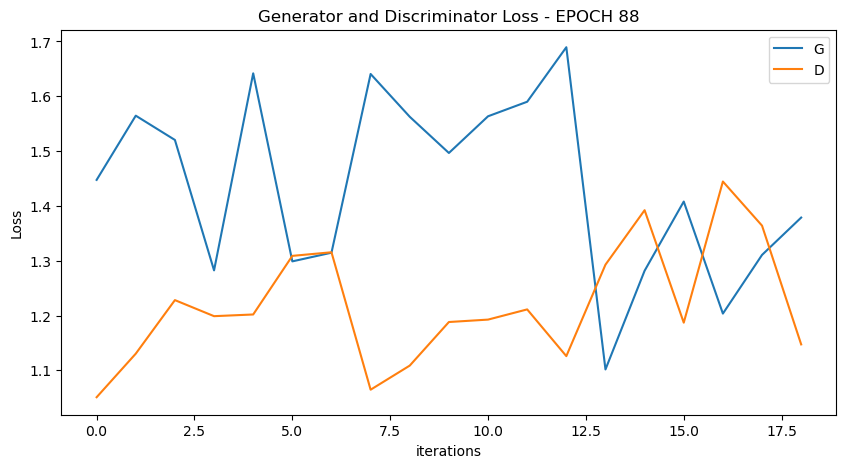

  0%|          | 0/19 [00:00<?, ?it/s]

[90/100][9/19] Loss_D: 1.1797 Loss_G: 1.4642 D(x): 0.5139 D(G(z)): 0.3695 / 0.2134
[90/100][18/19] Loss_D: 1.2225 Loss_G: 1.5121 D(x): 0.6341 D(G(z)): 0.4727 / 0.2092


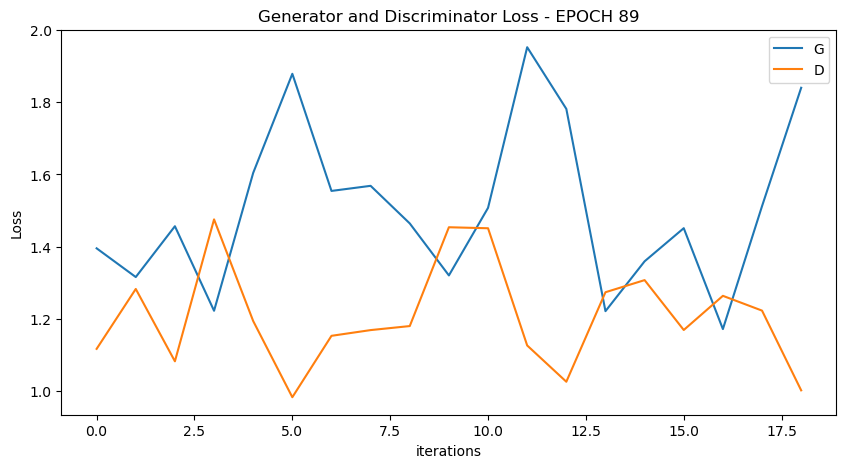

  0%|          | 0/19 [00:00<?, ?it/s]

[91/100][9/19] Loss_D: 1.0478 Loss_G: 1.6205 D(x): 0.5504 D(G(z)): 0.3177 / 0.1899
[91/100][18/19] Loss_D: 1.4584 Loss_G: 1.3558 D(x): 0.4329 D(G(z)): 0.4268 / 0.2486


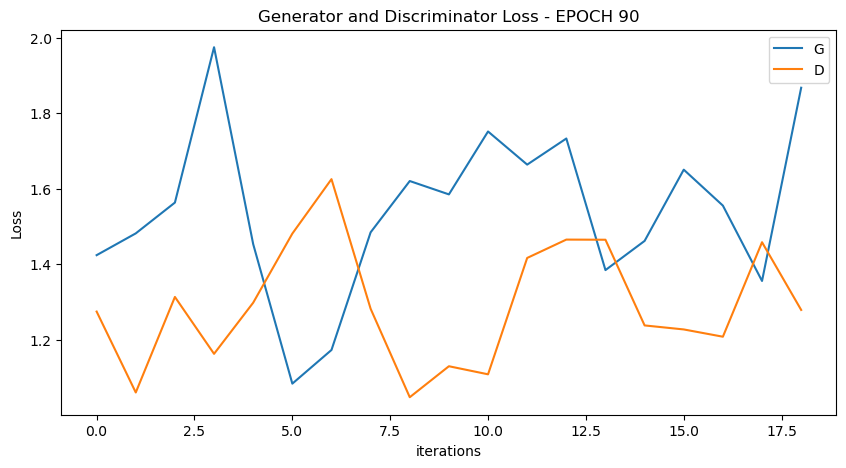

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


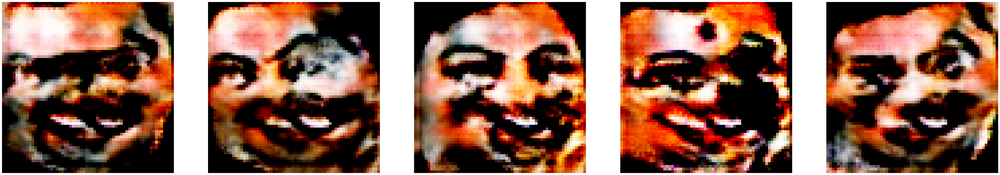

  0%|          | 0/19 [00:00<?, ?it/s]

[92/100][9/19] Loss_D: 1.1379 Loss_G: 1.5158 D(x): 0.5336 D(G(z)): 0.3503 / 0.1995
[92/100][18/19] Loss_D: 1.2556 Loss_G: 1.7682 D(x): 0.5139 D(G(z)): 0.4074 / 0.1577


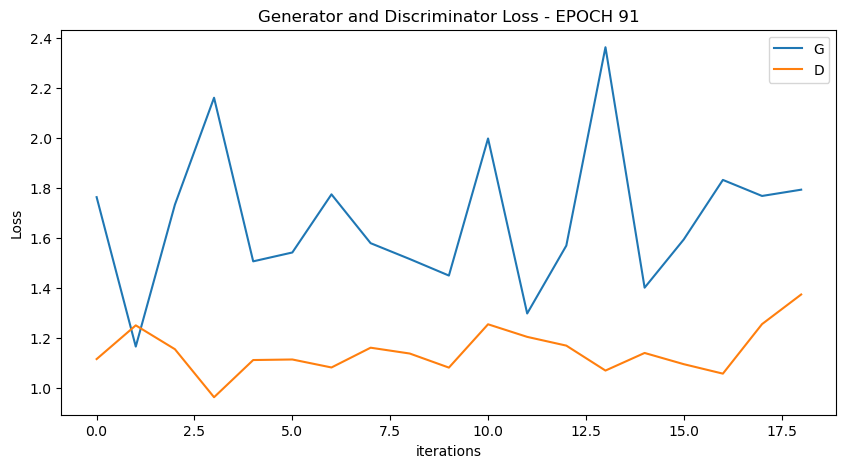

  0%|          | 0/19 [00:00<?, ?it/s]

[93/100][9/19] Loss_D: 1.3343 Loss_G: 1.9712 D(x): 0.6015 D(G(z)): 0.5174 / 0.1301
[93/100][18/19] Loss_D: 1.2537 Loss_G: 1.1361 D(x): 0.4759 D(G(z)): 0.3514 / 0.3301


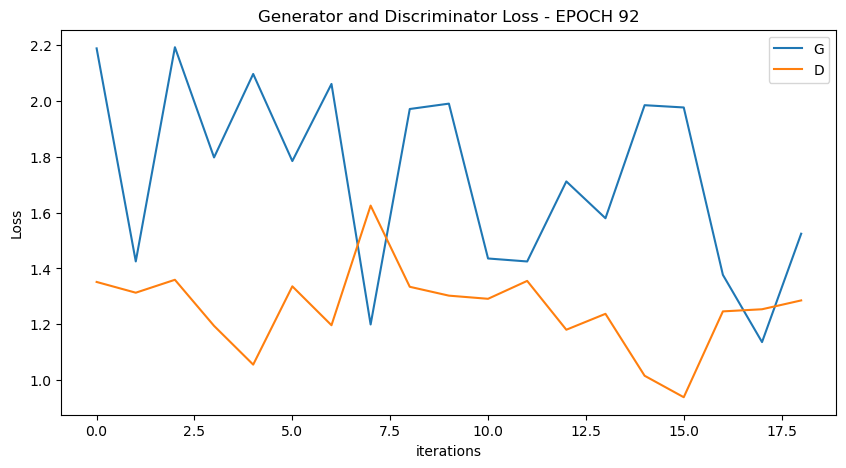

  0%|          | 0/19 [00:00<?, ?it/s]

[94/100][9/19] Loss_D: 1.0829 Loss_G: 1.7496 D(x): 0.5803 D(G(z)): 0.3417 / 0.1687
[94/100][18/19] Loss_D: 1.3026 Loss_G: 1.6855 D(x): 0.6604 D(G(z)): 0.5213 / 0.1753


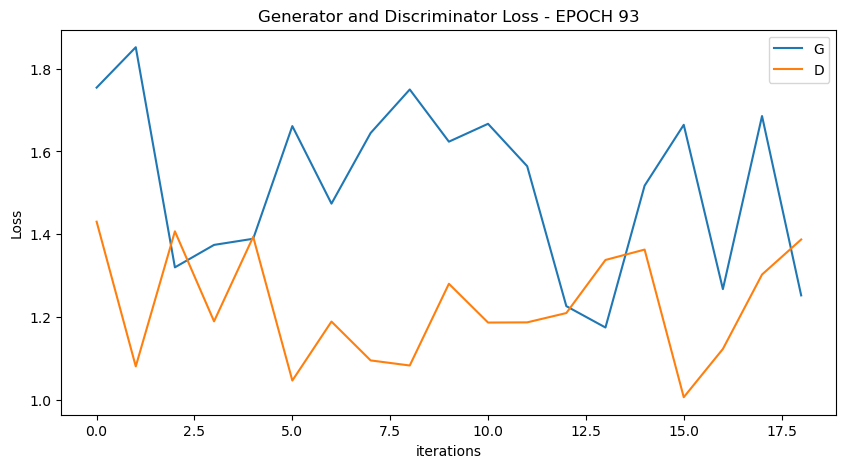

  0%|          | 0/19 [00:00<?, ?it/s]

[95/100][9/19] Loss_D: 1.2501 Loss_G: 1.8776 D(x): 0.5786 D(G(z)): 0.4504 / 0.1356
[95/100][18/19] Loss_D: 1.0792 Loss_G: 1.8939 D(x): 0.6421 D(G(z)): 0.4193 / 0.1462


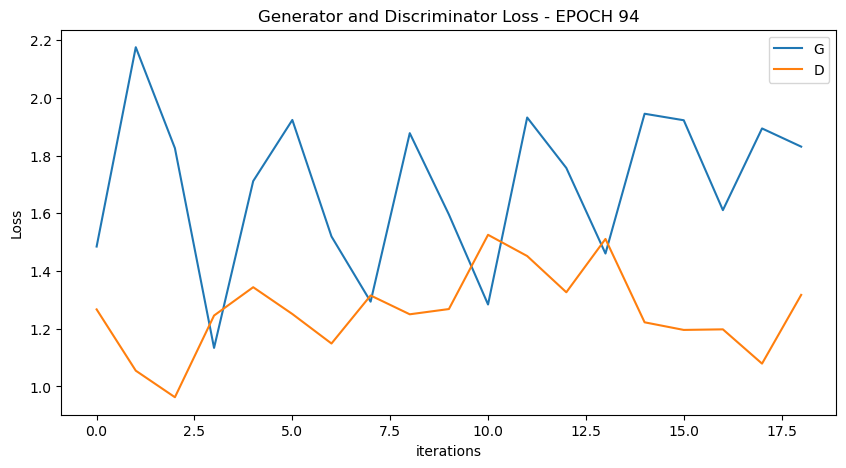

  0%|          | 0/19 [00:00<?, ?it/s]

[96/100][9/19] Loss_D: 1.0962 Loss_G: 1.6385 D(x): 0.6198 D(G(z)): 0.3952 / 0.1888
[96/100][18/19] Loss_D: 0.9694 Loss_G: 1.9254 D(x): 0.7102 D(G(z)): 0.3798 / 0.1401


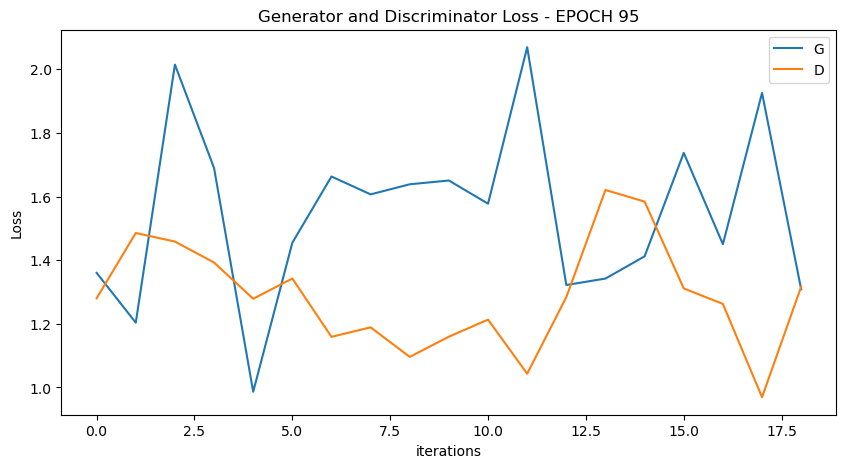

  0%|          | 0/19 [00:00<?, ?it/s]

[97/100][9/19] Loss_D: 1.1907 Loss_G: 1.4267 D(x): 0.5254 D(G(z)): 0.3738 / 0.2310
[97/100][18/19] Loss_D: 1.2119 Loss_G: 1.8788 D(x): 0.5309 D(G(z)): 0.3879 / 0.1431


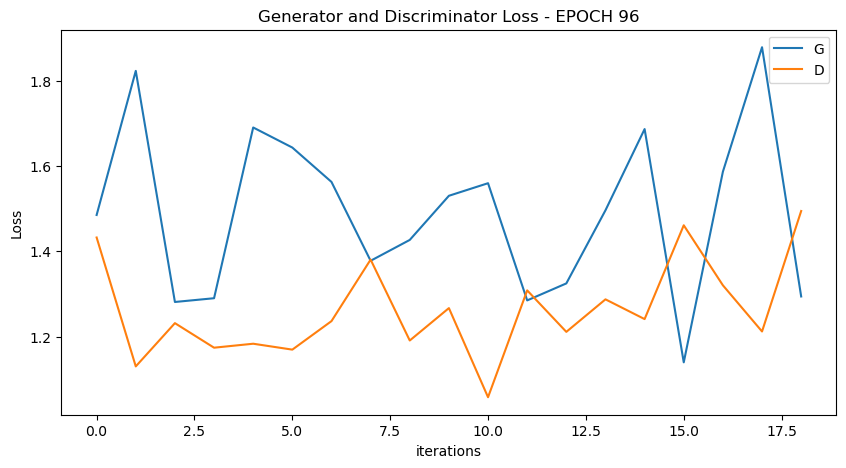

  0%|          | 0/19 [00:00<?, ?it/s]

[98/100][9/19] Loss_D: 1.5206 Loss_G: 1.2422 D(x): 0.4028 D(G(z)): 0.4287 / 0.2757
[98/100][18/19] Loss_D: 0.9462 Loss_G: 1.8581 D(x): 0.5708 D(G(z)): 0.2724 / 0.1420


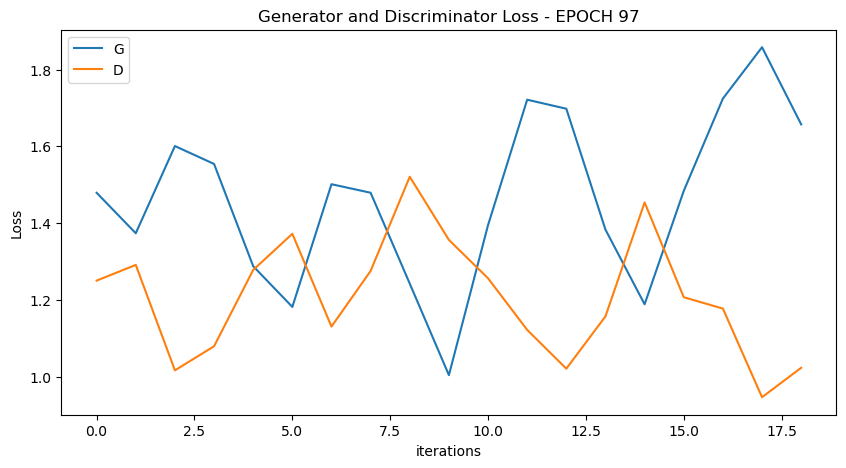

  0%|          | 0/19 [00:00<?, ?it/s]

[99/100][9/19] Loss_D: 1.1767 Loss_G: 1.7081 D(x): 0.5647 D(G(z)): 0.4097 / 0.1724
[99/100][18/19] Loss_D: 1.3325 Loss_G: 1.0734 D(x): 0.4043 D(G(z)): 0.2966 / 0.3379


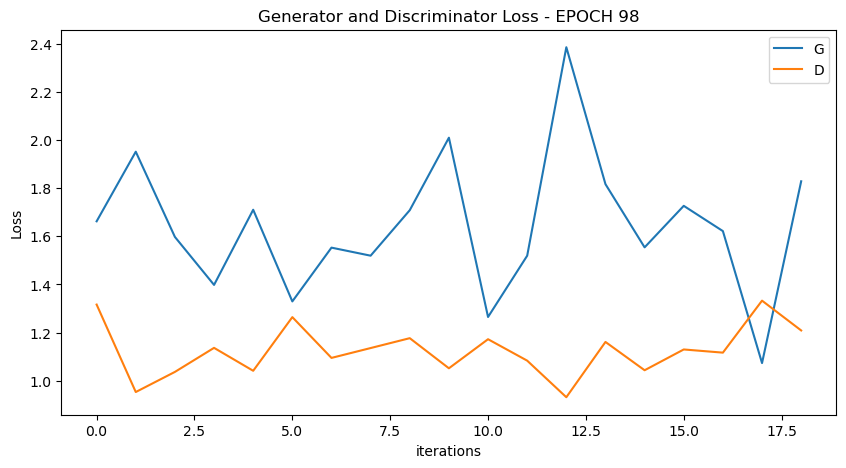

  0%|          | 0/19 [00:00<?, ?it/s]

[100/100][9/19] Loss_D: 1.0108 Loss_G: 1.5495 D(x): 0.5391 D(G(z)): 0.2700 / 0.2063
[100/100][18/19] Loss_D: 1.2125 Loss_G: 1.8085 D(x): 0.6974 D(G(z)): 0.4927 / 0.1494


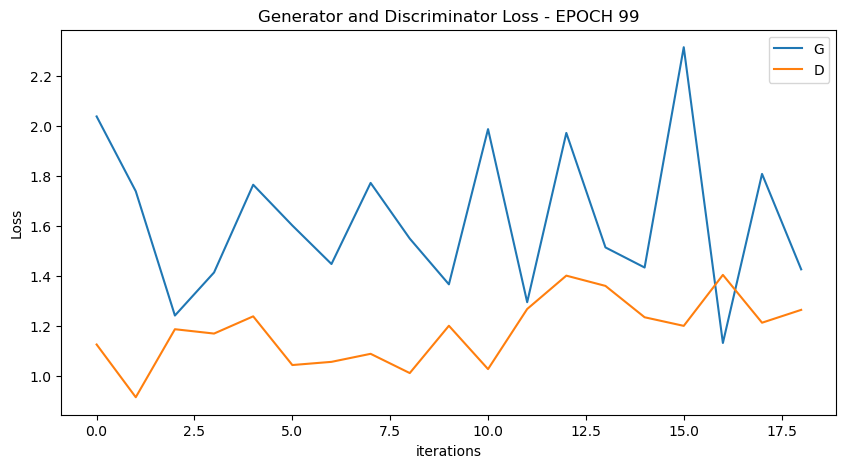

  0%|          | 0/2 [00:00<?, ?it/s]

In [38]:
paths=['angry1','happy1','neutral1','sad1']
for path in paths:
    train_img(path)
    netG = Generator(nz).to(device)
    netD = Discriminator().to(device)

    criterion = nn.BCELoss()

    optimizerD = optim.Adam(netD.parameters(), lr=LR_D, betas=(beta1, 0.999))
    optimizerG = optim.Adam(netG.parameters(), lr=LR_G, betas=(beta1, 0.999))

    fixed_noise = torch.randn(25, nz, 1, 1, device=device)

    G_losses = []
    D_losses = []
    epoch_time = []

    for epoch in range(epochs):
    
        start = time.time()
        for ii, (real_images, train_labels) in tqdm(enumerate(train_loader), total=len(train_loader)):
            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            # train with real
            netD.zero_grad()
            real_images = real_images.to(device)
            batch_size = real_images.size(0)
            labels = torch.full((batch_size, 1), real_label, device=device)

            output = netD(real_images)
            errD_real = criterion(output, labels)
            errD_real.backward()
            D_x = output.mean().item()

            # train with fake
            noise = torch.randn(batch_size, nz, 1, 1, device=device)
            fake = netG(noise)
            labels.fill_(fake_label)
            output = netD(fake.detach())
            errD_fake = criterion(output, labels)
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            errD = errD_real + errD_fake
            optimizerD.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            netG.zero_grad()
            labels.fill_(real_label)  # fake labels are real for generator cost
            output = netD(fake)
            errG = criterion(output, labels)
            errG.backward()
            D_G_z2 = output.mean().item()
            optimizerG.step()
            
            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())
            
            if (ii+1) % (len(train_loader)//2) == 0:
                print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
                    % (epoch + 1, epochs, ii+1, len(train_loader),
                        errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
                
        plot_loss (G_losses, D_losses, epoch)
        G_losses = []
        D_losses = []
        if epoch % 10 == 0:
            show_generated_img()

        epoch_time.append(time.time()- start)

    #save
    if not os.path.exists('D:/CODING/BrainDead/brain_dead_emotion_detection/output_images/'+path):
        os.mkdir('D:/CODING/BrainDead/brain_dead_emotion_detection/output_images/'+path)
    
    im_batch_size = 50
    n_images=100

    for i_batch in tqdm(range(0, n_images, im_batch_size)):
        gen_z = torch.randn(im_batch_size, nz, 1, 1, device=device)
        gen_images = netG(gen_z)
        images = gen_images.to("cpu").clone().detach()
        images = images.numpy().transpose(0, 2, 3, 1)
        for i_image in range(gen_images.size(0)):
            savepath='D:/CODING/BrainDead/brain_dead_emotion_detection/output_images/'+path
            save_image(gen_images[i_image, :, :, :], os.path.join(savepath, f'image_{i_batch+i_image:05d}.png'))

C:\Users\Samaresh Maiti\AppData\Local\Temp\ipykernel_24476\3414323965.py:33: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for ii, (real_images, train_labels) in tqdm(enumerate(train_loader), total=len(train_loader)):


  0%|          | 0/19 [00:00<?, ?it/s]

[1/100][9/19] Loss_D: 0.6047 Loss_G: 7.5019 D(x): 0.8635 D(G(z)): 0.2098 / 0.0002
[1/100][18/19] Loss_D: 0.7045 Loss_G: 7.5361 D(x): 0.6121 D(G(z)): 0.0003 / 0.0002


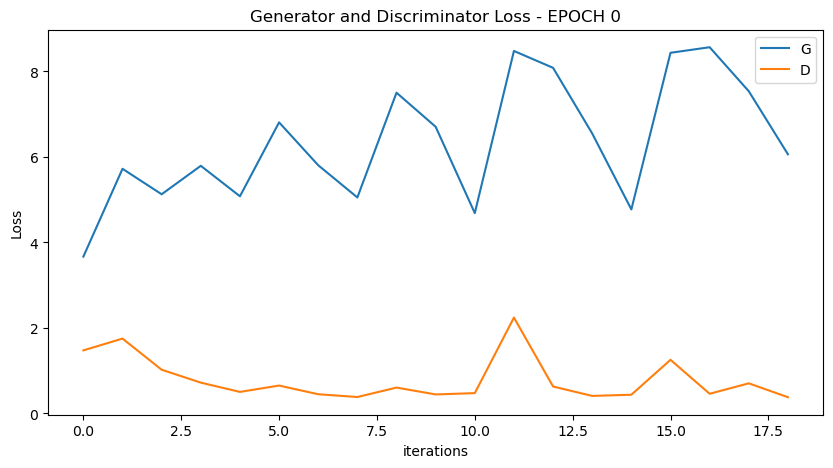

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


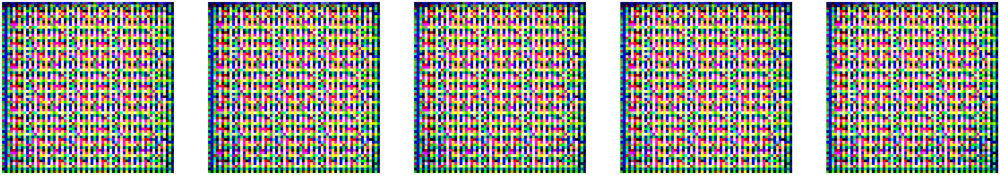

  0%|          | 0/19 [00:00<?, ?it/s]

[2/100][9/19] Loss_D: 1.0307 Loss_G: 4.4210 D(x): 0.6388 D(G(z)): 0.2939 / 0.0086
[2/100][18/19] Loss_D: 0.4757 Loss_G: 5.3444 D(x): 0.8366 D(G(z)): 0.0772 / 0.0033


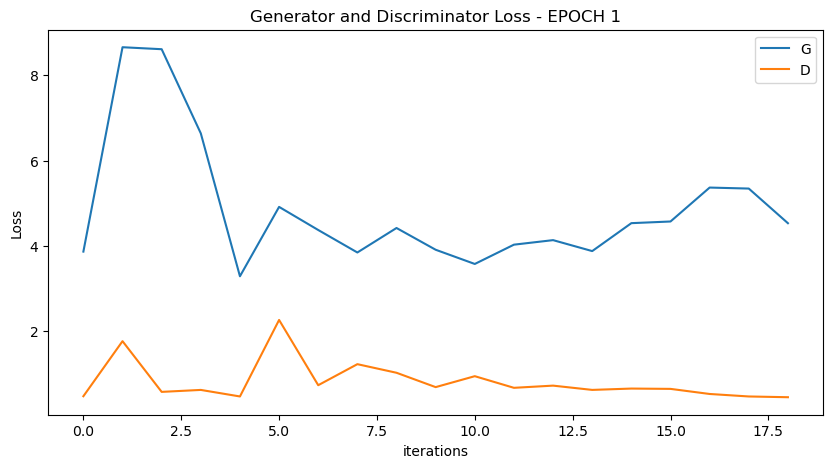

  0%|          | 0/19 [00:00<?, ?it/s]

[3/100][9/19] Loss_D: 1.3572 Loss_G: 3.1253 D(x): 0.4196 D(G(z)): 0.2622 / 0.0413
[3/100][18/19] Loss_D: 0.4573 Loss_G: 3.8993 D(x): 0.8412 D(G(z)): 0.0827 / 0.0140


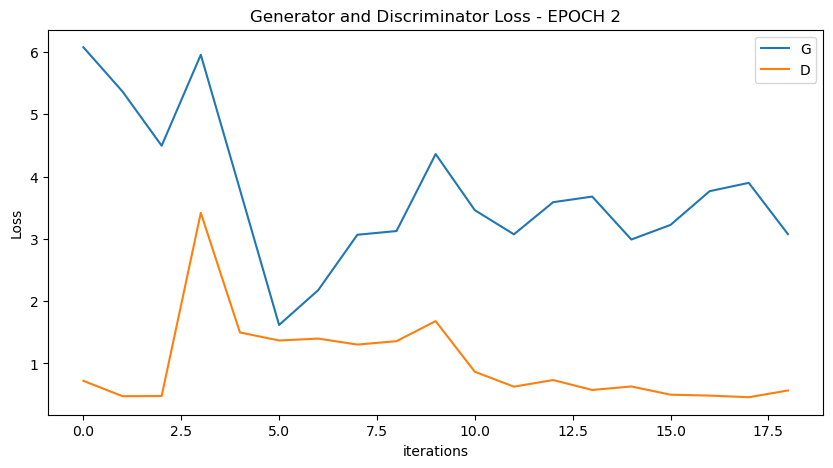

  0%|          | 0/19 [00:00<?, ?it/s]

[4/100][9/19] Loss_D: 1.0555 Loss_G: 2.1847 D(x): 0.5460 D(G(z)): 0.2645 / 0.1108
[4/100][18/19] Loss_D: 0.9834 Loss_G: 2.4478 D(x): 0.5505 D(G(z)): 0.1413 / 0.1083


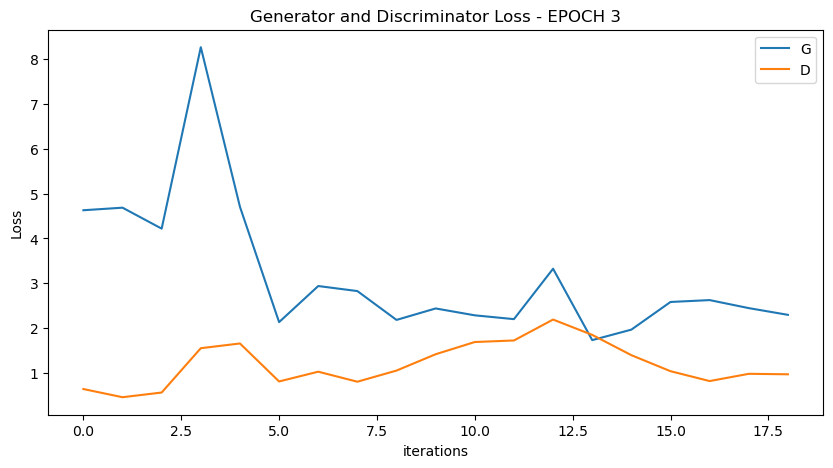

  0%|          | 0/19 [00:00<?, ?it/s]

[5/100][9/19] Loss_D: 0.9638 Loss_G: 2.0033 D(x): 0.6867 D(G(z)): 0.3284 / 0.1392
[5/100][18/19] Loss_D: 1.0297 Loss_G: 2.0485 D(x): 0.5560 D(G(z)): 0.2763 / 0.1304


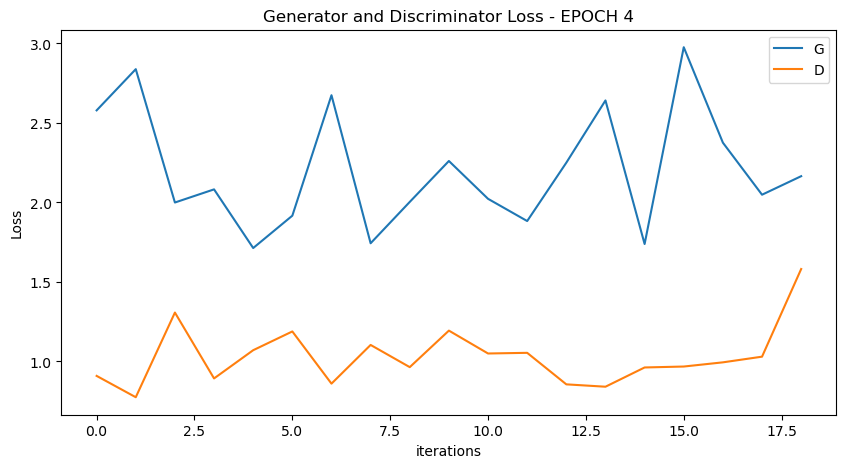

  0%|          | 0/19 [00:00<?, ?it/s]

[6/100][9/19] Loss_D: 1.4409 Loss_G: 1.8092 D(x): 0.2965 D(G(z)): 0.0939 / 0.1620
[6/100][18/19] Loss_D: 1.2912 Loss_G: 2.1974 D(x): 0.6221 D(G(z)): 0.5027 / 0.0972


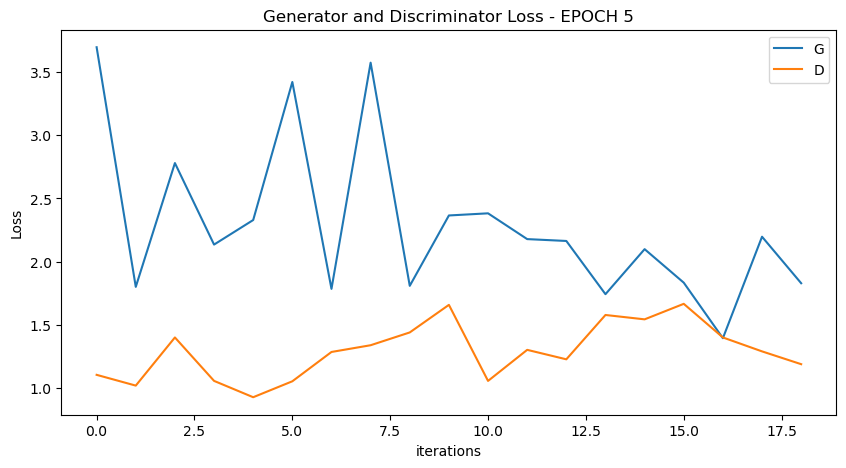

  0%|          | 0/19 [00:00<?, ?it/s]

[7/100][9/19] Loss_D: 1.1891 Loss_G: 1.3994 D(x): 0.5471 D(G(z)): 0.3659 / 0.2472
[7/100][18/19] Loss_D: 1.3928 Loss_G: 1.4360 D(x): 0.5719 D(G(z)): 0.4941 / 0.2291


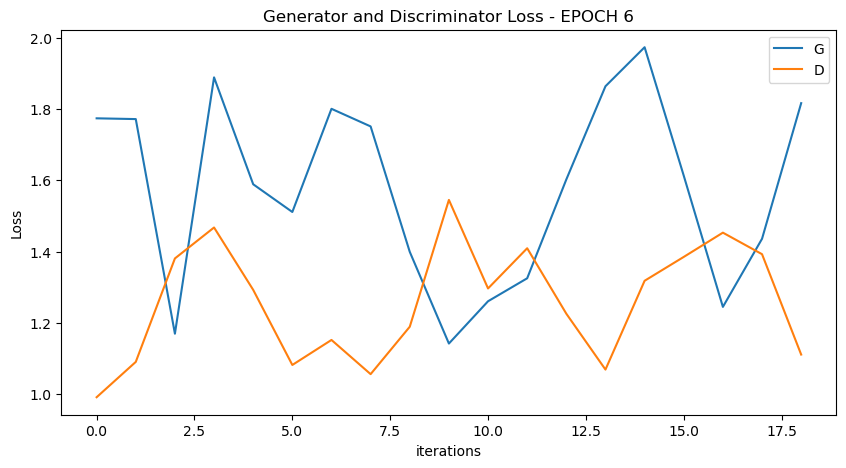

  0%|          | 0/19 [00:00<?, ?it/s]

[8/100][9/19] Loss_D: 1.3561 Loss_G: 1.3581 D(x): 0.6312 D(G(z)): 0.5393 / 0.2377
[8/100][18/19] Loss_D: 1.0727 Loss_G: 1.6348 D(x): 0.5787 D(G(z)): 0.3544 / 0.1878


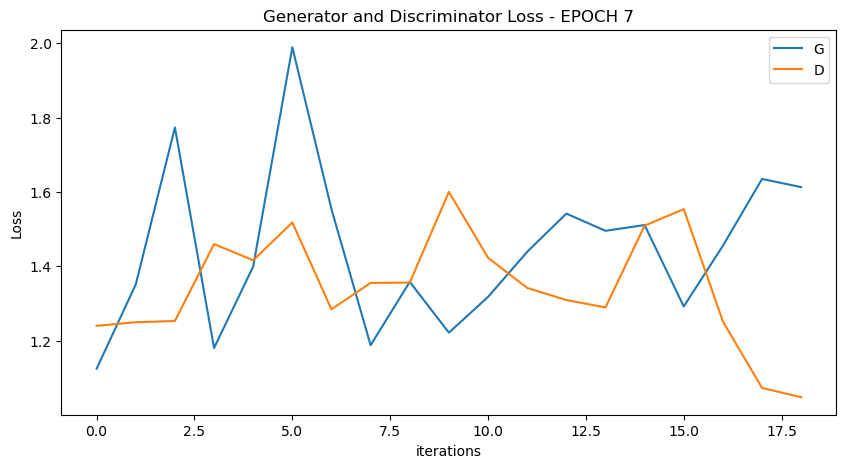

  0%|          | 0/19 [00:00<?, ?it/s]

[9/100][9/19] Loss_D: 1.3713 Loss_G: 1.9470 D(x): 0.5361 D(G(z)): 0.4898 / 0.1409
[9/100][18/19] Loss_D: 1.2466 Loss_G: 1.4611 D(x): 0.5858 D(G(z)): 0.4666 / 0.2200


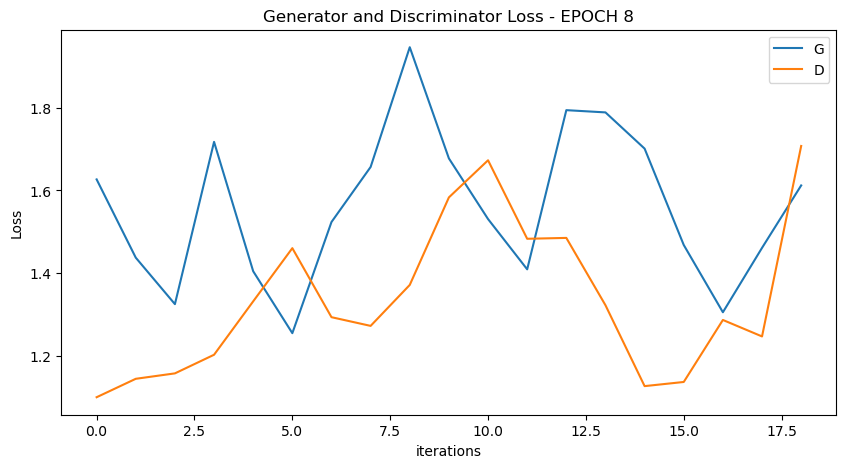

  0%|          | 0/19 [00:00<?, ?it/s]

[10/100][9/19] Loss_D: 0.9783 Loss_G: 2.0617 D(x): 0.6231 D(G(z)): 0.3342 / 0.1124
[10/100][18/19] Loss_D: 1.4995 Loss_G: 1.3921 D(x): 0.3929 D(G(z)): 0.3979 / 0.2323


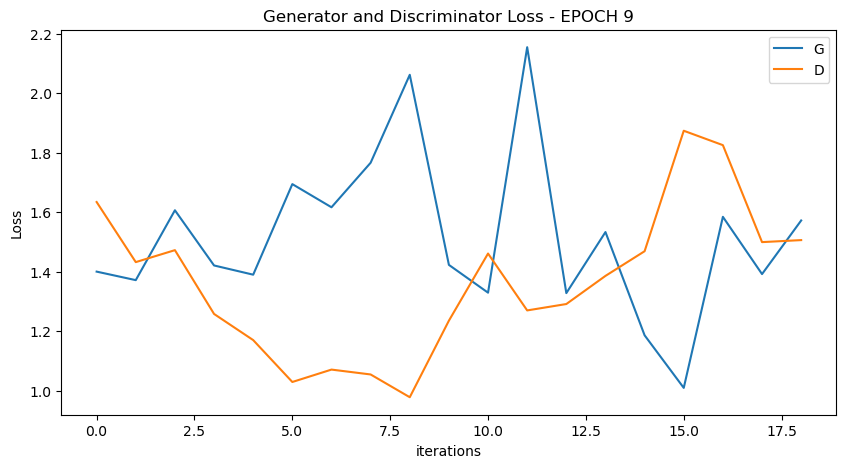

  0%|          | 0/19 [00:00<?, ?it/s]

[11/100][9/19] Loss_D: 1.2683 Loss_G: 1.3119 D(x): 0.5188 D(G(z)): 0.4257 / 0.2496
[11/100][18/19] Loss_D: 1.1463 Loss_G: 1.3073 D(x): 0.5675 D(G(z)): 0.3880 / 0.2688


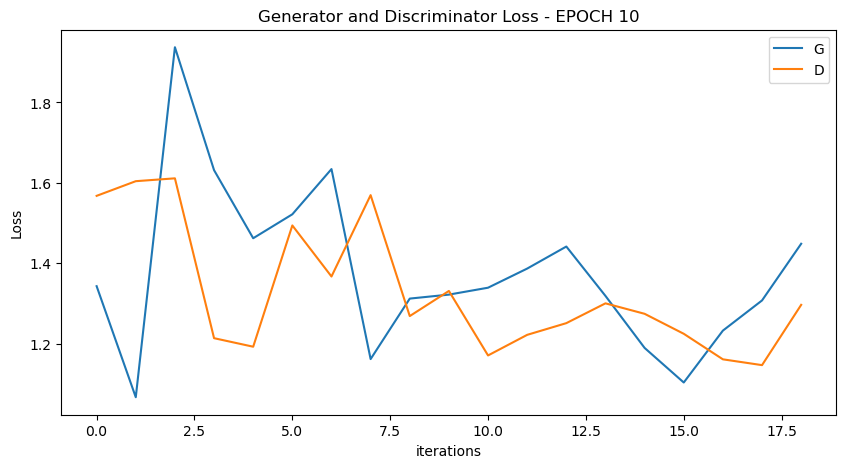

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


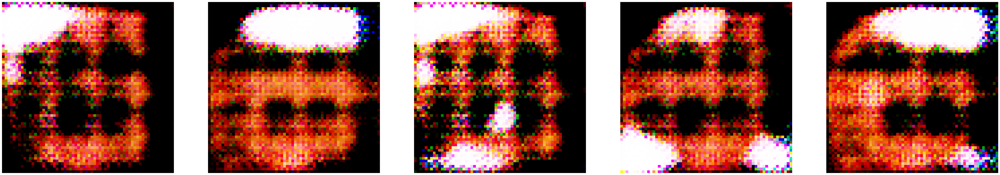

  0%|          | 0/19 [00:00<?, ?it/s]

[12/100][9/19] Loss_D: 1.1752 Loss_G: 1.1855 D(x): 0.5910 D(G(z)): 0.4318 / 0.2936
[12/100][18/19] Loss_D: 1.2384 Loss_G: 1.2062 D(x): 0.5820 D(G(z)): 0.4588 / 0.2894


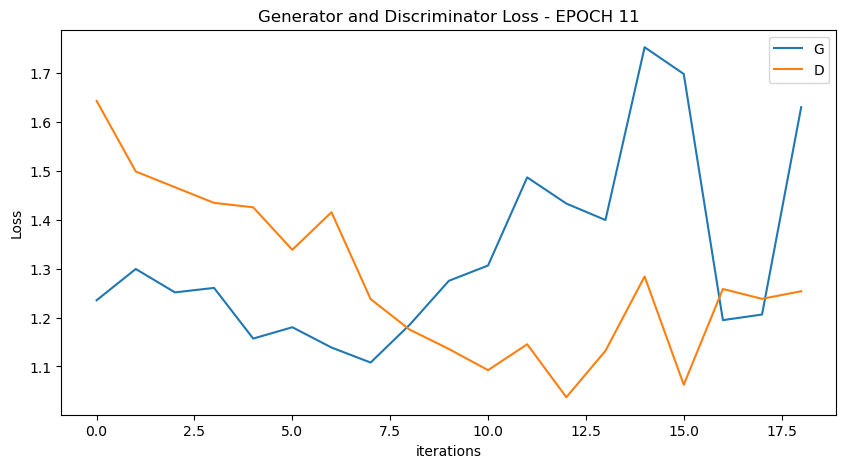

  0%|          | 0/19 [00:00<?, ?it/s]

[13/100][9/19] Loss_D: 1.3875 Loss_G: 1.4161 D(x): 0.5070 D(G(z)): 0.4628 / 0.2272
[13/100][18/19] Loss_D: 1.4654 Loss_G: 1.4149 D(x): 0.5161 D(G(z)): 0.4871 / 0.2254


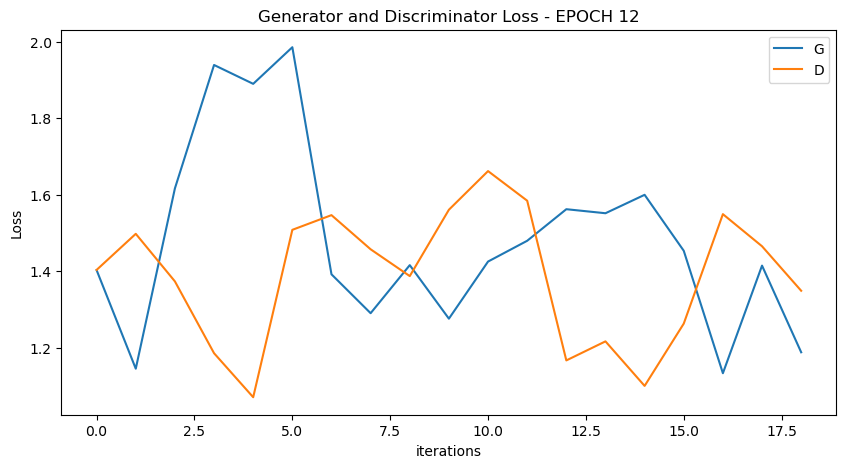

  0%|          | 0/19 [00:00<?, ?it/s]

[14/100][9/19] Loss_D: 1.3684 Loss_G: 1.3843 D(x): 0.5076 D(G(z)): 0.4641 / 0.2343
[14/100][18/19] Loss_D: 1.3174 Loss_G: 1.2760 D(x): 0.4974 D(G(z)): 0.4114 / 0.2730


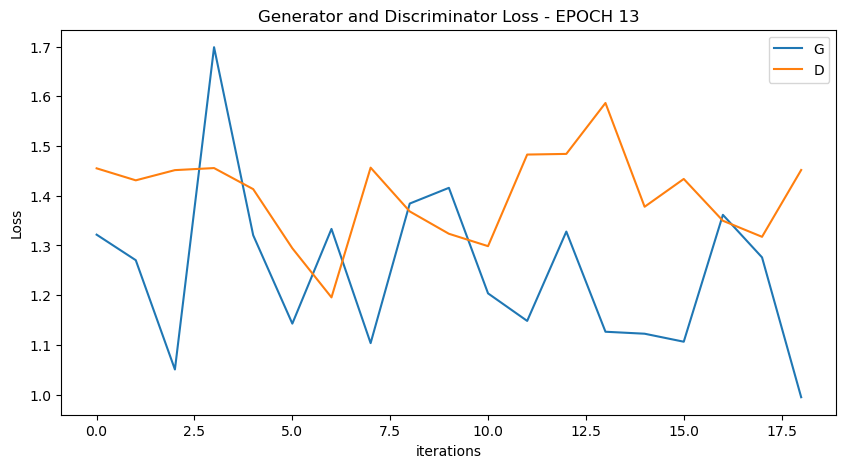

  0%|          | 0/19 [00:00<?, ?it/s]

[15/100][9/19] Loss_D: 1.2480 Loss_G: 1.0839 D(x): 0.5320 D(G(z)): 0.4305 / 0.3199
[15/100][18/19] Loss_D: 1.3159 Loss_G: 1.4313 D(x): 0.4613 D(G(z)): 0.3007 / 0.2291


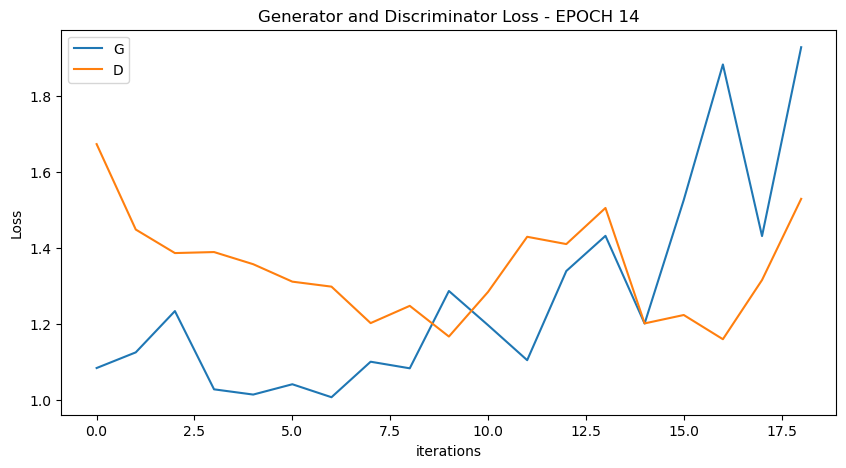

  0%|          | 0/19 [00:00<?, ?it/s]

[16/100][9/19] Loss_D: 1.4290 Loss_G: 1.4980 D(x): 0.4348 D(G(z)): 0.4363 / 0.2039
[16/100][18/19] Loss_D: 1.4889 Loss_G: 1.0779 D(x): 0.4449 D(G(z)): 0.4524 / 0.3356


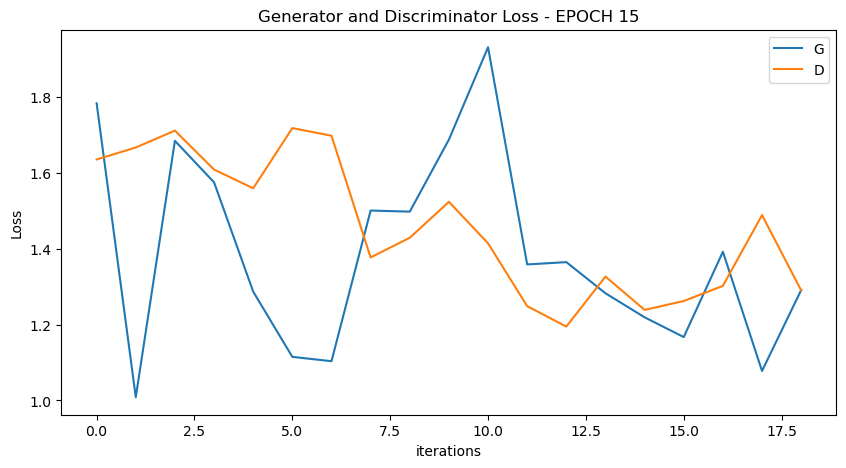

  0%|          | 0/19 [00:00<?, ?it/s]

[17/100][9/19] Loss_D: 1.5039 Loss_G: 1.2153 D(x): 0.5155 D(G(z)): 0.5277 / 0.2839
[17/100][18/19] Loss_D: 1.2299 Loss_G: 1.4506 D(x): 0.5326 D(G(z)): 0.4240 / 0.2181


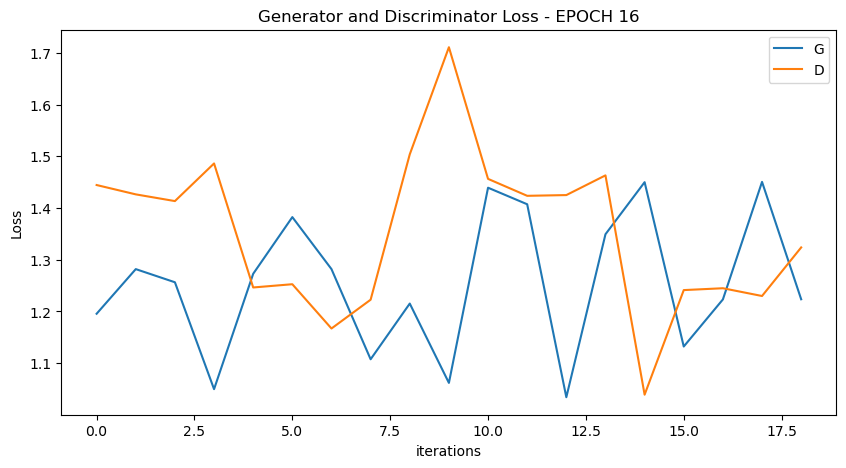

  0%|          | 0/19 [00:00<?, ?it/s]

[18/100][9/19] Loss_D: 1.4339 Loss_G: 1.1323 D(x): 0.4649 D(G(z)): 0.4642 / 0.3081
[18/100][18/19] Loss_D: 1.1608 Loss_G: 1.5101 D(x): 0.5469 D(G(z)): 0.3838 / 0.1991


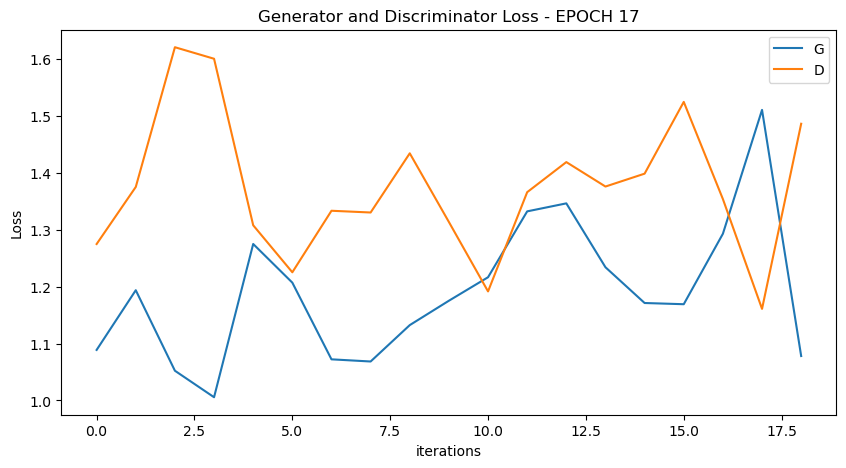

  0%|          | 0/19 [00:00<?, ?it/s]

[19/100][9/19] Loss_D: 1.3580 Loss_G: 1.4941 D(x): 0.4403 D(G(z)): 0.4084 / 0.2049
[19/100][18/19] Loss_D: 1.1977 Loss_G: 1.2995 D(x): 0.5411 D(G(z)): 0.4119 / 0.2582


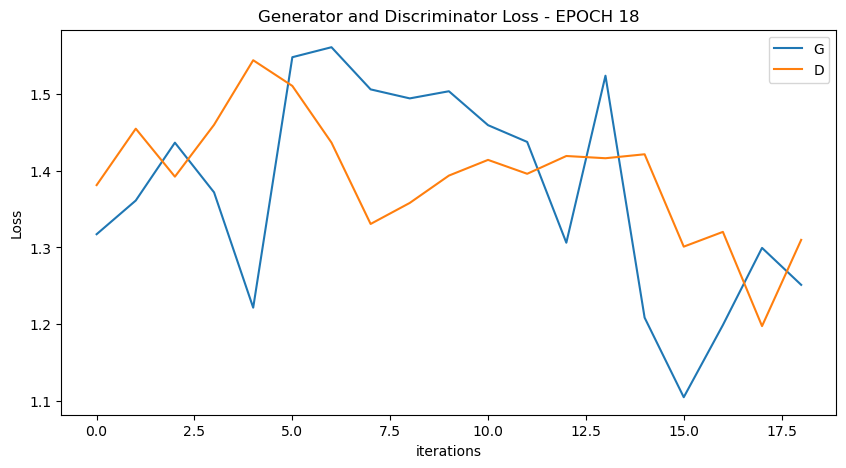

  0%|          | 0/19 [00:00<?, ?it/s]

[20/100][9/19] Loss_D: 1.2616 Loss_G: 1.3152 D(x): 0.6147 D(G(z)): 0.4917 / 0.2492
[20/100][18/19] Loss_D: 1.2689 Loss_G: 1.2653 D(x): 0.5229 D(G(z)): 0.4213 / 0.2696


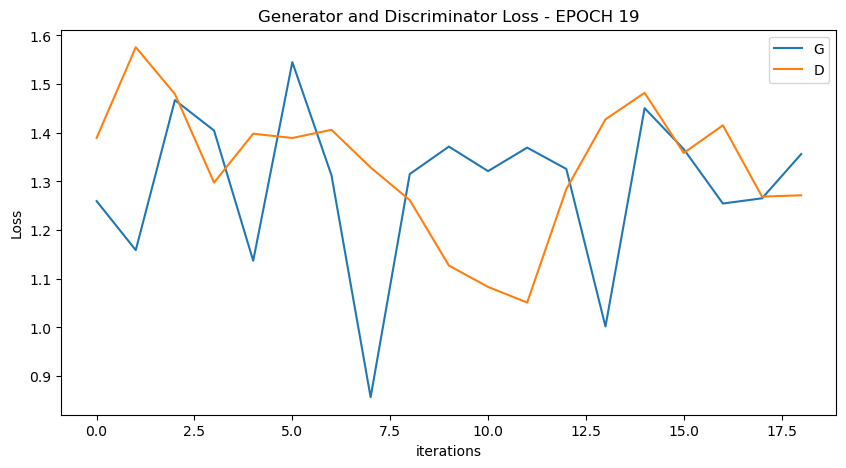

  0%|          | 0/19 [00:00<?, ?it/s]

[21/100][9/19] Loss_D: 1.1515 Loss_G: 1.8078 D(x): 0.6926 D(G(z)): 0.4862 / 0.1449
[21/100][18/19] Loss_D: 1.5290 Loss_G: 1.3060 D(x): 0.4026 D(G(z)): 0.4476 / 0.2568


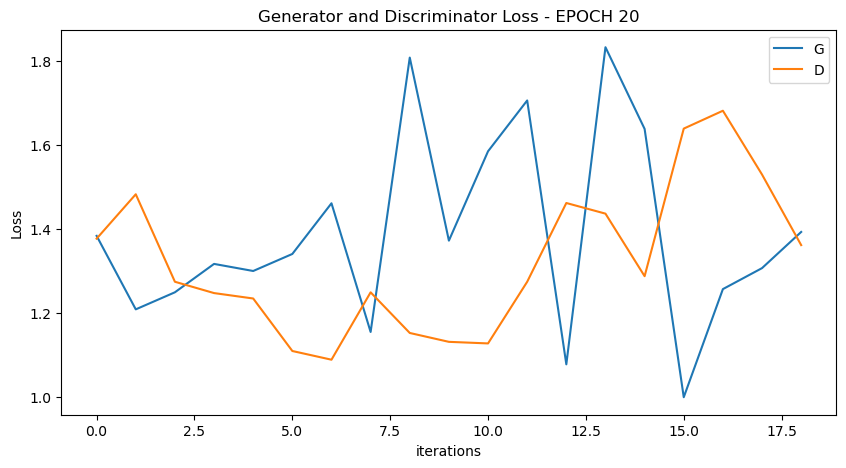

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


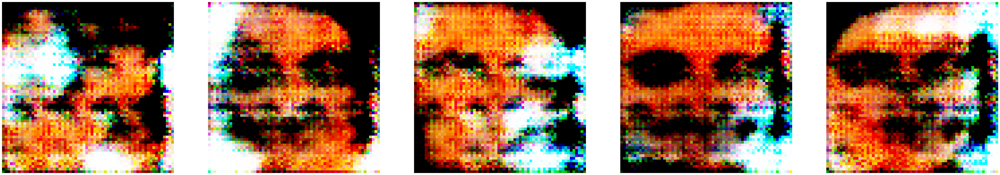

  0%|          | 0/19 [00:00<?, ?it/s]

[22/100][9/19] Loss_D: 1.1760 Loss_G: 1.4959 D(x): 0.4964 D(G(z)): 0.3454 / 0.2108
[22/100][18/19] Loss_D: 1.1392 Loss_G: 1.3959 D(x): 0.5313 D(G(z)): 0.3578 / 0.2272


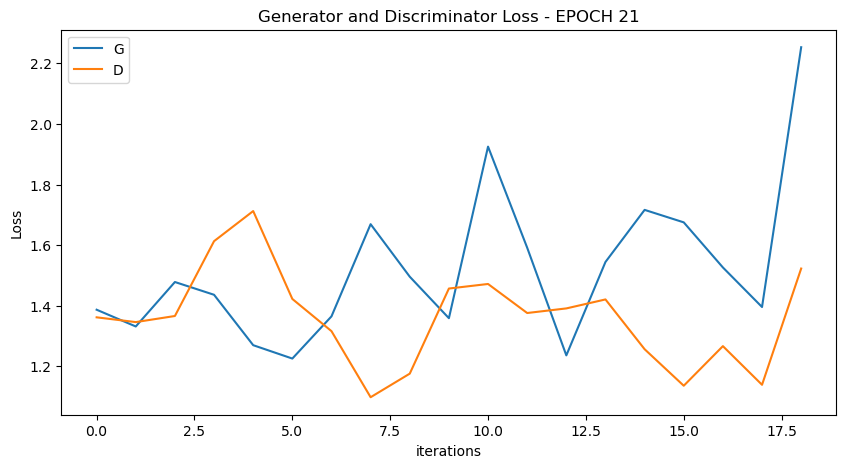

  0%|          | 0/19 [00:00<?, ?it/s]

[23/100][9/19] Loss_D: 1.0771 Loss_G: 1.5032 D(x): 0.5337 D(G(z)): 0.3170 / 0.2057
[23/100][18/19] Loss_D: 1.5460 Loss_G: 1.4402 D(x): 0.4435 D(G(z)): 0.4896 / 0.2227


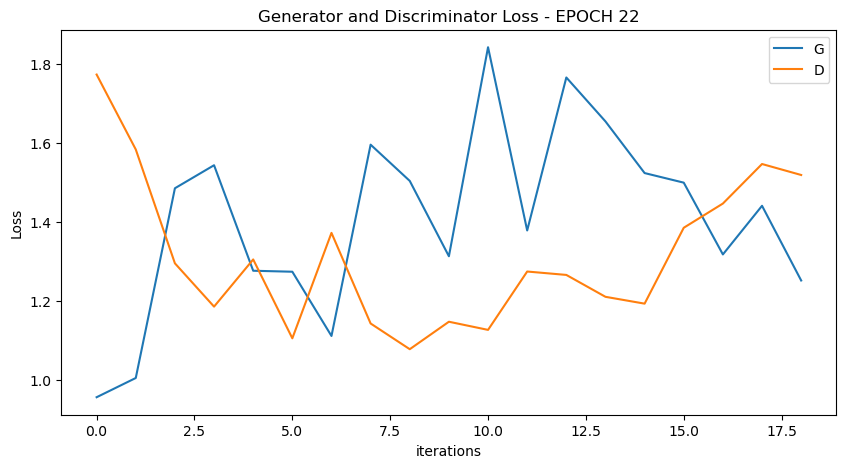

  0%|          | 0/19 [00:00<?, ?it/s]

[24/100][9/19] Loss_D: 1.3148 Loss_G: 1.0094 D(x): 0.3896 D(G(z)): 0.2979 / 0.3519
[24/100][18/19] Loss_D: 1.4017 Loss_G: 1.2523 D(x): 0.4732 D(G(z)): 0.4493 / 0.2677


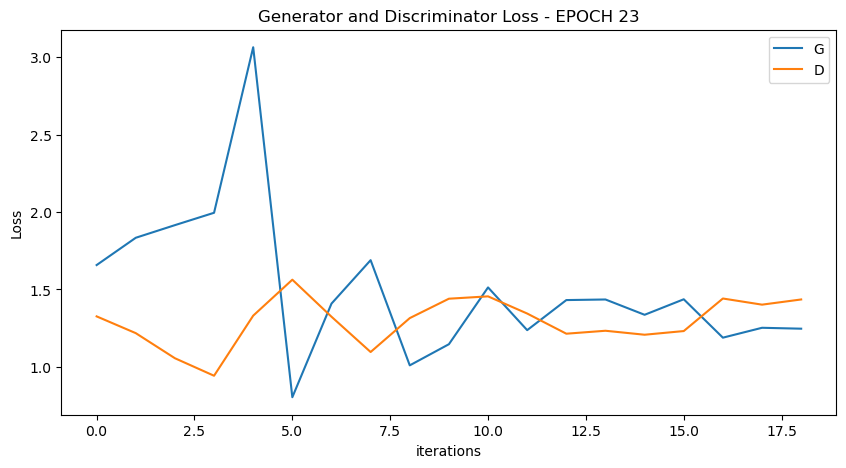

  0%|          | 0/19 [00:00<?, ?it/s]

[25/100][9/19] Loss_D: 1.4503 Loss_G: 1.3042 D(x): 0.4362 D(G(z)): 0.4434 / 0.2515
[25/100][18/19] Loss_D: 1.4292 Loss_G: 1.1578 D(x): 0.4210 D(G(z)): 0.4206 / 0.3037


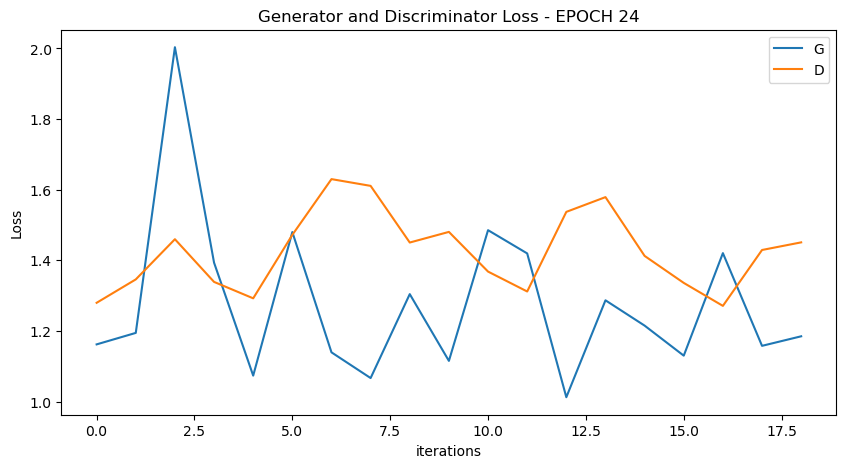

  0%|          | 0/19 [00:00<?, ?it/s]

[26/100][9/19] Loss_D: 1.3860 Loss_G: 1.0192 D(x): 0.4830 D(G(z)): 0.4586 / 0.3481
[26/100][18/19] Loss_D: 1.2113 Loss_G: 1.4845 D(x): 0.5432 D(G(z)): 0.4045 / 0.2171


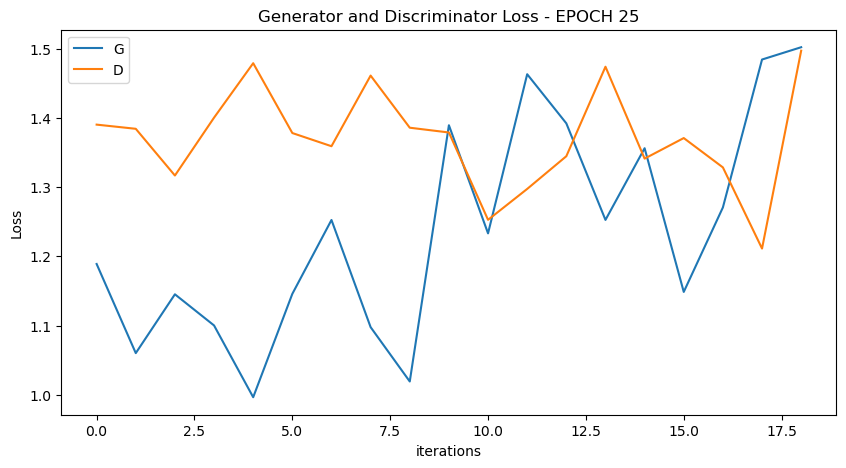

  0%|          | 0/19 [00:00<?, ?it/s]

[27/100][9/19] Loss_D: 1.2172 Loss_G: 1.3522 D(x): 0.5349 D(G(z)): 0.4143 / 0.2373
[27/100][18/19] Loss_D: 1.2005 Loss_G: 1.4600 D(x): 0.6406 D(G(z)): 0.4847 / 0.2195


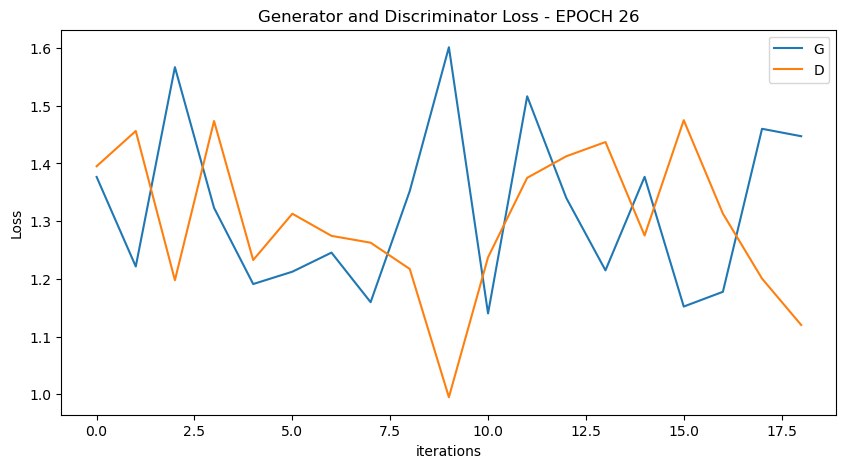

  0%|          | 0/19 [00:00<?, ?it/s]

[28/100][9/19] Loss_D: 1.3713 Loss_G: 1.3531 D(x): 0.3715 D(G(z)): 0.3184 / 0.2357
[28/100][18/19] Loss_D: 1.4372 Loss_G: 1.3136 D(x): 0.4323 D(G(z)): 0.4391 / 0.2496


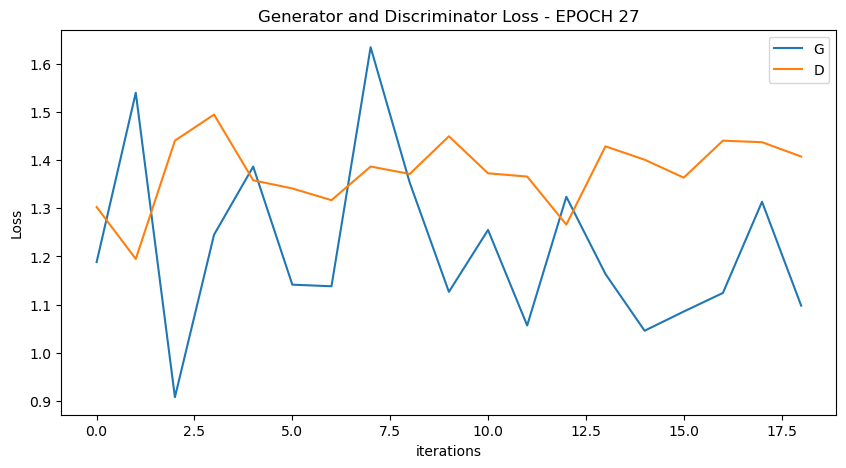

  0%|          | 0/19 [00:00<?, ?it/s]

[29/100][9/19] Loss_D: 1.3363 Loss_G: 1.4528 D(x): 0.5535 D(G(z)): 0.4828 / 0.2212
[29/100][18/19] Loss_D: 1.4541 Loss_G: 0.8926 D(x): 0.4029 D(G(z)): 0.4052 / 0.4025


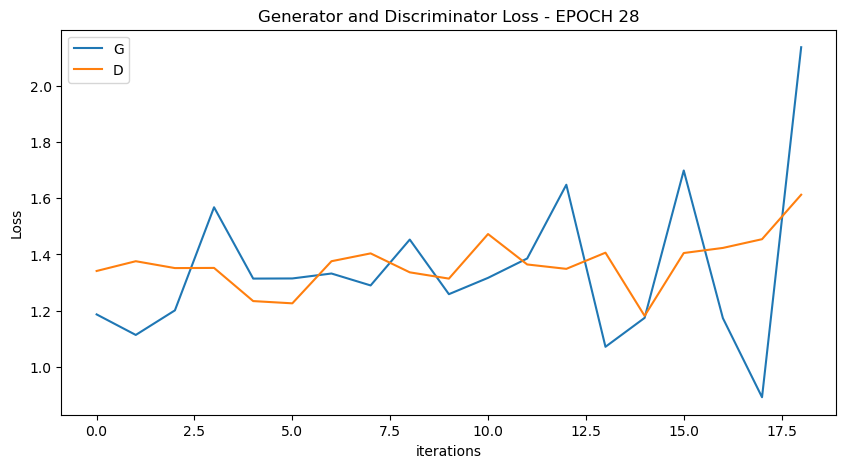

  0%|          | 0/19 [00:00<?, ?it/s]

[30/100][9/19] Loss_D: 1.3063 Loss_G: 1.3711 D(x): 0.4133 D(G(z)): 0.3212 / 0.2376
[30/100][18/19] Loss_D: 1.1346 Loss_G: 1.6616 D(x): 0.6195 D(G(z)): 0.4337 / 0.1744


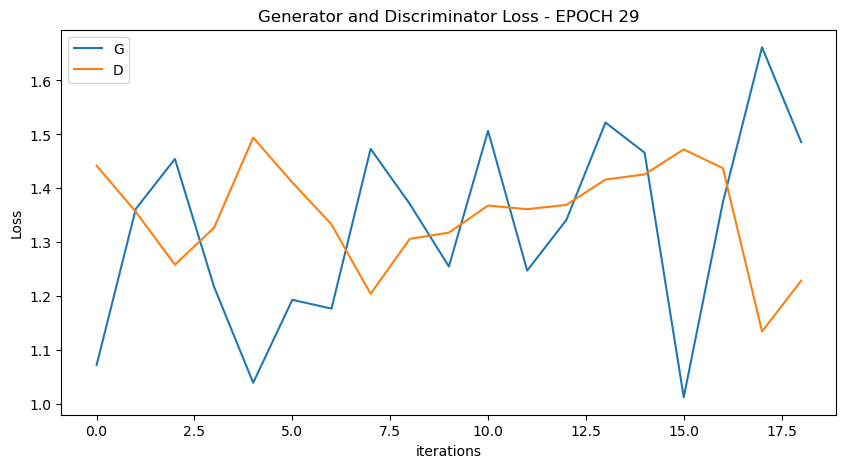

  0%|          | 0/19 [00:00<?, ?it/s]

[31/100][9/19] Loss_D: 1.3912 Loss_G: 1.2987 D(x): 0.4332 D(G(z)): 0.4200 / 0.2500
[31/100][18/19] Loss_D: 1.4179 Loss_G: 1.3275 D(x): 0.4310 D(G(z)): 0.4183 / 0.2444


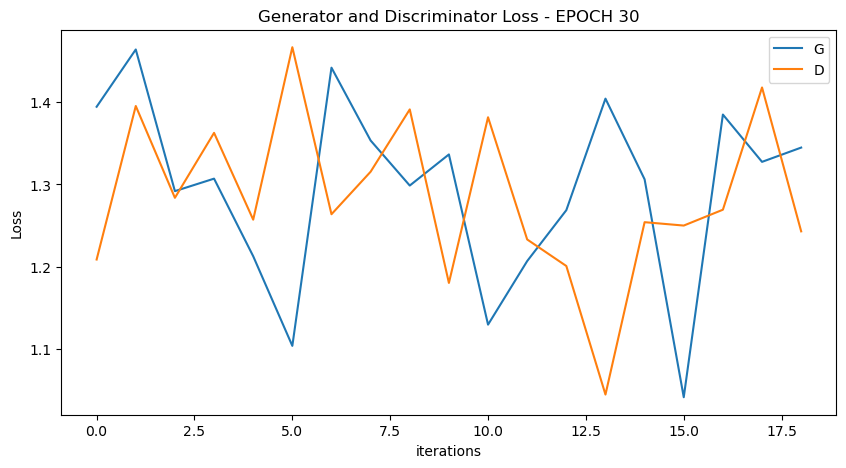

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


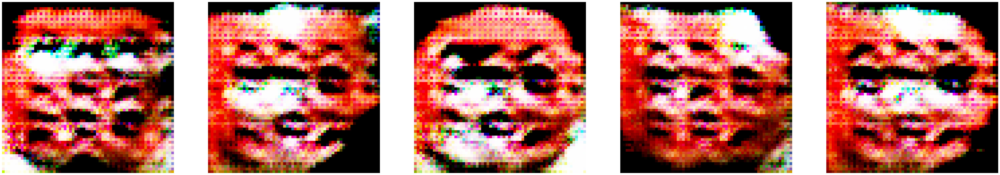

  0%|          | 0/19 [00:00<?, ?it/s]

[32/100][9/19] Loss_D: 1.5564 Loss_G: 1.4521 D(x): 0.5732 D(G(z)): 0.5932 / 0.2257
[32/100][18/19] Loss_D: 1.5389 Loss_G: 1.7492 D(x): 0.5387 D(G(z)): 0.5675 / 0.1636


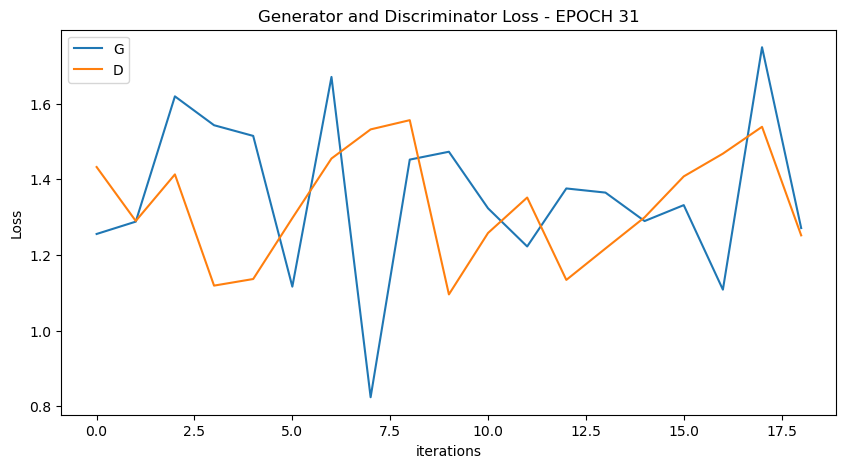

  0%|          | 0/19 [00:00<?, ?it/s]

[33/100][9/19] Loss_D: 1.6102 Loss_G: 1.2599 D(x): 0.4190 D(G(z)): 0.4400 / 0.2676
[33/100][18/19] Loss_D: 1.4000 Loss_G: 1.4009 D(x): 0.4920 D(G(z)): 0.4746 / 0.2259


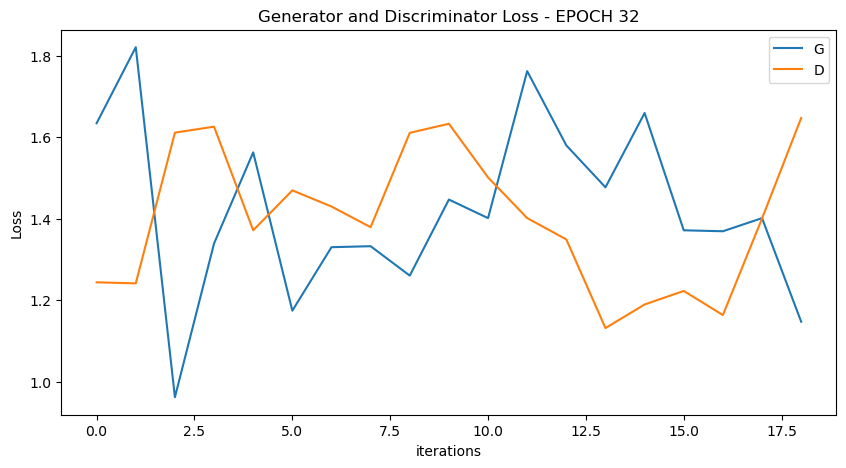

  0%|          | 0/19 [00:00<?, ?it/s]

[34/100][9/19] Loss_D: 1.2077 Loss_G: 1.4830 D(x): 0.5564 D(G(z)): 0.4273 / 0.2065
[34/100][18/19] Loss_D: 1.4833 Loss_G: 1.3555 D(x): 0.4590 D(G(z)): 0.4779 / 0.2395


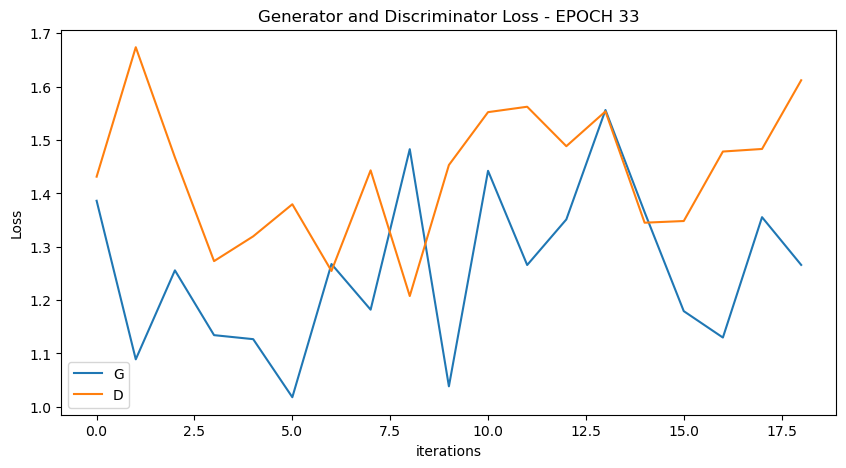

  0%|          | 0/19 [00:00<?, ?it/s]

[35/100][9/19] Loss_D: 1.1986 Loss_G: 1.2023 D(x): 0.5522 D(G(z)): 0.4116 / 0.2856
[35/100][18/19] Loss_D: 1.4222 Loss_G: 1.2068 D(x): 0.3843 D(G(z)): 0.3598 / 0.2879


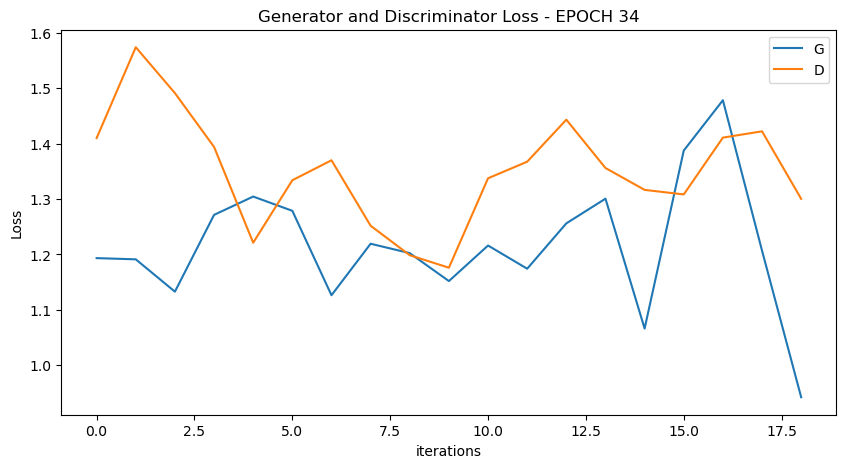

  0%|          | 0/19 [00:00<?, ?it/s]

[36/100][9/19] Loss_D: 1.7165 Loss_G: 1.3202 D(x): 0.4388 D(G(z)): 0.5667 / 0.2593
[36/100][18/19] Loss_D: 1.4477 Loss_G: 1.1702 D(x): 0.4409 D(G(z)): 0.4395 / 0.2934


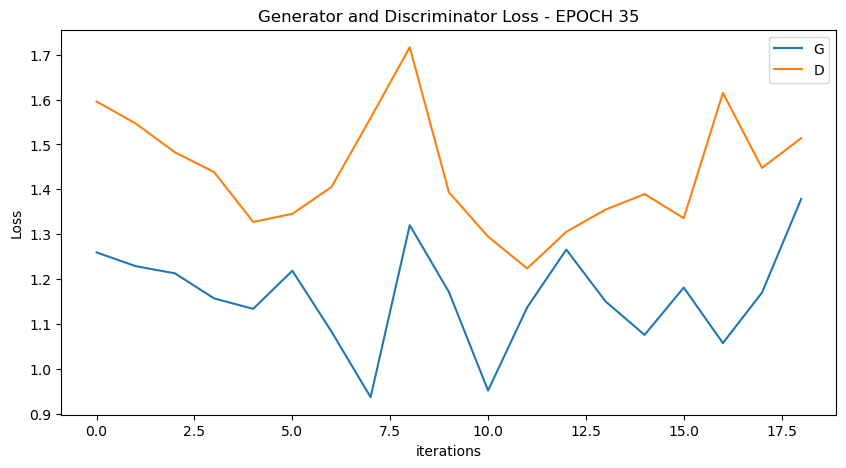

  0%|          | 0/19 [00:00<?, ?it/s]

[37/100][9/19] Loss_D: 1.3607 Loss_G: 1.3091 D(x): 0.5066 D(G(z)): 0.4721 / 0.2572
[37/100][18/19] Loss_D: 1.3851 Loss_G: 0.9362 D(x): 0.3744 D(G(z)): 0.3406 / 0.3762


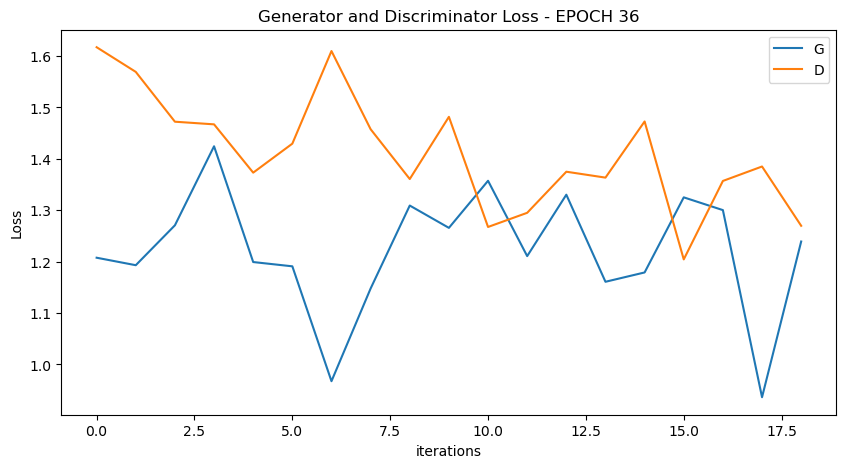

  0%|          | 0/19 [00:00<?, ?it/s]

[38/100][9/19] Loss_D: 1.3385 Loss_G: 1.1661 D(x): 0.5218 D(G(z)): 0.4651 / 0.2970
[38/100][18/19] Loss_D: 1.3065 Loss_G: 0.9882 D(x): 0.5020 D(G(z)): 0.4432 / 0.3605


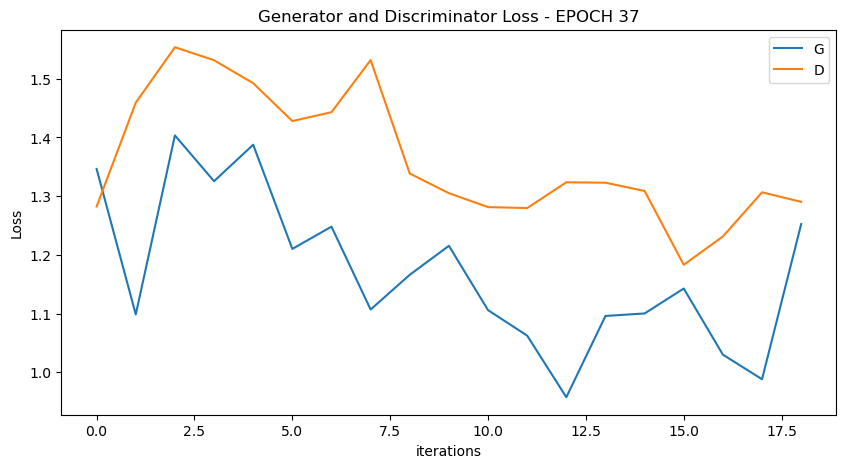

  0%|          | 0/19 [00:00<?, ?it/s]

[39/100][9/19] Loss_D: 1.4499 Loss_G: 1.3959 D(x): 0.4511 D(G(z)): 0.4539 / 0.2262
[39/100][18/19] Loss_D: 1.5333 Loss_G: 1.5165 D(x): 0.4308 D(G(z)): 0.4695 / 0.2033


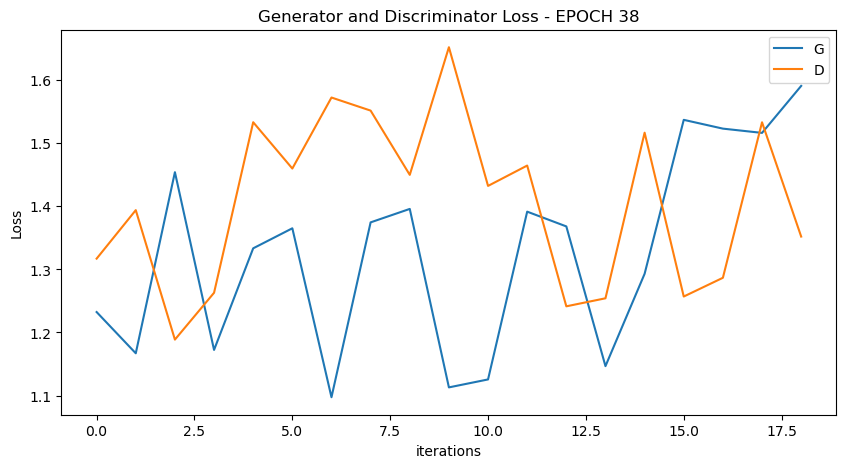

  0%|          | 0/19 [00:00<?, ?it/s]

[40/100][9/19] Loss_D: 1.5768 Loss_G: 1.0604 D(x): 0.4598 D(G(z)): 0.5345 / 0.3365
[40/100][18/19] Loss_D: 1.5369 Loss_G: 1.1561 D(x): 0.3876 D(G(z)): 0.4386 / 0.2993


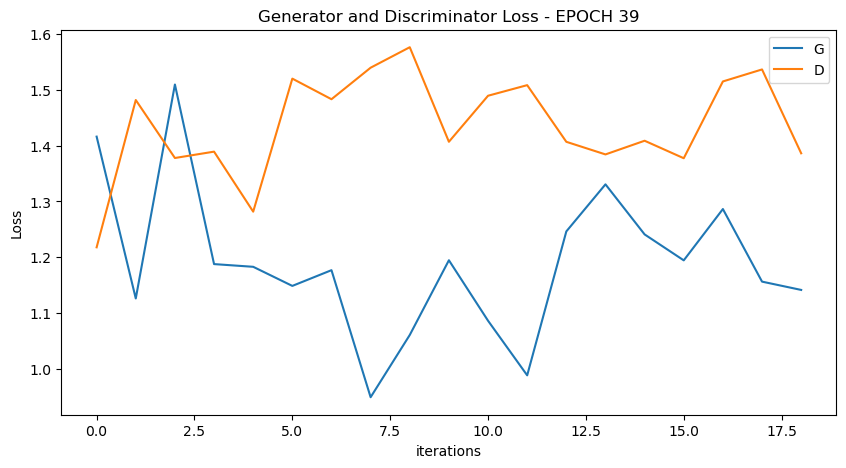

  0%|          | 0/19 [00:00<?, ?it/s]

[41/100][9/19] Loss_D: 1.2709 Loss_G: 1.3805 D(x): 0.5160 D(G(z)): 0.4231 / 0.2311
[41/100][18/19] Loss_D: 1.3424 Loss_G: 1.0126 D(x): 0.4400 D(G(z)): 0.4031 / 0.3482


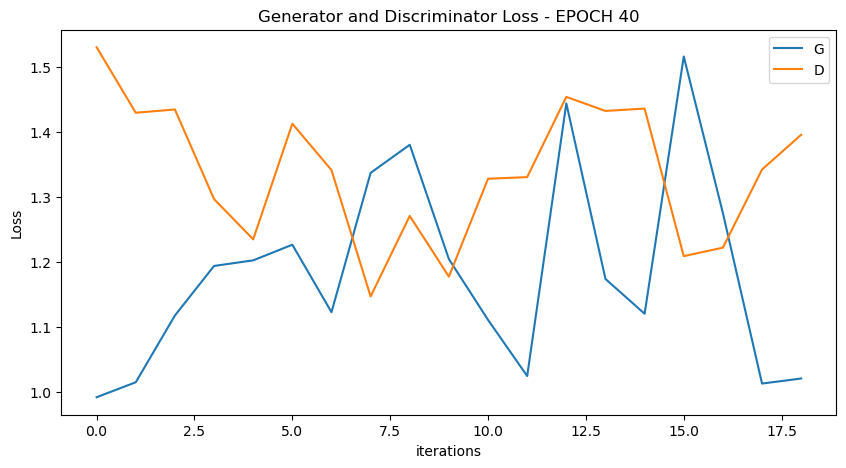

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


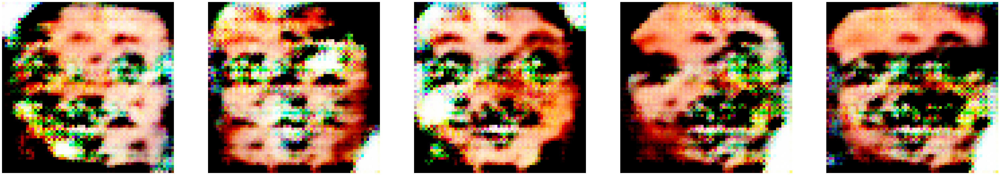

  0%|          | 0/19 [00:00<?, ?it/s]

[42/100][9/19] Loss_D: 1.3539 Loss_G: 1.2288 D(x): 0.4448 D(G(z)): 0.4064 / 0.2730
[42/100][18/19] Loss_D: 1.5764 Loss_G: 0.9319 D(x): 0.3822 D(G(z)): 0.4657 / 0.3849


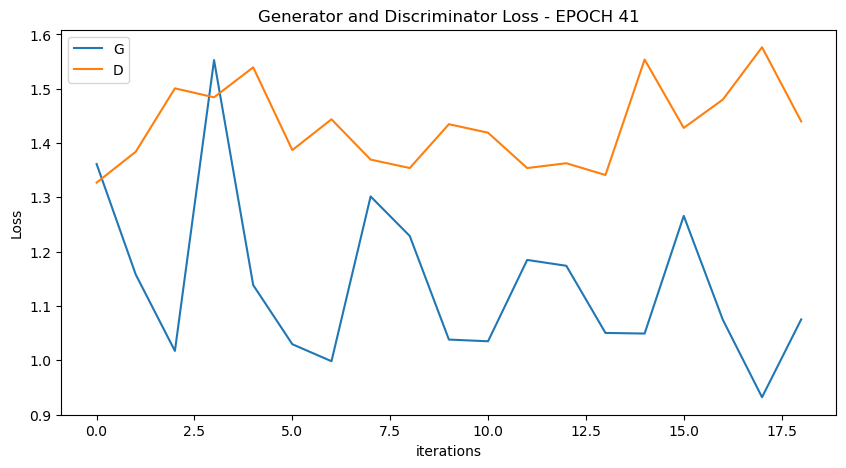

  0%|          | 0/19 [00:00<?, ?it/s]

[43/100][9/19] Loss_D: 1.4801 Loss_G: 1.0775 D(x): 0.3551 D(G(z)): 0.3688 / 0.3199
[43/100][18/19] Loss_D: 1.4128 Loss_G: 1.3261 D(x): 0.4130 D(G(z)): 0.4043 / 0.2460


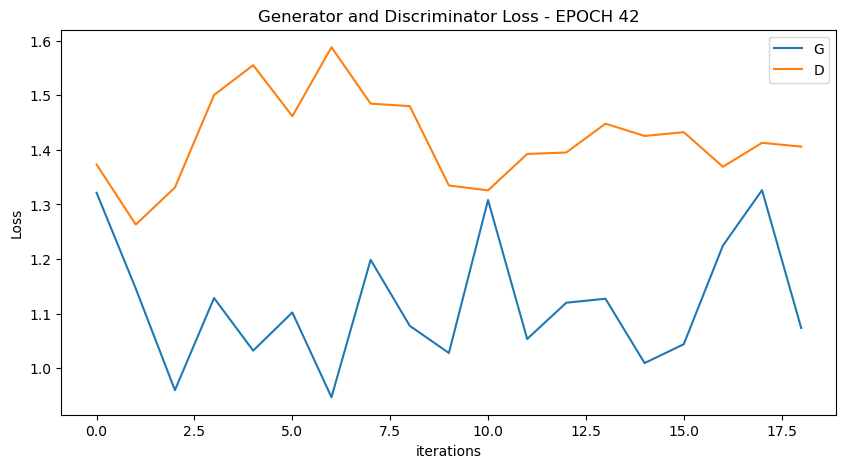

  0%|          | 0/19 [00:00<?, ?it/s]

[44/100][9/19] Loss_D: 1.2869 Loss_G: 1.1607 D(x): 0.5277 D(G(z)): 0.4374 / 0.3080
[44/100][18/19] Loss_D: 1.4780 Loss_G: 1.1510 D(x): 0.4531 D(G(z)): 0.4744 / 0.3003


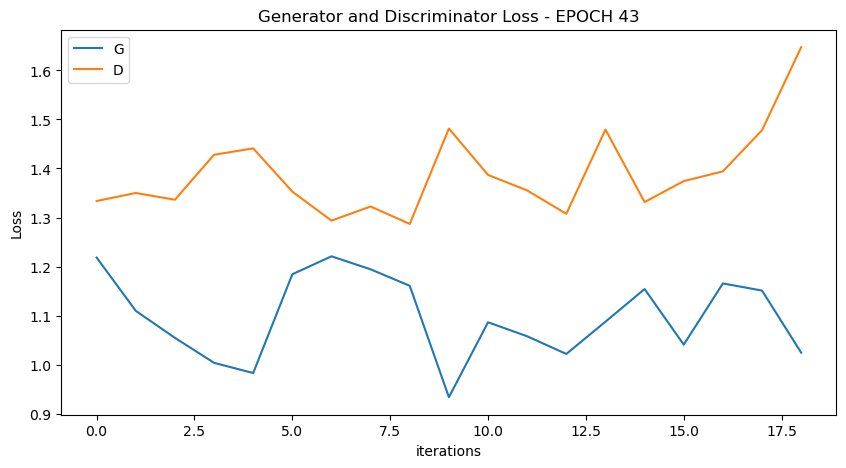

  0%|          | 0/19 [00:00<?, ?it/s]

[45/100][9/19] Loss_D: 1.2110 Loss_G: 1.1208 D(x): 0.4984 D(G(z)): 0.3832 / 0.3057
[45/100][18/19] Loss_D: 1.3855 Loss_G: 1.1086 D(x): 0.4552 D(G(z)): 0.4372 / 0.3089


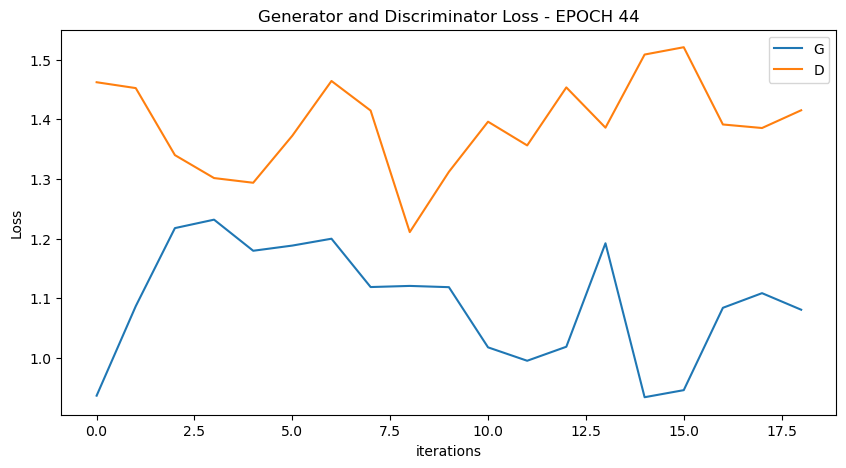

  0%|          | 0/19 [00:00<?, ?it/s]

[46/100][9/19] Loss_D: 1.4151 Loss_G: 0.9613 D(x): 0.4321 D(G(z)): 0.4252 / 0.3702
[46/100][18/19] Loss_D: 1.4485 Loss_G: 1.1540 D(x): 0.3902 D(G(z)): 0.3936 / 0.3026


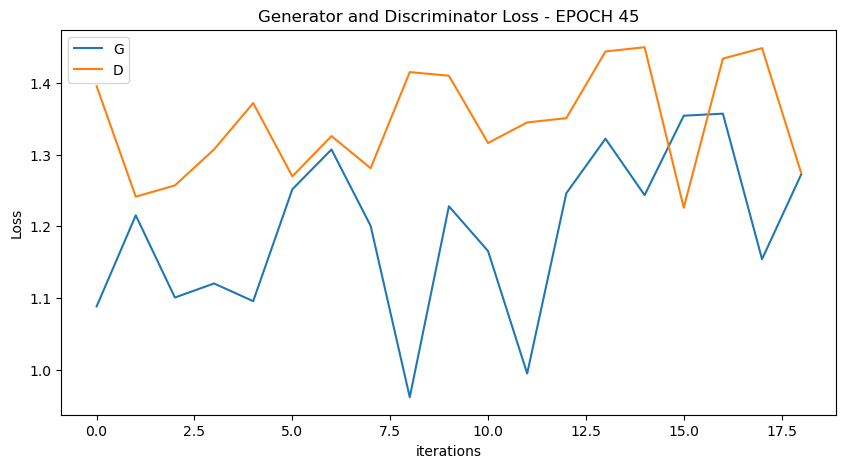

  0%|          | 0/19 [00:00<?, ?it/s]

[47/100][9/19] Loss_D: 1.3191 Loss_G: 1.1031 D(x): 0.4906 D(G(z)): 0.4277 / 0.3146
[47/100][18/19] Loss_D: 1.4137 Loss_G: 1.0455 D(x): 0.4193 D(G(z)): 0.4083 / 0.3349


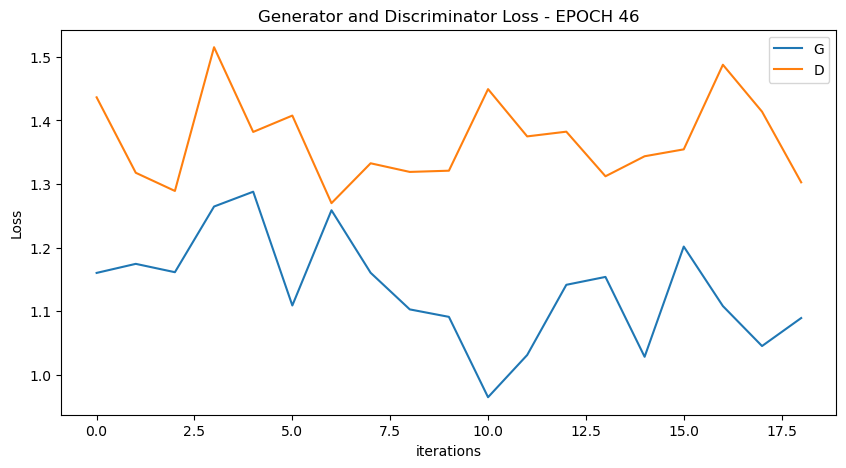

  0%|          | 0/19 [00:00<?, ?it/s]

[48/100][9/19] Loss_D: 1.3138 Loss_G: 1.1798 D(x): 0.5199 D(G(z)): 0.4570 / 0.2881
[48/100][18/19] Loss_D: 1.4463 Loss_G: 1.1225 D(x): 0.4577 D(G(z)): 0.4693 / 0.3076


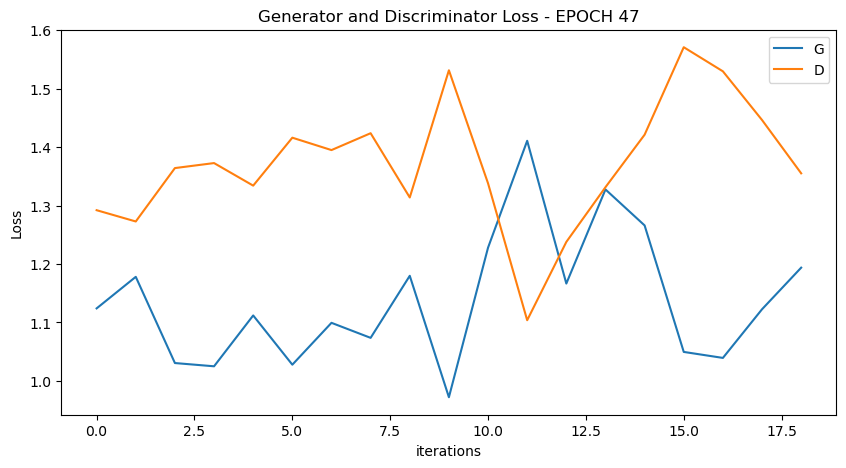

  0%|          | 0/19 [00:00<?, ?it/s]

[49/100][9/19] Loss_D: 1.3417 Loss_G: 1.1329 D(x): 0.4487 D(G(z)): 0.3950 / 0.3098
[49/100][18/19] Loss_D: 1.4778 Loss_G: 1.2865 D(x): 0.4028 D(G(z)): 0.4249 / 0.2598


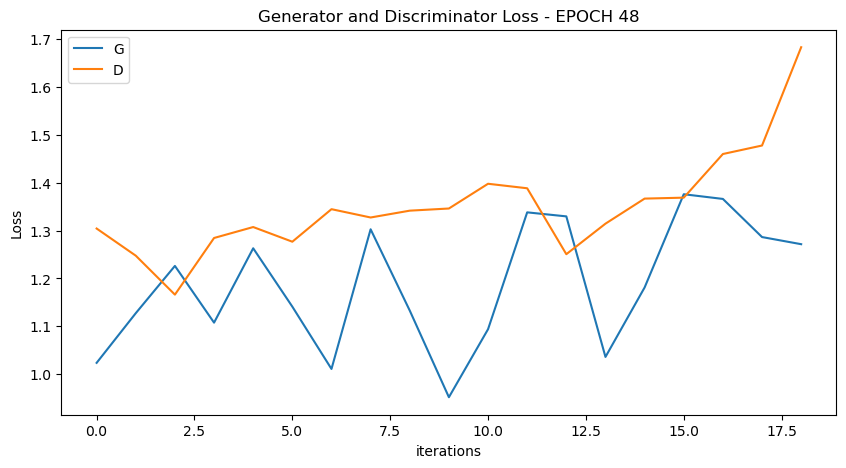

  0%|          | 0/19 [00:00<?, ?it/s]

[50/100][9/19] Loss_D: 1.3536 Loss_G: 1.0424 D(x): 0.5163 D(G(z)): 0.4795 / 0.3357
[50/100][18/19] Loss_D: 1.3518 Loss_G: 1.1209 D(x): 0.4464 D(G(z)): 0.4150 / 0.3109


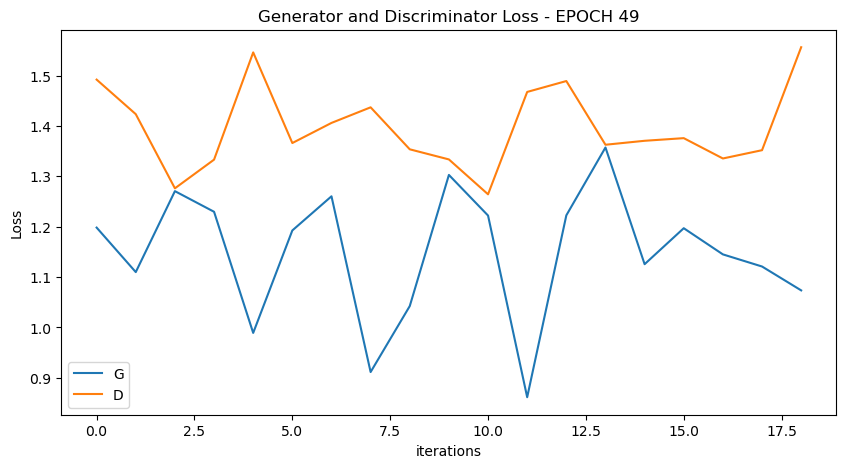

  0%|          | 0/19 [00:00<?, ?it/s]

[51/100][9/19] Loss_D: 1.2858 Loss_G: 1.2473 D(x): 0.5356 D(G(z)): 0.4489 / 0.2733
[51/100][18/19] Loss_D: 1.6513 Loss_G: 1.4702 D(x): 0.5657 D(G(z)): 0.6235 / 0.2153


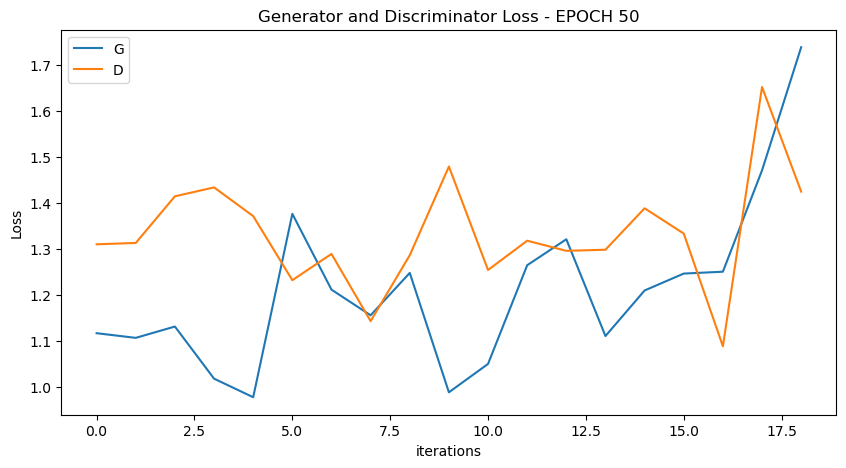

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


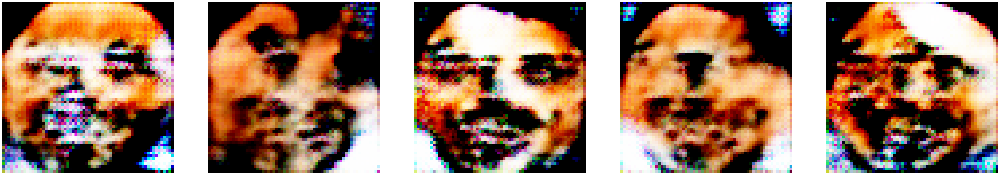

  0%|          | 0/19 [00:00<?, ?it/s]

[52/100][9/19] Loss_D: 1.3151 Loss_G: 1.2954 D(x): 0.4434 D(G(z)): 0.3721 / 0.2620
[52/100][18/19] Loss_D: 1.4776 Loss_G: 1.4838 D(x): 0.5587 D(G(z)): 0.5444 / 0.2068


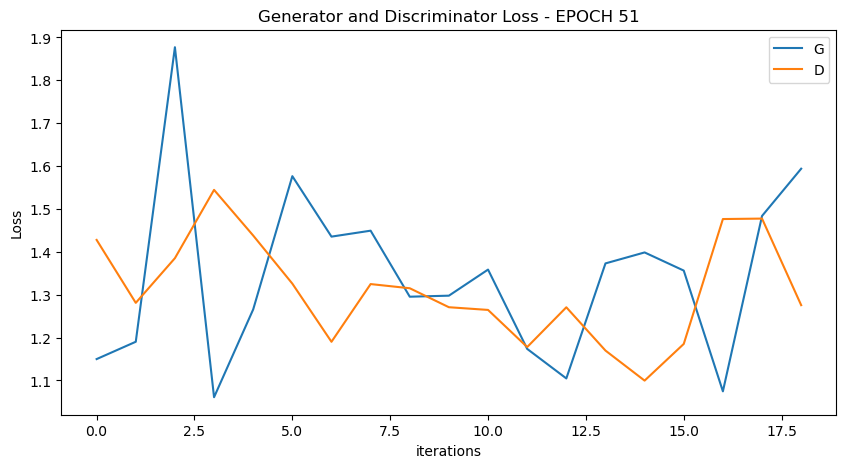

  0%|          | 0/19 [00:00<?, ?it/s]

[53/100][9/19] Loss_D: 1.3505 Loss_G: 1.2033 D(x): 0.4236 D(G(z)): 0.3807 / 0.2795
[53/100][18/19] Loss_D: 1.3893 Loss_G: 1.2271 D(x): 0.4429 D(G(z)): 0.4204 / 0.2799


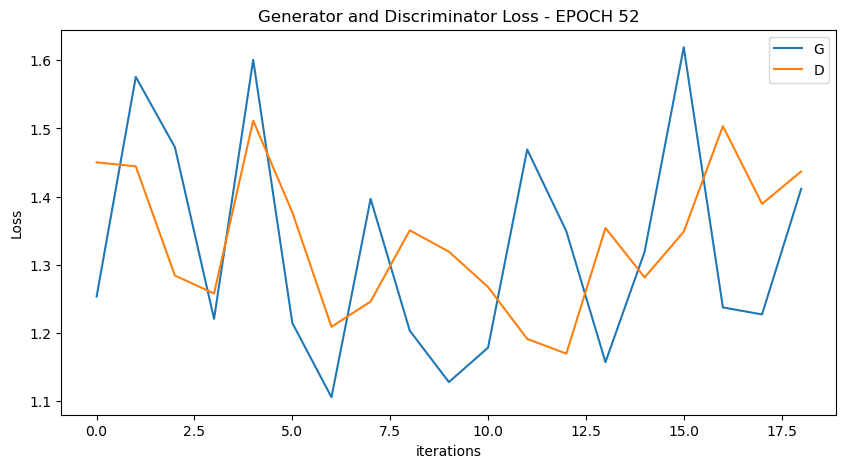

  0%|          | 0/19 [00:00<?, ?it/s]

[54/100][9/19] Loss_D: 1.2916 Loss_G: 1.1075 D(x): 0.4569 D(G(z)): 0.3808 / 0.3214
[54/100][18/19] Loss_D: 1.3226 Loss_G: 1.3104 D(x): 0.5108 D(G(z)): 0.4447 / 0.2480


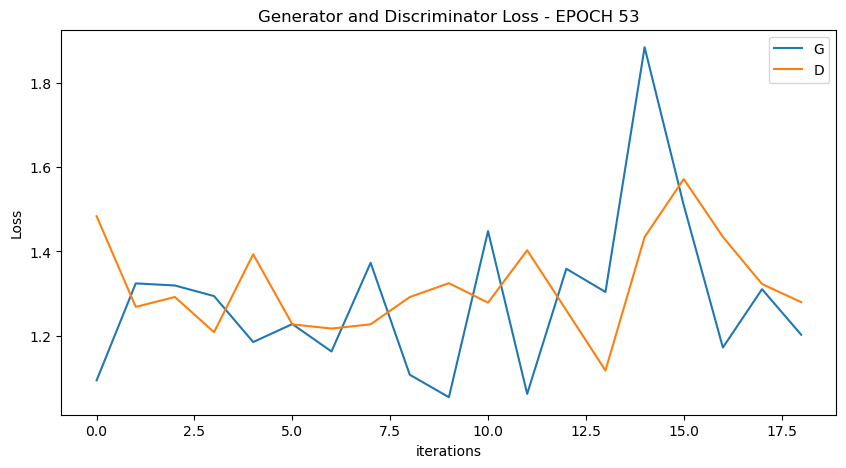

  0%|          | 0/19 [00:00<?, ?it/s]

[55/100][9/19] Loss_D: 1.3982 Loss_G: 1.4120 D(x): 0.4670 D(G(z)): 0.4560 / 0.2186
[55/100][18/19] Loss_D: 1.4488 Loss_G: 1.0367 D(x): 0.4115 D(G(z)): 0.4234 / 0.3465


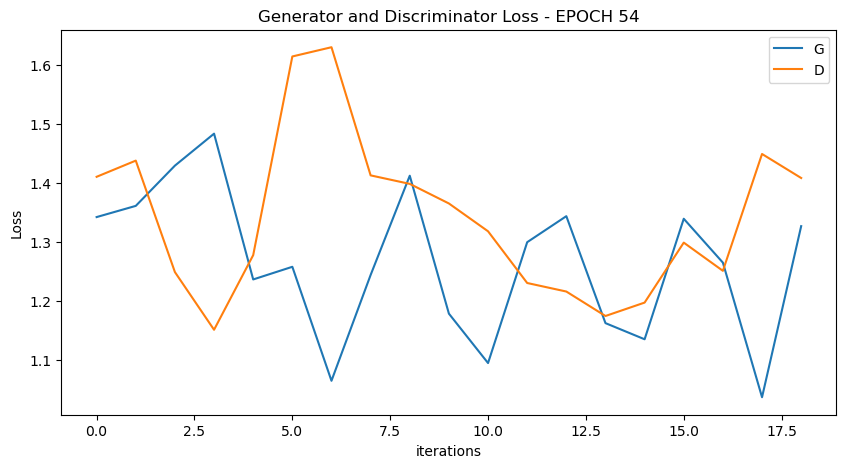

  0%|          | 0/19 [00:00<?, ?it/s]

[56/100][9/19] Loss_D: 1.4174 Loss_G: 1.1676 D(x): 0.4573 D(G(z)): 0.4492 / 0.2955
[56/100][18/19] Loss_D: 1.5232 Loss_G: 1.2154 D(x): 0.3635 D(G(z)): 0.3980 / 0.2839


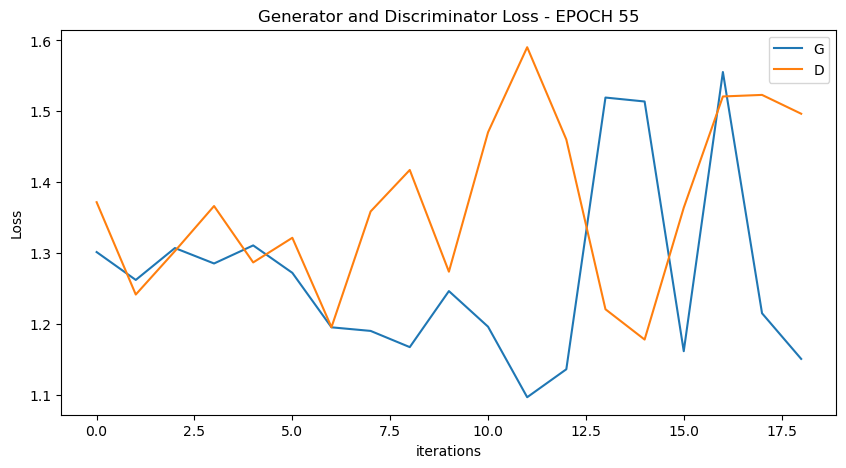

  0%|          | 0/19 [00:00<?, ?it/s]

[57/100][9/19] Loss_D: 1.4890 Loss_G: 1.3243 D(x): 0.4475 D(G(z)): 0.4712 / 0.2476
[57/100][18/19] Loss_D: 1.3735 Loss_G: 1.2738 D(x): 0.4177 D(G(z)): 0.3901 / 0.2600


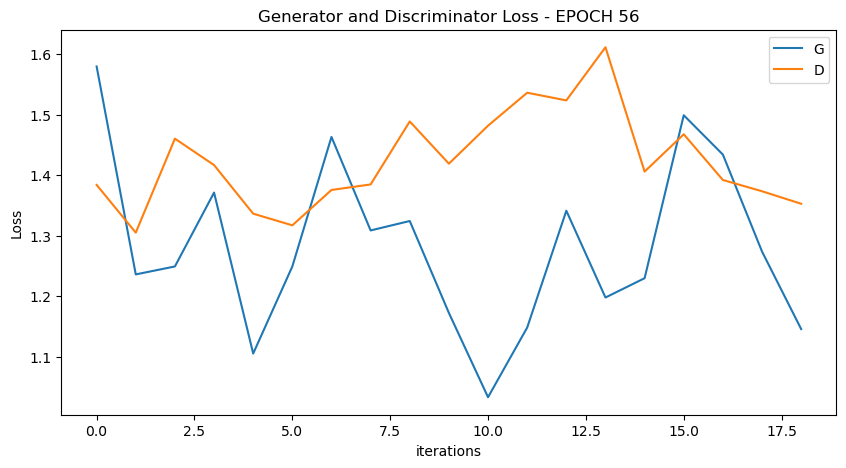

  0%|          | 0/19 [00:00<?, ?it/s]

[58/100][9/19] Loss_D: 1.2991 Loss_G: 1.2666 D(x): 0.5244 D(G(z)): 0.4497 / 0.2663
[58/100][18/19] Loss_D: 1.1235 Loss_G: 1.5238 D(x): 0.5481 D(G(z)): 0.3662 / 0.1998


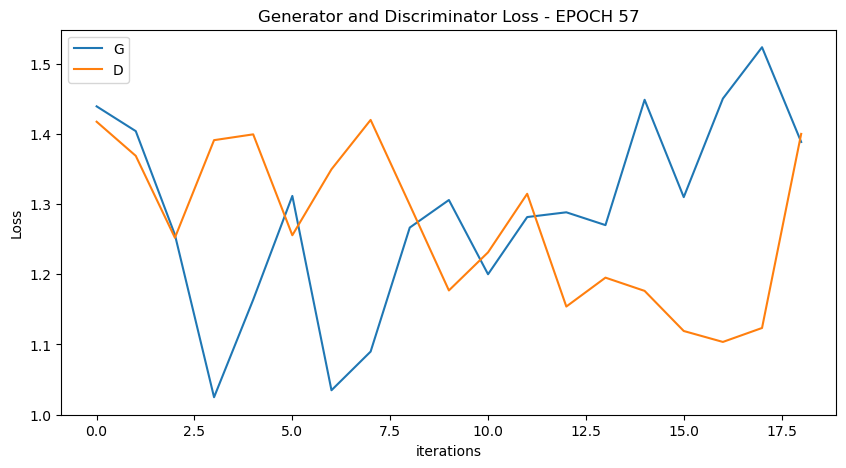

  0%|          | 0/19 [00:00<?, ?it/s]

[59/100][9/19] Loss_D: 1.3449 Loss_G: 1.3857 D(x): 0.4159 D(G(z)): 0.3526 / 0.2299
[59/100][18/19] Loss_D: 1.1483 Loss_G: 1.2149 D(x): 0.5381 D(G(z)): 0.3828 / 0.2800


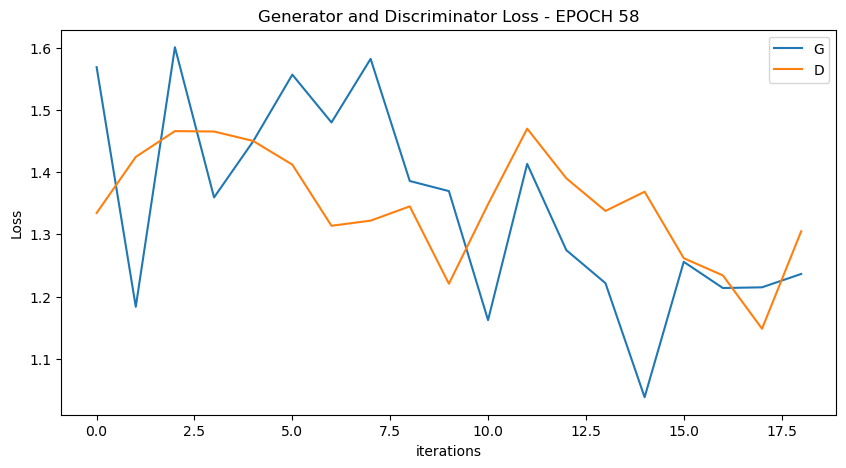

  0%|          | 0/19 [00:00<?, ?it/s]

[60/100][9/19] Loss_D: 1.2073 Loss_G: 1.6647 D(x): 0.5355 D(G(z)): 0.4124 / 0.1876
[60/100][18/19] Loss_D: 1.4752 Loss_G: 1.1922 D(x): 0.4506 D(G(z)): 0.4696 / 0.2905


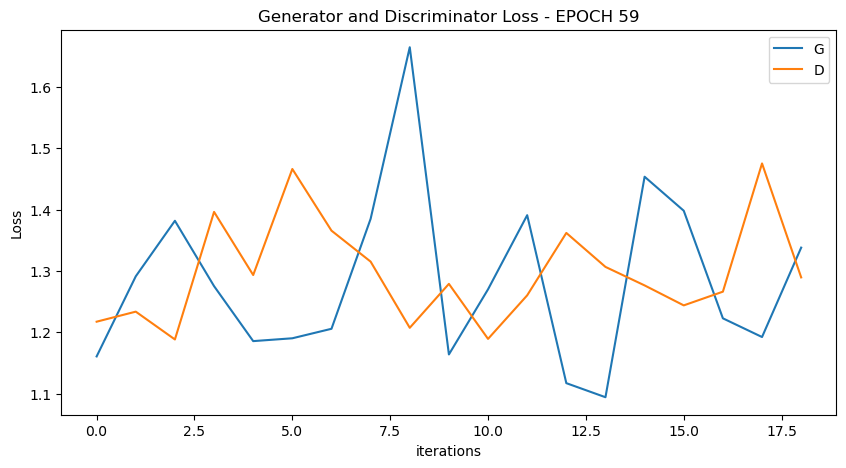

  0%|          | 0/19 [00:00<?, ?it/s]

[61/100][9/19] Loss_D: 1.5021 Loss_G: 1.4248 D(x): 0.4469 D(G(z)): 0.4810 / 0.2271
[61/100][18/19] Loss_D: 1.0950 Loss_G: 1.4598 D(x): 0.5961 D(G(z)): 0.3974 / 0.2118


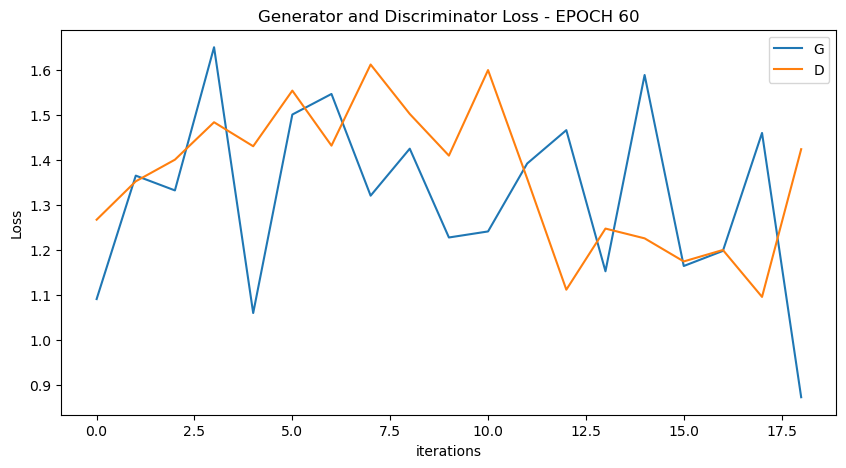

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


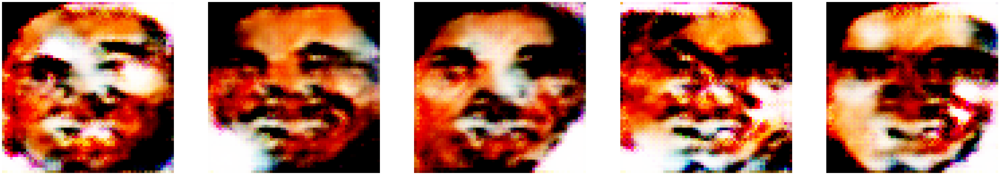

  0%|          | 0/19 [00:00<?, ?it/s]

[62/100][9/19] Loss_D: 1.2896 Loss_G: 1.2706 D(x): 0.5103 D(G(z)): 0.4194 / 0.2691
[62/100][18/19] Loss_D: 1.3702 Loss_G: 1.2813 D(x): 0.4436 D(G(z)): 0.4154 / 0.2558


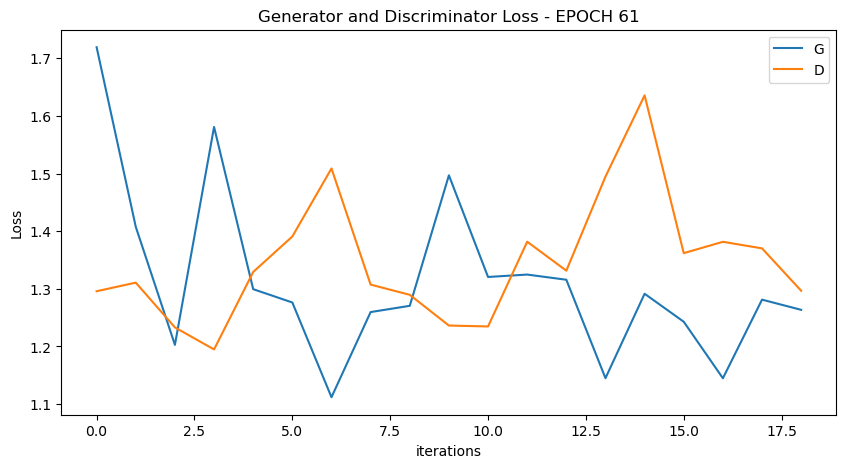

  0%|          | 0/19 [00:00<?, ?it/s]

[63/100][9/19] Loss_D: 1.3143 Loss_G: 1.7122 D(x): 0.4834 D(G(z)): 0.4175 / 0.1632
[63/100][18/19] Loss_D: 1.2905 Loss_G: 1.2041 D(x): 0.4920 D(G(z)): 0.4208 / 0.2915


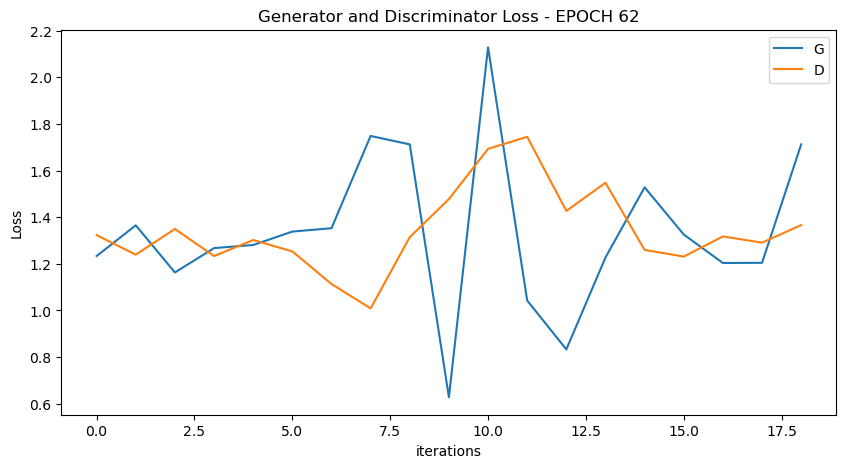

  0%|          | 0/19 [00:00<?, ?it/s]

[64/100][9/19] Loss_D: 1.2589 Loss_G: 1.2465 D(x): 0.4823 D(G(z)): 0.3783 / 0.2722
[64/100][18/19] Loss_D: 1.1970 Loss_G: 1.5160 D(x): 0.5411 D(G(z)): 0.4109 / 0.1996


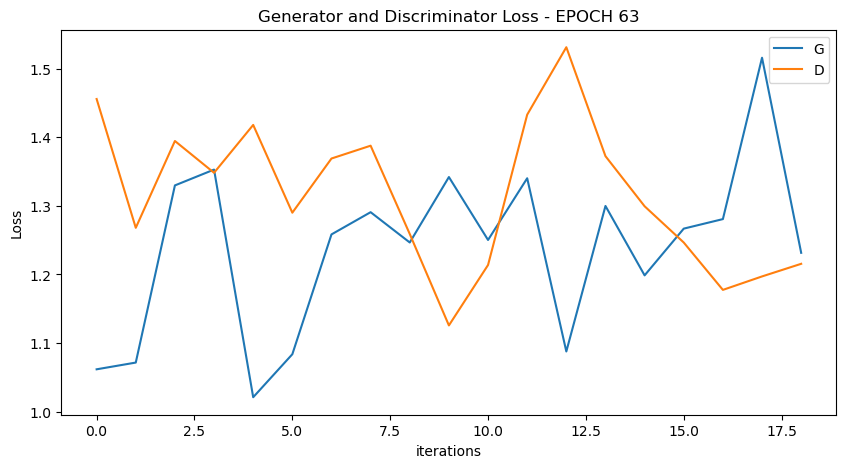

  0%|          | 0/19 [00:00<?, ?it/s]

[65/100][9/19] Loss_D: 1.3249 Loss_G: 1.6287 D(x): 0.5281 D(G(z)): 0.4677 / 0.1872
[65/100][18/19] Loss_D: 1.2221 Loss_G: 1.2294 D(x): 0.4657 D(G(z)): 0.3532 / 0.2746


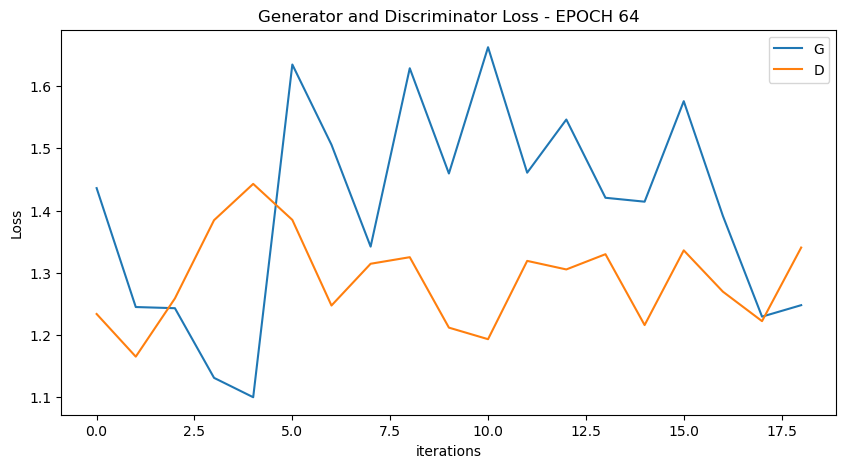

  0%|          | 0/19 [00:00<?, ?it/s]

[66/100][9/19] Loss_D: 1.5230 Loss_G: 1.3003 D(x): 0.4460 D(G(z)): 0.4844 / 0.2674
[66/100][18/19] Loss_D: 1.3843 Loss_G: 1.1050 D(x): 0.4105 D(G(z)): 0.3405 / 0.3120


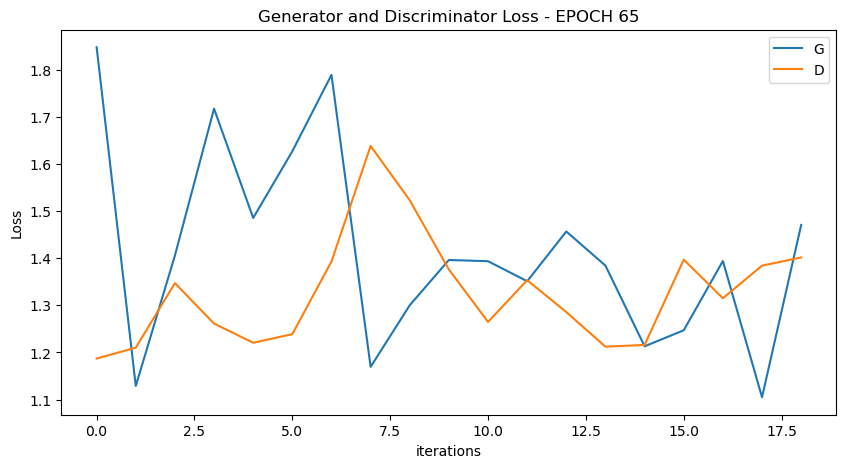

  0%|          | 0/19 [00:00<?, ?it/s]

[67/100][9/19] Loss_D: 1.5446 Loss_G: 1.7018 D(x): 0.6170 D(G(z)): 0.6146 / 0.1593
[67/100][18/19] Loss_D: 1.3032 Loss_G: 1.0989 D(x): 0.4558 D(G(z)): 0.3889 / 0.3133


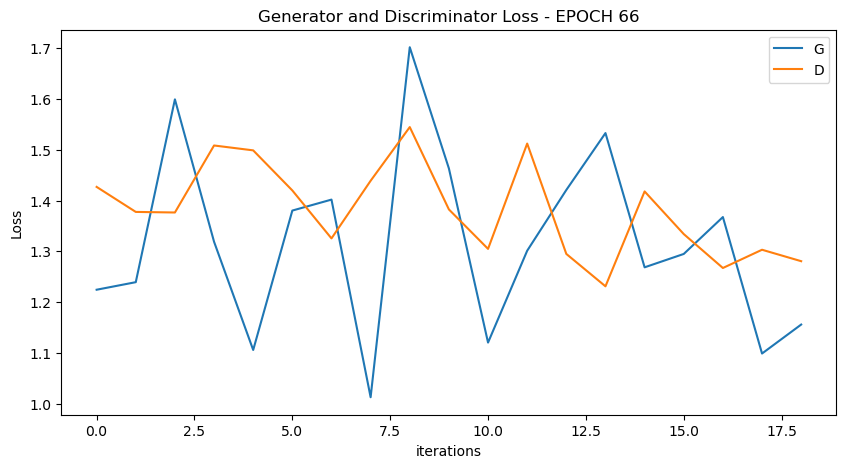

  0%|          | 0/19 [00:00<?, ?it/s]

[68/100][9/19] Loss_D: 1.6009 Loss_G: 1.2193 D(x): 0.3993 D(G(z)): 0.4764 / 0.2795
[68/100][18/19] Loss_D: 1.4536 Loss_G: 1.1130 D(x): 0.4356 D(G(z)): 0.4375 / 0.3145


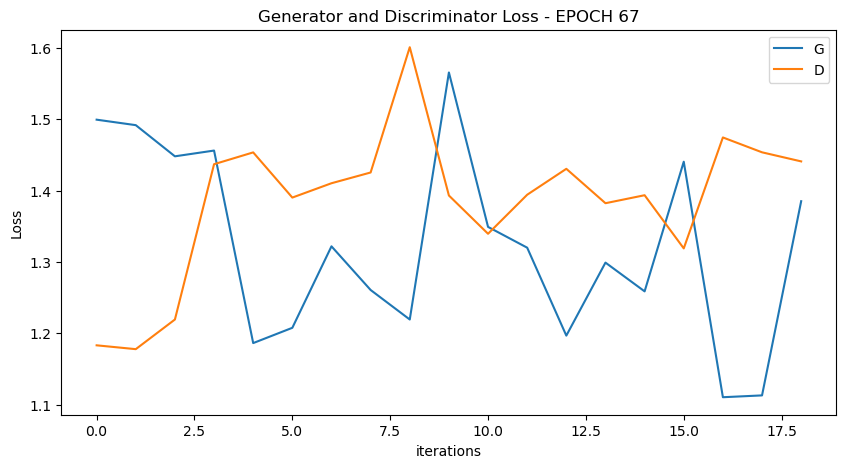

  0%|          | 0/19 [00:00<?, ?it/s]

[69/100][9/19] Loss_D: 1.0794 Loss_G: 1.2638 D(x): 0.5662 D(G(z)): 0.3690 / 0.2625
[69/100][18/19] Loss_D: 1.5974 Loss_G: 0.8740 D(x): 0.2931 D(G(z)): 0.3441 / 0.4192


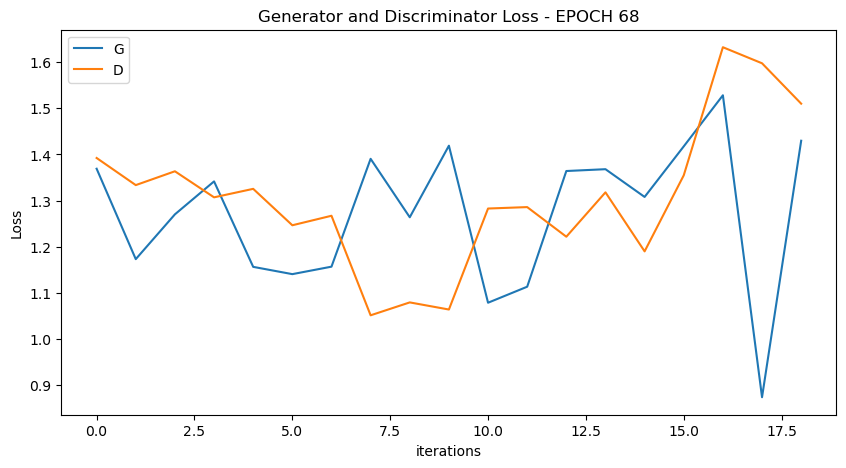

  0%|          | 0/19 [00:00<?, ?it/s]

[70/100][9/19] Loss_D: 1.3384 Loss_G: 0.9163 D(x): 0.3881 D(G(z)): 0.3314 / 0.3904
[70/100][18/19] Loss_D: 1.3815 Loss_G: 1.3251 D(x): 0.5813 D(G(z)): 0.5387 / 0.2462


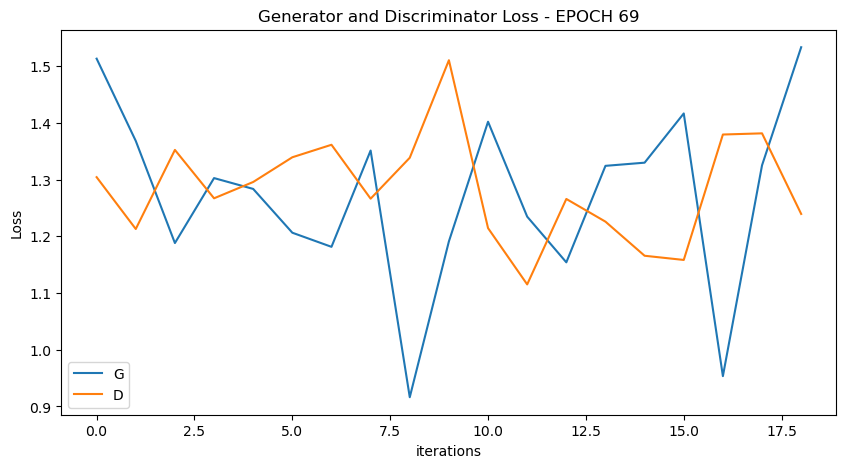

  0%|          | 0/19 [00:00<?, ?it/s]

[71/100][9/19] Loss_D: 1.3101 Loss_G: 1.2315 D(x): 0.4542 D(G(z)): 0.3844 / 0.2725
[71/100][18/19] Loss_D: 1.3482 Loss_G: 1.4668 D(x): 0.4329 D(G(z)): 0.3703 / 0.2128


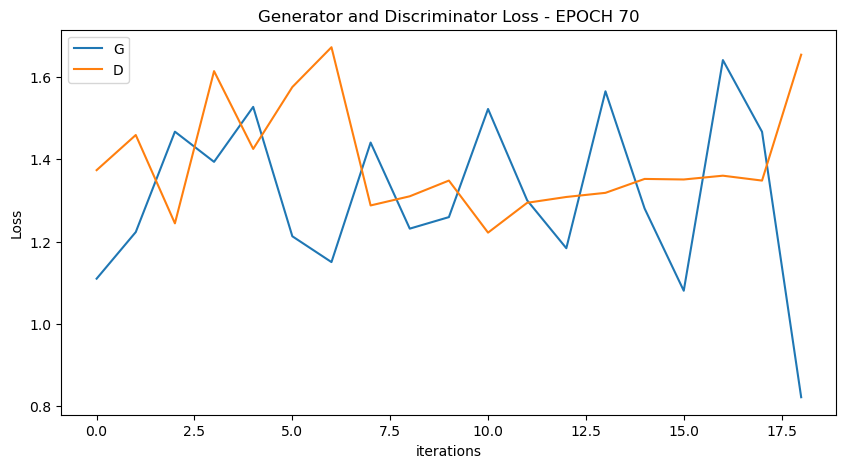

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


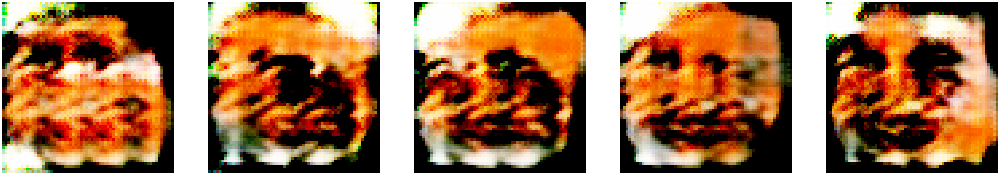

  0%|          | 0/19 [00:00<?, ?it/s]

[72/100][9/19] Loss_D: 1.2598 Loss_G: 1.4152 D(x): 0.4857 D(G(z)): 0.3840 / 0.2244
[72/100][18/19] Loss_D: 1.3241 Loss_G: 1.2197 D(x): 0.4923 D(G(z)): 0.4384 / 0.2788


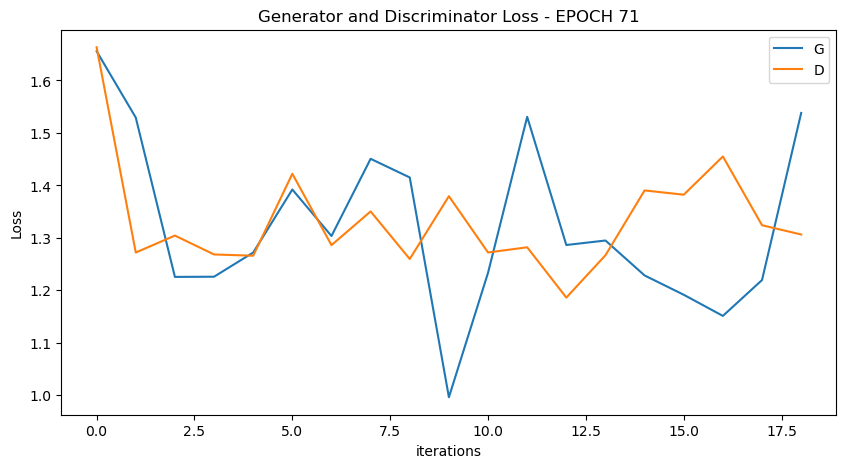

  0%|          | 0/19 [00:00<?, ?it/s]

[73/100][9/19] Loss_D: 1.4682 Loss_G: 1.0884 D(x): 0.4037 D(G(z)): 0.4210 / 0.3217
[73/100][18/19] Loss_D: 1.3703 Loss_G: 1.3567 D(x): 0.4124 D(G(z)): 0.3652 / 0.2512


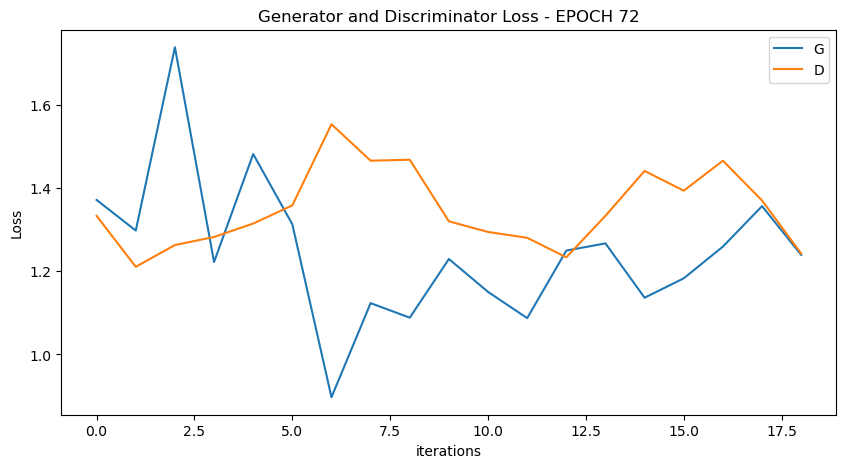

  0%|          | 0/19 [00:00<?, ?it/s]

[74/100][9/19] Loss_D: 1.0044 Loss_G: 1.9248 D(x): 0.6289 D(G(z)): 0.3655 / 0.1293
[74/100][18/19] Loss_D: 1.3761 Loss_G: 1.1921 D(x): 0.4756 D(G(z)): 0.4417 / 0.2958


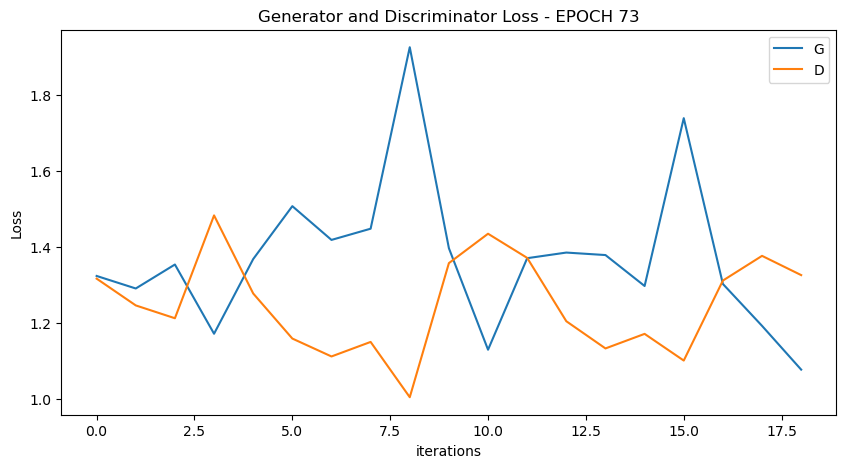

  0%|          | 0/19 [00:00<?, ?it/s]

[75/100][9/19] Loss_D: 1.2578 Loss_G: 1.1731 D(x): 0.5403 D(G(z)): 0.4313 / 0.2955
[75/100][18/19] Loss_D: 1.1458 Loss_G: 1.5012 D(x): 0.5341 D(G(z)): 0.3643 / 0.2084


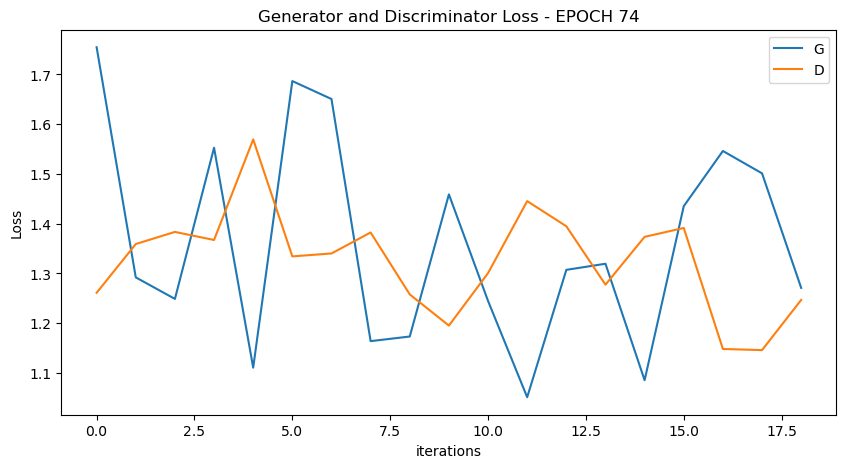

  0%|          | 0/19 [00:00<?, ?it/s]

[76/100][9/19] Loss_D: 1.4843 Loss_G: 1.1950 D(x): 0.4309 D(G(z)): 0.4496 / 0.2851
[76/100][18/19] Loss_D: 1.3623 Loss_G: 1.5804 D(x): 0.5218 D(G(z)): 0.4809 / 0.1844


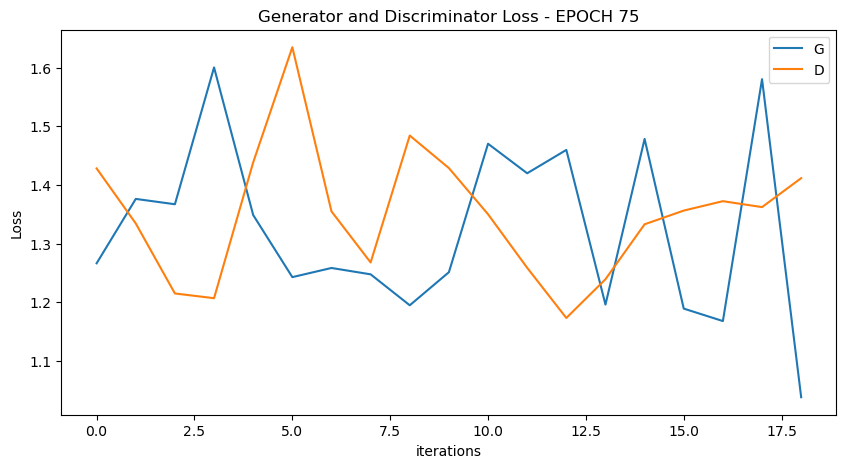

  0%|          | 0/19 [00:00<?, ?it/s]

[77/100][9/19] Loss_D: 1.2848 Loss_G: 1.2764 D(x): 0.4810 D(G(z)): 0.3917 / 0.2579
[77/100][18/19] Loss_D: 1.3682 Loss_G: 1.1512 D(x): 0.4922 D(G(z)): 0.4542 / 0.2994


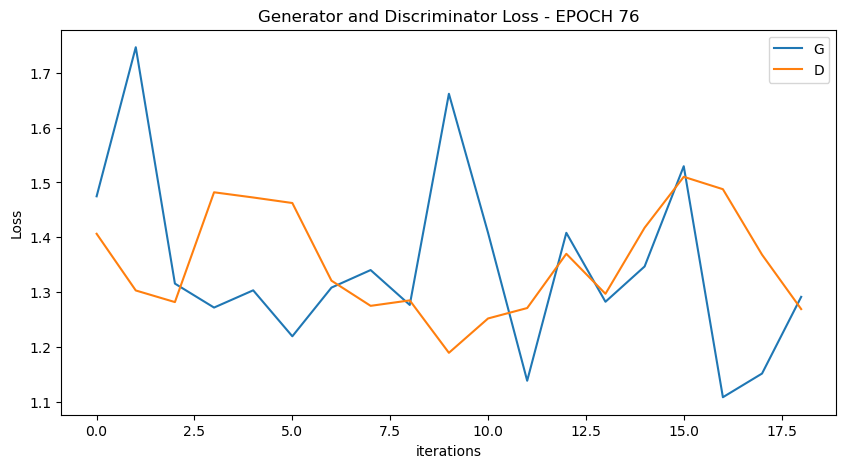

  0%|          | 0/19 [00:00<?, ?it/s]

[78/100][9/19] Loss_D: 1.5458 Loss_G: 1.1408 D(x): 0.4110 D(G(z)): 0.4485 / 0.3097
[78/100][18/19] Loss_D: 1.3590 Loss_G: 1.0607 D(x): 0.4136 D(G(z)): 0.3547 / 0.3400


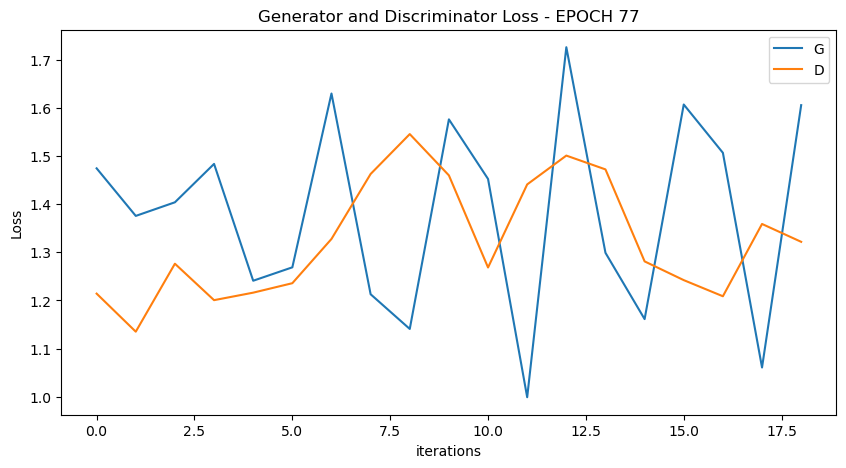

  0%|          | 0/19 [00:00<?, ?it/s]

[79/100][9/19] Loss_D: 1.4159 Loss_G: 1.2640 D(x): 0.5046 D(G(z)): 0.4772 / 0.2688
[79/100][18/19] Loss_D: 1.2713 Loss_G: 1.0822 D(x): 0.4906 D(G(z)): 0.4083 / 0.3257


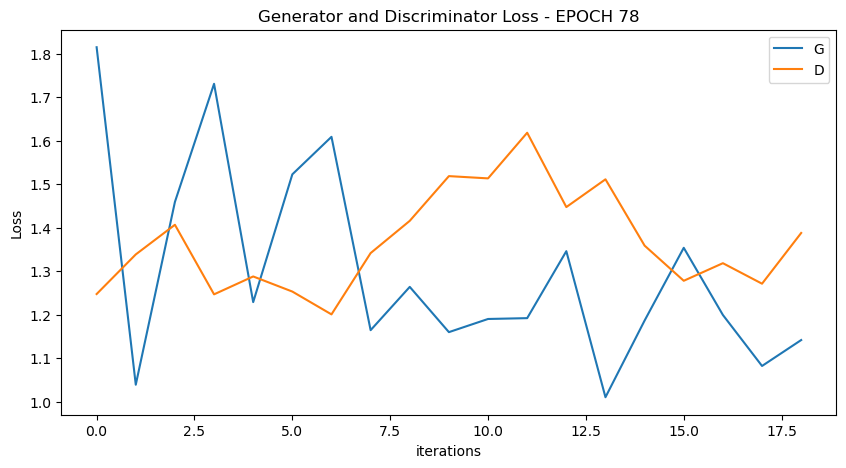

  0%|          | 0/19 [00:00<?, ?it/s]

[80/100][9/19] Loss_D: 1.2922 Loss_G: 1.1182 D(x): 0.4357 D(G(z)): 0.3596 / 0.3089
[80/100][18/19] Loss_D: 1.3513 Loss_G: 1.2705 D(x): 0.4261 D(G(z)): 0.3758 / 0.2728


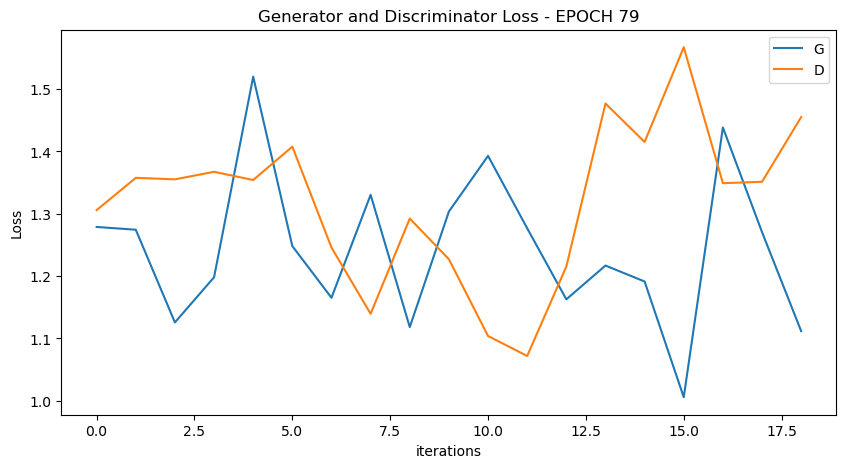

  0%|          | 0/19 [00:00<?, ?it/s]

[81/100][9/19] Loss_D: 1.3467 Loss_G: 1.3912 D(x): 0.5430 D(G(z)): 0.4735 / 0.2357
[81/100][18/19] Loss_D: 1.1942 Loss_G: 1.3577 D(x): 0.5370 D(G(z)): 0.4059 / 0.2398


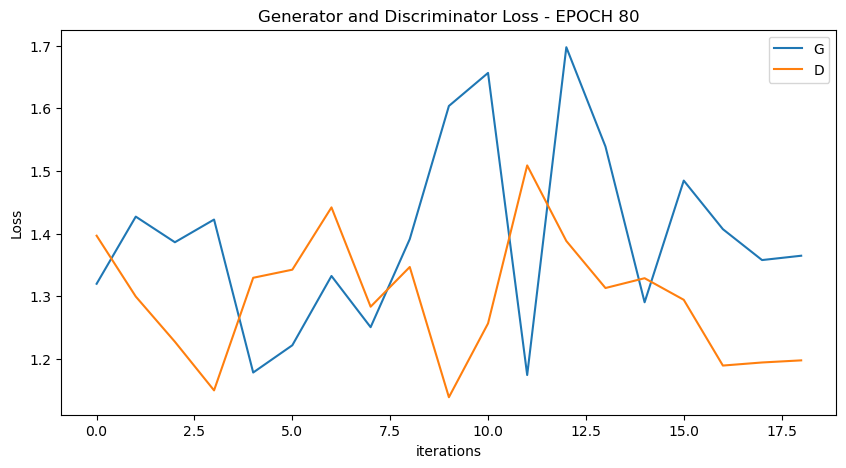

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


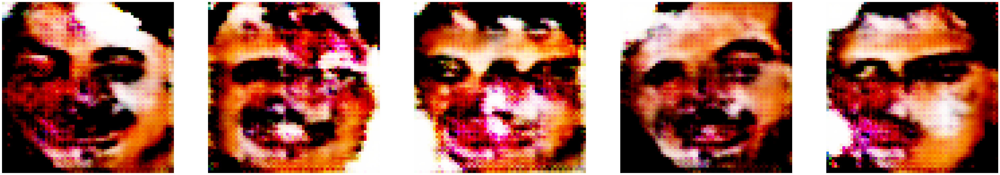

  0%|          | 0/19 [00:00<?, ?it/s]

[82/100][9/19] Loss_D: 1.2681 Loss_G: 1.4951 D(x): 0.5495 D(G(z)): 0.4497 / 0.2054
[82/100][18/19] Loss_D: 1.3193 Loss_G: 1.3746 D(x): 0.5253 D(G(z)): 0.4552 / 0.2406


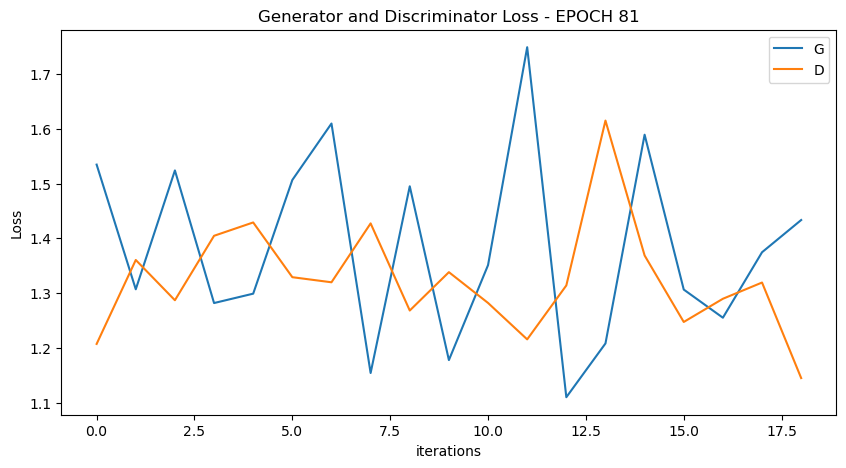

  0%|          | 0/19 [00:00<?, ?it/s]

[83/100][9/19] Loss_D: 1.2931 Loss_G: 1.1067 D(x): 0.4169 D(G(z)): 0.3347 / 0.3155
[83/100][18/19] Loss_D: 1.2522 Loss_G: 1.3631 D(x): 0.4754 D(G(z)): 0.3781 / 0.2425


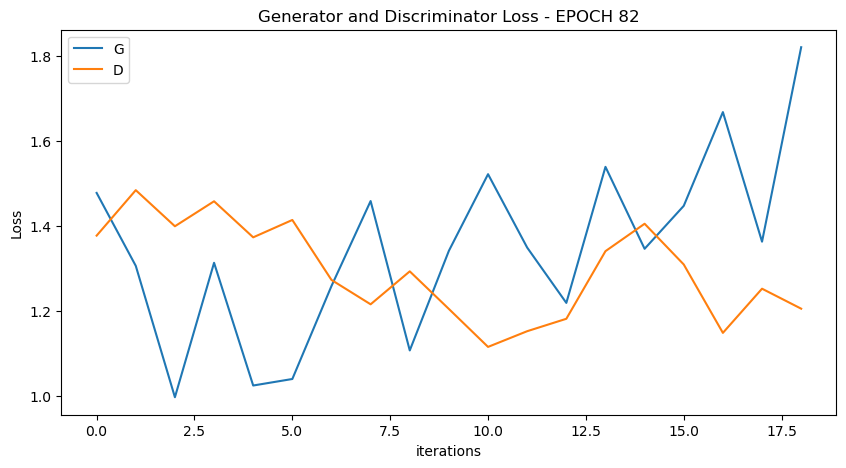

  0%|          | 0/19 [00:00<?, ?it/s]

[84/100][9/19] Loss_D: 1.3471 Loss_G: 1.1750 D(x): 0.4438 D(G(z)): 0.3855 / 0.2984
[84/100][18/19] Loss_D: 1.2119 Loss_G: 1.3258 D(x): 0.4804 D(G(z)): 0.3586 / 0.2599


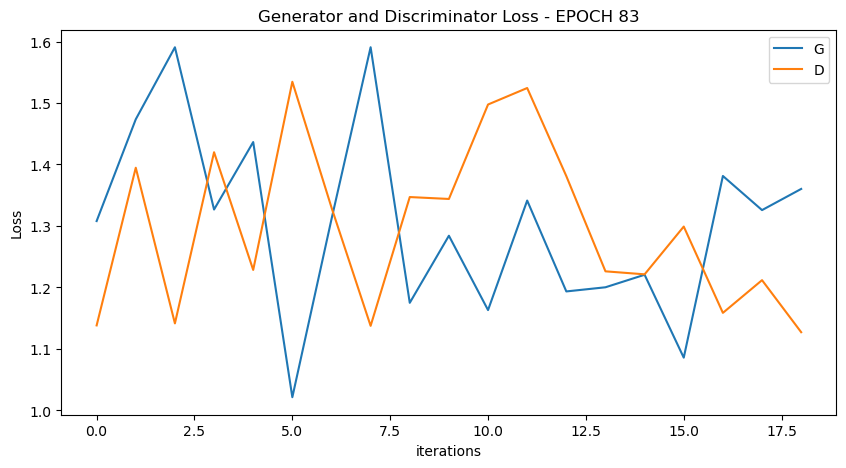

  0%|          | 0/19 [00:00<?, ?it/s]

[85/100][9/19] Loss_D: 1.4847 Loss_G: 1.3273 D(x): 0.5330 D(G(z)): 0.5370 / 0.2577
[85/100][18/19] Loss_D: 1.3350 Loss_G: 1.3322 D(x): 0.5190 D(G(z)): 0.4481 / 0.2529


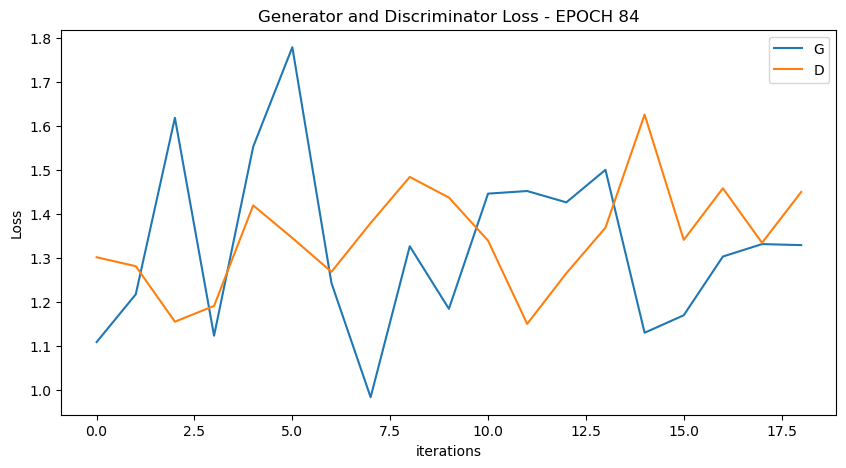

  0%|          | 0/19 [00:00<?, ?it/s]

[86/100][9/19] Loss_D: 1.3430 Loss_G: 1.3310 D(x): 0.5317 D(G(z)): 0.4783 / 0.2579
[86/100][18/19] Loss_D: 1.2698 Loss_G: 1.3358 D(x): 0.5084 D(G(z)): 0.4228 / 0.2460


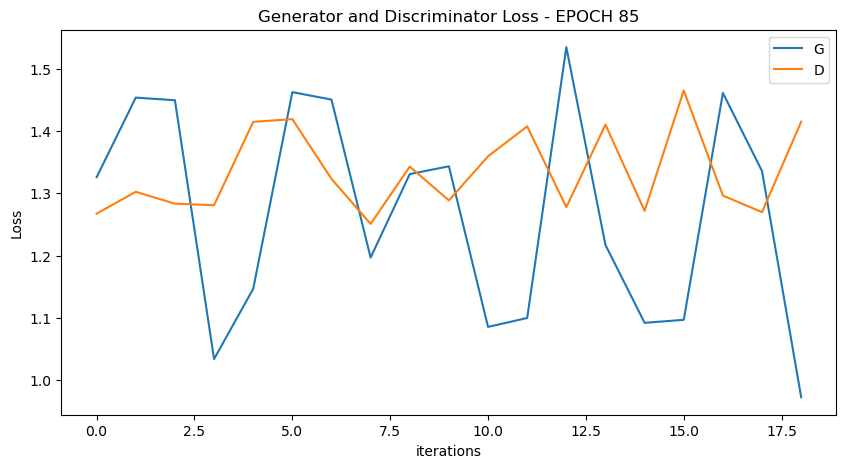

  0%|          | 0/19 [00:00<?, ?it/s]

[87/100][9/19] Loss_D: 1.3645 Loss_G: 1.0815 D(x): 0.4839 D(G(z)): 0.4379 / 0.3296
[87/100][18/19] Loss_D: 1.1718 Loss_G: 1.2798 D(x): 0.5165 D(G(z)): 0.3668 / 0.2605


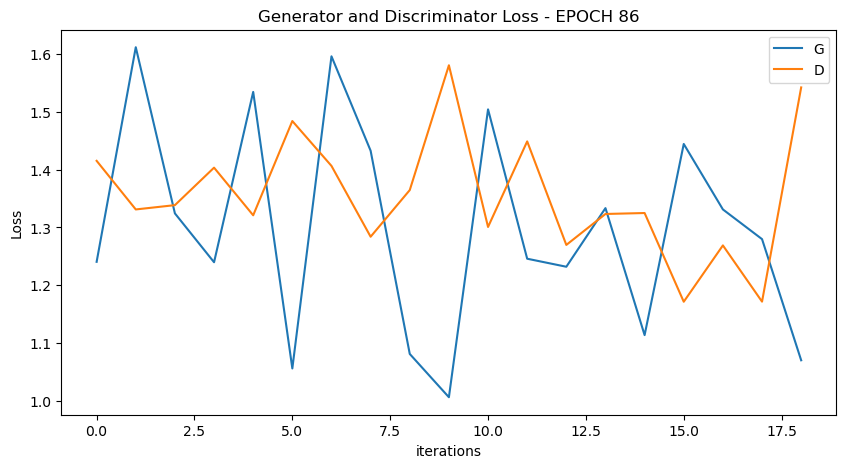

  0%|          | 0/19 [00:00<?, ?it/s]

[88/100][9/19] Loss_D: 1.1815 Loss_G: 1.5298 D(x): 0.5961 D(G(z)): 0.4464 / 0.1955
[88/100][18/19] Loss_D: 1.1946 Loss_G: 1.4892 D(x): 0.4696 D(G(z)): 0.3310 / 0.2071


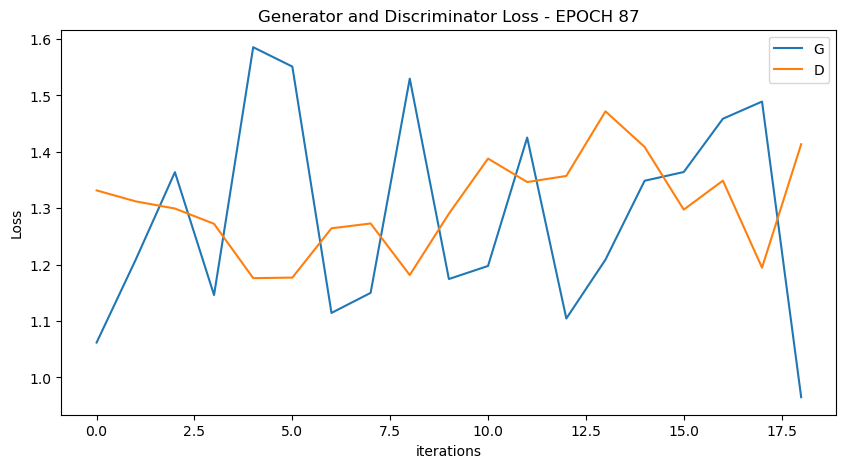

  0%|          | 0/19 [00:00<?, ?it/s]

[89/100][9/19] Loss_D: 1.1920 Loss_G: 1.2929 D(x): 0.4809 D(G(z)): 0.3412 / 0.2621
[89/100][18/19] Loss_D: 1.4067 Loss_G: 1.4901 D(x): 0.5712 D(G(z)): 0.5262 / 0.2152


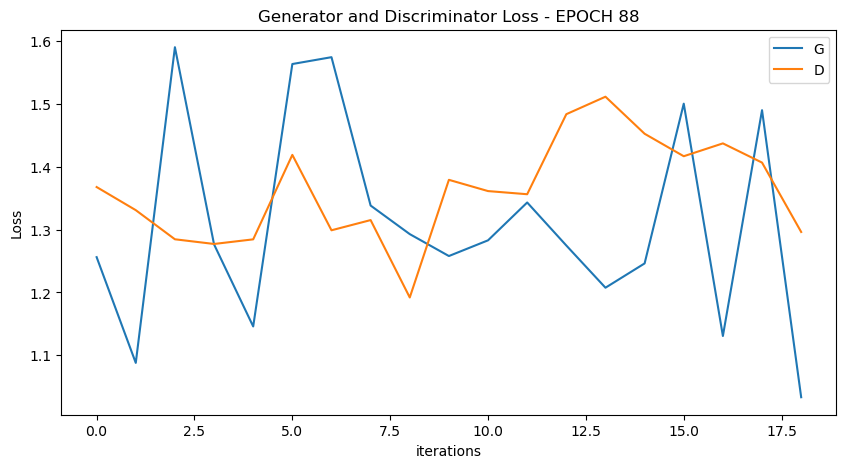

  0%|          | 0/19 [00:00<?, ?it/s]

[90/100][9/19] Loss_D: 1.2355 Loss_G: 1.3738 D(x): 0.4642 D(G(z)): 0.3553 / 0.2353
[90/100][18/19] Loss_D: 1.2475 Loss_G: 1.7252 D(x): 0.5129 D(G(z)): 0.4039 / 0.1612


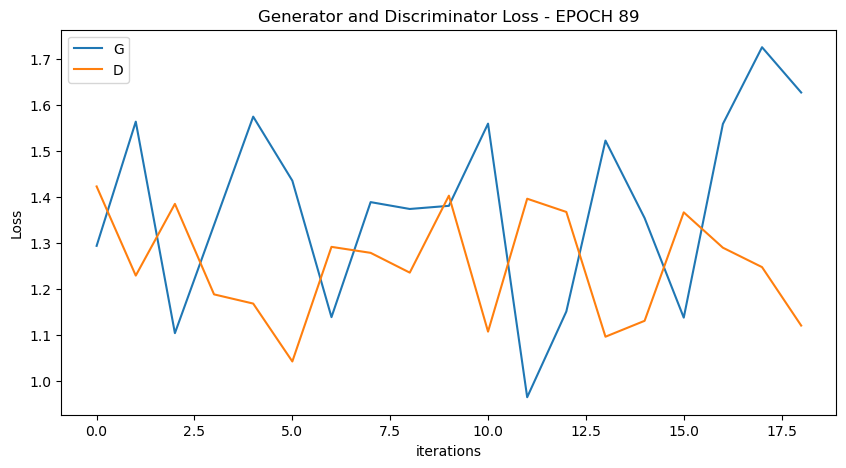

  0%|          | 0/19 [00:00<?, ?it/s]

[91/100][9/19] Loss_D: 1.5558 Loss_G: 1.4841 D(x): 0.4350 D(G(z)): 0.4790 / 0.2166
[91/100][18/19] Loss_D: 1.1594 Loss_G: 1.5952 D(x): 0.6207 D(G(z)): 0.4416 / 0.1926


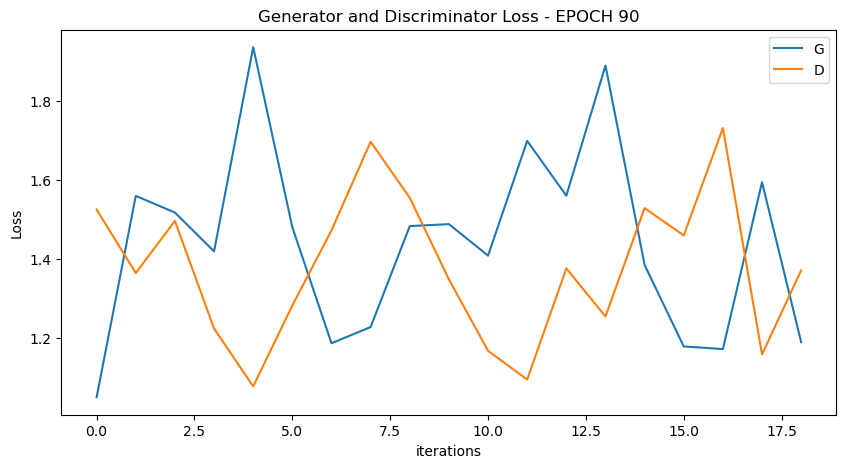

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


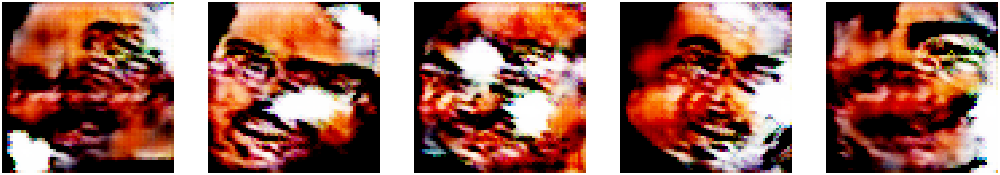

  0%|          | 0/19 [00:00<?, ?it/s]

[92/100][9/19] Loss_D: 1.1361 Loss_G: 1.4901 D(x): 0.6293 D(G(z)): 0.4422 / 0.2053
[92/100][18/19] Loss_D: 1.1435 Loss_G: 1.5748 D(x): 0.6103 D(G(z)): 0.4243 / 0.1917


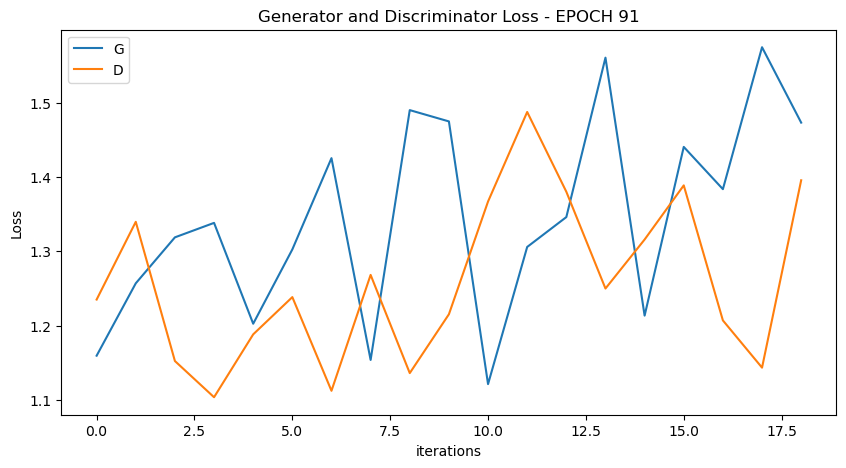

  0%|          | 0/19 [00:00<?, ?it/s]

[93/100][9/19] Loss_D: 1.2392 Loss_G: 1.1446 D(x): 0.6465 D(G(z)): 0.4926 / 0.3081
[93/100][18/19] Loss_D: 1.6677 Loss_G: 0.9897 D(x): 0.3024 D(G(z)): 0.3598 / 0.3619


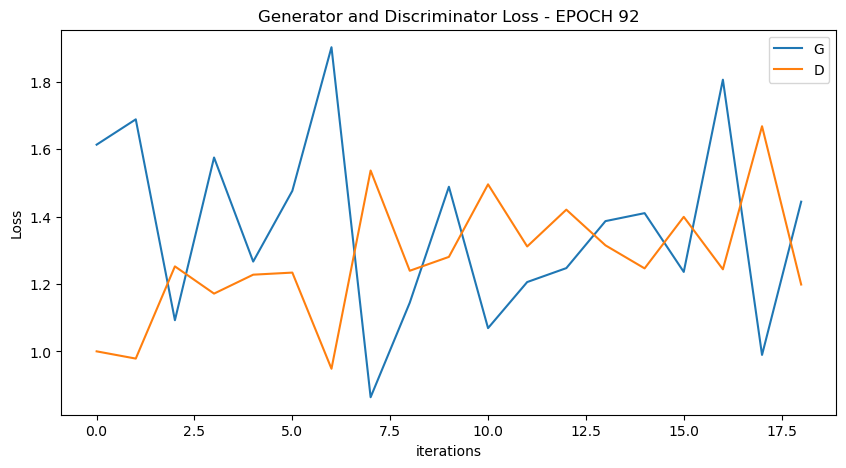

  0%|          | 0/19 [00:00<?, ?it/s]

[94/100][9/19] Loss_D: 1.4312 Loss_G: 1.2045 D(x): 0.3507 D(G(z)): 0.3019 / 0.2941
[94/100][18/19] Loss_D: 1.1640 Loss_G: 1.7276 D(x): 0.5044 D(G(z)): 0.3542 / 0.1617


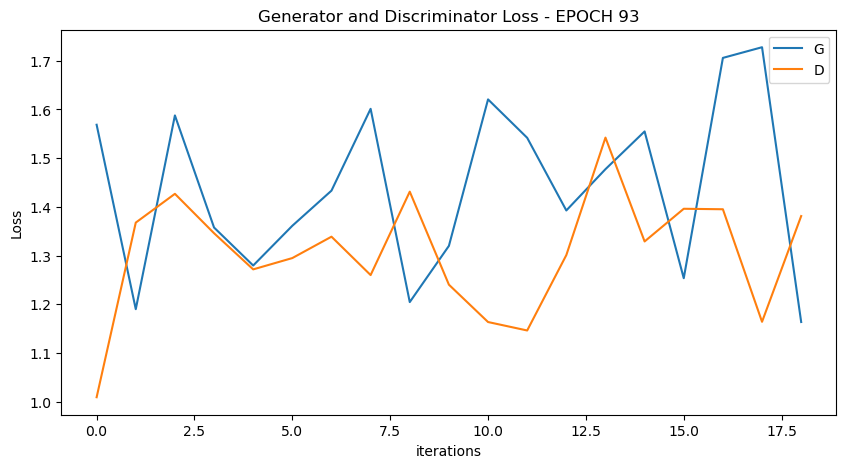

  0%|          | 0/19 [00:00<?, ?it/s]

[95/100][9/19] Loss_D: 1.2179 Loss_G: 1.2888 D(x): 0.5308 D(G(z)): 0.4027 / 0.2581
[95/100][18/19] Loss_D: 1.2463 Loss_G: 1.1756 D(x): 0.5120 D(G(z)): 0.4051 / 0.3020


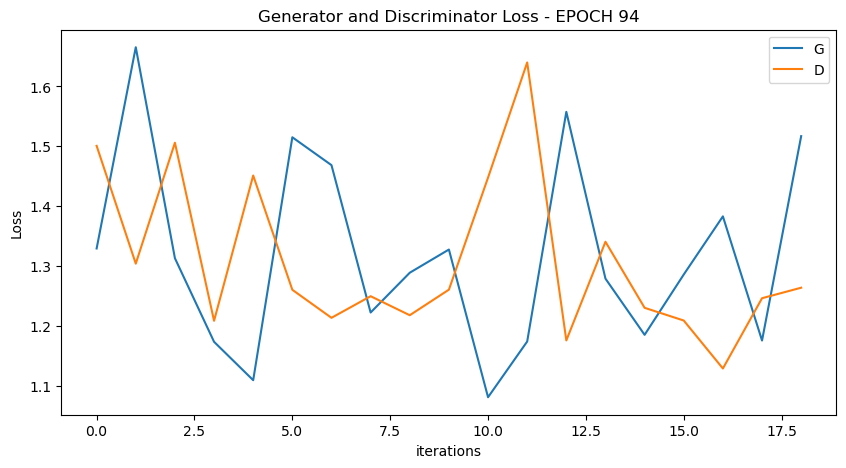

  0%|          | 0/19 [00:00<?, ?it/s]

[96/100][9/19] Loss_D: 1.1980 Loss_G: 1.3023 D(x): 0.4835 D(G(z)): 0.3393 / 0.2691
[96/100][18/19] Loss_D: 1.3951 Loss_G: 1.6854 D(x): 0.5863 D(G(z)): 0.5215 / 0.1874


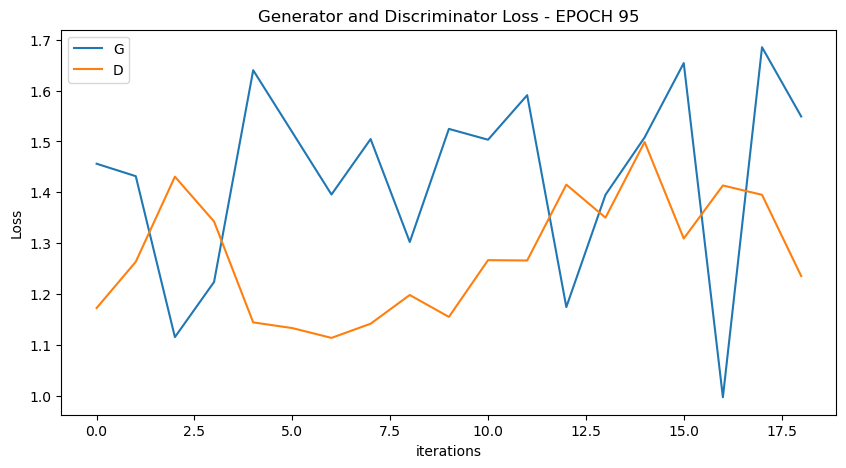

  0%|          | 0/19 [00:00<?, ?it/s]

[97/100][9/19] Loss_D: 1.2749 Loss_G: 1.3337 D(x): 0.4715 D(G(z)): 0.3681 / 0.2476
[97/100][18/19] Loss_D: 1.2999 Loss_G: 1.4374 D(x): 0.5023 D(G(z)): 0.4288 / 0.2246


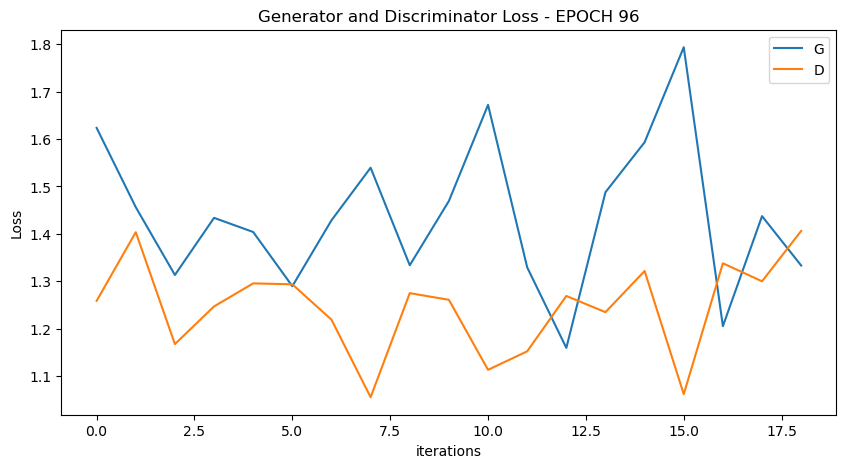

  0%|          | 0/19 [00:00<?, ?it/s]

[98/100][9/19] Loss_D: 1.1099 Loss_G: 1.3809 D(x): 0.4892 D(G(z)): 0.2994 / 0.2331
[98/100][18/19] Loss_D: 1.1575 Loss_G: 1.3589 D(x): 0.6140 D(G(z)): 0.4340 / 0.2480


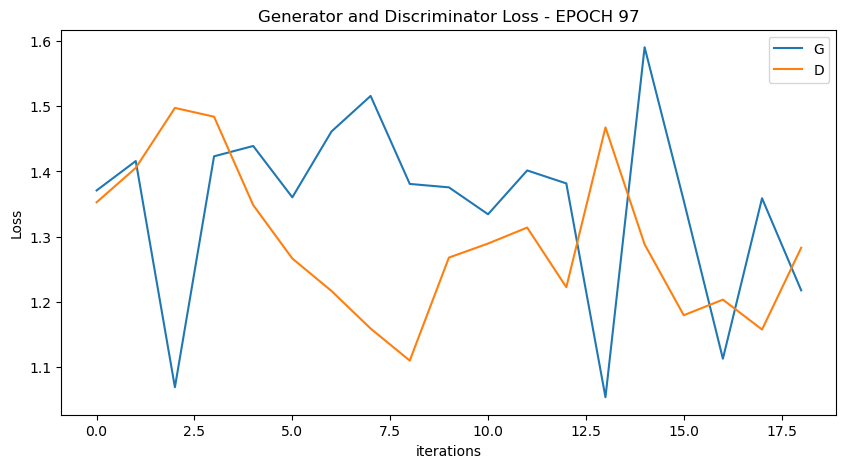

  0%|          | 0/19 [00:00<?, ?it/s]

[99/100][9/19] Loss_D: 1.3301 Loss_G: 1.5789 D(x): 0.5823 D(G(z)): 0.4914 / 0.2058
[99/100][18/19] Loss_D: 1.2259 Loss_G: 1.4677 D(x): 0.4506 D(G(z)): 0.3318 / 0.2163


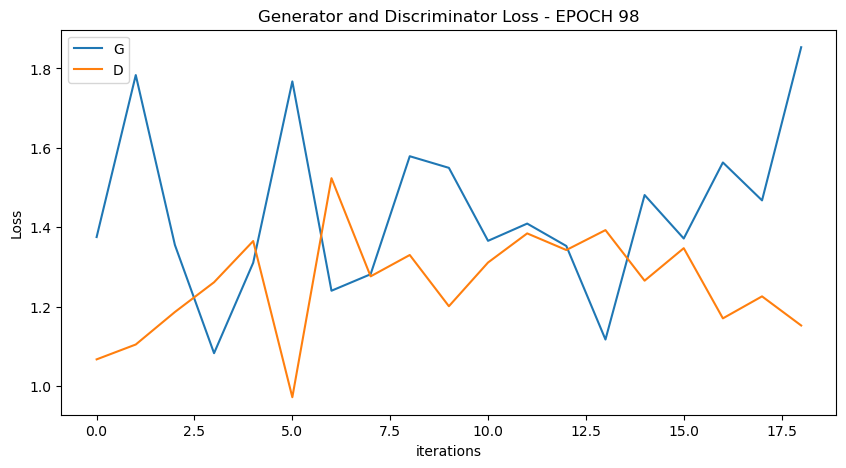

  0%|          | 0/19 [00:00<?, ?it/s]

[100/100][9/19] Loss_D: 1.3303 Loss_G: 1.1561 D(x): 0.4303 D(G(z)): 0.3588 / 0.3029
[100/100][18/19] Loss_D: 1.4214 Loss_G: 1.1318 D(x): 0.4634 D(G(z)): 0.4538 / 0.3175


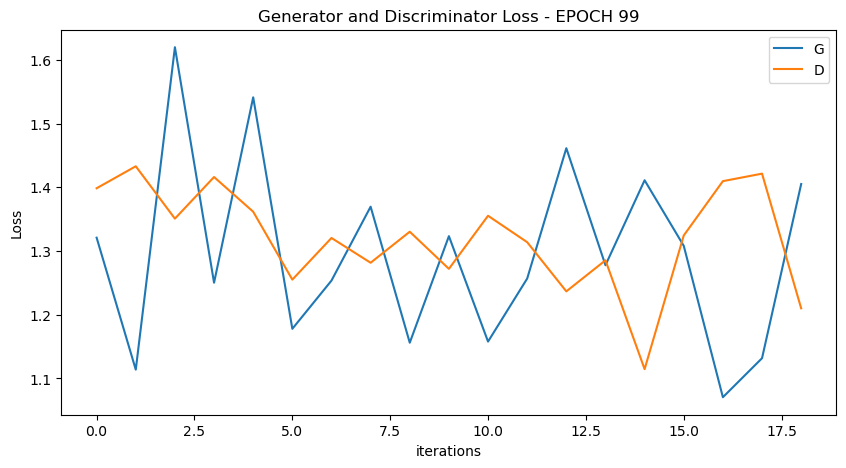

In [ ]:
def plot_loss (G_losses, D_losses, epoch):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss - EPOCH "+ str(epoch))
    plt.plot(G_losses,label="G")
    plt.plot(D_losses,label="D")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

def show_generated_img(n_images=5):
    sample = []
    for _ in range(n_images):
        noise = torch.randn(1, nz, 1, 1, device=device)
        gen_image = netG(noise).to("cpu").clone().detach().squeeze(0)
        gen_image = gen_image.numpy().transpose(1, 2, 0)
        sample.append(gen_image)
    
    figure, axes = plt.subplots(1, len(sample), figsize = (64,64))
    for index, axis in enumerate(axes):
        axis.axis('off')
        image_array = sample[index]
        axis.imshow(image_array)
        
    plt.show()
    plt.close()



# for epoch in range(epochs):
    
#     start = time.time()
#     for ii, (real_images, train_labels) in tqdm(enumerate(train_loader), total=len(train_loader)):
#         ############################
#         # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
#         ###########################
#         # train with real
#         netD.zero_grad()
#         real_images = real_images.to(device)
#         batch_size = real_images.size(0)
#         labels = torch.full((batch_size, 1), real_label, device=device)

#         output = netD(real_images)
#         errD_real = criterion(output, labels)
#         errD_real.backward()
#         D_x = output.mean().item()

#         # train with fake
#         noise = torch.randn(batch_size, nz, 1, 1, device=device)
#         fake = netG(noise)
#         labels.fill_(fake_label)
#         output = netD(fake.detach())
#         errD_fake = criterion(output, labels)
#         errD_fake.backward()
#         D_G_z1 = output.mean().item()
#         errD = errD_real + errD_fake
#         optimizerD.step()

#         ############################
#         # (2) Update G network: maximize log(D(G(z)))
#         ###########################
#         netG.zero_grad()
#         labels.fill_(real_label)  # fake labels are real for generator cost
#         output = netD(fake)
#         errG = criterion(output, labels)
#         errG.backward()
#         D_G_z2 = output.mean().item()
#         optimizerG.step()
        
#         # Save Losses for plotting later
#         G_losses.append(errG.item())
#         D_losses.append(errD.item())
        
#         if (ii+1) % (len(train_loader)//2) == 0:
#             print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
#                   % (epoch + 1, epochs, ii+1, len(train_loader),
#                      errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            
#     plot_loss (G_losses, D_losses, epoch)
#     G_losses = []
#     D_losses = []
#     if epoch % 10 == 0:
#         show_generated_img()

#     epoch_time.append(time.time()- start)
    
# #             valid_image = netG(fixed_noise)

In [ ]:
# if not os.path.exists('D:/CODING/BrainDead/brain_dead_emotion_detection/output_images/happy'):
#     os.mkdir('D:/CODING/BrainDead/brain_dead_emotion_detection/output_images/happy')
    
# im_batch_size = 50
# n_images=100

# for i_batch in tqdm(range(0, n_images, im_batch_size)):
#     gen_z = torch.randn(im_batch_size, nz, 1, 1, device=device)
#     gen_images = netG(gen_z)
#     images = gen_images.to("cpu").clone().detach()
#     images = images.numpy().transpose(0, 2, 3, 1)
#     for i_image in range(gen_images.size(0)):
#         save_image(gen_images[i_image, :, :, :], os.path.join('D:/CODING/BrainDead/brain_dead_emotion_detection/output_images/happy', f'image_{i_batch+i_image:05d}.png'))

C:\Users\Samaresh Maiti\AppData\Local\Temp\ipykernel_24476\3330257903.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i_batch in tqdm(range(0, n_images, im_batch_size)):


  0%|          | 0/2 [00:00<?, ?it/s]